In [1]:
from MLimports2 import *
exec(MLimports())


from copy import copy
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials
from hyperopt.pyll import scope
from lightgbm import LGBMClassifier as LGB
from scipy import stats
from sklearn import metrics,neighbors,preprocessing
from sklearn import tree
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import IsolationForest
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectPercentile, f_classif
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegression as LR
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import f1_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.me

In [2]:
from rsc import *

In [3]:
OPTIMIZER=[]
OPTIMIZER.append({'name':'XGB','instance':XGBClassifier,'param':{
            'learning_rate' : np.log(np.linspace(1.0001,2,50000)),#np.linspace(0.00001,0.9999,10000), 
            'n_estimators' : range(20,200,1),'objective':['reg:squarederror'],
            'max_depth':range(2,15,1), ##MAR: start at 3 
            'subsample':np.linspace(0.25, 1.0 ,10000),'colsample_bytree': np.linspace(0.01,0.9999,10000),
            'min_child_weight':np.arange(2,15),'n_jobs':[1],
            'gamma':np.linspace(0,50,1000),
            'reg_alpha':np.arange(0,15),'reg_lambda':np.arange(0,15)
}})

In [4]:
def quantize(X):

    from sklearn.preprocessing import QuantileTransformer
    qt = QuantileTransformer(n_quantiles=min(1000,len(X)))

    for C in X.columns:
        X[C] = qt.fit_transform(X[C].values.reshape(-1,1)).ravel()

    for C in X.columns:
    #     print(X[C].var())
        if X[C].var()==0:
            del X[C]

In [ ]:
RESULTS=[]

for TH in np.arange(20,71,5):
    print(TH)
    for O in OPTIMIZER:
        X,Y = getBFS(part=[0,-1],dataset='sf',threshold=TH)

        quantize(X)

        res = RandomSearchC(X,Y,model=O['instance'],params=O['param'],iters=260,jobs=50,TH=45,
                            transform='None',scenario=';lk',extra=False,OR='None')

        for M in RSOPTIONS['used_metrics']:
            upd = RSeval(res['best_metric_'+M][1])
            upd.update({'Metric':M})
            upd.update({'Model':O['name']})
            upd.update({'Threshold [min]':TH})
            upd.update({'Perc':sum(Y==0)/len(Y)})
            RESULTS.append(upd)
RES=pd.DataFrame(RESULTS)

In [22]:
ARR=np.random.random(size=100)*700

In [23]:
ARR[ARR>=500]=-2
ARR[ARR>=300]=-1
ARR[ARR>=0]=0

In [26]:
abs(ARR)

array([0., 2., 2., 1., 1., 0., 1., 2., 0., 0., 0., 2., 0., 1., 2., 2., 1.,
       0., 1., 0., 1., 0., 2., 0., 1., 1., 2., 1., 0., 0., 0., 2., 1., 0.,
       2., 0., 1., 1., 0., 1., 0., 1., 0., 2., 2., 2., 0., 2., 0., 0., 0.,
       1., 2., 1., 0., 1., 0., 0., 2., 2., 1., 0., 0., 2., 2., 0., 0., 0.,
       2., 2., 0., 0., 1., 0., 2., 1., 0., 1., 2., 1., 2., 0., 0., 0., 2.,
       0., 1., 0., 1., 0., 0., 1., 0., 0., 0., 0., 2., 0., 0., 2.])

In [5]:
X,Y = getBFS(part=[5,-1],dataset='sf')
max(Y)

2715

In [7]:
np.quantile(Y,0.33),np.quantile(Y,0.66)

(24.0, 44.0)

In [8]:
RESULTS=[]

In [29]:
#for A in np.arange(20,75,5):
#    for B in np.arange(A+5,75,5):

# for A in np.arange(20,75,5):
#     for B in np.arange(75,95,5):
        
#         print(A,B)
        
for O in OPTIMIZER:
    X,Y = getBFS(part=[0,-1],dataset='sf')
    quantize(X)

    TH1 = np.quantile(Y,0.75)
    TH2 = np.quantile(Y,0.25)
#     print(Y, np.quantile(Y,0.66), np.quantile(Y,0.33))
    Y[Y>=TH1]=-2
    Y[Y>=TH2]=-1
    Y[Y>=0]=0
    Y=abs(Y)
    
    print(Y)

    res = RandomSearchC(X,Y,model=O['instance'],params=O['param'],iters=260,jobs=50,TH=45,
                    transform='None',scenario=';lk',extra=False,OR='None')

    for M in RSOPTIONS['used_metrics']:
        upd = RSeval(res['best_metric_'+M][1])
        upd.update({'Metric':M})
        upd.update({'Model':O['name']})
        upd.update({'Threshold A [min]':TH2})
        upd.update({'Threshold B [min]':TH1})
        upd.update({'Perc':np.round([sum(Y==0)/len(Y),sum(Y==1)/len(Y),sum(Y==2)/len(Y)],2)})
        print(res)
        RESULTS.append(upd)
                
RES=pd.DataFrame(RESULTS)

[1 1 1 ... 1 0 1]
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

In [30]:
RES

,F1,Metric,Model,Threshold A [min],Threshold B [min],Perc
0,1.000000,F1,XGB,1.0,1.0,"[0.0, 1.0, 0.0]"
1,1.000000,F1,XGB,1.0,1.0,"[0.0, 1.0, 0.0]"
2,1.000000,F1,XGB,1.0,1.0,"[0.0, 1.0, 0.0]"
3,0.358534,F1,XGB,1.0,2.0,"[0.32, 0.33, 0.35]"
4,0.345653,F1,XGB,24.0,44.0,"[0.32, 0.33, 0.35]"
5,0.342959,F1,XGB,24.0,44.0,"[0.32, 0.33, 0.35]"
6,0.458100,F1,XGB,24.0,54.0,"[0.33, 0.33, 0.34]"
7,0.718703,F1,XGB,30.0,71.0,"[0.33, 0.33, 0.34]"
8,0.340434,F1,XGB,20.0,54.0,"[0.24, 0.51, 0.25]"
9,0.442811,F1,XGB,18.0,66.0,"[0.25, 0.5, 0.26]"


In [ ]:

#for A in np.arange(20,75,5):
#    for B in np.arange(A+5,75,5):

for A in np.arange(20,75,5):
    for B in np.arange(75,95,5):
        
        print(A,B)
        
        for O in OPTIMIZER:
            X,Y = getBFS(part=[5,-1],dataset='a')
            quantize(X)
            
            Y[Y>=B]=-2
            Y[Y>=A]=-1
            Y[Y>=0]=0
            Y=abs(Y)
            
            res = RandomSearchC(X,Y,model=O['instance'],params=O['param'],iters=260,jobs=50,TH=45,
                            transform='None',scenario=';lk',extra=False,OR='None')
            
            for M in RSOPTIONS['used_metrics']:
                upd = RSeval(res['best_metric_'+M][1])
                upd.update({'Metric':M})
                upd.update({'Model':O['name']})
                upd.update({'Threshold A [min]':A})
                upd.update({'Threshold B [min]':B})
                upd.update({'Perc':np.round([sum(Y==0)/len(Y),sum(Y==1)/len(Y),sum(Y==2)/len(Y)],2)})
                print(res)
                RESULTS.append(upd)
                
RES=pd.DataFrame(RESULTS)

20 75
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

{'used_metrics': ['F1'], 'resutls': None, 'best': None, 'model': <class 'xgboost.sklearn.XGBClassifier'>, 'X':         Source  Severity  Distance(mi)  Side  County  Airport_Code  \
0     0.687187  0.845345      0.000000   1.0     0.0           1.0   
1     0.687187  0.845345      0.000000   1.0     0.0           1.0   
2     0.687187  0.358358      0.000000   1.0     0.0           0.0   
3     0.687187  0.845345      0.000000   1.0     0.0           1.0   
4     0.687187  0.358358      0.000000   1.0     0.0           1.0   
...        ...       ...           ...   ...     ...           ...   
8748  0.000000  0.358358      0.874399   1.0     0.0           1.0   
8749  0.000000  0.358358      0.871284   1.0     0.0           1.0   
8750  0.000000  0.358358      0.957701   1.0     0.0           0.0   
8751  0.000000  0.358358      0.887888   1.0     0.0           0.0   
8752  0.000000  0.358358      0.835502   1.0     0.0           1.0   

      Temperature(F)  Humidity(%)  Pressure(in) 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaco

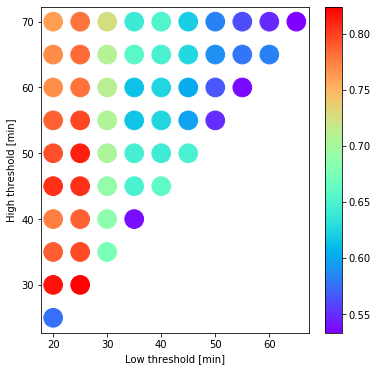

In [8]:
plt.figure(figsize=(6,6))
plt.scatter(RES['Threshold A [min]'],RES['Threshold B [min]'],c=RES['F1'],s=350,cmap='rainbow')
plt.colorbar()
plt.xlabel('Low threshold [min]')
plt.ylabel('High threshold [min]')

plt.savefig('Xmulti_SF.pdf',format='pdf',bbox_inches='tight',pad_inches = 0)

In [9]:
RESULTS

[{'F1': 0.5763235240842925,
  'Metric': 'F1',
  'Model': 'XGB',
  'Threshold A [min]': 20,
  'Threshold B [min]': 25,
  'Perc': array([0.02, 0.  , 0.97])},
 {'F1': 0.8168808757750653,
  'Metric': 'F1',
  'Model': 'XGB',
  'Threshold A [min]': 20,
  'Threshold B [min]': 30,
  'Perc': array([0.02, 0.3 , 0.67])},
 {'F1': 0.7880888268033148,
  'Metric': 'F1',
  'Model': 'XGB',
  'Threshold A [min]': 20,
  'Threshold B [min]': 35,
  'Perc': array([0.02, 0.4 , 0.58])},
 {'F1': 0.7758306351379639,
  'Metric': 'F1',
  'Model': 'XGB',
  'Threshold A [min]': 20,
  'Threshold B [min]': 40,
  'Perc': array([0.02, 0.41, 0.56])},
 {'F1': 0.8062801888525618,
  'Metric': 'F1',
  'Model': 'XGB',
  'Threshold A [min]': 20,
  'Threshold B [min]': 45,
  'Perc': array([0.02, 0.5 , 0.48])},
 {'F1': 0.7939147667305431,
  'Metric': 'F1',
  'Model': 'XGB',
  'Threshold A [min]': 20,
  'Threshold B [min]': 50,
  'Perc': array([0.02, 0.54, 0.44])},
 {'F1': 0.7874875655881842,
  'Metric': 'F1',
  'Model': 'XGB',


In [2]:
X,Y = getBFS(part=[0,-1],dataset='sf')

In [6]:
X['Source'].unique()

array([1, 2, 0])

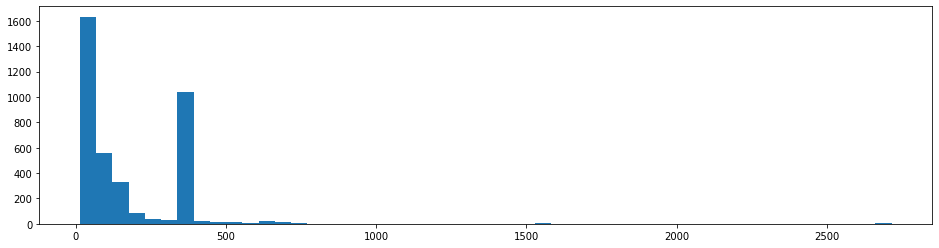

In [31]:

plt.figure(figsize=(16,4))
plt.hist(Y[X.Source==0],bins=50)
# plt.hist(Y[X.Source==1],bins=190)
# plt.hist(Y[X.Source==2],bins=190)
# plt.xlim(0,100)
print()

In [33]:
len(Y[X.Source==0])/len(Y)

0.43630755169656116

# Arterial roads

In [2]:
from rsc import *

In [5]:
# dir(lgb)

In [6]:
OPTIMIZER=[]
OPTIMIZER.append({'name':'XGB','instance':XGBClassifier,'param':{
            'learning_rate' : np.log(np.linspace(1.0001,2,50000)),#np.linspace(0.00001,0.9999,10000), 
            'n_estimators' : range(20,200,1),'objective':['reg:squarederror'],
            'max_depth':range(2,15,1), ##MAR: start at 3 
            'subsample':np.linspace(0.25, 1.0 ,10000),'colsample_bytree': np.linspace(0.01,0.9999,10000),
            'min_child_weight':np.arange(2,15),'n_jobs':[1],
            'gamma':np.linspace(0,50,1000),
            'reg_alpha':np.arange(0,15),'reg_lambda':np.arange(0,15)
}})

import lightgbm as lgb
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor


OPTIMIZER.append({'name':'LR','instance': LogisticRegression, 'param':{
    'C':np.linspace(0.001,10,10000), 'max_iter': [100,200,500], 'class_weight':[None,'balanced'], 'fit_intercept':[True,False]
}})

OPTIMIZER.append({'name':'LGBM','instance':lgb.LGBMClassifier,'param':{
            'feature_fraction':np.linspace(0.5,1,100),'bagging_fraction':np.linspace(0.5,1,100),'n_jobs':[1],
            'learning_rate' : np.linspace(0.00001,1,10000), 'lambda_l1':np.linspace(0,5,1000),'lambda_l2':np.linspace(0,5,1000),
            'max_depth' : np.arange(2,15), 'metric':['MAE','RMSE'],'objective':['huber', 'gamma', 'fair', 'tweedie'],
            'num_leaves':np.arange(2,31),'verbosity':[-2]
        }})

OPTIMIZER.append({'name':'GBDT','instance': GradientBoostingClassifier, 'param':{
    'learning_rate' : np.linspace(0.00001,1,10000), 
    'n_estimators' : range(20,200,1),
    'max_depth':range(2,15,1), ##MAR: start at 3 
    'subsample':np.linspace(0.25, 1.0 ,10000), 'min_samples_split':np.linspace(0.001,0.999,1000)
}})

OPTIMIZER.append({'name':'KNN','instance':KNeighborsClassifier,'param':{
            'n_neighbors' : range(2,100), 
            'weights' : ['uniform','distance'],
            'p':[1,2], 'leaf_size': np.arange(2,60)
        }})

OPTIMIZER.append({'name':'RF','instance': RandomForestClassifier, 'param':{
    'n_estimators' : range(20,200,1),
    'max_depth':range(2,15,1), ##MAR: start at 3 
}})

In [119]:
RESULTS=[]

for TH in np.arange(20,71,5):
    print(TH)
    for O in OPTIMIZER:
        X,Y = getBFS(part=[0,-1],dataset='sf',threshold=TH)

        quantize(X)

        res = RandomSearchC(X,Y,model=O['instance'],params=O['param'],iters=260,jobs=50,TH=45,
                            transform='None',scenario=';lk',extra=False,OR='None')

        for M in RSOPTIONS['used_metrics']:
            upd = RSeval(res['best_metric_'+M][1])
            upd.update({'Metric':M})
            upd.update({'Model':O['name']})
            upd.update({'Threshold [min]':TH})
            upd.update({'Perc':sum(Y==0)/len(Y)})
            RESULTS.append(upd)
RES=pd.DataFrame(RESULTS)

20
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defi

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defi

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defi

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: Fut

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: Fut

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.90404040404

[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.4814814814814814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4814814814814814
[LightGBM] [Warning] lambda_l2 is set=2.8378378378378377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8378378378378377
[LightGBM] [Warning] lambda_l2 is set=2.1021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1021021021021022
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=2.8578578578578577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8578578578578577
[LightGBM] [Warning] lambda_l2 is set=2.7727727727727727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7727727727727727
[LightGBM] [Warning] lambda_l1 is se

[LightGBM] [Warning] lambda_l1 is set=0.7307307307307307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7307307307307307
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] lambda_l1 is set=4.51951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51951951951952
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=4.634634634634635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.634634634634635
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l1 is set=4.584584584584585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.584584584584585
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_byt

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=2.1071071071071072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1071071071071072
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=4.6996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6996996996997
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[Light

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=3.3833833833833835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3833833833833835
[LightGBM] [Warning] lambda_l1 is set=4.584584584584585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.584584584584585
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=3.063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.063063063063063
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=0.055055055055055056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.055055055055055056


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=1.1361361361361362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1361361361361362


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=2.062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.062062062062062
[LightGBM] [Warning] lambda_l1 is set=2.4124124124124124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4124124124124124


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=3.6386386386386387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6386386386386387
[LightGBM] [Warning] lambda_l2 is set=0.4854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4854854854854855
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=0.02002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02002002002002002
[LightGBM] [Warning] lambda_l1 is set=4.51951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51951951951952
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=1.5415415415415414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5415415415415414
[LightGBM] [Warning] lambda_l2 is set=3.7887887887887888, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7887887887887888
[LightGBM] [Warning] lambda_l2 is set=4.494494494494495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.494494494494495
[LightGBM] [Warning] feature_fraction is s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=2.1771771771771773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1771771771771773
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] lambda_l1 is set=0.04504504504504504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04504504504504504
[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=2.2422422422422423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2422422422422423
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=0.8158158158158159, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8158158158158159
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556


[LightGBM] [Warning] lambda_l1 is set=2.8978978978978978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8978978978978978
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=3.958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.958958958958959
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.6386386386386387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6386386386386387
[LightGBM] [Warning] lambda_l1 is set=0.8208208208208209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8208208208208209
[LightGBM] [Warning] b

[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] lambda_l1 is set=0.2752752752752753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2752752752752753
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=2.3373373373373374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3373373373373374
[LightGBM] [Warning] lambda_l1 is set=3.6286286286286287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6286286286286287
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=1.3863863863863863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3863863863863863
[LightGBM] [Warning] lambda_l1 is set=1.6766766766766767, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6766766766766767
[LightGBM] [Warning] lambda_l2 is set=2.1071071071071072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1071071071071072
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5475475475475475
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=3.933933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.933933933933934
[LightGBM] [Warning] lambda_l1 is set=2.7077077077077076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7077077077077076
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=2.062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.062062062062062
[LightGBM] [Warning] lambda_l2 is set=0.4854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4854854854854855
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l1 is set=2.967967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.967967967967968
[LightGBM] [Warning] lambda_l2 is set=1.4814814814814814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4814814814814814
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=1.5415415415415414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5415415415415414
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=2.8178178178178177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8178178178178177
[LightGBM] [Warning] lambda_l1 is set=3.3833833833833835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3833833833833835
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.9209209209209209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9209209209209209
[LightGBM] [Warning] lambda_l1 is set=2.2822822822822824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2822822822822824
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=2.1021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1021021021021022
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.814814814814815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.814814814814815
[

[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=3.158158158158158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.158158158158158
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=1.6766766766766767, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6766766766

[LightGBM] [Warning] lambda_l2 is set=3.203203203203203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.203203203203203
[LightGBM] [Warning] lambda_l2 is set=2.1071071071071072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1071071071071072
[LightGBM] [Warning] lambda_l1 is set=3.6686686686686687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6686686686686687
[LightGBM] [Warning] lambda_l1 is set=4.6996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6996996996997
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=4.004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.004004004004004
[LightGBM] [Warning] feature_fracti

[LightGBM] [Warning] lambda_l1 is set=2.7677677677677677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7677677677677677
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=1.981981981981982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.981981981981982
[LightGBM] [Warning] lambda_l1 is set=0.7307307307307307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7307307307307307
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=0.055055055055055056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.055055055055055056
[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] lambda_l1 is set=1.1361361361361362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1361361361361362
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=2.4424424424424425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4424424424424425
[LightGBM] [Warning] lambda_l2 is set=4.724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.724724724724725
[LightGBM] [Warning] lambda_l1 is set=2.997997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.997997997997998
[LightGBM] [Warning] lambda_l1 is set=0.5905905905905906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5905905905905906
[LightGBM] [Warning] feature_fraction is set

[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] lambda_l1 is set=4.004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.004004004004004
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=4.98998998998999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.98998998998999
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[L

[LightGBM] [Warning] lambda_l1 is set=3.3883883883883885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3883883883883885
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] lambda_l1 is set=0.7307307307307307, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7307307307307307
[LightGBM] [Warning] lambda_l2 is set=3.913913913913914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.913913913913914
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Wa

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l1 is set=2.997997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.997997997997998
[LightGBM] [Warning] lambda_l2 is set=0.8458458458458459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8458458458458459
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=3.5335335335335336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5335335335335336
[LightGBM] [Warning] bagging_fraction is set=0.601

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l1 is set=4.624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.624624624624625
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warning] lambda_l2 is set=0.9409409409409409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9409409409409409
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=3.2382382382382384, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2382382382382384
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] lambda_l1 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] lambda_l2 is set=0.8758758758758759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8758758758758759
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5475475475475475
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=2.2472472472472473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2472472472472473
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.5185185185185186, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5185185185185186
[LightGBM] [Warning] lambda_l2 is set=1.2812812812812813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2812812812812813
[LightGBM] [Warning] lambda_l1 is set=4.54954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.54954954954955
[LightGBM] [Warning] lambda_l1 is set=1.6716716716716717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6716716716716717
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bag

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=0.44544544544544545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44544544544544545
[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] lambda_l2 is set=3.958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.958958958958959
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l1 is set=0.8208208208208209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8208208208208209
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGB

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=0.3303303303303303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3303303303303303
[LightGBM] [Warning] lambda_l1 is set=3.5335335335335336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5335335335335336
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757
[LightGBM] [Warning] lambda_l2 is set=0.8758758758758759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8758758758758759
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=4.109109109109109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.109109109109109
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=4.66966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.66966966966967
[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18018018018018017
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warni

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.2812812812812813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2812812812812813
[LightGBM] [Warning] lambda_l2 is set=3.3433433433433435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3433433433433435
[LightGB

[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] lambda_l1 is set=4.46946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.46946946946947
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.2472472472472473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2472472472472473
[LightGBM] [Warning] lambda_l1 is set=1.8418418418418419, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8418418418418419
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=0.055055055055055056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.055055055055055056
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=2.4424424424424425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4424424424424425
[

[LightGBM] [Warning] lambda_l2 is set=1.2812812812812813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2812812812812813
[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] lambda_l2 is set=4.109109109109109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.109109109109109
[LightGBM] [Warning] lambda_l1 is set=1.6716716716716717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6716716716716717
[LightGBM] [Warning] lambda_l1 is set=4.46946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.46946946946947


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18018018018018017
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.7067067067067068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7067067067067068
[LightGBM] [Warning] lambda_l1 is set=4.484484484484485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.484484484484485


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=2.3023023023023024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3023023023023024
[LightGBM] [Warning] lambda_l2 is set=0.975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.975975975975976
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=3.3283283283283285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3283283283283285
[LightGBM] [Warning] lambda_l1 is set=0.8658658658658659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8658658658658659
[LightGBM] [Warning] lambda

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=3.928928928928929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.928928928928929
[LightGBM] [Warning] lambda_l2 is set=3.3433433433433435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3433433433433435
[LightGBM] [Warning] lambda_l2 is set=4.98998998998999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.98998998998999
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=4.73973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.73973973973974
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=4.40940940940941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.40940940940941
[LightGBM] [Warning] lambda_l1 is set=4.74974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.74974974974975
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM]

[LightGBM] [Warning] lambda_l1 is set=1.3363363363363363, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3363363363363363
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] lambda_l1 is set=2.037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.037037037037037
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.67171717171717

[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18018018018018017
[LightGBM] [Warning] lambda_l1 is set=3.3283283283283285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3283283283283285
[LightGBM] [Warning] lambda_l2 is set=3.928928928928929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.928928928928929
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=1.4214214214214214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4214214214214214
[LightGBM] [Warning] lambda_l1 is set=3.158158158158158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.158158158158158
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] lambda_l2 is set=3.928928928928929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.928928928928929
[LightGBM] [Warning] lambda_l1 is set=3.4684684684684686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4684684684684686
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=0.055055055055055056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.055055055055055056
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=1.001001001001001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.001001001001001
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=3.3283283283283285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3283283283283285
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6716716716716717
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=3.883883883883884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.883883883883884
[LightGBM] [Warning] feature_fraction is set=0

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=2.5125125125125125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5125125125125125
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=1.3363363363363363, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3363363363363363
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[LightGBM] [Warning] lambda_l1 is set=3.193193193193193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193193193193193
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=1.6516516516516517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6516516516516517
[LightGBM] [Warning] lambda_l2 is set=1.5315315315315314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.65151

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=3.2832832832832834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2832832832832834
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] lambda_l1 is set=4.46946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.46946946946947
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[

[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.888888888888889
[LightGBM] [Warning] lambda_l1 is set=1.1211211211211212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1211211211211212
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is 

[LightGBM] [Warning] lambda_l1 is set=1.3963963963963963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3963963963963963
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=4.2642642642642645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2642642642642645
[LightGBM] [Warning] lambda_l1 is set=3.798798798798799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.798798798798799
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] lambda_l2 is set=2.972972972972973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.972972972972973
[LightGBM] [Warning] lambda_l1 is set=3.5035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5035035035035036
[LightGBM] [Warning] lambda_l1 is set=1.001001001001001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.001001001001001
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=1.021021021021021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.021021021021021
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.2752752752752753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2752752752752753
[LightGBM] [Warning] lambda_l1 is set=4.049049049049049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.049049049049049
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] lambda_l1 is set=1.4214214214214214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4214214214214214
[LightGBM] [Warning] lambda_l1 is set=3.193193193193193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193193193193193
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bag

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=2.4324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4324324324324325
[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] lambda_l1 is set=1.6516516516516517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6516516516516517
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=

[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] lambda_l2 is set=0.8008008008008007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8008008008008007
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=3.7437437437437437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7437437437437437
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182


[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=4.2592592592592595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2592592592592595
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.888888888888889
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=1.1211211211211212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1211211211211212
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[L

[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] lambda_l2 is set=3.3433433433433435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3433433433433435
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.525

[LightGBM] [Warning] lambda_l1 is set=4.74974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.74974974974975
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=1.3963963963963963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3963963963963963
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=0.6056056056056056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.605605605605

[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=0.6706706706706707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6706706706706707
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l1 is set=4.704704704704705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.704704704704705
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.1111111111111112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111111111111112
[LightGBM] [Warning] lambda_l2 is set=0.22022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22022022022022023
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=3.023023023023023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.023023023023023
[LightGBM] [Warning] lambda_l1 is set=3.4084084084084085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084084084084085
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=2.7377377377377377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.737737737

[LightGBM] [Warning] lambda_l2 is set=4.109109109109109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.109109109109109
[LightGBM] [Warning] lambda_l1 is set=3.7237237237237237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7237237237237237
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=0.2952952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2952952952952953
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.888888888888889
[LightGBM] [Wa

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=4.374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.374374374374375
[LightGBM] [Warning] lambda_l1 is set=0.24024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24024024024024024
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l2 is set=0.5405405405405406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5405405405405406
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=2.1271271271271273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1271271271271273
[LightGBM] [Warning] lambda_l2 is set=1.931931931931932, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.931931931931932
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] l

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.2042042042042045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2042042042042045
[LightGBM] [Warning] lambda_l1 is set=4.80980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.80980980980981
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] lambda_l1 is set=1.2812812812812813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2812812812812813
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=1.5415415415415414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5415415415415414
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=3.6986986986986987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6986986986986987
[LightGBM] [Warning] lambda_l1 is set=4.119119119119119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.119119119119119
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[L

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=3.2782782782782784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2782782782782784
[LightGBM] [Warning] lambda_l2 is set=3.883883883883884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.883883883883884
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=2.6626626626626626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6626626626626626
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=0.7007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.700700700

[LightGBM] [Warning] lambda_l1 is set=4.80980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.80980980980981
[LightGBM] [Warning] lambda_l2 is set=2.067067067067067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.067067067067067
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=4.67967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.67967967967968
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[LightGBM] [Warning] ba

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=2.3223223223223224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3223223223223224
[LightGBM] [Warning] lambda_l1 is set=3.7037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7037037037037037
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=0.3253253253253253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.32532532532532

[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=0.5755755755755756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5755755755755756
[LightGBM] [Warning] lambda_l2 is set=2.1021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1021021021021022
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=3.6986986986986987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6986986986986987
[LightGBM] [Warning] lambda_l1 is set=4.119119119119119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.119119119119119
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=2.8278278278278277, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8278278278278277
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035

[LightGBM] [Warning] lambda_l2 is set=4.034034034034034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.034034034034034
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] lambda_l2 is set=0.42542542542542544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42542542542542544
[LightGBM] [Warning] lambda_l2 is set=0.18018018018018017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18018018018018017
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=1.1561561561561562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1561561561561562
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] lambda_l2 is set=2.067067067067067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.067067067067067
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=4.67967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.67967967967968
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] lambda_l2 is set=3.993993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.993993993993994
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=0.5755755755755756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5755755755755756
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=3.033033033033033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.033033033033033
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=1.4164164164164164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4164164164164164
[LightGBM] [Warning] lambda_l2 is set=1.936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.936936936936937
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=4.804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804804804804805
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=0.9459459459459459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9459459459459459
[LightGBM] [Warning] lambda_l2 is set=0.6156156156156156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6156156156156156
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.2782782782782784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2782782782782784
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=1.936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.936936936936937

[LightGBM] [Warning] lambda_l2 is set=2.7577577577577577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7577577577577577
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=0.9459459459459459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9459459459459459
[LightGBM] [Warning] b

[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=0.42542542542542544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42542542542542544
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=0.6606606606606606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6606606606606606
[LightGBM] [Warning] lambda_l1 is set=4.80980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.80980980980981
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=3.6336336336336337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6336336336336337
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l1 is set=1.931931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.931931931931932
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[L

[LightGBM] [Warning] lambda_l2 is set=3.058058058058058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.058058058058058
[LightGBM] [Warning] lambda_l1 is set=4.60960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.60960960960961
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.7577577577577577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7577577577577577
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l1 is set=3.148148148148148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.148148148148148
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=1.936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.936936936936937
[LightGBM] [Warning] lambda_l1 is set=4.804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804804804804805
[LightGBM] [Warning] bag

[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] lambda_l1 is set=1.931931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.931931931931932
[LightGBM] [Warning] lambda_l1 is set=0.990990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.990990990990991
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l1 is set=3.148148148148148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.148148148148148
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l1 is set=1.931931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.931931931931932
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=1.2812812812812813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2812812812812813
[LightGBM] [Warning] lambda_l1 is set=3.858858858858859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.858858858858859
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] lambda_l1 is set=4.059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059059059059059
[LightGBM] [Warning] fea

[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] lambda_l1 is set=4.059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059059059059059
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=0.025025025025025023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02502502502502

[LightGBM] [Warning] lambda_l2 is set=4.57957957957958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.57957957957958
[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=1.4214214214214214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4214214214214214
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=4.71971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.71971971971972
[LightGBM] [Warning] lambda_l1 is set=3.933933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.933933933933934
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

25
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default s

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: Fut

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.2142142142142145, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2142142142142145
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=0.7807807807807807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7807807807807807
[LightGBM] [Warning] lambda_l2 is set=3.3883883883883885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3883883883883885
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=0.9059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9059059059059059
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[

[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] lambda_l2 is set=2.022022022022022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.022022022022022
[LightGBM] [Warning] lambda_l1 is set=0.4804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4804804804804805
[LightGBM] [Warning] lambda_l1 is set=0.2702702702702703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2702702702702703
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is se

[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytre

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=4.86986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.86986986986987
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=3.2532532532532534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2532532532532534
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=2.8628628628628627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8628628628628627
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [W

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=2.8678678678678677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8678678678678677
[LightGBM] [Warning] lambda_l2 is set=1.3663663663663663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3663663663663663
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGB

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=3.798798798798799, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.798798798798799
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l1 is set=4.65965965965966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.65965965965966
[LightGBM] [Warning] lambda_l2 is set=4.57957957957958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.57957957957958
[LightGBM] [Warning] lambda_l1 is set=3.2982982982982985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2982982982982985
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575
[LightGBM] [Warning] lambda_l1 is set=4.024024024024024, reg_alpha=0.0 wi

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.2572572572572573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2572572572572573
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=2.022022022022022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.022022022022022
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.54

[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=0.8758758758758759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8758758758758759
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[LightGBM] [Warning] lambda_l1 is set=4.1691691691691695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=3.2532532532532534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2532532532532534
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=1.1611611611611612, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1611611611611612
[LightGBM] [Warning] lambda_l2 is set=1.996996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.996996996996997
[LightGBM] [Warning] lambda_l1 is set=3.4784784784784786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4784784784784786
[LightGBM] [Warning] lambda_l1 is set=2.0770770770770772, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0770770770770772
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGB

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=2.0870870870870872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0870870870870872
[LightGBM] [Warning] lambda_l2 is set=4.73973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.73973973973974
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=1.2962962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2962962962962963
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[Lig

[LightGBM] [Warning] lambda_l1 is set=0.20020020020020018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20020020020020018
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[LightGBM] [Warning] lambda_l1 is set=4.004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.004004004004004
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[Lig

[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.022022022022022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.022022022022022
[LightGBM] [Warning] lambda_l1 is set=1.4114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4114114114114114
[Lig

[LightGBM] [Warning] lambda_l1 is set=4.90990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.90990990990991
[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=2.1471471471471473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1471471471471473
[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] lambda_l1 is set=3.7537537537537538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7537537537537538
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[LightGBM] [Warning] lambda_l2 is set=4.844844844844845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.844844844844845
[LightGBM] [Warning] lambda_l1 is set=0.2702702702702703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2702702702702703
[LightGBM] [Warning] feature_fracti

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=1.6416416416416417, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6416416416416417
[LightGBM] [Warning] lambda_l2 is set=3.3083083083083085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3083083083083085
[LightGBM] [Warning] lambda_l1 is set=0.21521521521521522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21521521521521522
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=1.8718718718718719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8718718718718719
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=1.4664664664664664, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4664664664664664
[LightGBM] [Warning] lambda_l1 is set=0.4804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4804804804804805
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=2.022022022022022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.022022022022022
[LightGBM] [Warning] lambda_l1 is set=1.4114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4114114114114114
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=0.7907907907907907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7907907907907907
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=0.4804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4804804804804805
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.3883883883883885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.38838838838

[LightGBM] [Warning] lambda_l2 is set=2.4874874874874875, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4874874874874875
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5475475475475475
[LightGBM] [Warning] lambda_l1 is set=4.2142142142142145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2142142142142145
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=2.1971971971971973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1971971971971973
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=2.6426426426426426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6426426426426426
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=4.064064064064064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.064064064064064
[LightGBM] [Warning] lambda_l1 is set=3.3083083083083085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3083083083083085
[LightGBM] [Warning] lambda_l1 is set=1.946946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.946946946946947
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=0.11511511511511512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11511511511511512
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=0.17517517517517517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17517517517517517
[LightGBM] [Warning] lambda_l2 is set=4.53953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.53953953953954
[LightGBM] [Warning] bagging_fraction

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=2.6726726726726726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6726726726726726
[LightGBM] [Warning] lambda_l1 is set=2.8628628628628627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8628628628628627
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.3563563563563563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3563563563563563
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=4.2742742742742745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2742742742742745
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] lambda_l2 is set=0.8108108108108109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8108108108108109
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=0.8008008008008007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8008008008008007
[LightGBM] [Warning]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.022022022022022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.022022022022022
[LightGBM] [Warning] lambda_l1 is set=1.4114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4114114114114114
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.76262

[LightGBM] [Warning] lambda_l2 is set=2.5375375375375375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5375375375375375
[LightGBM] [Warning] lambda_l1 is set=3.023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.023023023023023
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=0.2902902902902903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2902902902902903
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=4.81981981981982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.81981981981982
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=1.0510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0510510510510511
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=0.5855855855855856, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5855855855855856
[LightGBM] [Warning] lambda_l1 is set=4.71971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.71971971971972
[LightGBM] [Warning] feature_fraction 

[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=2.3173173173173174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3173173173173174
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=0.4804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4804804804804805
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=1.006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.006006006006006
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.5385385385385386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5385385385385386
[LightGBM] [Warning] lambda_l1 is set=4.944944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.944944944944945

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=4.984984984984985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.984984984984985
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] lambda_l2 is set=3.818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.818818818818819
[LightGBM] [Warning] lambda_l1 is set=0.8258258258258259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8258258258258259
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l2 is set=0.43543543543543545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43543543543543545
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] lambda_l1 is set=4.2242242242242245, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2242242242242245
[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM

[LightGBM] [Warning] lambda_l1 is set=3.2082082082082084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2082082082082084
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=3.5385385385385386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5385385385385386
[LightGBM] [Warning] lambda_l1 is set=4.944944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.944944944944945
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.86868686868686

[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=4.73973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.73973973973974
[LightGBM] [Warning] lambda_l1 is set=1.5865865865865865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5865865865865865
[LightGBM] [Warning] lambda_l2 is set=4.704704704704705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.704704704704705
[LightGBM] [Warning] feature_fra

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=4.5995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5995995995996
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=0.43543543543543545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43543543543543545
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=4.2242242242242245, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2242242242242245
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[Lig

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=2.3773773773773774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3773773773773774
[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=1.941941941941942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.941941941941942
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[L

[LightGBM] [Warning] lambda_l1 is set=2.012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.012012012012012
[LightGBM] [Warning] lambda_l1 is set=2.8628628628628627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8628628628628627
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=2.4624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4624624624624625
[LightGBM] [Warning] lambda_l2 is set=3.818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.818818818818819
[LightGBM] [Warning] lambda_l1 is set

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=0.20020020020020018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20020020020020018
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.547547

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.8108108108108109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8108108108108109
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=3.873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.873873873873874
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] lambda_l2 is set=4.6996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6996996996997
[LightGBM] [Warning] lambda_l1 is set=0.6256256256256256, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6256256256256256
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=2.2872872872872874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2872872872872874
[LightGBM] [Warning] lambda_l1 is set=0.980980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.980980980980981
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] 

[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.4624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4624624624624625
[LightGBM] [Warning] lambda_l2 is set=2.5375375375375375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5375375375375375
[LightGBM] [Warning] lambda_l2 is set=1.3663663663663663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3663663663663663
[LightGBM] [Warning] lambda_l1 is set=2.992992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.992992992992993
[LightGBM] [Warning] lambd

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=0.8108108108108109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8108108108108109
[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=4.444444444444445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.444444444444445
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] [Warning] lambda_l2 is set=3.3733733733733735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3733733733733735
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] lambda_l2 is set=5.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] lambda_l1 is set=0.955955955955956, reg_alpha=0.0 will be ignore

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=2.2972972972972974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2972972972972974
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=2.947947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.947947947947948
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] feature_fraction 

[LightGBM] [Warning] lambda_l2 is set=2.7927927927927927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7927927927927927
[LightGBM] [Warning] lambda_l1 is set=4.324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.324324324324325
[LightGBM] [Warning] lambda_l1 is set=0.8758758758758759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8758758758758759
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=3.2782782782782784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2782782782782784
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] lambda_l1 is set=4.71971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.71971971971972
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=1.4014014014014013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4014014014014013
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.2642642642642645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2642642642642645
[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=2.4624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4624624624624625

[LightGBM] [Warning] lambda_l2 is set=2.5125125125125125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5125125125125125
[LightGBM] [Warning] lambda_l2 is set=0.7657657657657657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7657657657657657
[LightGBM] [Warning] lambda_l1 is set=4.344344344344345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.344344344344345
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=1.991991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.991991991991992
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [War

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=4.70970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.70970970970971
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=0.39039039039039036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39039039039039036
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=4.984984984984985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.984984984984985
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=4.324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.324324324324325
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.80808080808080

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=2.4424424424424425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4424424424424425
[LightGBM] [Warning] lambda_l1 is set=2.7177177177177176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7177177177177176
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=2.6376376376376376, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6376376376376376
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=2.4624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4624624624624625
[Li

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=2.3623623623623624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3623623623623624
[LightGBM] [Warning] lambda_l2 is set=3.158158158158158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.1

[LightGBM] [Warning] lambda_l1 is set=2.0870870870870872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0870870870870872
[LightGBM] [Warning] lambda_l2 is set=1.5515515515515514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5515515515515514
[LightGBM] [Warning] lambda_l2 is set=2.4424424424424425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4424424424424425
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=4.2792792792792795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2792792792792795
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=0.955955955955956, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.955955955955956
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=0.36036036036036034, reg_alpha=0.0 will be ignored. Current value: lam

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.6726726726726726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6726726726726726
[LightGBM] [Warning] lambda_l2 is set=1.3013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3013013013013013
[LightGBM] [Warning] lambda_l2 is set=3.058058058058058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.058058058058058
[LightGBM] [Warning] lambda_l1 is set=3.193193193193193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193193193193193
[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] lambda_l1 is set=3.6

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=1.996996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.996996996996997
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=3.2782782782782784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2782782782782784
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=1.5515515515515514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5515515515515514
[LightGBM] [Warning] lambda_l1 is set=1.0410410410410411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0410410410410411
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=0.7707707707707707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7707707707707707
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=2.8428428428428427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8428428428428427
[LightGBM] [Warning] lambda_l1 is set=3.2182182182182184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2182182182182184
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=1.2262262262262262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2262262262262262
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=0.19519519519519518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19519519519519518
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fract

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=3.2582582582582584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2582582582582584
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.8308308308308309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8308308308308309
[LightGBM] [Warning] lambda_l1 is set=0.37537537537537535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37537537537537535
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282

[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.7037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7037037037037037
[LightGBM] [Warning] lambda_l1 is set=3.2082082082082084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2082082082082084
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=2.047047047047047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.047047047047047
[LightGBM] [Warning] lambda_l1 is set=0.7657657657657657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7657657657657657
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.7207207207207207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7207207207207207
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=4.004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004004004004004
[LightGBM] [Warning] lambda_l1 is set=0.07507507507507508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07507507507507508
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.833333333333333

[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=2.1271271271271273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1271271271271273
[LightGBM] [Warning] lambda_l1 is set=0.6506506506506506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6506506506506506
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] lambda_l2 is set=1.1111111111111112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111111111111112
[LightGBM] [Warning] lambda_l1 is set=4.42942942942943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.42942942942943
[LightGBM] [Warning] lambda_l1 is set=3.923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.923923923923924
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] feature_f

[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=2.8328328328328327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8328328328328327
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.7037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7037037037037037

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.2872872872872874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2872872872872874
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=4.914914914914915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.914914914914915
[LightGBM] [Warning] lambda_l2 is set=3.118118118118118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.118118118118118
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=3.7487487487487487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7487487487487487
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=3.888888888888889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.888888888888889
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[LightGBM] [Warning] lambda_l1 is set=1.1411411411411412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1411411411411412
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightG

[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=2.1271271271271273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1271271271271273
[LightGBM] [Warning] lambda_l1 is set=0.6506506506506506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6506506506506506
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.76262626

[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=4.624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.624624624624625
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7837837837837838
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=2.4324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4324324324324325
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=3.088088088088088, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.088088088088088
[LightGBM] [Warning] lambda_l1 is set=2.8728728728728727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8728728728728727
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=3.2732732732732734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2732732732732734
[LightGBM] [Warning] lambda_l1 is set=0.7207207207207207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7207207207207207
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=3.2382382382382384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2382382382382384
[LightGBM] [Warning] lambda_l1 is set=4.084084084084084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.084084084084084
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.1561561561561562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1561561561561562
[

[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=4.089089089089089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089089089089089
[LightGBM] [Warning] lambda_l2 is set=4.054054054054054, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.054054054054054
[LightGBM] [Warning] lambda_l1 is set=1.7317317317317318, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7317317317317318
[Li

[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=2.8828828828828827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8828828828828827
[LightGBM] [Warning] lambda_l1 is set=3.888888888888889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.888888888888889
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=3.2732732732732734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2732732732732734
[LightGBM] [Warning] lambda_l1 is set=0.7207207207207207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7207207207207207
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=0.03003003003003003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03003003003003003
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.1111111111111112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111111111111112
[LightGBM] [Warning] lambda_l1 is set=3.923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.923923923923924
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[L

[LightGBM] [Warning] lambda_l2 is set=2.8828828828828827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8828828828828827
[LightGBM] [Warning] lambda_l1 is set=3.888888888888889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.888888888888889
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.3923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3923923923923924
[LightGBM] [Warning] lambda_l1 is set=1.8768768768768769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8768768768768769
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.8058058058058059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8058058058058059
[LightGBM] [Warning] lambda_l1 is set=2.3773773773773774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3773773773773774
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94444

[LightGBM] [Warning] lambda_l2 is set=3.163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.163163163163163
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=4.78978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.78978978978979
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] lambda_l1 is set=2.052052052052052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.052052052052052
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.7067067067067068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7067067067067068
[Lig

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=2.2222222222222223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2222222222222223
[LightGBM] [Warning] lambda_l1 is set=3.2632632632632634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2632632632632634
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=4.45945945945946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.45945945945946
[LightGBM] [Warning] lambda_l1 is set=3.983983983983984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.983983983983984
[LightGBM] [Warning] feature

[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=1.5565565565565564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5565565565565564
[LightGBM] [Warning] lambda_l1 is set=0.4854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4854854854854855
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=2.2222222222222223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.22222222222222

[LightGBM] [Warning] lambda_l2 is set=4.134134134134134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.134134134134134
[LightGBM] [Warning] lambda_l1 is set=2.2722722722722724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2722722722722724
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035
[LightGBM] [Warning] lambda_l1 is set=1.2312312312312312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2312312312312312
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=2.2222222222222223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2222222222222223
[LightGBM] [Warning] lambda_l1 is set=3.2632632632632634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2632632632632634
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=2.5775775775775776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5775775775775776
[LightGBM] [Warning] lambda_l1 is set=1.4364364364364364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4364364364364364
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=2.8878878878878878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8878878878878878
[LightGBM] [Warning] lambda_l2 is set=2.2572572572572573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2572572572572573
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=4.034034034034034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.034034034034034
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=1.896896896896897, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.896896896896897
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=1.1311311311311312, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1311311311311312
[LightGBM] [Warning] lambda_l1 is set=2.022022022022022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.022022022022022
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM] [Warning] lambda_l1 is set=3.3733733733733735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3733733733733735
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=3.133133133133133, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.133133133133133
[LightGBM] [Warning] lambda_l1 is set=2.5075075075075075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5075075075075075
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=0.11511511511511512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11511511511511512
[LightGBM] [Warning] lambda_l1 is set=3.3083083083083085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3083083083083085
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=2.942942942942943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.942942942942943
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=3.6536536536536537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6536536536536537
[LightGBM] [Warning] lambda_l1 is set=2.8228228228228227, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8228228228228227
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222


[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=1.996996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.996996996996997
[LightGBM] [Warning] lambda_l1 is set=2.942942942942943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.942942942942943
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=0.11511511511511512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11511511511511512
[LightGBM] [Warning] lambda_l1 is set=3.3083083083083085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3083083083083085
[LightGBM] [Warning]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

30
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=0.38038038038038036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38038038038038036
[LightGBM] [Warning] lambda_l1 is set=0.8108108108108109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8108108108108109
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1

[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightGBM] [Warning] lambda_l2 is set=2.5375375375375375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5375375375375375
[LightGBM] [Warning] lambda_l2 is set=0.24024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24024024024024024
[LightGBM] [Warning] lambda_l2 is set=2.5775775775775776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5775775775775776
[LightGBM] [Warning] lambda_l2 is set=3.198198198198198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.198198198198198
[LightGBM] [Warning] lambda_l2 is set=4.754754754754755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.754754754754755
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] lambda_l2 is set=0.7707707707707707, reg_lamb

[LightGBM] [Warning] lambda_l1 is set=1.3863863863863863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3863863863863863
[LightGBM] [Warning] lambda_l1 is set=1.0810810810810811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0810810810810811
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] lambda_l1 is set=0.09509509509509509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09509509509509509
[LightGBM] [Warning] lambda_l1 is set=0.015015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015015015015015015
[LightGBM] [Warning] lambda_l1 is set=4.504504504504505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.504504504504505
[LightGBM] [Warning] lambda_l1 is set=2.057057057057057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.057057057057057
[LightGBM] [Warning] lambda_l1 is set=3.7287287287287287, reg_alpha

[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytre

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.7877877877877877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7877877877877877
[LightGBM] [Warning] lambda_l2 is set=3.5335335335335336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5335335335335336
[LightGBM] [Warning] lambda_l1 is set=4.504504504504505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.504504504504505


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=0.37037037037037035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37037037037037035
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.6616616616616617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6616616616616617
[LightGBM] [Warning] lambda_l1 is set=1.3863863863863863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3863863863863863
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=0.34534534534534533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34534534534534533
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=3.7837837837837838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7837837837837838
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fr

[LightGBM] [Warning] lambda_l1 is set=3.2782782782782784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2782782782782784
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] lambda_l1 is set=4.514514514514515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.514514514514515
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] lambda_l1 is set

[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=2.5725725725725725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5725725725725725
[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[LightGBM] [Warning] lambda_l1 is set=1.4464464464464464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4464464464464464
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.8378378378378377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8378378378378377
[LightGBM] [Warning] lambda_l2 is set=0.8158158158158159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8158158158158159
[LightGBM] [Warning] lambda_l1 is set=0.005005005005005005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005005005005005005
[LightGBM] [Warning] lambda_l1 is set=3.4734734734734736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4734734734734736
[LightGBM] [Warning] lambda_l1 is set=4.089089089089089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.089089089089089
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is 

[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=3.2332332332332334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2332332332332334
[LightGBM] [Warning] lambda_l1 is set=3.973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.973973973973974
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=2.5375375375375375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5375375375375375
[LightGBM] [Warning] lambda_l1 is set=3.893893893893894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.893893893893894
[LightGBM] [Warning] b

[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=4.724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.724724724724725
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM]

[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=0.6956956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6956956956956957
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=3.3333333333333335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3333333333333

[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=1.2962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2962962962962963
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[LightGBM] [Warning] lambda_l1 is set=0.015015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015015015015

[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=2.7877877877877877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7877877877877877
[LightGBM] [Warning] lambda_l1 is set=4.504504504504505, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.504504504504505
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fractio

[LightGBM] [Warning] lambda_l2 is set=4.134134134134134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.134134134134134
[LightGBM] [Warning] lambda_l1 is set=3.7287287287287287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7287287287287287
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=3.2332332332332334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2332332332332334
[LightGBM] [Warning] lambda_l1 is set=3.973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.973973973973974
[LightGBM] [Warni

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l1 is set=3.2882882882882885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2882882882882885
[LightGBM] [Warning] lambda_l1 is set=4.089089089089089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.089089089089089
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7937937937937

[LightGBM] [Warning] lambda_l2 is set=2.5575575575575575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5575575575575575
[LightGBM] [Warning] lambda_l1 is set=0.8108108108108109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8108108108108109
[LightGBM] [Warning] lambda_l1 is set=2.1221221221221223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1221221221221223
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.81818181

[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[LightGBM] [Warning] lambda_l1 is set=1.4464464464464464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4464464464464464
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=0.19019019019019018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19019019019019018
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=3.6586586586586587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6586586586586587
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l1 is set=2.5025025025025025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5025025025025025
[LightGBM] [Warning] lambda_l2 is set=3.198198198198198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.198198198198198
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=4.3993993993994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3993993993994
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[Light

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=2.6026026026026026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6026026026026026
[LightGBM] [Warning] lambda_l2 is set=2.937937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.937937937937938
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=4.854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.854854854854855
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[L

[LightGBM] [Warning] lambda_l1 is set=4.484484484484485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.484484484484485
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.2272272272272273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2272272272272273
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=2.4974974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4974974974974975


[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] lambda_l1 is set=1.5415415415415414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5415415415415414
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.530303030303030

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=2.6676676676676676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6676676676676676
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=2.5025025025025025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5025025025025025
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=1.4264264264264264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4264264264264264
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=1.0610610610610611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0610610610610611
[LightGBM] [Warning] lambda_l2 is set=0.24024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24024024024024024
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGB

[LightGBM] [Warning] lambda_l2 is set=1.2962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2962962962962963
[LightGBM] [Warning] lambda_l1 is set=0.015015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015015015015015015
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[LightGBM] [Warning] lambda_l1 is set=1.4464464464464464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4464464464464464
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=0.03003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03003003003003003
[LightGBM] [Warning] lambda_l1 is set=1.4914914914914914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4914914914914914
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=1.4814814814814814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4814814814814814
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=2.6676676676676676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6676676676676676
[LightGBM] [Warning] lambda_l1 is set=2.5025025025025025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5025025025025025
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.86868686

[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] lambda_l1 is set=2.4974974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4974974974974975
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=4.1591591591591595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1591591591591595
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] feature_fraction i

[LightGBM] [Warning] lambda_l2 is set=0.6506506506506506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6506506506506506
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l1 is set=4.114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.114114114114114
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=0.45545545545545546, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45545545545545546
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=0.5205205205205206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5205205205205206
[LightGBM] [Warning] lambda_l1 is set=1.3963963963963963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3963963963963963
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l1 is set=3.088088088088088, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.088088088088088
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[Lig

[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=0.6156156156156156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6156156156156156
[LightGBM] [Warning] lambda_l1 is set=0.035035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.035035035035035036
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=2.0870870870870872, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0870870870870872
[LightG

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.937937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.937937937937938
[LightGBM] [Warning] lambda_l1 is set=4.854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.854854854854855
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=0.5205205205205206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5205205205205206
[LightGBM] [Warning] lambda_l1 is set=1.3963963963963963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3963963963963963
[LightGBM] [Warning] f

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l1 is set=3.088088088088088, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.088088088088088
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=4.1591591591591595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1591591591591595
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.0610610610610611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0610610610610611


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=4.954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.954954954954955
[LightGBM] [Warning] lambda_l2 is set=0.975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.975975975975976
[LightGBM] [Warning] lambda_l2 is set=0.42042042042042044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42042042042042044
[LightGBM] [

[LightGBM] [Warning] lambda_l2 is set=2.8678678678678677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8678678678678677
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.7357357357357357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7357357357357357
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[Lig

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l1 is set=1.0510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0510510510510511
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=2.6576576576576576, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6576576576576576
[LightGBM] [Warning] lambda_l1 is set=3.088088088088088, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.088088088088088
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=4.954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.954954954954955
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l1 is set=1.1411411411411412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1411411411411412
[LightGBM] [Warning] lambda_l2 is set=3.7437437437437437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7437437437437437
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGB

[LightGBM] [Warning] lambda_l2 is set=1.5065065065065064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5065065065065064
[LightGBM] [Warning] lambda_l1 is set=3.7337337337337337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7337337337337337
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=2.8678678678678677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8678678678678677
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l1 is set=2.3523523523523524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3523523523523524
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.666666666666666

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=2.6926926926926926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6926926926926926
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] lambda_l2 is set=2.0920920920920922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0920920920920922
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM

[LightGBM] [Warning] lambda_l2 is set=3.2382382382382384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2382382382382384
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=1.4064064064064064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4064064064064064
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=4.664664664664665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.664664664664665
[LightGBM] [Warning] lambda_l1 is set=0.22022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22022022022022023
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=1.6016016016016015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6016016016016015
[LightGBM] [Warning] lambda_l2 is set=3.7787787787787788, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7787787787787788
[LightGBM] [Warning] lambda_l2 is set=4.109109109109109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.109109109109109
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=2.1621621621621623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1621621621621623
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.5755755755755756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.575575575575575

[LightGBM] [Warning] lambda_l2 is set=4.71971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.71971971971972
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=3.5685685685685686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5685685685685686
[LightGBM] [Warning] lambda_l1 is set=4.88988988988989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.88988988988989
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] 

[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=2.7277277277277276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7277277277277276
[LightGBM] [Warning] lambda_l2 is set=4.48948948948949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.48948948948949
[LightGBM] [Warning] lambda_l1 is set=2.3323323323323324, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3323323323323324
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[

[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0660660660660661
[LightGBM] [Warning] lambda_l1 is set=0.6156156156156156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6156156156156156

[LightGBM] [Warning] lambda_l1 is set=1.956956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.956956956956957
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=2.1221221221221223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1221221221221223
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=3.088088088088088, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.0880880880880

[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.8678678678678677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8678678678678677
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=0.36036036036036034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36036036036036034
[LightGBM] [Warning] lambda_l1 is set=2.3723723723723724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3723723723723724
[LightGBM

[LightGBM] [Warning] lambda_l2 is set=1.901901901901902, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.901901901901902
[LightGBM] [Warning] lambda_l1 is set=3.5285285285285286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5285285285285286
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=2.7727727727727727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7727727727727727
[LightGBM] [Warning] lambda_l1 is set=4.824824824824825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.824824824824825
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=1.3313313313313313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3313313313313313
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=1.4514514514514514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4514514514514514
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] lambda_l1 is set=4.394394394394395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.394394394394395
[LightGBM] [Warning] lambda_l2 is

[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=4.88988988988989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.88988988988989
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=0.42042042042042044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42042042042042044
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849

[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.7277277277277276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7277277277277276
[LightGBM] [Warning] lambda_l1 is set=3.873873873873874, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.873873873873874
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l1 is set=2.3523523523523524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3523523523523524
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=3.7437437437437437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7437437437437437
[LightGBM] [Warning] lambda_l2 is set=4.71971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.71971971971972
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[Ligh

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=3.4884884884884886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4884884884884886
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3813813813813813
[LightGBM] [Warning] lambda_l1 is set=0.23023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23023023023023023
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[L

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=2.8478478478478477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8478478478478477
[LightGBM] [Warning] lambda_l1 is set=1.5015015015015014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5015015015015014
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=1.5165165165165164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5165165165165164

[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.7617617617617618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7617617617617618
[LightGBM] [Warning] lambda_l1 is set=3.203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.203203203203203
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[L

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.2832832832832834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2832832832832834
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=2.017017017017017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.017017017017017
[LightGBM] [Warning] lambda_l2 is set=2.932932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.932932932932933
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[

[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=4.069069069069069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.069069069069069
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293


[LightGBM] [Warning] lambda_l2 is set=0.5405405405405406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5405405405405406
[LightGBM] [Warning] lambda_l1 is set=3.4284284284284285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4284284284284285
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=2.932932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.932932932932933
[LightGBM] [Warning] lambda_l2 is set=3.4534534534534536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4534534534534536
[LightGBM] [Warning] 

[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[LightGBM] [Warning] lambda_l1 is set=3.878878878878879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.878878878878879
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=0.8808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8808808808808809
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041

[LightGBM] [Warning] lambda_l1 is set=3.203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.203203203203203
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=3.3233233233233235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3233233233233235
[LightGBM] [Warning] lambda_l1 is set=3.978978978978979, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.978978978978979
[LightGBM] [Warning] lambda_l2 is set=3.2832832832832834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2832832832832834
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=3.7787787787787788, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7787787787787788
[LightGBM] [Warning] lambda_l1 is set=1.2712712712712713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2712712712712713
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] lambda_l1 is set=3.2532532532532534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2532532532532534
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=0.2802802802802803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2802802802802803
[LightGBM] [Warning] lambda_l2 is set=1.0410410410410411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0410410410410411
[LightGBM] [Warning] lambda_l1 is set=1.7317317317317318, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7317317317317318
[LightGBM] [Warning] lambda_l1 is set=0.04004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04004004004004004
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.6306306306306306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6306306306306306
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.2692692692692695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2692692692692695
[LightGBM] [Warning] lambda_l1 is set=2.5875875875875876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5875875875875876
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.616161616161616

[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warning] lambda_l1 is set=1.0510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0510510510510511
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=1.4764764764764764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4764764764764764
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=3.068068068068068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.068068068068068
[LightGBM] [Warning] lambda_l1 is set=4.454454454454455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.454454454454455
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[Lig

[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warning] lambda_l1 is set=1.0510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0510510510510511
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=2.1371371371371373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1371371371371373
[LightGBM] [Warning] lambda_l1 is set=3.4034034034034035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4034034034034035
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.2012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2012012012012012
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM]

[LightGBM] [Warning] lambda_l1 is set=1.4764764764764764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4764764764764764
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=2.7427427427427427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7427427427427427
[LightGBM] [Warning] lambda_l1 is set=2.9279279279279278, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9279279279279278
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[L

[LightGBM] [Warning] lambda_l2 is set=3.4634634634634636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4634634634634636
[LightGBM] [Warning] lambda_l1 is set=4.66966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.66966966966967
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=4.944944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.944944944944945
[LightGBM] [Warning] lambda_l2 is set=0.2552552552552553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2552552552552553
[LightGBM] [Warning] bagg

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=4.1941941941941945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1941941941941945
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l1 is set=4.91991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.91991991991992
[LightGBM] [Warning] feature_f

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warning] lambda_l1 is set=1.0510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0510510510510511
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.050050050050050046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050050050050050046
[LightGBM] [Warning] lambda_l1 is set=1.6066066066066067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6066066066066067
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=4.51951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.51951951951952
[LightGBM] [Warning] lambda_l1 is set=0.2952952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2952952952952953
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.0410410410410411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0410410410410411
[Ligh

[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=4.91991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.91991991991992
[LightGBM] [Warning] lambda_l2 is set=2.7427427427427427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7427427427427427
[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=3.198198198198198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.198198198198198
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=2.997997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.997997997997998
[LightGBM] [Warning] lambda_l1 is set=3.5835835835835836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5835835835835836
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=1.5065065065065064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5065065065065064
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] lambda_l2 is set=1.8018018018018018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8018018018018018
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM]

[LightGBM] [Warning] lambda_l2 is set=4.1941941941941945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1941941941941945
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=1.006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.006006006006006
[LightGBM] [Warning] lambda_l1 is set=1.2012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2012012012012012
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=4.744744744744745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.744744744744745
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] lambda_l1 is set=1.1111111111111112, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1111111111111112
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[LightGBM] [Warning] lambda_l1 is set=4.64964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.64964964964965
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=3.198198198198198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.198198198198198
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=4.524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.524524524524525
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.3023023023023024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3023023023023024
[LightGBM] [Warning] lambda_l1 is set=4.884884884884885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.884884884884885
[LightGBM] [Warning] lambda_l2 is set=2.3423423423423424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423423423423424
[LightGBM] [Warning] featu

[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[LightGBM] [Warning] lambda_l1 is set=4.64964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.64964964964965
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=4.1941941941941945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1941941941941945
[LightGBM] [

[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=2.977977977977978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.977977977977978
[LightGBM] [Warning] lambda_l1 is set=4.024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.024024024024024
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[Li

[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=0.035035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.035035035035035036
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=0.035035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.035035035035035036
[LightGBM]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260
35
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.81818181818

[LightGBM] [Warning] lambda_l2 is set=0.7557557557557557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7557557557557557
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=1.2662662662662663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2662662662662663
[LightGBM] [Warning] lambda_l2 is set=1.1011011011011012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1011011011011012
[LightGBM] [Warning] lambda_l2 is set=0.7807807807807807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7807807807807807
[LightGBM] [Warning] lambda_l1 is set=2.947947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.947947947947948
[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984

[LightGBM] [Warning] lambda_l1 is set=1.8068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8068068068068068
[LightGBM] [Warning] lambda_l1 is set=2.6576576576576576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6576576576576576
[LightGBM] [Warning] lambda_l1 is set=2.4774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warning] lambda_l1 is set=4.81981981981982, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.81981981981982
[LightGBM] [Warning] lambda_l1 is set=1.2462462462462462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2462462462462462
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 wil

[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_byt

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=1.0910910910910911, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0910910910910911
[LightGBM] [Warning] lambda_l2 is set=3.3483483483483485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3483483483483485
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=4.594594594594595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.594594594594595
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [W

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=2.6176176176176176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6176176176176176
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=3.2532532532532534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2532532532532534
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=4.634634634634635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.634634634634635
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=3.2882882882882885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2882882882882885
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=4.85985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.85985985985986
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=0.2502502502502503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2502502502502503
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=4.2092092092092095, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2092092092092095
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=2.2022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2022022022022023
[LightGBM] [Warning] bagging_fraction is set=0.5303

[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=2.6176176176176176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6176176176176176
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=0.7357357357357357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7357357357357357
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.886886886886886

[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=4.57957957957958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.57957957957958
[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] lambda_l1 is set=4.084084084084084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.084084084084084
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=1.991991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.991991991991992
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.975975975975976
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[Lig

[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=0.7807807807807807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7807807807807807
[LightGBM] [Warning] lambda_l2 is set=0.7107107107107107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7107107107107107
[LightGBM] [Warning] lambda_l1 is set=3.2182182182182184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2182182182182184
[LightGBM] [Warning] lambda_l1 is set=2.947947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.947947947947948
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is se

[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=0.7457457457457457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7457457457457457
[LightGBM] [Warning] lambda_l2 is set=0.5205205205205206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5205205205205206
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] lambda_l1 is set=2.6176176176176176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6176176176176176
[LightGBM] [Warning] lam

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=4.634634634634635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.634634634634635
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=1.5815815815815815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=0.2502502502502503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2502502502502503
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] lambda_l2 is set=4.6996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6996996996997
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] lambda_l1 is set=4.91991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.91991991991992
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fra

[LightGBM] [Warning] lambda_l1 is set=0.9409409409409409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9409409409409409
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.6016016016016015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6016016016016015
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[Lig

[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=0.6556556556556556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6556556556556556
[LightGBM] [Warning] lambda_l2 is set=4.2242242242242245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2242242242242245
[LightGBM] [Warning] lambda_l1 is set=2.6576576576576576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6576576576576576
[LightGBM] [Warning] lambda_l1 is set=1.5965965965965965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5965965965965965
[LightGBM] [Warnin

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=3.2182182182182184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2182182182182184
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=4.634634634634635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.634634634634635
[LightGBM] [Warning] lambda_l1 is set=1.5815815815815815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5815815815815815
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293


[LightGBM] [Warning] lambda_l1 is set=0.7857857857857857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7857857857857857
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.964646464646

[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.484484484484485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.484484484484485
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=3.123123123123123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.123123123123123
[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[Li

[LightGBM] [Warning] lambda_l1 is set=3.863863863863864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863863863863864
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=2.9229229229229228, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9229229229229228
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.757575757575

[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=2.002002002002002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.002002002002002
[LightGBM] [Warning] lambda_l1 is set=3.2882882882882885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2882882882882885
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] lambda_l1 is set=0.975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.975975975975976
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=1.8168168168168168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8168168168168168
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=0.7357357357357357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7357357357357357
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=1.6066066066066067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6066066066066067
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.6016016016016015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6016016016016015
[LightGBM] [Warning] lambda_l2 is set=2.2422422422422423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2422422422422423
[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.394394394394395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.394394394394395
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=2.4024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4024024024024024
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=1.6766766766766767, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6766766766766767
[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] feature

[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=0.10510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10510510510510511
[LightGBM] [Warning] lambda_l2 is set=4.694694694694695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.694694694694695
[LightGBM] [Warning] lambda_l1 is set=3.5585585585585586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5585585585585586
[LightGBM] [Warning] lambda_l1 is set=1.4964964964964964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4964964964964964
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=0.7357357357357357, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7357357357357357
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning] lambda_l1 is set=3.6136136

[LightGBM] [Warning] lambda_l1 is set=2.052052052052052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.052052052052052
[LightGBM] [Warning] lambda_l1 is set=0.7757757757757757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7757757757757757
[LightGBM] [Warning] lambda_l2 is set=2.0970970970970972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0970970970970972
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=2.1921921921921923, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1921921921921923
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=1.991991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991991991991992
[LightGBM] [Warning] lambda_l1 is set=3.133133133133133, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.133133133133133
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.53535

[LightGBM] [Warning] lambda_l1 is set=3.2432432432432434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2432432432432434
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=4.334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.334334334334335
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_f

[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=4.624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.624624624624625
[LightGBM] [Warning] lambda_l1 is set=0.3303303303303303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3303303303303303
[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning] lambda_l2 is set=4.774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.774774774774775
[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=4.334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.334334334334335
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.981981981981982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.981981981981982
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=4.2892892892892895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2892892892892895
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.57070707070707

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=2.6276276276276276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6276276276276276
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=4.804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804804804804805
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=1.7017017017017018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7017017017017018
[LightGBM] [Warning] lambda_l1 is set=2.9179179179179178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9179179179179178
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[L

[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.694694694694695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.694694694694695
[LightGBM] [Warning] lambda_l1 is set=1.4964964964964964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4964964964964964
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=3.868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.868868868868869
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=3.048048048048048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.048048048048048
[LightGBM] [Warning] lambda_l1 is set=0.7857857857857857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7857857857857857
[LightGBM] [Warning] lambda_l2 is set=0.6706706706706707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6706706706706707
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[

[LightGBM] [Warning] lambda_l1 is set=3.933933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.933933933933934
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.7517517517517518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7517517517517518
[LightGBM] [Warning] lambda_l1 is set=2.4674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4674674674674675
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_f

[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=4.474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.474474474474475
[LightGBM] [Warning] lambda_l1 is set=0.050050050050050046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.050050050050050046
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[Light

[LightGBM] [Warning] lambda_l1 is set=4.854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.854854854854855
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=4.114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.114114114114114
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.7707707707707707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7707707707707707
[LightGBM] [Warning] lam

[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.7517517517517518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7517517517517518
[LightGBM] [Warning] lambda_l1 is set=3.6136136136136137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6136136136136137
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] lambda_l1 is set=2.1721721721721723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1721721721721723
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=4.50950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.50950950950951
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGB

[LightGBM] [Warning] lambda_l2 is set=2.6776776776776776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6776776776776776
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=2.5325325325325325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5325325325325325
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=0.050050050050050046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.050050050050050046
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191

[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l2 is set=1.991991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991991991991992
[LightGBM] [Warning] lambda_l1 is set=3.6136136136136137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6136136136136137
[LightGBM] [Warning] lambda_l1 is set=3.133133133133133, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.133133133133133
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=0.36036036036036034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36036036036036034
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=1.8718718718718719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8718718718718719
[LightGBM] [Warning] lambda_l1 is set=3.868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.868868868868869
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=0.03003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03003003003003003
[LightGBM] [Warning] lambda_l1 is set=4.014014014014014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.014014014014014
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.5715715715715715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5715715715715715
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=0.2602602602602603, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2602602602602603
[LightGBM] [Warning] lambda_l1 is set=4.2942942942942945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2942942942942945
[LightGBM] [Warning] feature_fract

[LightGBM] [Warning] lambda_l2 is set=3.7337337337337337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7337337337337337
[LightGBM] [Warning] lambda_l2 is set=2.2972972972972974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2972972972972974
[LightGBM] [Warning] lambda_l1 is set=0.7757757757757757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7757757757757757
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=1.7017017017017018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7017017017017018
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=0.14514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14514514514514515
[LightGBM] [Warning] lambda_l1 is set=4.604604604604605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.604604604604605
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.3313313313313313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3313313313313313
[LightGBM] [Warning] lambda_l2 is set=1.3663663663663663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3663663663663663
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l2 is set=2.6776776776776776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6776776776776776
[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] lambda_l1 is set=0.16016016016016016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16016016016016016
[LightGBM] [Warning] lambda_l2 is set=4.7997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7997997997998
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] lambda_l1 is set=2.5325325325325325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5325325325325325
[LightGBM] [Warning] feature_fraction is set=0.974747474

[LightGBM] [Warning] lambda_l1 is set=1.8718718718718719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8718718718718719
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=1.1911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911911911911912
[LightGBM] [Warning] lambda_l2 is set=3.7337337337337337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7337337337337337
[LightGBM] [Warning] lambda_l1 is set=2.4774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=3.943943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.943943943943944
[LightGBM] [Warning] lambda_l1 is se

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=1.5715715715715715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5715715715715715
[LightGBM] [Warning] lambda_l2 is set=1.6816816816816818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6816816816816818
[LightGBM] [Warning] lambda_l1 is set=0.2602602602602603, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2602602602602603
[LightGBM] [Warning] lambda_l1 is set=3.6886886886886887, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6886886886886887
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[Light

[LightGBM] [Warning] lambda_l2 is set=4.2792792792792795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2792792792792795
[LightGBM] [Warning] lambda_l1 is set=3.943943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.943943943943944
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.968968968968969, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.968968968968969
[LightGBM] [Warning] lambda_l1 is set=1.1611611611611612, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1611611611611612
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=2.0720720720720722, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0720720720720722
[LightGBM] [Warning] lambda_l1 is set=0.8258258258258259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8258258258258259
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[Lig

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=2.5325325325325325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5325325325325325
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=3.4084084084084085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.40840840840840

[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=4.894894894894895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.894894894894895
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7979797979797

[LightGBM] [Warning] lambda_l1 is set=2.7627627627627627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7627627627627627
[LightGBM] [Warning] lambda_l2 is set=3.2982982982982985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2982982982982985
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=4.594594594594595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.594594594594595
[LightGBM] [Warning] lambda_l1 is set=1.4114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4114114114114114
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=3.068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.068068068068068
[LightGBM] [Warning] lambda_l2 is set=0.8658658658658659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8658658658658659
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=0.19019019019019018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19019019019019018
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101


[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=3.6486486486486487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6486486486486487
[LightGBM] [Warning] lambda_l1 is set=4.884884884884885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.884884884884885
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] lambda_l1 is set=4.714714714714715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.714714714714715
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=3.4534534534534536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4534534534534536
[LightGBM] [Warning] lambda_l2 is set=3.2832832832832834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2832832832832834
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=0.39039039039039036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39039039039039036
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888

[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=2.7527527527527527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7527527527527527
[LightGBM] [Warning] lambda_l1 is set=4.34934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.34934934934935
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[Light

[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l1 is set=4.424424424424425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.424424424424425
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=1.3963963963963963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3963963963963963
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.4234234234234235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4234234234234235
[Li

[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=3.828828828828829, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.828828828828829
[LightGBM] [Warning] lambda_l1 is set=0.2702702702702703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2702702702702703
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.6726726726726726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6726726726726726
[LightGBM] [Warning] lambda_l1 is set=0.6456456456456456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6456456456456456
[LightGBM] [Warning]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=2.9179179179179178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9179179179179178
[LightGBM] [Warning] lambda_l1 is set=0.7207207207207207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7207207207207207
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=0.7507507507507507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7507507507507507
[LightGBM] [Warning] lambda_l1 is set=2.8228228228228227, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8228228228228227
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=0.19519519519519518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19519519519519518
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929


[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=4.57957957957958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.57957957957958
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.057057057057057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.057057057057057
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.95

[LightGBM] [Warning] lambda_l2 is set=1.961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.961961961961962
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=0.9309309309309309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9309309309309309
[LightGBM] [Warning] lambda_l1 is set=4.334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.334334334334335
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=4.094094094094094, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.094094094094094
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1381381381381

[LightGBM] [Warning] lambda_l1 is set=2.2922922922922924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2922922922922924
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] lambda_l1 is set=3.068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.068068068068068
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.95959595959

[LightGBM] [Warning] lambda_l2 is set=3.4534534534534536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4534534534534536
[LightGBM] [Warning] lambda_l1 is set=4.72972972972973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.72972972972973
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l2 is set=4.65965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.65965965965966
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] lambda_l1 is set=4.374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.374374374374375
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=3.4534534534534536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4534534534534536
[LightGBM] [Warning] lambda_l1 is set=4.72972972972973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.72972972972973
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=0.14514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14514514514514515

[LightGBM] [Warning] lambda_l2 is set=4.65965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.65965965965966
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] lambda_l2 is set=1.961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.961961961961962
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.39539539539539537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39539539539539537
[LightGBM] [Warning] lambda_l1 is set=2.2922922922922924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2922922922922924
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=1.4864864864864864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4864864864864864
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=4.2742742742742745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2742742742742745
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.62962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.62962962962963
[LightGBM] [Warning] lambda_l1 is set=1.4364364364364364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4364364364364364
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[L

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l1 is set=3.858858858858859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.858858858858859
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] lambda_l1 is set=4.92992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.92992992992993
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] lambda_l1 is set=3.858858858858859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.858858858858859
[LightGBM] [Warning] lambda_l1 is set=4.374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.374374374374375
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.6706706706706707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6706706706706707
[LightGBM] [Warning] lambda_l1 is set=2.947947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.947947947947948
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.565656565656

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=3.813813813813814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.813813813813814
[LightGBM] [Warning] lambda_l1 is set=4.48948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.48948948948949
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.6706706706706707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6706706706706707
[Li

[LightGBM] [Warning] lambda_l2 is set=2.7477477477477477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7477477477477477
[LightGBM] [Warning] lambda_l1 is set=4.2742742742742745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2742742742742745
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=2.8378378378378377, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8378378378378377
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[LightGBM] [Warning] lambda_l1 is set=0.5605605605605606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5605605605605606
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.067067067067067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.067067067067067

[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=2.8378378378378377, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8378378378378377
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.1071071071071072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1071071071071072
[LightGBM] [Warning] lambda_l1 is set=0.6306306306306306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6306306306306306
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260
40
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=3.203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.203203203203203
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ig

[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.63063063063063

[LightGBM] [Warning] lambda_l2 is set=2.1471471471471473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1471471471471473
[LightGBM] [Warning] lambda_l1 is set=4.42942942942943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.42942942942943
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] lambda_l1 is set=2.962962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.962962962962963
[LightGBM] [Warning] lambda_l1 is set=1.016016016016016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.016016016016016
[LightGBM] [Warning] lambda_l1 is

[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignor

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=4.994994994994995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.994994994994995
[LightGBM] [Warning] lambda_l2 is set=3.4434434434434436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4434434434434436
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=1.5365365365365364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365365365365364
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] la

[LightGBM] [Warning] lambda_l2 is set=4.90990990990991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.90990990990991
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] lambda_l1 is set=4.784784784784785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.784784784784785
[LightGBM] [Warning] lambda_l1 is set=4.75975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.75975975975976
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l1 is set=3.2782782782782784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2782782782782784
[LightGBM] [Warning] lambda_l2 is set=1.5315315315315314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=1.6016016016016015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6016016016016015
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.580808080808080

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=3.943943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.943943943943944
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=4.364364364364365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.364364364364365
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=3.153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.153153153153153
[LightGBM] [Warning] feature_fractio

[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=3.6436436436436437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6436436436436437
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=1.5365365365365364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365365365365364
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.394394394394395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.394394394394395
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] lambd

[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.5875875875875876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5875875875875876
[LightGBM] [Warning] lambda_l1 is set=3.4034034034034035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4034034034034035
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] lambda_l1 is set=2.0820820820820822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0820820820820822
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.1641641641641645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1641641641641645
[LightGBM] [Warning] lambda_l1 is set=1.2712712712712713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2712712712712713
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=0.06006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06006006006006006
[LightGBM] [Warning] lambda_l1 is set=3.068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.068068068068068
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=4.90990990990991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.90990990990991
[

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l1 is set=4.2192192192192195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2192192192192195
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fra

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] lambda_l2 is set=1.5315315315315314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315315315315314
[LightGBM] [Warning] lambda_l1 is set=1.6016016016016015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6016016016016015
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.0820820820820822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0820820820820822
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.994994994994995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.9949

[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l1 is set=2.7077077077077076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7077077077077076
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[

[LightGBM] [Warning] lambda_l1 is set=3.6536536536536537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6536536536536537
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] lambda_l1 is set=4.75975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.75975975975976
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=0.8658658658658659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8658658658658659
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.0820820820820822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0820820820820822
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505


[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=4.324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.324324324324325
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=2.6476476476476476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6476476476476476
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[Ligh

[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] lambda_l1 is set=0.2702702702702703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2702702702702703
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.3473473473473474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3473473473473474
[LightGBM] [Warning] lambda_l1 is set=0.4904904904904905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4904904904904905
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=0.08508508508508508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08508508508508508
[LightGBM] [Warning] lambda_l1 is set=2.8178178178178177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8178178178178177
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fra

[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=3.203203203203203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.203203203203203
[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] lambda_l1 is set=3.853853853853854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.853853853853854
[

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=3.2582582582582584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2582582582582584
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=3.163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.163163163163163
[L

[LightGBM] [Warning] lambda_l1 is set=2.037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.037037037037037
[LightGBM] [Warning] lambda_l2 is set=1.926926926926927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.926926926926927
[LightGBM] [Warning] lambda_l1 is set=1.6566566566566567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6566566566566567
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[Lig

[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=4.704704704704705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.704704704704705
[LightGBM] [Warning] lambda_l1 is set=3.863863863863864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863863863863864
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.2512512512512513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2512512512512513
[LightGBM] [Warning] 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.2672672672672673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2672672672672673
[LightGBM] [Warning] lambda_l1 is set=4.474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.474474474474475
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.74974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.74974974974975
[LightGBM] [Warning] lambda_l1 is set=3.3233233233233235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3233233233233235
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=0.8658658658658659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8658658658658659
[LightGBM] [Warning] lambda_l2 is set=4.324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.324324324324325
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.2522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2522522522522523
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505


[LightGBM] [Warning] lambda_l2 is set=2.6276276276276276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6276276276276276
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=3.5085085085085086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5085085085085086
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=3.118118118118118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.118118118118118
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l1 is set=1.6516516516516517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6516516516516517
[LightGBM] [Warning] f

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=0.7657657657657657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7657657657657657
[LightGBM] [Warning] lambda_l1 is set=4.109109109109109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109109109109109
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=4.704704704704705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.704704704704705
[LightGBM] [Warning] lambda_l1 is set=3.863863863863864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863863863863864
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warni

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=1.2612612612612613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2612612612612613
[LightGBM] [Warning] lambda_l2 is set=0.47047047047047047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47047047047047047
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] lambda_l1 is set=3.6236236236236237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6236236236236237
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=0.990990990990991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.990990990990991
[LightGBM] [Warning] lambda_l2 is set=1.6816816816816818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6816816816816818
[LightGBM] [Warning] lambda_l1 is set=3.793793793793794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.793793793793794
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l1 is set=3.818818818818819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.818818818818819
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l2 is set=3.913913913913914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.913913913913914
[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029029029028
[LightGBM] [Warning] lambda_l2 is set=0.01001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01001001001001001
[LightGBM] [Warning] lambda_l1 is set=4.3993993993994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.3993993993994
[LightGBM] [Warning] lambda_l1 is set=4.354354354354355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.354354354354355
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7837837837837838
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.7626262626262

[LightGBM] [Warning] lambda_l2 is set=1.946946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946946946946947
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=3.4634634634634636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4634634634634636
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.08508508508508508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08508508508508508
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=2.8178178178178177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8178178178178177
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.12512512512512514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12512512512512514
[LightGBM] [Warning] lambda_l2 is set=1.2512512512512513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2512512512512513
[LightGBM] [Warning] lambda_l1 is set=4.039039039039039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.039039039039039
[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=4.51951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.51951951951952
[LightGBM] [Warning] lambda_l1 is set=1.8718718718718719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8718718718718719
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.57575

[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=2.062062062062062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.062062062062062
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=1.026026026026026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0260

[LightGBM] [Warning] lambda_l2 is set=3.2582582582582584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2582582582582584
[LightGBM] [Warning] lambda_l1 is set=3.163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.163163163163163
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=0.47047047047047047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47047047047047047
[LightGBM] [Warning] lambda_l1 is set=3.6236236236236237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6236236236236237
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=2.6276276276276276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6276276276276276
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] lambda_l2 is set=0.12512512512512514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12512512512512514
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] lambda_l1 

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=3.7887887887887888, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7887887887887888
[LightGBM] [Warning] lambda_l1 is set=3.3983983983983985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3983983983983985
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7

[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[LightGBM] [Warning] lambda_l1 is set=4.93993993993994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.93993993993994
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.44044044044044045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44044044044044045
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=2.4874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4874874874874875
[LightGBM] [Warning] lambda_l2 is set=2.2122122122122123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2122122122122123
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=4.554554554554555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.554554554554555
[LightGBM] [Warning] lambda_l1 is set=0.055055055055055056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.055055055055055056
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=0.06006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06006

[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] lambda_l2 is set=1.926926926926927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.926926926926927
[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] lambda_l1 is set=3.5185185185185186, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5185185185185186
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.2572572572572573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2572572572572573
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=1.8468468468468469, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8468468468468469
[LightGBM] [Warning] lambda_l1 is set=1.916916916916917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.916916916916917
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667

[LightGBM] [Warning] lambda_l2 is set=2.2122122122122123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2122122122122123
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=2.3423423423423424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3423423423423424
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=4.754754754754755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.754754754754755
[LightGBM] [Warning] lambda_l2 is set=2.4824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4824824824824825
[LightGBM] [Warning] lambda_l1 is set=0.06006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06006006006006006
[LightGBM] [Warning] lambda_l1 is set=4.2692692692692695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2692692692692695
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=1.1961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1961961961961962
[LightGBM] [Warning] lambda_l1 is set=0.8058058058058059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8058058058058059
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.3263263263263263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3263263263263263
[LightGBM] [Warning] lambda_l2 is set=0.5705705705705706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5705705705705706
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l2 is set=0.980980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.980980980980981
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=0.980980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.980980980980981
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=4.1391391391391394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1391391391391394
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=0.5705705705705706, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5705705705705706
[LightGBM] [Warning] lambda_l1 is set=4.049049049049049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.049049049049049
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[L

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=2.5475475475475475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5475475475475475
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] lambda_l2 is set=4.2042042042042045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2042042042042045
[LightGBM] [Warning] lambda_l1 is set=1.4164164164164164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4164164164164164
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] bagging_fracti

[LightGBM] [Warning] lambda_l1 is set=4.794794794794795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.794794794794795
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.8468468468468469, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8468468468468469
[LightGBM] [Warning] lambda_l2 is set=2.007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.007007007007007
[LightGBM] [Warning] lambda_l1 is set=1.916916916916917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.916916916916917
[LightGBM] [Warning] lam

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.38538538538538536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38538538538538536
[LightGBM] [Warning] lambda_l2 is set=4.42942942942943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.42942942942943
[LightGBM]

[LightGBM] [Warning] lambda_l2 is set=2.3723723723723724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3723723723723724
[LightGBM] [Warning] lambda_l1 is set=2.7527527527527527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7527527527527527
[LightGBM] [Warning] lambda_l1 is set=0.6106106106106106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6106106106106106
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[L

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] lambda_l1 is set=3.108108108108108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.108108108108108
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=4.1991991991991995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1991991991991995

[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[LightGBM] [Warning] lambda_l1 is set=1.0660660660660661, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0660660660660661
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=1.1061061061061062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1061061061061062
[LightGBM] [Warning] lambda_l1 is set=2.7377377377377377, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7377377377377377
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.3913913913913913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3913913913913913
[LightGBM] [Warning] lambda_l1 is set=4.56956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.56956956956957
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=1.5515515515515514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5515515515515514
[LightGB

[LightGBM] [Warning] lambda_l2 is set=1.7517517517517518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7517517517517518
[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.863636363636

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=0.6656656656656657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6656656656656657
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.11511511511511512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11511511511511512
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_frac

[LightGBM] [Warning] lambda_l2 is set=0.42542542542542544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42542542542542544
[LightGBM] [Warning] lambda_l1 is set=3.5235235235235236, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5235235235235236
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=1.1061061061061062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1061061061061062
[LightGBM] [Warning] lambda_l2 is set=2.007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.007007007007007
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=2.2272272272272273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2272272272272273
[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=0.5555555555555556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.55555555555555

[LightGBM] [Warning] lambda_l2 is set=0.8858858858858859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8858858858858859
[LightGBM] [Warning] lambda_l1 is set=0.44044044044044045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044044044044045
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=4.75975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.75975975975976
[LightGBM] [Warning] lambda_l2 is set=2.8828828828828827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8828828828828827
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.5785785785785786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5785785785785786
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=3.5435435435435436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5435435435435436
[LightGBM] [Warning] lambda_l2 is set=0.41541541541541543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41541541541541543
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=4.744744744744745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.744744744744745
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] lambda_l2 is set=1.8368368368368369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8368368368368369
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=2.5925925925925926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5925925925925926
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=3.978978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.978978978978979
[LightGBM] [Warning] lambda_l1 is set=2.4174174174174174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4174174174174174
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] lambda_l1 is set=3.108108108108108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.108108108108108
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warning] lambda_l2 is set=3.003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.003003003003003
[LightGBM] [Warning] lambda_l1 is set=4.2442442442442445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2442442442442445
[LightGBM] [Warning] lambda_l1 is set=3.2832832832832834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2832832832832834


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.975975975975976
[LightGBM] [Warning] lambda_l2 is set=0.9409409409409409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9409409409409409
[LightGBM] [Warning] lambda_l1 is set=2.5575575575575575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5575575575575575
[

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=0.2952952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2952952952952953
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=2.8828828828828827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8828828828828827
[LightGBM] [Warning] lambda_l1 is set=4.38938938938939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.38938938938939
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] lambda_l1 is set=4.744744744744745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.744744744744745
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=0.35535535535535534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.355355355355355

[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=0.9409409409409409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9409409409409409
[LightGBM] [Warning] lambda_l2 is set=0.39039039039039036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39039039039039036
[LightGBM] [Warning] lambda_l1 is set=1.4514514514514514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=4.2692692692692695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2692692692692695
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=3.3683683683683685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3683683683683685
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=2.952952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.952952952952953
[

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=1.0860860860860861, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0860860860860861
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning] lambda_l1 is set=2.7277277277277276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7277277277277276
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.787878787878787

[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] lambda_l1 is set=0.7407407407407407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7407407407407407
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=3.003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.003003003003003
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGB

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.5665665665665665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5665665665665665
[LightGBM] [Warning] lambda_l1 is set=2.4274274274274275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4274274274274275
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=0.41541541541541543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4154154154154

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=4.1691691691691695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1691691691691695
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=0.8858858858858859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8858858858858859
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=0.44044044044044045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044044044044

[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.9409409409409409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9409409409409409
[LightGBM] [Warning] lambda_l1 is set=1.4514514514514514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4514514514514514
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8

[LightGBM] [Warning] lambda_l2 is set=1.5665665665665665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5665665665665665
[LightGBM] [Warning] lambda_l1 is set=2.4274274274274275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4274274274274275
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.4714714714714714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4714714714714714
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.7277277277277276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7277277277277276
[LightGBM] [Warning] lambda_l2 is set=0.995995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.995995995995996
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192

[LightGBM] [Warning] lambda_l2 is set=4.62962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.62962962962963
[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.5965965965965965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5965965965965965
[LightGBM] [Warning] lambda_l1 is set=4.51951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51951951951952
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.4714714714714714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4714714714714714
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=4.61961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.61961961961962
[LightGBM] [Warning] lambda_l1 is set=1.5665665665665665, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5665665665665665
[LightGBM] [Warning] fea

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.5965965965965965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5965965965965965
[LightGBM] [Warning] lambda_l1 is set=4.51951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51951951951952
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=3.3133133133133135, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3133133133133135
[LightGBM] [Warning] lambda_l1 is set=3.913913913913914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.913913913913914
[LightGBM] [Warning] fea

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=3.7787787787787788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7787787787787788
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.6276276276276276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6276276276276276
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=0.5155155155155156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5155155155155156
[LightGBM] [Warning] lambda_l2 is set=4.62962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.62962962962963
[LightGBM] [Warning] featu

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=2.2872872872872874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2872872872872874
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[LightGBM] [Warning] lambda_l1 is set=1.1361361361361362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1361361361361362
[LightGBM] [Warning] lambda_l1 is set=2.7877877877877877, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7877877877877877
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=4.98998998998999, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.98998998998999
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=4.95995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.95995995995996
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=3.7787787787787788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7787787787787788
[LightGBM] [Warning] lambda_l2 is set=4.60960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.60960960960961
[LightGBM] [Warning] feature_f

[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.4714714714714714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4714714714714714
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=0.3353353353353353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3353353353353353
[LightGBM] [Warning] lambda_l1 is set=2.7877877877877877, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7877877877877877
[LightGBM] [Warning]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260
45
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=0.6856856856856857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6856856856856857
[LightGBM] [Warning] lambda_l2 is set=0.3103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3103103103103103
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=0.975975975975976, reg_alpha=0.0 will be ignored. 

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=2.5625625625625625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5625625625625625
[LightGBM] [Warning] lambda_l2 is set=2.8728728728728727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8728728728728727
[LightGBM] [Warning] lambda_l2 is set=4.2242242242242245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2242242242242245
[LightGBM] [Warning] lambda_l2 is set=3.7237237237237237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237237237237237
[LightGBM] [Warning] lambda_l2 is set=0.38038038038038036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38038038038038036
[LightGBM] [Warning] lambda_l2 is set=2.5875875875875876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5875875875875876
[LightGBM] [Warning] lambda_l2 is set=0.9359359

[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=0.35035035035035034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35035035035035034
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] lambda_l1 is set=0.8458458458458459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8458458458458459
[LightGBM] [Warning] lambda_l1 is set=1.0410410410410411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0410410410410411
[LightGBM] [Warning] lambda_l1 is set=3.5985985985985987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5985985985985987
[LightGBM] [Warning] lambda_l1 is set=0.990990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.990990990990991
[LightGBM] [Warning] lambda_l1 is set=1.5615615615

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_b

[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warning] lambda_l2 is set=3.7837837837837838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7837837837837838
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=3.3383383383383385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3383383383383385
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505

[LightGBM] [Warning] lambda_l1 is set=1.1961961961961962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1961961961961962
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=3.7237237237237237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237237237237237
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=0.04504504504504504, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04504504504504504
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[Lig

[LightGBM] [Warning] lambda_l1 is set=0.4954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4954954954954955
[LightGBM] [Warning] lambda_l2 is set=2.8728728728728727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8728728728728727
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] lambda_l1 is set=2.6476476476476476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6476476476476476
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[Ligh

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=3.7837837837837838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7837837837837838
[LightGBM] [Warning] lambda_l1 is set=3.3383383383383385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3383383383383385
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=3.6486486486486487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6486486486486487
[LightGBM] [Warning] lambda_l1 is set=3.3283283283283285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3283283283283285
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=1.4864864864864864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4864864864864864
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=4.2242242242242245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2242242242242245
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=0.5555555555555556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=1.0410410410410411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0410410410410411
[LightGBM] [Warning] lambda_l2 is set=3.7237237237237237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237237237237237
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798

[LightGBM] [Warning] lambda_l1 is set=3.3383383383383385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3383383383383385
[LightGBM] [Warning] lambda_l2 is set=3.048048048048048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.048048048048048
[LightGBM] [Warning] lambda_l2 is set=2.037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.037037037037037
[LightGBM] [Warning] lambda_l2 is set=2.8728728728728727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8728728728728727
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] lambda_l1 is set=4.684684684

[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.5075075075075075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5075075075075075
[LightGBM] [Warning] lambda_l1 is set=0.005005005005005005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005005005005005005
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.777777777777

[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=0.35035035035035034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35035035035035034
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=4.50950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.50950950950951
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=3.7187187187187187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7187187187187187
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[Light

[LightGBM] [Warning] lambda_l1 is set=3.6636636636636637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6636636636636637
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=3.7087087087087087, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7087087087087087
[LightGBM] [Warning] lambda_l2 is set=0.7807807807807807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7807807807807807
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=3.6186186186186187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6186186186186187
[LightGBM] [Warning] lambda_l1 is set=3.083083083083083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083083083083083
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fractio

[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.4114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4114114114114114
[LightGBM] [Warning] lambda_l1 is set=0.06006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06006006006006006
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=3.6636636636636637, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.663663663

[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=1.936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.936936936936937
[LightGBM] [Warning] lambda_l1 is set=3.7537537537537538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7537537537537538
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=2.1671671671671673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1671671671671673
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=1.1161161161161162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1161161161161162
[LightGBM] [Warning] lambda_l1 is set=1.1561561561561562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1561561561561562
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546

[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=2.037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.037037037037037
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684

[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=3.863863863863864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.863863863863864
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.7717717717717718, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7717717717717718
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=1.1261261261261262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1261261261261262
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.67676767676767

[LightGBM] [Warning] lambda_l2 is set=2.4274274274274275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4274274274274275
[LightGBM] [Warning] lambda_l1 is set=4.1841841841841845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1841841841841845
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] lambda_l1 is set=2.3973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3973973973973974
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=0.3303303303303303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3303303303303303
[LightGBM] [Warning] lambda_l2 is set=2.037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.037037037037037
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684684684685
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l1 is set=0.18518518518518517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18518518518518517
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=1.8518518518518519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8518518518518519
[LightGBM] [Warning] lambda_l1 is set=0.6056056056056056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6056056056056056
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898

[LightGBM] [Warning] lambda_l1 is set=4.42942942942943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.42942942942943
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=1.1161161161161162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1161161161161162
[LightGBM] [Warning] lambda_l1 is set=1.1561561561561562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1561561561561562
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l2 is set=4.1991991991991995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1991991991991995
[LightGBM] [Warning] lambda_l1 is set=3.3683683683683685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3683683683683685
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] lambda_l1 is set=1.5115115115115114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5115115115115114
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.94994994994995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.94994994994995
[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=2.942942942942943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.942942942942943
[LightGBM] [Warning] lambda_l1 is set=0.970970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970970970970971
[LightGBM] [Warning] lambda_l1 is set=0.3103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3103103103103103
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.808080808080

[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=3.6586586586586587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6586586586586587
[LightGBM] [Warning] lambda_l1 is set=4.47947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.47947947947948
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lamb

[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=3.873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.873873873873874
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=1.1611611611611612, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1611611611611612
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=4.364364364364365, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.364364364364365
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l1 is set=2.6476476476476476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6476476476476476
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=3.6486486486486487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6486486486486487
[LightGBM] [Warning] lambda_l1 is set=2.7877877877877877, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7877877877877877
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.777777777777

[LightGBM] [Warning] lambda_l2 is set=3.3933933933933935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3933933933933935
[LightGBM] [Warning] lambda_l1 is set=2.5775775775775776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5775775775775776
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=1.991991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991991991991992
[LightGBM] [Warning] lambda_l2 is set=3.6586586586586587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6586586586586587
[LightGBM] [Warning] lambda_l1 is set=4.98998998998999, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.98998998998999
[LightGBM] [Warning] lambda_l1 is set

[LightGBM] [Warning] lambda_l1 is set=0.035035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.035035035035035036
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=4.68968968968969, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.68968968968969
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.5205205205205206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5205205205

[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=2.7227227227227226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7227227227227226
[LightGBM] [Warning] lambda_l1 is set=1.931931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.931931931931932
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.8358358358358359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8358358358358359
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=3.3133133133133135, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.31331331331331

[LightGBM] [Warning] lambda_l1 is set=3.3783783783783785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3783783783783785
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=1.5965965965965965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5965965965965965
[LightGBM] [Warning] lambda_l1 is set=3.6486486486486487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6486486486486487
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656

[LightGBM] [Warning] lambda_l1 is set=1.5115115115115114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5115115115115114
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=3.093093093093093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.093093093093093
[LightGBM] [Warning] lambda_l1 is set=3.2432432432432434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2432432432432434
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[L

[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.2942942942942945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2942942942942945
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=3.128128128128128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.128128128128128
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.8768768768768769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8768768768768769
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=2.942942942942943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.942942942942943

[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] [Warning] lambda_l2 is set=4.754754754754755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.754754754754755
[LightGBM] [Warning] lambda_l1 is set=3.3783783783783785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3783783783783785
[LightGBM] [Warning] lambda_l1 is set=3.918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.918918918918919
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=3.078078078078078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.078078078078078
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=1.991991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991991991991992
[LightGBM] [Warning] lambda_l1 is set=3.4484484484484486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4484484484484486
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.73737373737373

[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.1261261261261262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1261261261261262
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=3.103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.103103103103103
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=0.14014014014014015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14014014014014015
[LightGBM] [Warning] lambda_l1 is set=1.1461461461461462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1461461461461462
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333

[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=3.7137137137137137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7137137137137137
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.724724724724725
[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] lambda_l2 is set=2.5875875875875876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5875875875875876
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=0.5205205205205206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5205205205205206
[LightGBM] [Warning] lambda_l2 is set=2.7177177177177176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7177177177177176
[LightGBM] [Warning] lambda_l1 is set=2.032032032032032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.032032032032032
[LightGBM] [Warning] lambda_l1 is set=2.6476476476476476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6476476476476476
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=3.043043043043043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.043043043043043
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.1261261261261262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1261261261261262
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] lambda_l2 is set=0.39039039039039036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39039039039039036
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684684684685
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.2432432432432434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2432432432432434
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.3233233233233235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3233233233233235


[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] lambda_l1 is set=4.81981981981982, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.81981981981982
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=0.04504504504504504, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.045045045045045

[LightGBM] [Warning] lambda_l1 is set=3.6736736736736737, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6736736736736737
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=0.19019019019019018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19019019019019018
[LightGBM] [Warning] lambda_l1 is set=1.4314314314314314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4314314314314314
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=3.3233233233233235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3233233233233235
[LightGBM] [Warning] lambda_l1 is set=0.6456456456456456, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6456456456456456
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=3.093093093093093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.093093093093093
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGB

[LightGBM] [Warning] lambda_l1 is set=3.5885885885885886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5885885885885886
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=4.654654654654655, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.654654654654655
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] lambda_l1 is set=2.9079079079079078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9079079079079078
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=2.052052052052052, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.052052052052052
[LightGBM] [Warning] lambda_l1 is set=1.001001001001001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.001001001001001
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=0.14014014014014015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14014014014014015
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=0.42042042042042044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42042042042042044
[LightGBM] [Warning] lambda_l1 is set=4.554554554554555, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.554554554554555
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353

[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.7267267267267268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7267267267267268
[LightGBM] [Warning] lambda_l2 is set=4.694694694694695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.694694694694695
[LightGBM] [Warning] lambda_l1 is set=2.5075075075075075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5075075075075075
[LightGBM] [Warning] lambda_l1 is set=2.4524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4524524524524525
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=0.15015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15015015015015015
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=3.2382382382382384, reg_lambda=0.0 will be ignored. Current value: lamb

[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=3.6686686686686687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6686686686686687
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] lambda_l2 is set=3.3933933933933935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3933933933933935
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101

[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838838838838839
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=3.2632632632632634, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2632632632632634
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=2.7927927927927927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7927927927927927
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=1.4664664664664664, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4664664664664664
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=3.053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.053053053053053
[LightGBM] [Warning] lambda_l1 is set=1.021021021021021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.02102102102

[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] lambda_l1 is set=0.03003003003003003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03003003003003003
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.6986986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6986986986986987
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.980980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.980980980980981
[Lig

[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=0.7957957957957957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7957957957957957
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838838838838839
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838

[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=1.1061061061061062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1061061061061062
[LightGBM] [Warning] lambda_l1 is set=2.4274274274274275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4274274274274275
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l1 is set=0.14014014014014015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14014014014014015
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=4.754754754754755, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.754754754754755
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=3.6986986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6986986986986987
[LightGBM] [Warning] lambda_l1 is 

[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=4.594594594594595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.594594594594595
[LightGBM] [Warning] lambda_l1 is set=2.0920920920920922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0920920920920922
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.

[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=2.2372372372372373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2372372372372373
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838838838838839
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=0.980980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.980980980980981
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=4.594594594594595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.594594594594595
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] lambda_l1 is set=2.0920920920920922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0920920920920922
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=0.15015015015015015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15015015015015015
[LightGBM] [Warning] lambda_l1 is set=3.4634634634634636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4634634634634636
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] lambda_l1 is set=1.4664664664664664, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4664664664664664
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction i

[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=4.3993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3993993993994
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] lambda_l2 is set=3.198198198198198, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.198198198198198
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warning] feature_f

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l2 is set=3.4234234234234235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4234234234234235
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=2.4874874874874875, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4874874874874875
[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] lambda_l1 is set=1.8668668668668669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8668668668668669
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l2 is set=0.15015015015015015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15015015015015015
[LightGBM] [Warning] lambda_l1 is set=3.4634634634634636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4634634634634636
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.444444444444445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.444444444444445
[LightGBM] [Warning] lambda_l1 is set=3.5285285285285286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5285285285285286
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58958958958959
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] lambda_l1 is set=3.69869

[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=0.7007007007007007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7007007007007007
[LightGBM] [Warning] lambda_l2 is set=4.3993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3993993993994
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=1.2712712712712713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2712712712712713
[LightGBM] [Warning] lambda_l1 is set=1.5465465465465464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5465465465465464
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58958958958959
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l2 is set=2.1821821821821823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1821821821821823
[LightGBM] [Warning] lambda_l1 is set=0.43543543543543545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43543543543543545
[LightGBM] [Warning] lambda_l2 is set=3.008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.008008008008008
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=4.384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.384384384384385
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=2.1821821821821823, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1821821821821823
[LightGBM] [Warning] lambda_l1 is set=0.43543543543543545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.43543543543543545
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.5165165165165164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5165165165165164
[LightGBM] [Warning] lambda_l1 is set=2.2422422422422423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2422422422422423
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction i

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.5165165165165164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5165165165165164
[LightGBM] [Warning] lambda_l1 is set=2.2422422422422423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2422422422422423
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=1.1261261261261262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1261261261261262
[LightGBM] [Warning] lambda_l1 is set=1.941941941941942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.941941941941942
[LightGBM] [Warning] feature_fraction is set=0.631

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsam

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.2332332332332334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2332332332332334
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] lambda_l1 is set=3.4034034034034035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4034034034034035
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightG

[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] lambda_l2 is set=4.1541541541541545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1541541541541545
[LightGBM] [Warning] lambda_l2 is set=1.5265265265265264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5265265265265264
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=3.143143143143143, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.143143143143143
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] lambda_l2 is set=3.848848

[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_b

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=4.98998998998999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.98998998998999
[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282

[LightGBM] [Warning] lambda_l1 is set=3.2332332332332334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2332332332332334
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] lambda_l1 is set=2.1571571571571573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1571571571571573
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[L

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=1.2162162162162162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2162162162162162
[LightGBM] [Warning] lambda_l2 is set=4.1541541541541545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1541541541541545
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] lambda_l2 is set=1.8068068068068068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8068068068068068
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] lambda_l1 is set=3.4334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4334334334334335
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=3.143143143143143, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.143143143143143
[LightGBM] [Warning] lambda_l1 is set=1.6466466466466467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6466466466466467
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_

[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.2482482482482484, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2482482482482484
[LightGBM] [Warning] lambda_l1 is set=3.6236236236236237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6236236236236237
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=1.2862862862862863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.28628628628628

[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=4.734734734734735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.734734734734735
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.1621621621621623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1621621621621623
[LightGBM] [Warning] lambda_l1 is set=3.3733733733733735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3733733733733735
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829


[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l2 is set=3.143143143143143, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.143143143143143
[LightGBM] [Warning] lambda_l1 is set=1.6466466466466467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=0.5905905905905906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5905905905905906
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=3.2482482482482484, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2482482482482484
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=4.374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.374374374374375
[LightGBM] [Warning] lambda_l1 is set=3.6236236236236237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6236236236236237
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] lambda_l1 is set=2.5025025025025025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5025025025025025
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=1.2012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2012012012012012
[LightGBM] [Warning] lambda_l1 is set=3.4734734734734736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4734734734734736
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=4.444444444444445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.444444444444445
[LightGBM] [Warning] lambda_l1 is set=4.2792792792792795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2792792792792795
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fractio

[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=3.5385385385385386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5385385385385386
[LightGBM] [Warning] lambda_l1 is set=3.3133133133133135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3133133133133135
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.782828282828282

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=4.854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.854854854854855
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=3.103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.103103103103103
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=4.024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.024024024024024
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=0.24524524524524524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24524524524524524
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] lambda_l1 is set=0.8058058058058059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8058058058058059
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=3.4334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4334334334334335
[LightGBM] [Warning] feat

[LightGBM] [Warning] lambda_l1 is set=1.6466466466466467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=4.394394394394395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.394394394394395
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.8518518518518519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8518518518

[LightGBM] [Warning] lambda_l2 is set=0.35035035035035034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35035035035035034
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=2.2522522522522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2522522522522523
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=3.7637637637637638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7637637637637638
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] lambda_l1 is set=3.998998998998999, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.998998998998999
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l1 is set=1.6466466466466467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6466466466466467
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=3.6686686686686687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6686686686686687
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.1621621621621623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.16216216

[LightGBM] [Warning] lambda_l2 is set=0.8758758758758759, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8758758758758759
[LightGBM] [Warning] lambda_l1 is set=1.2162162162162162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2162162162162162
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] lambda_l2 is set=2.8728728728728727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8728728728728727
[LightGBM] [Warning] la

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.3613613613613613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3613613613613613
[LightGBM] [Warning] lambda_l1 is set=2.1921921921921923, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1921921921921923
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=0.035035035035035036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.035035035035035036
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7837837837837838
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=1.8318318318318318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8318318318318318
[LightGBM] [Warning] lambda_l1 is set=0.07007007007007007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07007007007007007
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=2.8728728728728727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.872872872872

[LightGBM] [Warning] lambda_l2 is set=0.5755755755755756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5755755755755756
[LightGBM] [Warning] lambda_l1 is set=1.7617617617617618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7617617617617618
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l1 is set=2.992992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.992992992992993
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=3.118118118118118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.118118118118118
[LightGBM] [Warning] lambda_l1 is set=2.2172172172172173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2172172172172173
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=1.6116116116116117, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6116116116116117
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] lambda_l2 is set=1.0560560560560561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0560560560560561
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.8068068068068068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8068068068068068
[LightGBM] [Warning] lambda_l1 is set=4.1391391391391394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1391391391391394
[LightGBM] [Warning] lambda_l1 is set=4.35935935935936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.35935935935936
[LightGBM] [Warning] lambda_l2 is set=2.632632

[LightGBM] [Warning] lambda_l2 is set=1.8518518518518519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8518518518518519
[LightGBM] [Warning] lambda_l1 is set=3.5285285285285286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5285285285285286
[LightGBM] [Warning] lambda_l2 is set=2.2522522522522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2522522522522523
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=3.3283283283283285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3283283283283285
[LightGBM] [Warning] lambda_l1 is set=3.7637637637637638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7637637637637638
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feat

[LightGBM] [Warning] lambda_l1 is set=4.2192192192192195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2192192192192195
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=3.118118118118118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.118118118118118
[LightGBM] [Warning] lambda_l1 is set=2.2172172172172173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2172172172172173
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909


[LightGBM] [Warning] lambda_l1 is set=3.148148148148148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.148148148148148
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=4.2742742742742745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2742742742742745
[LightGBM] [Warning] lambda_l2 is set=1.0560560560560561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0560560560560561
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.35935935935936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.35935935935936
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=0.2552552552552553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=3.6086086086086087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6086086086086087
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] lambda_l1 is set=2.8028028028028027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8028028028028027
[LightGBM

[LightGBM] [Warning] lambda_l1 is set=2.7477477477477477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7477477477477477
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] lambda_l1 is set=1.2962962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2962962962962963
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] lambda_l2 is set=2.7727727727727727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7727727727727727
[LightGBM] [Warning] lambda_l1 is set=4.35935935935936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.35935935935936
[LightGBM] [Warning] lambda_l1 is set=4.2142142142142145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2142142142142145
[LightGBM] [Warning] lambda_l1 is set=3.5035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5035035035035036
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.8318318318318318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8318318318318318
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.3613613613613613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3613613613613613
[LightGBM] [Warning] lambda_l2 is set=4.704704704704705, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.704704704704705


[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=3.2632632632632634, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2632632632632634
[LightGBM] [Warning] lambda_l2 is set=2.4974974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4974974974974975
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] lambda_l1 is set=4.2742742742742745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2742742742742745
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=2.047047047047047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.047047047047047
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=0.6306306306306306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6306306306306306
[LightGBM] [Warning] lambda_l2 is set=1.0560560560560561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0560560560560561
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=4.35935935935936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.35935935935936
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=0.19519519519519518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19519519519519518
[LightGBM] [Warning] lambda_l2 is set=4.35935935935936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.35935935935936
[LightGBM] [Warning] lambda_l2 is set=2.5725725725725725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5725725725725725
[Ligh

[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.7867867867867868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7867867867867868
[LightGBM] [Warning] lambda_l2 is set=0.2552552552552553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2552552552552553
[LightGBM] [Warning] lambda_l1 is set=1.8168168168168168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8168168168168168
[LightGBM] [Warning] lambda_l1 is set=3.6086086086086087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6086086086086087
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=2.6076076076076076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6076076076076076
[LightGBM] [Warning] lambda_l1 is set=1.7617617617617618, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7617617617617618
[LightGBM] [Warning] lambda_l1 is set=4.72972972972973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.72972972972973
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.70970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.70970970970971
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=2.2022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2022022022022023
[LightGBM] [Warning] lambda_l1 is set=4.2192192192192195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2192192192192195
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.995995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.995995995995996
[LightGBM] [Warning] lambda_l1 is set=1.4764764764764764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4764764764764764
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=3.123123123123123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.123123123123123
[LightGBM] [Warning] lambda_l1 is set=2.932932932932933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.932932932932933
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.6616616616616617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6616616616616617
[

[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=0.02002002002002002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=0.42042042042042044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42042042042042044
[LightGBM] [Warning] lambda_l1 is set=1.921921921921922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.92192192192

[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=0.08508508508508508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08508508508508508
[LightGBM] [Warning] lambda_l2 is set=2.2022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2022022022022023
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=4.084084084084084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.084084084084084
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=4.934934934934935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.934934934934935
[LightGBM] [Warning] lambda_l1 is set=1.8318318318318318, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8318318318318318
[LightGBM] [Warning] lambda_l1 is set=2.5375375375375375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5375375375375375
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=1.906906906906907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.906906906906907
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=4.654654654654655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.654654654654655
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=3.2832832832832834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2832832832832834
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.63

[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] lambda_l1 is set=1.2562562562562563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2562562562562563
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGB

[LightGBM] [Warning] lambda_l2 is set=4.084084084084084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.084084084084084
[LightGBM] [Warning] lambda_l2 is set=4.70970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.70970970970971
[LightGBM] [Warning] lambda_l1 is set=1.8318318318318318, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8318318318318318
[LightGBM] [Warning] lambda_l1 is set=1.2562562562562563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2562562562562563
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=0.995995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.995995995995996
[LightGBM] [Warning] lambda_l1 is set=1.4764764764764764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4764764764764764
[LightGBM] [Warning] lambda_l2 is set=0.19519519519519518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19519519519519518
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[Lig

[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=3.6736736736736737, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6736736736736737
[LightGBM] [Warning] lambda_l1 is set=3.4134134134134135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4134134134134135
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.74674674674674

[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] lambda_l1 is set=0.965965965965966, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.965965965965966
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6716716716716717
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=3.083083083083083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083083083083083
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warning] lambda_l1 is set=2.6776776776776776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6776776776776776
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.6616616616616617, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6616616616616617
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=1.4814814814814814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4814814814814814
[LightGBM] [Warning] lambda_l1 is set=0.0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=3.5585585585585586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5585585585585586
[LightGBM] [Warning] lambda_l2 is 

[LightGBM] [Warning] lambda_l2 is set=0.2502502502502503, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2502502502502503
[LightGBM] [Warning] lambda_l1 is set=4.774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774774774774775
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=3.4234234234234235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4234234234234235
[LightGBM] [Warning] lambda_l2 is set=2.6026026026026026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6026026026026026
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=1.5065065065065064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5065065065065064
[LightGBM] [Warning] lambda_l1 is set=3.2782782782782784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2782782782782784
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] lambda_l1 is set=1.4314314314314314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4314314314314314
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.1761761761761762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1761761761761762
[LightGBM] [Warning] lambda_l1 is set=0.2752752752752753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2752752752752753
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warning] lambda_l1 is set=3.7287287287287287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7287287287287287
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.2922922922922924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2922922922922924
[LightGBM] [Warning] lambda_l1 is set=1.2262262262262262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2262262262262262
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=1.6816816816816818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6816816816816818
[LightGBM] [Warning] lambda_l1 is set=0.09509509509509509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09509509509509509
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=0.37037037037037035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37037037037037035
[LightGBM] [Warning] lambda_l1 is set=2.5375375375375375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5375375375375375
[LightGBM] [Wa

[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=2.6176176176176176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6176176176176176
[LightGBM] [Warning] lambda_l2 is set=3.3883883883883885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3883883883883885
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l1 is set=3.023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.023023023023023
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697


[LightGBM] [Warning] lambda_l2 is set=2.6576576576576576, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6576576576576576
[LightGBM] [Warning] lambda_l1 is set=4.1441441441441444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1441441441441444
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684684684685
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is se

[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.2312312312312312, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2312312312312312
[LightGBM] [Warning] lambda_l1 is set=1.8018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8018018018018018
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98484848

[LightGBM] [Warning] lambda_l1 is set=4.099099099099099, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.099099099099099
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=3.3333333333333335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3333333333333335
[LightGBM] [Warning] lambda_l1 is set=3.2532532532532534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2532532532532534
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375


[LightGBM] [Warning] lambda_l2 is set=0.9259259259259259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9259259259259259
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=4.324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.324324324324325
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=0.2902902902902903, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2902902902902903
[LightGBM] [Warning] lambda_l2 is set=2.3973973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3973973973973974
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=0.46546546546546547, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46546546546546547
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.2922922922922924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2922922922922924
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=1.2262262262262262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2262262262262262
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494

[LightGBM] [Warning] lambda_l1 is set=0.8158158158158159, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8158158158158159
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=3.5635635635635636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5635635635635636
[LightGBM] [Warning] lambda_l1 is set=2.2822822822822824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2822822822822824
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.59090909

[LightGBM] [Warning] lambda_l1 is set=0.2752752752752753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2752752752752753
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=4.4994994994995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4994994994995
[LightGBM] [Warning] lambda_l1 is set=4.2392392392392395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.23923923923923

[LightGBM] [Warning] lambda_l1 is set=4.099099099099099, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.099099099099099
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=1.4164164164164164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4164164164164164
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=1.5365365365365364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365365365365364
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648


[LightGBM] [Warning] lambda_l2 is set=1.8618618618618619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8618618618618619
[LightGBM] [Warning] lambda_l1 is set=1.3163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3163163163163163
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=2.7977977977977977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7977977977977977
[LightGBM] [Warning] lambda_l1 is set=3.918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.918918918918919
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.48948948948949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.48948948948949
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l1 is set=3.913913913913914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.913913913913914
[LightGBM] [Warning] lambda_l2 is set=0.36036036036036034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36036036036036034
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=4.099099099099099, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.099099099099099
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=4.95995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.95995995995996
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[Light

[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.5115115115115114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5115115115115114
[LightGBM] [Warning] lambda_l2 is set=2.7977977977977977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7977977977977977

[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] lambda_l2 is set=3.5985985985985987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5985985985985987
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=2.5625625625625625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5625625625625625
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=4.73973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.73973973973974
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l2 is set=3.5985985985985987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5985985985985987
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=2.5625625625625625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5625625625625625
[LightGBM] [Warning] lambda_l2 is set=1.5115115115115114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5115115115115114
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] 

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=4.4994994994995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.4994994994995
[LightGBM] [Warning] lambda_l1 is set=4.2392392392392395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2392392392392395
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightG

[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=1.4164164164164164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4164164164164164
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] lambda_l1 is set=0.9409409409409409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9409409409409409
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] 

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=2.1221221221221223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1221221221221223
[LightGBM] [Warning] lambda_l1 is set=2.8478478478478477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8478478478478477
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will 

[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.1611611611611612, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1611611611611612
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08008008008008008
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515

[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l1 is set=0.7907907907907907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7907907907907907
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_byt

[LightGBM] [Warning] lambda_l1 is set=0.975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.975975975975976
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=0.41541541541541543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41541541541541543
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=0.9059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9059059059059059
[LightGBM] [Warning] lambda_l1 is set=1.6616616616616617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6616616616616617
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=4.964964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.964964964964965
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.2582582582582584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2582582582582584
[LightGBM] [Warning] lambda_l1 is set=1.8818818818818819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8818818818818819
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.621212121212

[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] lambda_l2 is set=3.3683683683683685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3683683683683685
[LightGBM] [Warning] lambda_l2 is set=2.962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962962962962963
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] lambda_l2 is set=1.0860860860860861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0860860860860861
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=2.3

[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815
[LightGBM] [Warning] lambda_l2 is set=0.12012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12012012012012012
[LightGBM] [Warning] lambda_l1 is set=0.5205205205205206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5205205205205206
[LightGBM] [Warning] lambda_l1 is set=4.004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.004004004004004
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=0.8108108108108109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8108108108108109
[LightGBM] [Warning] lambda_l2 is set=1.1611611611611612, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1611611611611612
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l1 is set=1.2012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2012012012012012
[LightGBM] [Warning] lambda_l1 is set=4.67967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.67967967967968
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3813813813813813
[LightGBM] [Warning] lambda_l1 is set=2.2122122122122123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2122122122122123
[LightGBM] [Warning] lambda_l2 is set=1.6116116116116117, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6116116116116117
[LightGBM] [Warning] lambda_l1 is set=2.987987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.987987987987988
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=2.967967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.967967967967968
[LightGBM] [Warning] bagging_

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=0.2602602602602603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2602602602602603
[LightGBM] [Warning] lambda_l1 is set=1.7217217217217218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7217217217217218
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=3.2582582582582584, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.25825825825825

[LightGBM] [Warning] lambda_l1 is set=1.3413413413413413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3413413413413413
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=0.9259259259259259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9259259259259259
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is se

[LightGBM] [Warning] lambda_l2 is set=3.923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.923923923923924
[LightGBM] [Warning] lambda_l1 is set=4.1391391391391394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1391391391391394
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=3.6636636636636637, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6636636636636637
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[Light

[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=0.2602602602602603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2602602602602603
[LightGBM] [Warning] lambda_l1 is set=1.7217217217217218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7217217217217218
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815

[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=3.4384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4384384384384385
[LightGBM] [Warning] lambda_l1 is set=3.023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.023023023023023
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.018018018018018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018018018018018
[LightGB

[LightGBM] [Warning] lambda_l2 is set=3.6636636636636637, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6636636636636637
[LightGBM] [Warning] lambda_l1 is set=2.3723723723723724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3723723723723724
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=0.9059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9059059059059059
[LightGBM] [Warning] lambda_l1 is set=1.6616616616616617, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6616616616616617
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=1.7417417417417418, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7417417417417418
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=4.914914914914915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.914914914914915
[LightGBM] [Warning] lambda_l2 is set=1.3563563563563563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3563563563563563
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141

[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.7067067067067068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7067067067067068
[LightGBM] [Warning] lambda_l1 is set=2.1871871871871873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1871871871871873
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=2.1871871871871873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1871871871871873
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=2.7677677677677677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7677677677677677
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=4.94994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.94994994994995
[LightGBM] [Warning] lambda_l1 is set=1.3813813813813813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3813813813813813
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.6726726726726726, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6726726726726726
[LightGBM] [Warning] lambda_l1 is set=0.35035035035035034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35035035035035034
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM

[LightGBM] [Warning] lambda_l2 is set=1.6216216216216217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6216216216216217
[LightGBM] [Warning] lambda_l1 is set=2.1871871871871873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1871871871871873
[LightGBM] [Warning] lambda_l1 is set=4.36936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.36936936936937
[LightGBM] [Warning] lambda_l2 is set=0.6506506506506506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6506506506506506
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=1.3563563563563563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3563563563563563
[LightGBM] [Warning] lambda_l1 is set=0.6706706706706707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6706706706706707
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=1.6366366366366367, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.63663663663663

[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=3.3683683683683685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3683683683683685
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=3.5335335335335336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5335335335335336
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=1.1961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1961961961961962
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.55555555

[LightGBM] [Warning] lambda_l1 is set=1.5715715715715715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5715715715715715
[LightGBM] [Warning] lambda_l2 is set=3.843843843843844, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.843843843843844
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=0.7907907907907907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7907907907907907
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=3.5135135135135136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5135135135135136
[LightGBM] [Warning] lambda_l1 is set=1.0710710710710711, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0710710710710711
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=1.961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.961961961961962
[LightGBM] [Warning] lambda_l1 is set=1.946946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.946946946946947
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=1.926926926926927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.926926926926927
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l2 is set=3.103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.103103103103103
[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l2 is set=4.2692692692692695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2692692692692695
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] lambda_l2 is set=2.6826826826826826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6826826826826826
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] lambda_l1 is set=1.2512512512512513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2512512512512513
[LightGBM] [Warning] lambda_l1 is set=3.7587587587587588, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7587587587587588
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.6161

[LightGBM] [Warning] lambda_l1 is set=0.6706706706706707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6706706706706707
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=4.024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.024024024024024
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.7857857857857857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7857857857

[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=2.3573573573573574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3573573573573574
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828

[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=2.4224224224224224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4224224224224224
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=2.4424424424424425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4424424424424425
[LightGBM] [Warning] lambda_l2 is set=3.2432432432432434, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2432432432432434
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=4.814814814814815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.814814814814815
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] lambda_l1 is set=1.6866866866866868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6866866866866868
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=2.8278278278278277, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8278278278278277
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=4.3993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3993993993994
[LightGBM] [Warning] lambda_l1 is set=0.17517517517517517, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17517517517517517
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fr

[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=3.7587587587587588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7587587587587588
[LightGBM] [Warning] lambda_l2 is set=2.3473473473473474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3473473473473474
[LightGBM] [Warning] lambda_l1 is set=1.8118118118118118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8118118118118118
[LightGBM] [Warning] lambda_l1 is set=0.2702702702702703, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2702702702702703
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=2.6826826826826826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6826826826826826
[LightGBM] [Warning] lambda_l1 is set=3.7587587587587588, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7587587587587588
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=1.0510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0510510510510511
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=4.374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.374374374374375
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=0.6556556556556556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6556556556556556
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=2.962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962962962962963
[LightGBM] [Warning] lambda_l1 is set=2.3973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3973973973973974
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=1.4364364364364364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4364364364364364
[LightGBM] [Warning] lambda_l2 is set=1.7217217217217218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7217217217217218
[LightGBM] [Warning] lambda_l1 is set=1.3813813813813813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3813813813813813
[LightGBM] [Warning] lambda_l1 is set=0.7207207207207207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7207207207207207
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=0.16516516516516516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16516516516516516
[LightGBM] [Warning] lambda_l1 is set=4.62962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.62962962962963
[LightGBM] [Warning] lambda_l2 is set=0.2552552552552553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightG

[LightGBM] [Warning] lambda_l2 is set=1.7617617617617618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7617617617617618
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=4.514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.514514514514515
[LightGBM] [Warning] lambda_l1 is set=2.7827827827827827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7827827827827827
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] lambda_l1 is set=0.3303303303303303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3303303303303303
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subs

[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] lambda_l1 is set=1.941941941941942, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.941941941941942
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237

[LightGBM] [Warning] lambda_l2 is set=2.8728728728728727, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8728728728728727
[LightGBM] [Warning] lambda_l1 is set=4.84984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.84984984984985
[LightGBM] [Warning] lambda_l1 is set=3.4084084084084085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084084084084085
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=2.5825825825825826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5825825825825826
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=0.7707707707707707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7707707707707707
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l1 is set=1.7017017017017018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7017017017017018
[LightGBM] [Warning] lambda_l2 is set=0.20520520520520522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20520520520520522
[LightGBM] [Warning] lambda_l2 is set=1.0510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0510510510510511
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=2.0920920920920922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0920920920920922
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=4.46946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.46946946946947
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.752525252525

[LightGBM] [Warning] lambda_l2 is set=1.5515515515515514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5515515515515514
[LightGBM] [Warning] lambda_l2 is set=4.134134134134134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.134134134134134
[LightGBM] [Warning] lambda_l1 is set=3.818818818818819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.818818818818819
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=2.7527527527527527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7527527527527527
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=1.0410410410410411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0410410410410411
[LightG

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l1 is set=4.54954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.54954954954955
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=0.44044044044044045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44044044044044045
[

[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] lambda_l2 is set=1.4664664664664664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4664664664664664
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=4.534534534534535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.534534534534535
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=3.188188188188188, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.188188188188188
[LightGBM] [Warning] lambda_l1 is set=3.983983983983984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.983983983983984
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7020202020202

[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.4024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4024024024024024
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.4384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4384384384384385
[LightGBM] [Warning] lambda_l2 is set=4.634634634634635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.634634634634635
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=4.334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.334334334334335
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.0910910910910911, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0910910910910911
[LightGBM] [Warning] lambda_l1 is set=1.8018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8018018018018018
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061


[LightGBM] [Warning] lambda_l1 is set=2.5725725725725725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5725725725725725
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=3.2682682682682684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2682682682682684
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.55050505

[LightGBM] [Warning] lambda_l1 is set=3.5935935935935936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5935935935935936
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=1.0610610610610611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0610610610610611
[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=2.6226226226226226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226226226226226
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=2.9129129129129128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9129129129129128
[LightGBM] [Warning] lambda_l1 is set=0.6506506506506506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6506506506506506
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=0.9309309309309309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9309309309309309
[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.37037037037037035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37037037037037035
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=1.1761761761761762, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1761761761761762
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[Light

[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] lambda_l1 is set=1.3663663663663663, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3663663663663663
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=2.6226226226226226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226226226226226
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=1.0610610610610611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0610610610610611
[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.3153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3153153153153153
[Lig

[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.2622622622622623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2622622622622623
[LightGBM] [Warning] lambda_l1 is set=3.2932932932932935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2932932932932935
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687


[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7777777777777777
[LightGBM] [Warning] lambda_l1 is set=0.02002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02002002002002002
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] lambda_l1 is set=0.11511511511511512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11511511511511512
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=2.6226226226226226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226226226226226
[LightGBM] [Warning] lambda_l2 is set=4.85985985985986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.85985985985986
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=0.15515515515515516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15515515515515516
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=0.02002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02002002002002002
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=3.853853853853854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.853853853853854
[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839


[LightGBM] [Warning] lambda_l2 is set=2.6226226226226226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226226226226226
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=4.67967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.67967967967968
[LightGBM] [Warning] lambda_l1 is set=2.3923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3923923923923924
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7777777777777777
[LightGBM] [Warning] lambda_l1 is set=0.02002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02002002002002002
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[

[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029029029028
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763763
[LightGBM] [Warning] lambda_l1 is set=3.188188188188188, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.188188188188188
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=2.3423423423423424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423423423423424
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=4.1391391391391394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1391391391391394
[LightGBM] [Warning] lambda_l1 is set=4.2192192192192195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2192192192192195
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=1.6366366366366367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6366366366366367
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=4.094094094094094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.094094094094094
[LightGBM] [Warning] lambda_l1 is set=1.1861861861861862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1861861861861862
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839


[LightGBM] [Warning] lambda_l1 is set=3.7087087087087087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7087087087087087
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=3.4684684684684686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4684684684684686
[LightGBM] [Warning] lambda_l1 is set=2.7727727727727727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7727727727727727
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763763
[LightGBM] [Warning] lambda_l1 is set=3.188188188188188, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.188188188188188
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[L

[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.6416416416416417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6416416416416417
[LightGBM] [Warning] lambda_l1 is set=1.4514514514514514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4514514514514514
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=4.094094094094094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.094094094094094
[LightGBM] [Warning] lambda_l1 is set=1.1861861861861862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1861861861861862
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] lambda_l1 is set=2.4724724724724725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4724724724724725
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.742424242424242

[LightGBM] [Warning] lambda_l2 is set=0.6356356356356356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6356356356356356
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=4.36936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.36936936936937
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=2.4324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4324324324324325
[LightGBM] [Warning] lambda_l1 is set=3.7087087087087087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7087087087087087
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=0.6356356356356356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6356356356356356
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763763
[LightGBM] [Warning] lambda_l1 is set=4.36936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.36936936936937
[LightGBM] [Warning] lambda_l1 is set=3.188188188188188, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.188188188188188
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=0.6406406406406406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6406406406406406
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=2.3423423423423424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423423423423424
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334


[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=2.3423423423423424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423423423423424
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=4.72972972972973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.72972972972973
[LightGBM] [Warning] lambda_l1 is set=2.1421421421421423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1421421421421423
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[LightGBM] [Warning] lambda_l1 is set=1.3513513513513513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3513513513513513
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 260
RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260
60
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=3.188188188188188, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.188188188188188
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=4.71971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.71971971971972
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=4.74974974974975, reg_lambda=0.0 will be ignored. Cur

[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=3.2932932932932935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2932932932932935
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5

[LightGBM] [Warning] lambda_l2 is set=2.5275275275275275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5275275275275275
[LightGBM] [Warning] lambda_l2 is set=3.5585585585585586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5585585585585586
[LightGBM] [Warning] lambda_l2 is set=2.4474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4474474474474475
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.9309309309309309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9309309309309309
[LightGBM] [Warning] lambda_l1 is set=4.364364364364365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.364364364364365
[LightGBM] [Warning] lambda_l1 is set=3.058058058058058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.058058058058058
[LightGBM] [Warning] feature_fraction is set=0.88

[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 

[LightGBM] [Warning] lambda_l1 is set=0.0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=0.5155155155155156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5155155155155156
[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] lambda_l2 is set=3.023023023023023, reg_lambda=

[LightGBM] [Warning] lambda_l2 is set=0.6156156156156156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6156156156156156
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=1.5965965965965965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5965965965965965
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=2.6576576576576576, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6576576576576576
[LightGBM] [Warning] lambda_l1 is set=1.2962962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2962962962962963
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=4.63963963963964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.63963963963964
[LightGBM] [Warning] lambda_l2 is set=3.188188188188188, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.188188188188188
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=4.71971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.71971971971972
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.7607607607607607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7607607607607607
[LightGBM] [Warning] la

[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=3.4634634634634636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4634634634634636
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[Li

[LightGBM] [Warning] lambda_l1 is set=0.6606606606606606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6606606606606606
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] lambda_l1 is set=1.7217217217217218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7217217217217218
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_f

[LightGBM] [Warning] lambda_l2 is set=0.45545545545545546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45545545545545546
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] lambda_l2 is set=0.6856856856856857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6856856856856857
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=0.0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0
[LightGBM] [Warning] lambda_l2 is set=0.18518518518518517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18518518518518517
[LightGBM] [Warning] feature_fraction is set=0.601010101010101,

[LightGBM] [Warning] lambda_l2 is set=4.74974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.74974974974975
[LightGBM] [Warning] lambda_l1 is set=1.1211211211211212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1211211211211212
[LightGBM] [Warning] lambda_l1 is set=3.148148148148148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.148148148148148
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.61616161616161

[LightGBM] [Warning] lambda_l1 is set=1.996996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.996996996996997
[LightGBM] [Warning] lambda_l1 is set=3.6186186186186187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6186186186186187
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] lambda_l1 is set=0.7807807807807807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7807807807807807
[LightGBM] [Warning] feature_fraction is set=0

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] lambda_l1 is set=1.7167167167167168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7167167167167168
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.570707070707

[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.8318318318318318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8318318318318318
[LightGBM] [Warning] lambda_l2 is set=3.5585585585585586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.558558558

[LightGBM] [Warning] lambda_l1 is set=0.0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l1 is set=1.7217217217217218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7217217217217218
[LightGBM] [Warning] lambda_l2 is set=0.45545545545545546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45545545545545546
[LightGBM] [Warning] feature_fraction is se

[LightGBM] [Warning] lambda_l1 is set=1.7167167167167168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7167167167167168
[LightGBM] [Warning] lambda_l1 is set=1.5965965965965965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5965965965965965
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=2.7027027027027026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7027027027027026
[LightGBM] [Warning] lambda_l1 is set=2.8578578578578577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8578578578578577
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=0.42542542542542544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42542542542542544
[LightGBM] [Warning] lambda_l1 is set=4.33933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.33933933933934
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959

[LightGBM] [Warning] lambda_l1 is set=4.364364364364365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.364364364364365
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=1.8318318318318318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8318318318318318
[LightGBM] [Warning] lambda_l1 is set=2.6926926926926926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6926926926926926
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagg

[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=4.034034034034034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.034034034034034
[LightGBM] [Warning] lambda_l1 is set=1.3663663663663663, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3663663663663663
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=0.2752752752752753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2752752752752753
[LightGBM] [Warning] lambda_l1 is set=1.0610610610610611, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0610610610610611
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=4.33933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.33933933933934
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.6126126126126126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6126126126126126
[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=0.7607607607607607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7607607607607607
[LightGBM] [Warning] lambda_l1 is set=1.996996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1

[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.8908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8908908908908909
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.5915915915915915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.

[LightGBM] [Warning] lambda_l2 is set=3.103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.103103103103103
[LightGBM] [Warning] lambda_l1 is set=2.1271271271271273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1271271271271273
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.0460460460460461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0460460460460461
[LightGBM] [Warning] lambda_l1 is set=0.025025025025025023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025025025025025023
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightGBM] [Warning] lambda_l1 is set=0.15515515515515516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15515515515515516
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=4.95995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.95995995995996
[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=4.67967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.67967967967968
[LightGBM] [Warning] lambda_l2 is set=1.0460460460460461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=0.025025025025025023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025025025025025023
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=1.026026026026026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.026026026026026
[LightGBM] [Warning] lambda_l1 is set=3.178178178178178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.178178178178178
[LightGBM] [Warning] lambda_l2 is set=3.2732732732732734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2732732732732734
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[L

[LightGBM] [Warning] lambda_l1 is set=3.058058058058058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.058058058058058
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.878878878878879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.878878878878879
[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=2.5025025025025025, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5025025025025025
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l1 is set=0.15515515515515516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15515515515515516
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=1.971971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.971971971971972
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=2.7277277277277276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7277277277277276
[LightGBM] [Warning] lambda_l1 is set=4.94994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.94994994994995
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[Lig

[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=3.2732732732732734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2732732732732734
[Lig

[LightGBM] [Warning] lambda_l1 is set=4.1941941941941945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1941941941941945
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] lambda_l1 is set=3.058058058058058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.058058058058058
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=1.7217217217217218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7217217217217218
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging

[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=4.089089089089089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089089089089089
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[

[LightGBM] [Warning] lambda_l2 is set=2.5525525525525525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=0.8058058058058059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8058058058058059
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=3.3733733733733735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3733733733733735
[LightGBM] [Warning] lambda_l1 is set=0.6206206206206206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6206206206206206
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=4.784784784784785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.784784784784785
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.315315315315

[LightGBM] [Warning] lambda_l2 is set=0.7957957957957957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7957957957957957
[LightGBM] [Warning] lambda_l2 is set=3.2732732732732734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2732732732732734
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=3.058058058058058, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.058058058058058
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=0.5905905905905906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5905905905905906
[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029029029028
[LightGBM] [Warning] lambda_l1 is set=2.2122122122122123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2122122122122123
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=2.1271271271271273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1271271271271273
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=4.004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.004004004004004
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212


[LightGBM] [Warning] lambda_l1 is set=0.6206206206206206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6206206206206206
[LightGBM] [Warning] lambda_l1 is set=4.114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.114114114114114
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.0460460460460461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0460460460460461
[LightGBM] [Warning] lambda_l1 is set=1.4864864864864864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4864864864864864
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.04004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04004004004004004
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM] [Warning] lambda_l1 is set=1.026026026026026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.026026026026026
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=0.17017017017017017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17017017017017017
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=1.6466466466466467, reg_alpha=0.0 will be ignored. Current value: lambda_l

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=0.6906906906906907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6906906906906907
[LightGBM] [Warning] lambda_l2 is set=2.6476476476476476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6476476476476476
[LightGBM] [Warning] lambda_l1 is set=4.1941941941941945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1941941941941945
[LightGBM] [Warning] lambda_l1 is set=4.1991991991991995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1991991991991995
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.784784784784785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.784784784784785
[LightGBM] [Warning] lambda_l2 is set=0.7957957957957957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7957957957957957
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] lambda_l1 is set=4.004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.004004004004004
[LightGBM] [Warning] lambda_l1 is set=4.6746

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.878878878878879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.878878878878879
[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.83333

[LightGBM] [Warning] lambda_l2 is set=0.34034034034034033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34034034034034033
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=1.3113113113113113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3113113113113113
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] lambda_l1 is set=1.7767767767767768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7767767767767768
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=1.2712712712712713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2712712712712713
[LightGBM] [Warning] lambda_l2 is set=3.008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.008008008008008
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l1 is set=2.6826826826826826, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6826826826826826
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=3.4134134134134135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4134134134134135
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.72

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=2.007007007007007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.007007007007007
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] lambda_l2 is set=2.2572572572572573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2572572572572573
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=4.794794794794795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.794794794794795
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] lambda_l1 is set=4.67967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.67967967967968
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763763
[

[LightGBM] [Warning] lambda_l2 is set=4.794794794794795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.794794794794795
[LightGBM] [Warning] lambda_l1 is set=4.944944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.944944944944945
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=0.11511511511511512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11511511511511512
[LightGBM] [Warning] lambda_l1 is set=3.3783783783783785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3783783783783785
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=3.7337337337337337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7337337337337337
[LightGBM] [Warning] lambda_l1 is set=2.8028028028028027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8028028028028027
[LightGBM] [Warning] lambda_l1 is set=4.92992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.92992992992993
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=0.44044044044044045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044044044044045
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.7207207207207207, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7207207207207207
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=2.012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.012012012012012
[LightGBM] [Warning] lambda_l1 is set=3.7237237237237237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7237237237237237
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[L

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=4.844844844844845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.844844844844845
[LightGBM] [Warning] lambda_l1 is set=4.924924924924925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.924924924924925
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=

[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.2682682682682684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2682682682682684
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=3.953953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953953953953954
[LightGBM] [Warning] lambda_l1 is set=3.813813813813814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.813813813813814
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.7217217217217218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7217217217217218
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l1 is set=2.8628628628628627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8628628628628627
[LightGBM] [Warning] lambda_l1 is set=0.24024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24024024024024024
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=1.3213213213213213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3213213213213213
[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[Lig

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=4.77977977977978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.77977977977978
[LightGBM] [Warning] lambda_l1 is set=3.2682682682682684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2682682682682684
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=

[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=1.5965965965965965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5965965965965965
[LightGBM] [Warning] lambda_l1 is set=3.878878878878879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.878878878878879
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.7217217217217218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7217217217217218
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [

[LightGBM] [Warning] lambda_l2 is set=2.6226226226226226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226226226226226
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=1.8668668668668669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8668668668668669
[LightGBM] [Warning] lambda_l1 is set=2.6326326326326326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6326326326326326
[LightGBM] [Warning] lambda_l2 is set=1.2162162162162162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2162162162162162
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=4.44944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.44944944944945
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=1.4214214214214214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4214214214214214
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [

[LightGBM] [Warning] lambda_l2 is set=2.6376376376376376, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6376376376376376
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=4.78978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.78978978978979
[LightGBM] [Warning] lambda_l1 is set=2.0820820820820822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0820820820820822
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.893893893893894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.893893893893894
[LightGBM] [Warning] lambda_l1 is set=2.977977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.977977977977978
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] lambda_l2 is set=4.844844844844845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.844844844844845
[LightGBM] [Warning] lambda_l1 is set=4.44944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.44944944944945
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l2 is set=2.8578578578578577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8578578578578577
[LightGBM] [Warning] lambda_l1 is set=1.8418418418418419, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8418418418418419
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=2.1571571571571573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1571571571571573
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=4.1391391391391394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1391391391391394
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.6426426426426426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6426426426426426
[LightGBM] [Warning] lambda_l1 is set=0.7507507507507507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7507507507507507
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=2.8178178178178177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8178178178178177
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=1.3513513513513513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3513513513513513
[LightGBM] [Warning] lambda_l1 is set=2.1571571571571573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1571571571571573
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=2.6426426426426426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6426426426426426
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=0.7507507507507507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7507507507507507
[LightGBM] [Warning] lambda_l2 is set=4.76976976976977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.76976976976977
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=2.6326326326326326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6326326326326326
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[LightGBM] [Warning] lambda_l1 is set=2.3373373373373374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3373373373373374
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.5665665665665665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5665665665665665
[LightGB

[LightGBM] [Warning] lambda_l1 is set=0.6756756756756757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6756756756756757
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=0.2802802802802803, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2802802802802803
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] lambda_l2 is set=2.8178178178178177, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8178178178178177
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=5.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.374374374374375
[LightGBM] [Warning] lambda_l1 is set=4.494494494494495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.494494494494495
[LightGBM] [Warning] feature_fraction is set=

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.1971971971971973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1971971971971973
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=2.6426426426426426, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6426426426426426
[

[LightGBM] [Warning] lambda_l2 is set=4.894894894894895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.894894894894895
[LightGBM] [Warning] lambda_l1 is set=4.1941941941941945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1941941941941945
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=4.554554554554555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.554554554554555
[LightGBM] [Warning] lambda_l1 is set=3.978978978978979, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.978978978978979
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=4.039039039039039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.039039039039039
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.514514514514515
[LightGBM] [Warning] lambda_l1 is set=3.188188188188188, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.188188188188188
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=1.966966966966967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.966966966966967
[Li

[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.2072072072072073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2072072072072073
[LightGBM] [Warning] lambda_l2 is set=1.0410410410410411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0410410410410411
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[LightGBM] [Warning] lambda_l1 is set=2.3373373373373374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3373373373373374
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=2.4574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4574574574574575
[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=2.4724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4724724724724725
[LightGBM] [Warning] lambda_l1 is set=2.6226226226226226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6226226226226226
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.71371371371371

[LightGBM] [Warning] lambda_l2 is set=4.894894894894895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.894894894894895
[LightGBM] [Warning] lambda_l1 is set=0.7657657657657657, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7657657657657657
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=2.4724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4724724724724725
[LightGBM] [Warning] lambda_l1 is set=2.6226226226226226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6226226226226226
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [W

RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 260
RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260
65
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 260
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 260


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.2622622622622623, 

[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=3.5035035035035036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5035035035035036
[LightGBM] [Warning] lambda_l1 is set=3.4534534534534536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4534534534534536
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l1 is set=4.644644644644645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.644644644644645
[LightGBM] [Warning] lambda_l1 is set=2.022022022022022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.022022022022022
[LightGBM] [Warning] lambda_l2 is set

[LightGBM] [Warning] lambda_l1 is set=4.5995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5995995995996
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] lambda_l1 is set=2.5625625625625625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5625625625625625
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] lambda_l1 is set=1.6216216216216217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6216216216216217
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=2.2922922922922924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2922922922922924
[LightGBM] [Warning] lambda_l1 is set=3.928928928928929,

[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_byt

[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=3.5035035035035036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5035035035035036
[LightGBM] [Warning] lambda_l2 is set=4.52952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.52952952952953
[LightGBM] [Warning] lambda_l1 is set=0.47047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47047047047047047
[LightGBM] [Warning] lambda_l1 is set=4.644644644644645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.644644644644645
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction 

[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=4.2892892892892895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2892892892892895
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.2782782782782784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2782782782782784
[LightGBM] [Warning] lambda_l2 is set=4.95995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.95995995995996
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.0510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda

[LightGBM] [Warning] lambda_l2 is set=3.3783783783783785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3783783783783785
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l1 is set=2.022022022022022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.022022022022022
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=1.3613613613613613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3613613613613613
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=1.946946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946946946946947
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l1 is set=3.793793793793794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.793793793793794
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l2 is set=4.95995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.95995995995996
[LightGBM] [Warning] lambda_l2 is set=2.002002002002002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning] lambda_l1 is set=3.7737737737737738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7737737737737738
[LightGBM] [Warning] lambda_l2 is set=3.118118118118118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.118118118118118
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=1.3

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l1 is set=4.644644644644645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.644644644644645
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.8818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8818818818818819
[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385

[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda

[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l1 is set=3.853853853853854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.853853853853854
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=1.3613613613613613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3613613613613613
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041


[LightGBM] [Warning] lambda_l1 is set=4.049049049049049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.049049049049049
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=2.8078078078078077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8078078078078077
[LightGBM] [Warning] lambda_l1 is set=0.980980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.980980980980981
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[Lig

[LightGBM] [Warning] lambda_l2 is set=2.2622622622622623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2622622622622623
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=2.8428428428428427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8428428428428427
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] feature_fr

[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=4.134134134134134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.134134134134134
[LightGBM] [Warning] lambda_l1 is set=4.414414414414415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.414414414414415
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.88888888888888

[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=4.604604604604605, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.604604604604605
[LightGBM] [Warning] lambda_l1 is set=1.1711711711711712, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1711711711711712
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=4.95995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.95995995995996
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning] feature_fraction is set=0.777777777

[LightGBM] [Warning] lambda_l2 is set=1.6516516516516517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6516516516516517
[LightGBM] [Warning] lambda_l2 is set=4.1641641641641645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1641641641641645
[LightGBM] [Warning] lambda_l1 is set=3.6386386386386387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6386386386386387
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is se

[LightGBM] [Warning] lambda_l1 is set=4.5995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5995995995996
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=0.2902902902902903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2902902902902903
[LightGBM] [Warning] lambda_l1 is set=2.2722722722722724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2722722722722724
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=4.344344344344345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.344344344344345
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=2.1721721721721723, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1721721721721723
[LightGBM] [Warning] lambda_l1 is set=4.2342342342342345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2342342342342345
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.828

[LightGBM] [Warning] lambda_l2 is set=1.1061061061061062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1061061061061062
[LightGBM] [Warning] lambda_l1 is set=2.4074074074074074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4074074074074074
[LightGBM] [Warning] lambda_l1 is set=2.952952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.952952952952953
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.893893893893894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.893893893893894
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.0510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0510510510510511
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687


[LightGBM] [Warning] lambda_l1 is set=3.043043043043043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.043043043043043
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.057057057057057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.057057057057057
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l1 is set=0.7707707707707707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7707707707707707
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=3.6336336336336337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6336336336336337
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[Lig

[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.888888888888889
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7837837837837838
[LightGBM] [Warning] lambda_l1 is set=3.023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.023023023023023
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=4.36936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.36936936936937
[LightGBM] [Warning] feature_fraction is 

[LightGBM] [Warning] lambda_l2 is set=1.6666666666666667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=3.863863863863864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863863863863864
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=0.5955955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5955955955955956
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=0.22522522522522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22522522522522523
[LightGBM] [Warning] lambda_l1 is set=4.134134134134134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.134134134134134
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] lambda_l1 is set=0.3103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3103103103103103
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=1.1061061061061062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1061061061061062
[LightGBM] [Warning] lambda_l2 is set=1.0910910910910911, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0910910910910911
[LightGBM] [Warning] lambda_l1 is set=2.952952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.952952952952953
[LightGBM] [Warning] lambda_l1 is set=1.4614614614614614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4614614614614614
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[LightGBM] [Warning] lambda_l2 is set=1.1161161161161162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1161161161161162
[LightGBM] [Warning] lambda_l1 is set=0.015015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.015015015015015015
[LightGBM] [Warning] lambda_l1 is set=4.2492492492492495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2492492492492495
[LightGBM] [Warning] lambda_l1 is 

[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.7827827827827827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7827827827827827
[LightGBM] [Warning] lambda_l2 is set=2.1021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1021021021021022
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.043043043043043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.043043043043043
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[L

[LightGBM] [Warning] lambda_l1 is set=0.7707707707707707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7707707707707707
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=2.5775775775775776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5775775775775776
[LightGBM] [Warning] lambda_l2 is set=2.8778778778778777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8778778778778777
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[Light

[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=3.7487487487487487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7487487487487487
[LightGBM] [Warning] lambda_l1 is set=4.084084084084084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.084084084084084
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=1.7117117117117118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7117117117117118
[LightGBM] [Warning] lambda_l1 is set=2.7427427427427427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7427427427427427
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=3.943943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.943943943943944
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM] [Warning] lambda_l2 is set=4.72972972972973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.72972972972973
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l2 is set=2.1021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1021021021021022
[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7777777777777777
[LightGBM] [Warning] lambda_l1 is set=3.043043043043043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.043043043043043
[LightGBM] [Warning] lambda_l1 is set=3.883883883883884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.883883883883884
[LightGBM] [Warning] lambda_l1 is set=0.4804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4804804804804805
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] feature_

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.5505505505505506, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5505505505505506
[LightGBM] [Warning] lambda_l1 is set=4.58958958958959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.58958958958959
[LightGBM] [Warning] lambda_l2 is set=0.6206206206206206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6206206206206206
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=2.2822822822822824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2822822822822824
[LightGBM] [Warning] lambda_l1 is set=2.4324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4324324324324325
[LightGBM] [Warning] feature_fractio

[LightGBM] [Warning] lambda_l2 is set=4.2642642642642645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2642642642642645
[LightGBM] [Warning] lambda_l1 is set=4.084084084084084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.084084084084084
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.82828282828282

[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] lambda_l1 is set=2.7177177177177176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7177177177177176
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.868686

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7837837837837838
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=2.7527527527527527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.75275275275275

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.119119119119119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.119119119119119
[LightGBM] [Warning] lambda_l2 is set=4.36936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.36936936936937
[LightGBM] [Warning] lambda_l2 is set=2.8778778778778777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8778778778778777
[LightGBM] [Warning] lambda_l2 is set=1.7617617617617618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7617617617617618
[LightGBM] [Warning] lambda_l1 

[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.2642642642642645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2642642642642645
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=3.038038038038038, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.038038038038038
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.41541541541541543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41541541541541543
[LightGBM] [Warning] lambda_l1 is set=1.001001001001001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.001001001001001
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.7487487487487487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.748748748

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=4.70970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.70970970970971
[LightGBM] [Warning] lambda_l2 is set=1.8868868868868869, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8868868868868869
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] feature_fraction is set=

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.5375375375375375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5375375375375375
[LightGBM] [Warning] lambda_l1 is set=2.7527527527527527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7527527527527527
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6716716716716717
[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=3.038038038038038, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.038038038038038
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=2.7927927927927927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7927927927927927
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] lambda_l2 is set=3.7387387387387387, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7387387387387387
[LightGBM] [Warning] lambda_l1 is set=1.7017017017017018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7017017017017018
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=0.41541541541541543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41541541541541543
[LightGBM] [Warning] lambda_l1 is set=1.001001001001001, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.001001001001001
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.7617617617617618, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7617617617617618
[LightGBM] [Warning] lambda_l2 is set=2.027027027027027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.027027027027027
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5475475475475475
[LightGBM] [Warning] lambda_l1 is set=2.5325325325325325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5325325325325325
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=3.5735735735735736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5735735735735736
[LightGBM] [Warning] feature_fraction 

[LightGBM] [Warning] lambda_l2 is set=4.3093093093093096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3093093093093096
[LightGBM] [Warning] lambda_l1 is set=2.3273273273273274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3273273273273274
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=4.2242242242242245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2242242242242245
[LightGBM] [Warning] lambda_l1 is set=4.71971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.71971971971972
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] lambda_l1 is set=3.038038038038038, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.038038038038038
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=0.01001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01001001001001001
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=2.6676676676676676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6676676676676676
[LightGBM] [Warning] lambda_l2 is set=2.7527527527527527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7527527527527527
[LightGBM] [Warning] lambda_l1 is set=2.3073073073073074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3073073073073074
[LightGBM] [Warning] lambda_l1 is set=0.4954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4954954954954955
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=1.5815815815815815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5815815815815815
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=1.981981981981982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.981981981981982
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789


[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=0.035035035035035036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.035035035035035036
[LightGBM] [Warning] lambda_l1 is set=3.2082082082082084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2082082082082084
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=2.5375375375375375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5375375375375375
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[Lig

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=2.5075075075075075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5075075075075075
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=0.04004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04004004004004004
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.7927927927927927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7927927927927927
[

[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=3.5735735735735736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5735735735735736
[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18018018018018017
[LightGBM] [Warning] lambda_l2 is set=1.3063063063063063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3063063063063063
[LightGBM] [Warning] lambda_l1 is set=2.1421421421421423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1421421421421423
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=2.2972972972972974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2972972972972974
[LightGBM] [Warning] lambda_l1 is set=1.5765765765765765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5765765765765765
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=2.977977977977978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.977977977977978
[LightGBM] [Warning] lambda_l2 is se

[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=0.2752752752752753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.27527527527527

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=1.2412412412412412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2412412412412412
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=1.0410410410410411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0410410410410411
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.74242424

[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.3063063063063063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3063063063063063
[LightGBM] [Warning] lambda_l1 is set=3.013013013013013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.013013013013013
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l2 is set=3.4384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4384384384384385
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=0.19519519519519518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19519519519519518
[LightGBM] [Warning] lambda_l2 is set=2.3373373373373374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3373373373373374
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=2.7927927927927927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7927927927927927
[LightGBM] [Warning] lambda_l1 is set=4.524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.524524524524525
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761

[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=0.19519519519519518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19519519519519518
[LightGBM] [Warning] lambda_l1 is set=4.51951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51951951951952
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=0.7807807807807807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7807807807807807
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=0.22022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22022022022022023
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.1261261261261262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1261261261261262
[LightGBM] [Warning] lambda_l1 is set=3.818818818818819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.818818818818819
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=4.51951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.51951951951952
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=1.0410410410410411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0410410410410411
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[L

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] lambda_l1 is set=1.0810810810810811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0810810810810811
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98484848

[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] lambda_l1 is set=1.4164164164164164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4164164164164164
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=0.6256256256256256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6256256256256256
[

[LightGBM] [Warning] lambda_l2 is set=0.6106106106106106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6106106106106106
[LightGBM] [Warning] lambda_l1 is set=0.8708708708708709, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8708708708708709
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.908908908908909
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.3373373373373374, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3373373373373374
[LightGBM] [Warning] lambda_l1 is set=4.58958958958959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.58958958958959
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] lambda_l1 is set=2.1021021021021022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1021021021021022
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.7867867867867868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7867867867867868
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=4.534534534534535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.534534534534535
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=4.544544544544545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.544544544544545
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=1.8268268268268268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8268268268268268
[LightGBM] [Warning] lambda_l2 is set=2.7927927927927927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7927927927927927
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=4.524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.524524524524525
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=1.3413413413413413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3413413413413413
[LightGBM] [Warning] lambda_l1 is set=0.8458458458458459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8458458458458459
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=1.3413413413413413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3413413413413413
[LightGBM] [Warning] lambda_l1 is set=0.8458458458458459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8458458458458459
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.2602602602602603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2602602602602603

[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112
[LightGBM] [Warning] lambda_l1 is set=1.8268268268268268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8268268268268268
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=3.5785785785785786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5785785785785786
[LightGBM] [Warning] lambda_l1 is set=0.36536536536536535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36536536536536535
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.0560560560560561, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0560560560560561
[LightGBM] [Warning] lambda_l1 is set=4.1941941941941945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1941941941941945
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=4.73973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.73973973973974
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=0.2602602602602603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2602602602602603
[LightGBM] [Warning] lambda_l1 is set=4.1591591591591595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1591591591591595
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.7567567567567568, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.75675675675675

[LightGBM] [Warning] lambda_l2 is set=0.6256256256256256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6256256256256256
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[LightGBM] [Warning] lambda_l1 is set=4.1941941941941945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1941941941941945
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] lambda_l1 is set=0.4854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4854854854854855
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112
[LightGBM] [Warning] lambda_l1 is set=1.8268268268268268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8268268268268268
[LightGBM] [Warning] feature_fraction is set=0.78282

[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=0.2952952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2952952952952953
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=4.55955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.55955955955956
[Ligh

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 260
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.74242424242

[LightGBM] [Warning] lambda_l2 is set=0.5155155155155156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5155155155155156
[LightGBM] [Warning] lambda_l2 is set=0.7907907907907907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7907907907907907
[LightGBM] [Warning] lambda_l2 is set=2.4774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4774774774774775
[LightGBM] [Warning] lambda_l2 is set=1.8518518518518519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8518518518518519
[LightGBM] [Warning] lambda_l2 is set=1.6166166166166167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6166166166166167
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] lambda_l2 is set=1.2012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2012012012012012
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_la

[LightGBM] [Warning] lambda_l1 is set=2.1021021021021022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1021021021021022
[LightGBM] [Warning] lambda_l1 is set=3.018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.018018018018018
[LightGBM] [Warning] lambda_l1 is set=1.5215215215215214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5215215215215214
[LightGBM] [Warning] lambda_l1 is set=3.5485485485485486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5485485485485486
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] lambda_l1 is set=4.2792792792792795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2792792792792795
[LightGBM] [Warning] lambda_l1 is set=1.6266266266266267, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6266266266266267
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsam

[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Curre

[LightGBM] [Warning] lambda_l1 is set=4.90990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.90990990990991
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] lambda_l1 is set=4.744744744744745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.744744744744745
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=3.7587587587587588, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7587587587587588
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l2 is set=0.2602602602602603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2602602602602603
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=3.103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.103103103103103
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=3.6536536536536537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6536536536536537
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM

[LightGBM] [Warning] lambda_l2 is set=1.8518518518518519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8518518518518519
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] lambda_l1 is set=0.20520520520520522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20520520520520522
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=1.5315315315315314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315315315315314
[LightGBM] [Warning] lambda_l1 is set=4.774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774774774774775
[LightGBM] [Warning] lambda_l2 is set=5.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] lambda_l2 is set=4.45945945945946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.45945945945946
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGB

[LightGBM] [Warning] lambda_l2 is set=2.2922922922922924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2922922922922924
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=4.634634634634635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.634634634634635
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=0.6006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6006006006006006
[LightGBM] [Warning] lambda_l2 is set=0.2952952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2952952952952953
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=3.053053053053053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.053053053053053
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.6166166166166167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6166166166166167
[LightGBM] [Warning] lambda_l1 is set=2.2972972972972974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2972972972972974
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385


[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.973973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.973973973973974
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=4.344344344344345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.344344344344345
[LightGBM] [Warning] lambda_l2 is set=0.8508508508508509, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8508508508508509
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=4.45945945945946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.45945945945946
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.67967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.67967967967968
[LightGBM] [Warning] lambda_l1 is set=0.10510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10510510510510511
[LightGBM] [Warning] lambda_l1 is set=0.025025025025025023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025025025025025023
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=0.44544544544544545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44544544544544545
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=4.644644644644645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.644644644644645
[LightGBM] [Warning] lambda_l2 is set=1.5315315315315314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315315315315314

[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=0.5155155155155156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5155155155155156
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightG

[LightGBM] [Warning] lambda_l1 is set=0.025025025025025023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025025025025025023
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l1 is set=1.0410410410410411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0410410410410411
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=2.8578578578578577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8578578578578577
[LightG

[LightGBM] [Warning] lambda_l2 is set=4.594594594594595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.594594594594595
[LightGBM] [Warning] lambda_l2 is set=0.2602602602602603, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2602602602602603
[LightGBM] [Warning] lambda_l1 is set=4.2792792792792795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2792792792792795
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=3.103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.103103103103103
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=1.3713713713713713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3713713713713713
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.494494494494495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.494494494494495
[Li

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.118118118118118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.118118118118118
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] lambda_l2 is set=3.018018018018018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018018018018018
[LightGBM] [Warning] lambda_l1 is set=0.46046046046046046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46046046046046046
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=5.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=1.5215215215215214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5215215215215214
[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] ba

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.3713713713713713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3713713713713713
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815

[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.784784784784785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.784784784784785
[LightGBM] [Warning] lambda_l1 is set=1.906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.906906906906907
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fra

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=3.018018018018018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018018018018018
[LightGBM] [Warning] lambda_l1 is set=1.3163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3163163163163163
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.76767

[LightGBM] [Warning] lambda_l2 is set=0.7257257257257257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7257257257257257
[LightGBM] [Warning] lambda_l1 is set=4.644644644644645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.644644644644645
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=0.6006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6006006006006006
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=3.3183183183183185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3183183183183185
[LightGBM] [Warning] lambda_l1 is set=3.978978978978979, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.978978978978979
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=5.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0
[LightGBM] [Warning] lambda_l2 is set=

[LightGBM] [Warning] lambda_l2 is set=0.6006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6006006006006006
[LightGBM] [Warning] lambda_l2 is set=4.594594594594595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.594594594594595
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=0.8508508508508509, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8508508508508509
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] lambda_l2 is set=1.8518518518518519, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8518518518518519
[LightGBM] [Warning] lambda_l1 is set=3.5485485485485486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5485485485485486
[LightGBM] [Warning] lambda_l1 is set=4.2792792792792

[LightGBM] [Warning] lambda_l2 is set=2.8578578578578577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8578578578578577
[LightGBM] [Warning] lambda_l1 is set=0.41541541541541543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41541541541541543
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=4.53953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.53953953953954
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=0.20020020020020018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20020020020020018
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=4.5995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5995995995996
[LightGBM] [Warning] lambda_l1 is set=3.6436436436436437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6436436436436437
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=0.24524524524524524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24524524524524524
[LightGBM] [Warning] lambda_l1 is set=4.029029029029029, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.029029029029029
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=1.0410410410410411, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0410410410410411
[LightGBM] [Warning] lambda_l2 is set=4.044044044044044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.044044044044044
[LightGBM] [Warning] lambda_l2 is set=0.08008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08008008008008008
[LightGBM] [Warning] lambda_l2 is set=2.1021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1021021021021022
[LightGBM] [Warning] lambda_l2 is set=0.7257257257257257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7257257257257257
[LightGBM] [Warning] lambda_l2 is set=3.998998998998999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.998998998998999
[LightGBM] [Warning] lambda_l2 is set=1.65665665665

[LightGBM] [Warning] lambda_l2 is set=1.996996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.996996996996997
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=3.2782782782782784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2782782782782784
[LightGBM] [Warning] lambda_l2 is set=2.982982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.982982982982983
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=1.4164164164164164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4164164164164164
[LightGBM] [Warning] l

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.4324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4324324324324325
[LightGBM] [Warning] lambda_l1 is set=2.6676676676676676, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6676676676676676
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[Light

[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029029029028
[LightGBM] [Warning] lambda_l1 is set=1.3163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3163163163163163
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=4.2542542542542545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2542542542542545
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.60606060

[LightGBM] [Warning] lambda_l2 is set=1.5415415415415414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5415415415415414
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=4.384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.384384384384385

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] lambda_l1 is set=3.3133133133133135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3133133133133135
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=3.978978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.978978978

[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=3.7287287287287287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7287287287287287
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.3213213213213213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3213213213213213
[LightGBM] [Warning] lambda_l1 is set=4.34934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.34934934934935
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98484848484848

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=2.1721721721721723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1721721721721723
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=3.033033033033033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.033033033033033
[LightGBM] [Warning] lambda_l1 is set=1.1161161161161162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1161161161161162
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=1.946946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946946946946947
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l1 is set=2.3473473473473474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3473473473473474
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.5765765765765765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5765765765765765
[LightGBM] [Warning] lambda_l2 is set=0.6606606606606606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6606606606606606
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=4.384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.384384384384385
[LightGBM] [Warning] lambda_l1 is set=4.424424424424425, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.424424424424425
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] lambda_l1 is set=1.2412412412412412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2412412412412412
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=3.963963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.963963963963964
[LightGBM] [Warning] lambda_l1 is set=3.3283283283283285, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3283283283283285
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.044044044044044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.044044044044044
[LightGBM] [Warning] lambda_l1 is set=2.5575575575575575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5575575575575575
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=0.39539539539539537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39539539539539537
[LightGBM] [Warning] lambda_l1 is set=4.2392392392392395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2392392392392395
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.018018018018018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.018018018018018
[LightGBM] [Warning] lambda_l2 is set=1.3213213213213213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3213213213213213
[LightGBM] [Warning] lambda_l1 is set=1.3163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3163163163163163
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGB

[LightGBM] [Warning] lambda_l1 is set=4.044044044044044, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.044044044044044
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[LightGBM] [Warning] lambda_l1 is set=3.2932932932932935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2932932932932935
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=2.2572572572572573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2572572572572573
[LightGBM] [Warning] lambda_l2 is set=1.946946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946946946946947
[LightGBM] [Warning] lambda_l1 is set=3.3133133133133135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3133133133133135
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] fe

[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=3.858858858858859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.858858858858859
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.5965965965965965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5965965965965965
[LightGBM] [Warning] lambda_l1 is set=1.3513513513513513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3513513513513513
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303

[LightGBM] [Warning] lambda_l2 is set=4.089089089089089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089089089089089
[LightGBM] [Warning] lambda_l1 is set=4.2642642642642645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2642642642642645
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] lambda_l1 is set=0.04004004004004004, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04004004004004004
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=1.3113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3113113113113113
[LightGBM] [Warning] lambda_l2 is set=0.19519519519519518, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19519519519519518
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=2.7177177177177176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7177177177177176
[LightGBM] [Warning] lambda_l2 is set=2.7277277277277276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7277277277277276
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=3.4534534534534536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4534534534534536
[LightGBM] [Warning] lambda_l1 is set=0.7507507507507507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7507507507507507
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.58585858

[LightGBM] [Warning] lambda_l1 is set=1.1161161161161162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1161161161161162
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[L

[LightGBM] [Warning] lambda_l1 is set=1.6316316316316317, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6316316316316317
[LightGBM] [Warning] lambda_l2 is set=1.8818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8818818818818819
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=3.4634634634634636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4634634634634636
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[Ligh

[LightGBM] [Warning] lambda_l1 is set=2.8578578578578577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8578578578578577
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[LightGBM] [Warning] lambda_l2 is set=4.614614614614615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.614614614614615
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.1691691691691695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=2.2122122122122123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2122122122122123
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fr

[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=2.3773773773773774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3773773773773774
[LightGBM] [Warning] lambda_l2 is set=3.5835835835835836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5835835835835836
[LightGBM] [Warning] lambda_l1 is set=2.2572572572572573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2572572572572573
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=0.13513513513513514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13513513513513514
[LightGBM] [Warn

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=1.4714714714714714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4714714714714714
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.24024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24024024024024024
[LightGBM] [Warning] lambda_l1 is set=4.884884884884885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.884884884884885
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.535353535353535

[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] lambda_l2 is set=3.2382382382382384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2382382382382384
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.1161161161161162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1161161161161162
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=4.74974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.74974974974975
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] l

[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=3.2132132132132134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2132132132132134
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=3.2332332332332334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2332332332332334
[LightGBM] [Warning] lambda_l2 is set=3.2082082082082084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2082082082082084
[LightGBM] [Warning] lambda_l1 is set=4.64964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.64964964964965
[LightGBM] [Warning] bagging

[LightGBM] [Warning] lambda_l2 is set=0.13013013013013014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13013013013013014
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] lambda_l1 is set=2.4324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4324324324324325
[LightGBM] [Warning] lambda_l2 is set=2.5725725725725725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5725725725725725
[LightGBM] [Warning] feature_fractio

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.78787878

[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[LightGBM] [Warning] lambda_l1 is set=0.5155155155155156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5155155155155156
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=4.964964964964965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.964964964964965
[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.5725725725725725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5725725725725725
[LightGBM] [Warning] lambda_l1 is set=2.1071071071071072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1071071071071072
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6

[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=1.4714714714714714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4714714714714714
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7837837837837838
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.314314314314315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.314314314314315
[LightGBM] [Warning] lambda_l1 is set=2.037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.037037037037037
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.8558558558558559, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8558558558558559
[LightGBM] [Warning] lambda_l1 is set=3.098098098098098, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.098098098098098
[LightGBM] [Warning] fea

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=0.8058058058058059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8058058058058059
[LightGBM] [Warning] lambda_l2 is set=1.8768768768768769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8768768768768769
[LightGBM] [Warning] lambda_l1 is set=3.2382382382382384, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2382382382382384
[LightGBM] [Warning] lambda_l1 is set=3.6586586586586587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6586586586586587
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=4.634634634634635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.634634634634635
[LightGBM] [Warning] lambda_l1 is set=1.1661661661661662, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1661661661661662
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.314314314314315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.314314314314315
[LightGBM] [Warning] lambda_l1 is set=2.037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.037037037037037
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.5725725725725725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5725725725725725
[LightGBM] [Warning] lambda_l1 is set=2.1071071071071072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1071071071071072
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=0.6156156156156156, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6156156156156156
[LightGBM] [Warning] lambda_l1 is set=4.55955955955956, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.55955955955956
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=1.5715715715715715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5715715715715715
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] lambda_l1 is set=4.324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.324324324324325
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.6086086086086087, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6086086086086087
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.04504504504504504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04504504504504504
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.520202020202020

[LightGBM] [Warning] lambda_l2 is set=3.5435435435435436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5435435435435436
[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08008008008008008
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.953953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953953953953954
[LightGBM] [Warning] lambda_l2 is set=1.5715715715715715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5715715715715715
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=4.40940940940941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.40940940940941
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=0.5355355355355356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5355355355355356
[LightGBM] [Warning] lambda_l1 is set=2.7127127127127126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7127127127127126
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=4.954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.954954954954955
[LightGBM] [Warning] lambda_l2 is set=2.2472472472472473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2472472472472473
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=3.878878878878879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.878878878878879
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[L

[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=2.6326326326326326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6326326326326326
[LightGBM] [Warning] lambda_l1 is set=4.644644644644645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.644644644644645
[LightGBM] [Warning] lambda_l2 is set=1.3963963963963963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3963963963963963
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=0.13513513513513514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13513513513513514
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=3.008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.008008008008008
[LightGBM] [Warning] lambda_l1 is set=1.4314314314314314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4314314314314314
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[Lig

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=4.109109109109109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109109109109109
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.7527527527527527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7527527527527527
[LightGBM] [Warning] lambda_l1 is set=3.083083083083083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083083083083083
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.580808080808

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.1111111111111112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111111111111112
[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=0.5355355355355356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5355355355355356

[LightGBM] [Warning] lambda_l2 is set=4.059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059059059059059
[LightGBM] [Warning] lambda_l1 is set=2.2122122122122123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2122122122122123
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=2.977977977977978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.977977977977978
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.6666666666666667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=2.7577577577577577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7577577577577577
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=2.2472472472472473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.24724724724724

[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.1111111111111112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111111111111112
[LightGBM] [Warning] lambda_l2 is set=2.7527527527527527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7527527527527527
[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] lambda_l1 is set=3.083083083083083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083083083083083
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=3.2932932932932935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2932932932932935
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=3.083083083083083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.083083083083083
[

[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=3.2932932932932935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2932932932932935
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7777777777777777
[LightGBM] [Warning] lambda_l2 is set=2.3823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3823823823823824
[LightGBM] [Warning

RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 260
RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 260
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 260


In [120]:
RES.to_csv('SFc.csv',index=False)

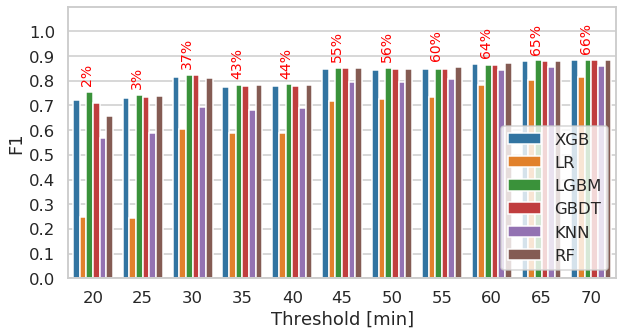

In [121]:
import seaborn as sns

sns.set_style("ticks")
sns.set_style("whitegrid")
sns.set_context("talk")

plt.figure(figsize=(9,5))
ax = sns.barplot(x="Threshold [min]", y='F1',hue='Model', data=RES)
plt.setp(ax.get_legend().get_texts(), fontsize='13')
plt.tight_layout()
plt.ylim(0,1.1)
plt.yticks(np.linspace(0,1,11))
# ax.set_yticks(np.linspace(0,1,11), minor=False)
ax.set_yticks(np.linspace(0,1,11), minor=True)
plt.grid(which='minor')

plt.legend(loc='lower right')
for i, v in enumerate(np.arange(20,71,5)):        
    ax.text(i-0.25 ,RES[RES['Threshold [min]']==v]['F1'].max()+0.025, "{}%".format(int(np.round((1-RES[RES['Threshold [min]']==v]['Perc'].max())*100,0))), color='red', size=14,va ='bottom', rotation=90)

plt.savefig('Xclassif_SF.pdf',format='pdf',bbox_inches='tight',pad_inches = 0)
#         plt.savefig('Xregression_{}_var_{}_{}.png'.format(experiment,M,f),format='png')

In [25]:
for TH in [[30],[360],[30,360]]:
    X,Y = getBFS(part=[0,-1],dataset='sf')
    for t in TH:
        print(t)
        X=X[Y!=t]
        Y=Y[Y!=t]
        print(len(Y))

30
8397
360
7740
30
8397
360
7384


In [22]:
sum(Y==30)

0

In [24]:
set(Y)

{0, 1}

In [87]:
RESULTS=[]
from sklearn.preprocessing import binarize
X,Y = getBFS(part=[0,-1],dataset='sf',threshold=45)
TOTAL=len(Y)

for TH in [[0],[29],[360],[29,360]]:
    print(TH)
    for O in OPTIMIZER:
        X,Y = getBFS(part=[0,-1],dataset='sf')
        
        for t in TH:
            X=X[Y!=t]
            Y=Y[Y!=t]
        
        Y = 1-binarize(Y.reshape(-1,1),threshold=45, copy=True).ravel()
        
        quantize(X)

        res = RandomSearchC(X,Y,model=O['instance'],params=O['param'],iters=250,jobs=56,TH=45,
                            transform='None',scenario=';lk',extra=False,OR='None')

        for M in RSOPTIONS['used_metrics']:
            upd = RSeval(res['best_metric_'+M][1])
            upd.update({'Metric':M})
            upd.update({'Model':O['name']})
            upd.update({'LDO Threshold [min]':TH})
            upd.update({'BeforeOR':TOTAL})
            upd.update({'AfterOR':len(Y)})
            RESULTS.append(upd)
RES=pd.DataFrame(RESULTS)

[0]
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 250
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=4.334334334334335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.334334334334335
[LightGBM] [Warning] lambda_l2 is set=2.0870870870870872, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0870870870870872
[LightGBM] [Warning] lambda_l1 is set=3.888888888888889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.888888888888889
[LightGBM] [Warning] lambda_l1 is set=0.10510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10510510510510511
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=0.08508508508508508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08508508508508508
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.4524524524524525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4524524524524525
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62626

[LightGBM] [Warning] lambda_l2 is set=3.6936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6936936936936937
[LightGBM] [Warning] lambda_l1 is set=3.108108108108108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.108108108108108
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=3.183183183183183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.183183183183183
[LightGBM] [Warning] lambda_l2 is set=0.2552552552552553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2552552552552553
[LightGBM] [Warning] lambda_l2 is set=1.3313313313313313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3313313313313313
[LightGBM] [Warning] lambda_l2 is set=2.3873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3873873873873874
[LightGBM] [Warning] lambda_l2 is set=1.9969969

[LightGBM] [Warning] lambda_l1 is set=1.2712712712712713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2712712712712713
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.6756756756756757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6756756756756757
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feat

[LightGBM] [Warning] lambda_l2 is set=1.2012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2012012012012012
[LightGBM] [Warning] lambda_l2 is set=4.089089089089089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089089089089089
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l1 is set=0.21521521521521522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21521521521521522
[LightGBM] [Warning] lambda_l1 is set=3.913913913913914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.913913913913914
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=3.4834834834834836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4834834834834836
[LightGBM] [Warning] lambda_l1 is set=3.3733733733733735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3733733733733735
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.58080808

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=1.8668668668668669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8668668668668669
[LightGBM] [Warning] lambda_l2 is set=0.21021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21021021021021022
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=1.7667667667667668, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7667667667667668
[LightGBM] [Warning] lambda_l1 is set=1.3413413413413413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3413413413413413
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=3.6936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6936936936936937
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=4.80980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80980980980981
[LightGBM] [Warning] lambda_l1 is set=0.8458458458458459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8458458458458459
[LightGBM] [Warning] lambda_l1 is set=1.6566566566566567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6566566566566567
[LightGBM] [Warning] lambda_l2 is set=3.4584584584584586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4584584584584586
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set

[LightGBM] [Warning] lambda_l1 is set=1.2712712712712713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2712712712712713
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l2 is set=4.1441441441441444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1441441441441444

[LightGBM] [Warning] lambda_l1 is set=3.7337337337337337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7337337337337337
[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=3.4734734734734736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4734734734734736
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=3.2682682682682684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2682682682682684
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=1.2012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2012012012012012
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=0.6506506506506506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6506506506506506
[LightGBM] [Warning] lambda_l1 is set=3.6586586586586587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6586586586586587
[LightGBM] [

[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] lambda_l2 is set=1.7667667667667668, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7667667667667668
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=3.013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.013013013013013
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l1 is set=0.7807807807807807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7807807807807807
[LightGBM] [Warning] lambda_l1 is set=1.4764764764764764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4764764764764764
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=0.5755755755755756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5755755755755756
[LightGBM] [Warning] lambda_l1 is set=3.3333333333333335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3333333333333335
[LightGBM] [Warning] lambda_l1 is set=0.8458458458458459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8458458458458459
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=3.4734734734734736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4734734734734736
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=0.18018018018018017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18018018018018017
[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035
[LightGBM] [Warning] lambda_l1 is set=3.7337337337337337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7337337337337337
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.5

[LightGBM] [Warning] lambda_l1 is set=4.2442442442442445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2442442442442445
[LightGBM] [Warning] lambda_l1 is set=0.10510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10510510510510511
[LightGBM] [Warning] lambda_l1 is set=1.6566566566566567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6566566566566567
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.013013013013013
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l1 is set=1.7017017017017018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7017017017017018
[LightGBM] [Warning] feature

[LightGBM] [Warning] lambda_l2 is set=4.089089089089089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089089089089089
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=2.4524524524524525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4524524524524525
[LightGBM] [Warning] lambda_l1 is set=2.4824824824824825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4824824824824825
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909

[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=2.0870870870870872, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0870870870870872
[LightGBM] [Warning] lambda_l1 is set=3.888888888888889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.888888888888889
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=0.5405405405405406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5405405405405406
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM

[LightGBM] [Warning] lambda_l1 is set=3.3733733733733735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3733733733733735
[LightGBM] [Warning] lambda_l1 is set=0.8458458458458459, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8458458458458459
[LightGBM] [Warning] lambda_l2 is set=4.2342342342342345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2342342342342345
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l1 is set=4.894894894894895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.894894894894895
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=0.10510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10510510510510511
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=3.183183183183183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.183183183183183
[LightGBM] [Warning] lambda_l1 is set=1.3113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3113113113113113
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.505050505050505

[LightGBM] [Warning] lambda_l1 is set=1.3413413413413413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3413413413413413
[LightGBM] [Warning] lambda_l1 is set=3.4734734734734736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4734734734734736
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=1.7667667667667668, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7667667667667668
[LightGBM] [Warning] lambda_l1 is set=3.4834834834834836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4834834834834836
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=1.921921921921922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.921921921921922
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=3.6586586586586587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6586586586586587
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[LightGBM] [Warning] lambda_l1 is set=1.4764764764764764, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4764764764764764
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=0.06506506506506507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06506506506506507
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6716716716716717
[LightGBM] [Warning] lambda_l1 is set=1.2312312312312312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2312312312312312
[LightGBM] [Warning] lambda_l1 is set=0.5405405405405406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5405405405405406
[LightGBM] [Warning] feature_fraction

[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.8618618618618619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8618618618618619
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: featur

[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] lambda_l2 is set=1.0610610610610611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0610610610610611
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=2.0820820820820822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0820820820820822
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=0.21021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21021021021021022
[LightGBM

[LightGBM] [Warning] lambda_l1 is set=2.4824824824824825, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4824824824824825
[LightGBM] [Warning] lambda_l1 is set=3.6586586586586587, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6586586586586587
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7

[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=2.1121121121121122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1121121121121122
[LightGBM] [Warning] feature_fraction is set=

[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=2.1221221221221223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1221221221221223
[LightGBM] [Warning] lambda_l1 is set=0.4854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4854854854854855
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.7017017017017018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7017017017017018

[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=3.4734734734734736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4734734734734736
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=4.049049049049049, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.049049049049049
[LightGBM] [Warning] lambda_l1 is set=0.6806806806806807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6806806806806807
[LightGBM]

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=1.4914914914914914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4914914914914914
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] 

[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=4.95995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.95995995995996
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.414414414414415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.414414414414415
[LightGBM] [Warning] lambda_l1 is set=1.926926926926927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.926926926926927
[LightGB

[LightGBM] [Warning] lambda_l2 is set=2.7577577577577577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7577577577577577
[LightGBM] [Warning] lambda_l1 is set=1.2012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2012012012012012
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=3.5585585585585586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5585585585585586
[LightGBM] [Warning] lambda_l1 is set=2.3923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3923923923923924
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.

[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] lambda_l1 is set=4.96996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.96996996996997
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_frac

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=4.029029029029029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029029029029029
[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=0.5805805805805806, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5805805805805806
[LightGBM] [Warning] lambda_l2 is set=1.3013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3013013013013013
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=3.2682682682682684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2682682682682684
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=0.7557557557557557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7557557557557557
[LightGBM] [Warning] lambda_l1 is set=2.9229229229229228, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9229229229229228
[LightGBM] [Warning] lambda_l2 is set=4.094094094094094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.094094094094094
[LightGBM] [Warning] lambda_l2 is set=4.34934934934935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.34934934934935
[LightGBM] [Warning] lambda_l2 is set=1.121

[LightGBM] [Warning] lambda_l2 is set=0.36036036036036034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36036036036036034
[LightGBM] [Warning] lambda_l1 is set=1.926926926926927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.926926926926927
[LightGBM] [Warning] lambda_l1 is set=4.95995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.95995995995996
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=0.025025025025025023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025025025025025023
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=2.4624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4624624624624625
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=3.6986986986986987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6986986986986987
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=4.094094094094094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.094094094094094
[LightGBM] [Warning] lambda_l2 is set=0.7507507507507507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7507507507507507
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l2 is set=1.3013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3013013013013013
[LightGBM] [Warning] lambda_l1 is set=1.2012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2012012012012012
[LightGBM] [Warning] lambda_l1 i

[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.23023023023023023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23023023023023023
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=0.03003003003003003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03003003003003003
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagg

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=0.4854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4854854854854855
[LightGBM] [Warning] lambda_l2 is set=3.7687687687687688, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7687687687687688
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=4.53953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.53953953953954
[LightGBM] [Warning] lambda_l1 is set=1.921921921921922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.921921921921922
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=4.944944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.944944944944945
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=3.7187187187187187, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7187187187187187
[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.080080080

[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] lambda_l1 is set=0.995995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.995995995995996
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=3.6986986986986987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6986986986986987
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is se

[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=2.4524524524524525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4524524524524525
[LightGBM] [Warning] lambda_l1 is set=1.0910910910910911, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0910910910910911
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.6566566566566567, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6566566566566567
[LightGBM] [Warning] lambda_l2 is set=1.1711711711711712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1711711711711712
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=0.47047047047047047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.47047047047047047
[LightGBM] [Warning] lambda_l2 is set=1.2262262262262262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2262262262262262
[LightGBM] [Warning] lambda_l1 is set=3.4384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4384384384384385
[LightGBM] [Warning] lambda_l1 is set=0.5005005005005005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5005005005005005
[LightGBM] [Warning] feature_fractio

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] lambda_l2 is set=2.7827827827827827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7827827827827827
[LightGBM] [Warning] lambda_l1 is set=0.995995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.995995995995996
[

[LightGBM] [Warning] lambda_l1 is set=0.6806806806806807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6806806806806807
[LightGBM] [Warning] lambda_l1 is set=4.714714714714715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.714714714714715
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=2.1321321321321323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1321321321321323
[LightGBM] [Warning] lambda_l1 is set=2.6876876876876876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6876876876876876
[LightGBM] [Warning] lambda_l2 is set=3.7687687687687688, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7687687687687688
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fracti

[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] lambda_l2 is set=3.6986986986986987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6986986986986987
[LightGBM] [Warning] lambda_l1 is set=0.995995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.995995995995996
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] featur

[LightGBM] [Warning] lambda_l2 is set=1.3663663663663663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3663663663663663
[LightGBM] [Warning] lambda_l1 is set=2.2722722722722724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2722722722722724
[LightGBM] [Warning] lambda_l2 is set=3.923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.923923923923924
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.025025025025025023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025025025025025023
[LightGBM] [Warning] lambda_l1 is set=0.7607607607607607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7607607607607607
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l2 is set=3.878878878878879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.878878878878879
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=2.2672672672672673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2672672672672673
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: f

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=2.5725725725725725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5725725725725725
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: baggin

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=1.031031031031031, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.031031031031031

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=3.5335335335335336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5335335335335336
[LightGBM] [Warning] lambda_l1 is set=2.2672672672672673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2672672672672673
[LightGBM] [Warning] lambda_l1 is set=3.4834834834834836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4834834834834836
[LightGBM] [Warning] lambda_l1 is set=1.5265265265265264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5265265265265264
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=0.2652652652652653, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2652652652652653
[LightGBM] [Warning] bagging_frac

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l2 is set=4.56956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.56956956956957
[LightGBM] [Warning] lambda_l1 is set=3.5435435435435436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5435435435435436
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=0.17517517517517517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17517517517517517
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] lambda_l2 is set=2.2222222222222223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2222222222222223
[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684684684685
[LightGBM] [Warning] lambda_l1 is set=0.36036036036036034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36036036036036034
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414

[LightGBM] [Warning] lambda_l2 is set=3.178178178178178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.178178178178178
[LightGBM] [Warning] lambda_l1 is set=3.2332332332332334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2332332332332334
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=2.6026026026026026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6026026026026026
[LightGBM] [Warning] lambda_l2 is set=2.5575575575575575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5575575575575575
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[Light

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=1.3313313313313313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3313313313313313
[LightGBM] [Warning] lambda_l1 is set=2.8278278278278277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8278278278278277
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=1.7767767767767768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7767767767767768
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[Ligh

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=3.863863863863864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.863863863863864
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=4.87987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.87987987987988
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=1.2962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2962962962962963
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=2.3723723723723724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3723723723723724
[LightGBM] [Warning] lambda_l1 is set=2.2422422422422423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2422422422422423
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=1.3413413413413413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3413413413413413
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l2 is set=1.6316316316316317, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6316316316316317
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=2.3873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3873873873873874
[LightGBM] [Warning] lambda_l1 is set=3.7687687687687688, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7687687687687688
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[Lig

[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l2 is set=0.06506506506506507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06506506506506507
[LightGBM] [Warning] lambda_l2 is set=3.178178178178178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.178178178178178
[Li

[LightGBM] [Warning] lambda_l2 is set=0.10510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10510510510510511
[LightGBM] [Warning] lambda_l1 is set=3.6336336336336337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6336336336336337
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] lambda_l1 is set=1.4864864864864864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4864864864864864
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.803803803803804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.803803803803804
[LightGBM] [Warning] lambda_l1 is set=1.6016016016016015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6016016016016015
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=1.5565565565565564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5565565565565564

[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] lambda_l2 is set=4.514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.514514514514515
[LightGBM] [Warning] lambda_l1 is set=4.87987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.87987987987988
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=1.7767767767767768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7767767767767768
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=4.934934934934935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.934934934934935
[LightGBM] [Warning] lambda_l1 is set=4.334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.334334334334335
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.6256256256256256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6256256256256256
[

[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] lambda_l1 is set=2.6926926926926926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6926926926926926
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.5575575575575575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5575575575575575
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=4.069069069069069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.069069069069069
[LightGBM] [Warning] l

[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=2.3873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3873873873873874
[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=1.3413413413413413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3413413413413413
[LightGBM] [Warning] lambda_l1 is set=4.064064064064064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.064064064064064
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=4.129129129129129, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.129129129129129
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=4.87987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.87987987987988
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] lambda_l1 is set=1.4864864864864864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4864864864864864
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=0.5405405405405406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5405405405405406
[LightGBM] [Warning] lambda_l1 is set=1.7717717717717718, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7717717717717718
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=0.40540540540540543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40540540540540543
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.8568568568568569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8568568568568569
[LightGBM] [Warning] lambda_l1 is set=3.3933933933933935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3933933933933935
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030

[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.80980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80980980980981
[LightGBM] [Warning] lambda_l1 is set=3.5035035035035036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5035035035035036
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.18018018018018017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18018018018018017
[LightGBM] [Warning] lambda_l1 is set=2.5075075075075075, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5075075075075075
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=1.1161161161161162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1161161161161162
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.8568568568568569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8568568568568569
[LightGBM] [Warning] lambda_l1 is set=3.3933933933933935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3933933933933935
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748


[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=1.0860860860860861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0860860860860861
[LightGBM] [Warning] lambda_l1 is set=0.40540540540540543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40540540540540543
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=3.903903903903904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.903903903903904
[LightGBM] [Warning] lambda_l1 is set=4.049049049049049, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.049049049049049
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=0.8058058058058059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8058058058058059
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=0.6956956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6956956956956957
[LightGBM] [Warning] lambda_l1 is set=1.1811811811811812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1811811811811812
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[L

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=4.984984984984985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.984984984984985
[LightGBM] [Warning] lambda_l2 is set=4.854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854854854854855
[LightGBM] [Warning] lambda_l1 is set=3.7837837837837838, reg_alpha=0.0 will be ignored. C

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_

[LightGBM] [Warning] lambda_l2 is set=2.8928928928928928, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8928928928928928
[LightGBM] [Warning] lambda_l2 is set=2.2972972972972974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2972972972972974
[LightGBM] [Warning] lambda_l2 is set=0.6356356356356356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6356356356356356
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=3.893893893893894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.893893893893894
[LightGBM] [Warning] lambda_l1 is set=4.314314314314315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.314314314314315
[LightGBM] [Warning] lambda_l2 is set=4.414414414414415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.414414414414415
[LightGBM] [Warning] lambda_l2 is set=2.047047047

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_b

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.6326326326326326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6326326326326326
[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051

[LightGBM] [Warning] lambda_l2 is set=3.893893893893894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.893893893893894
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=0.2752752752752753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2752752752752753
[LightGBM] [Warning] lambda_l2 is set=0.955955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.955955955955956
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[Li

[LightGBM] [Warning] lambda_l2 is set=2.9229229229229228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9229229229229228
[LightGBM] [Warning] lambda_l2 is set=4.854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854854854854855
[LightGBM] [Warning] lambda_l2 is set=2.3173173173173174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3173173173173174
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=3.878878878878879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.878878878878879
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=2.8928928928928928, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8928928928928928
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsampl

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.047047047047047, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.047047047047047
[LightGBM] [Warning] lambda_l2 is set=1.4964964964964964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4964964964964964
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=1.2762762762762763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2762762762762763


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=1.4064064064064064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4064064064064064
[LightGBM] [Warning] lambda_l1 is set=2.4924924924924925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4924924924924925
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=4.854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854854854854855
[

[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.414414414414415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.414414414414415
[LightGBM] [Warning] lambda_l2 is set=1.6316316316316317, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6316316316316317
[

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l1 is set=4.314314314314315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.314314314314315
[LightGBM] [Warning] lambda_l1 is set=1.7667667667667668, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7667667667667668
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=2.3823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3823823823823824
[LightGBM] [Warning] lambda_l2 is set=1.946946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946946946946947
[LightGBM] [Warning] lambda_l2 is set=2.9229229229229228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9229229229229228
[Ligh

[LightGBM] [Warning] lambda_l1 is set=0.12512512512512514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12512512512512514
[LightGBM] [Warning] lambda_l2 is set=2.6326326326326326, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6326326326326326
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222

[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=0.09009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09009009009009009
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.947947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.947947947947948
[LightGBM] [Warning] lambda_l1 is set=0.11511511511511512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11511511511511512
[LightGBM] [Warning] lambda_l1 is set=4.314314314314315, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.314314314314315
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=3.893893893893894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.893893893893894
[LightGBM] [Warning] lambda_l1 is set=2.4924924924924925, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4924924924924925
[LightGBM] [Warning] lambda_l2 is set=1.976976976976977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.976976976976977
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGB

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=2.3823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3823823823823824
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] lambda_l1 is set=3.108108108108108, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.108108108108108
[LightGBM] [Warning] lambda_l1 is set=0.5605605605605606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5605605605605606
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=4.854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854854854854855
[LightGBM] [Warning] lambda_l1 is set=1.7667667667667668, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7667667667667668
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=4.944944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.944944944944945
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606


[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warning] lambda_l1 is set=2.977977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.977977977977978
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=2.3173173173173174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3173173173173174
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=0.5755755755755756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5755755755755756
[LightGBM] [Warning] lambda_l1 is set=1.0510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0510510510510511


[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.14514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14514514514514515
[LightGBM] [Warning] lambda_l1 is set=3.6636636636636637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6636636636636637
[LightGBM] [Warning] lambda_l2 is set=3.4734734734734736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4734734734734736
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.974747474747

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.955955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.955955955955956
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warning] lambda_l2 is set=4.484484484484485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.484484484484485
[Li

[LightGBM] [Warning] lambda_l1 is set=2.977977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.977977977977978
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] lambda_l1 is set=1.2862862862862863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2862862862862863
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.4224224224224224, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4224224224224224
[LightGBM] [Warning] feature_

[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=0.4904904904904905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4904904904904905
[LightGBM] [Warning] lambda_l2 is set=0.7557557557557557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7557557557557557
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=0.5605605605605606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5605605605605606
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=4.854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854854854854855
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=0.11511511511511512, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11511511511511512
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=2.4974974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4974974974974975
[LightGBM] [Warnin

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] lambda_l2 is set=4.484484484484485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.484484484484485
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] lambda_l2 is set=0.14014014014014015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14014014014014015
[LightGBM] [Warning] lambda_l2 is set=1.946946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.946946946946947
[LightGBM] [Warning] lambda_l2 is set=2.0820820820820822, reg_l

[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.977977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.977977977977978
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=2.967967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.967967967967968


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=1.5565565565565564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5565565565565564
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=4.38938938938939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.38938938938939
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=3.878878878878879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.878878878878879
[LightGBM] [Warning] lambda_l1 is set=2.7777777777777777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7777777777777777
[LightGBM] [Warning] feature_fr

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=4.119119119119119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.119119119119119
[LightGBM] [Warning] lambda_l1 is set=3.173173173173173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.173173173173173
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.62121

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=1.0760760760760761, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0760760760760761
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=2.3573573573573574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3573573573573574
[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warn

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=0.14514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14514514514514515
[LightGBM] [Warning] lambda_l2 is set=3.7637637637637638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7637637637637638
[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=2.1371371371371373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1371371371371373
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=3.5585585585585586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5585585585585586
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=3.4834834834834836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4834834834834836
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: featur

[LightGBM] [Warning] lambda_l2 is set=3.013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.013013013013013
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.029029029029029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029029029029029
[LightGBM] [Warning] lambda_l2 is set=4.119119119119119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.119119119119119
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l2 is set=1.2912912912912913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2912912912912913
[LightGBM] [Warning] lambda_l1 is set=4.564564564564565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564564564564565
[LightGBM] [Warning] lambda_l1 is set=1.3513513513513513, reg_

[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=3.4734734734734736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4734734734734736
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.70707

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=4.41941941941942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.41941941941942
[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=1.3863863863863863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.38638638638

[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=1.7167167167167168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7167167167167168
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=0.36536536536536535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36536536536536535
[LightGBM] [Warning] lambda_l1 is set=3.6086086086086087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6086086086086087
[LightGBM] [Warning] lambda_l2 is set=0.8658658658658659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8658658658658659
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=2.967967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.967967967967968
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current v

[LightGBM] [Warning] lambda_l1 is set=3.5885885885885886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5885885885885886
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.854854854854855
[LightGBM] [Warning] lambda_l2 is set=3.128128128128128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.128128128128128
[LightGBM] [Warning] lambda_l1 is set=1.7667667667667668, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7667667667667668
[LightGBM] [Warning] lambda_l1 is set=3.6536536536536537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6536536536536537
[LightGBM] [Warning] feature_fractio

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=0.22022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22022022022022023
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=3.913913913913914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.913913913913914
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=4.654654654654655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.654654654654655
[LightGBM]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=3.093093093093093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.093093093093093
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] lambda_l2 is set=3.818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.818818818818819
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=4.80980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80980980980981
[LightGBM] [Warning] lambda_l1 is set=4.91991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.91991991991992
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=0.11511511511511512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11511511511511512
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=2.7377377377377377, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7377377377377377
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l2 is set=3.103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.103103103103103
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.178178178178178, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.178178178178178
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=2.7927927927927927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7927927927927927
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=3.878878878878879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.878878878878879
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=3.008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.008008008008008
[LightGBM] [Warning] lambda_l1 is set=3.6536536536536537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6536536536536537
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=4.044044044044044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.044044044044044
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=1.3963963963963963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3963963963963963
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763763
[LightGBM] [Warning] lambda_l2 is set=1.1961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1961961961961962
[LightGBM] [Warning] lambda_l2 is set=2.3523523523523524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3523523523523524
[LightGBM] [Warning] lambda_l1 is set=1.2862862862862863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2862862862862863
[LightGBM] [Warning] lambda_l1 is set=2.6326326326326326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6326326326326326
[LightGBM] [Warning] lambda_l1 is set=3.3083083083083085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3083083083083085
[LightGBM] [Warning] lambda_l1 is set=2.7927927927927927, reg_alp

[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=3.013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.013013013013013
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] lambda_l2 is set=3.818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.818818818818819
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=1.2612612612612613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2612612612612613
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l2 is set=4.044044044044044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.044044044044044
[Light

[LightGBM] [Warning] lambda_l1 is set=3.3883883883883885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3883883883883885
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l2 is set=0.45545545545545546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45545545545545546
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l1 is set=0.39539539539539537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39539539539539537
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l1 is set=1.8768768768768769, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.87687687687687

[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=2.3523523523523524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3523523523523524
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=3.013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.013013013013013
[LightGBM] [Warning] lambda_l1 is set=4.564564564564565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564564564564

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=3.7787787787787788, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7787787787787788
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=1.2862862862862863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2862862862862863
[LightGBM] [Warning] lambda_l2 is set=3.3183183183183185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3183183183183185
[LightGBM] [Warning] lambda_l2 is set=4.1541541541541545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1541541541541545
[LightGBM] [Warning] lambda_l2 is set=0.45545545545545546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45545545545545546
[LightGBM] [Warning] feature_fraction

[LightGBM] [Warning] lambda_l1 is set=3.3083083083083085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3083083083083085
[LightGBM] [Warning] lambda_l1 is set=3.6086086086086087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6086086086086087
[LightGBM] [Warning] lambda_l1 is set=2.7377377377377377, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7377377377377377
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565

[LightGBM] [Warning] lambda_l1 is set=4.054054054054054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.054054054054054
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=0.46546546546546547, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46546546546546547
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l1 is set=1.3513513513513513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3513513513513513
[LightGBM] [Warning] ba

[LightGBM] [Warning] lambda_l1 is set=4.564564564564565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564564564564565
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=1.3863863863863863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3863863863863863
[LightGBM] [Warning] lambda_l2 is set=3.5385385385385386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5385385385385386
[LightGBM] [Warning] lambda_l1 is set=0.4904904904904905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4904904904904905
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=2.0920920920920922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0920920920920922
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.6676676676676676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6676676676676676
[LightGBM] [Warning] lambda_l1 is set=0.12012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12012012012012012
[LightGBM] [Warning] b

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=1.646

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=4.36936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.36936936936937
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=0.45545545545545546, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45545545545545546
[LightGBM] [Warning] lambda_l1 is set=0.21021021021021022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21021021021021022
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] lambda_l1 is set=1.4064064064064064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4064064064064064
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l1 is set=0.46546546546546547, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46546546546546547
[LightGBM] [Warning] lambda_l2 is set=1.3963963963963963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3963963963963963
[LightGBM

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=4.724724724724725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.724724724724725
[LightGBM] [Warning] lambda_l2 is set=4.069069069069069, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.069069069069069
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l1 is set=1.4264264264264264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4264264264264264
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.1311311311311312, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1311311311311312
[LightGBM] [Warning] feature_fraction is set=

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=3.168168168168168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.168168168168168
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=0.20520520520520522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20520520520520522
[LightGBM] [Warning] lambda_l1 is set=2.8578578578578577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8578578578578577
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.727272727272727

[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=4.2842842842842845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2842842842842845
[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l1 is set=2.6126126126126126, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6126126126126126
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=1.1311311311311312, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1311311311311312
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.5405405405405406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5405405405405406
[LightGBM] [Warning] lambda_l1 is set=3.168168168168168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.168168168168168
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=3.5435435435435436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5435435435435436
[LightGBM] [Warning] lambda_l1 is set=1.1561561561561562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1561561561561562
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=1.7267267267267268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7267267267267268
[LightGBM] [Warning] lambda_l1 is set=4.86986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.86986986986987
[LightGBM] [Warning] featu

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=0.050050050050050046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050050050050050046
[LightGBM] [Warning] lambda_l1 is set=2.3423423423423424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3423423423423424
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] lambda_l1 is set=2.3673673673673674, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3673673673673674
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[Li

[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=4.36936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.36936936936937
[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010

[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=0.050050050050050046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050050050050050046
[LightGBM] [Warning] lambda_l1 is set=2.3423423423423424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3423423423423424
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=1.7267267267267268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.726726726726

[LightGBM] [Warning] lambda_l1 is set=3.018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.018018018018018
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=4.079079079079079, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.079079079079079
[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[Light

[LightGBM] [Warning] lambda_l2 is set=0.8408408408408409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8408408408408409
[LightGBM] [Warning] lambda_l1 is set=1.956956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.956956956956957
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=0.7907907907907907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7907907907907907
[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=2.7177177177177176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7177177177177176
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=3.3683683683683685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3683683683683685
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=4.079079079079079, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.079079079079079
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=0.970970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.970970970970971
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] lambda_l1 is set=2.6576576576576576, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6576576576576576
[

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=1.1361361361361362, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1361361361361362
[LightGBM] [Warning] lambda_l1 is set=4.654654654654655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.654654654654655
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=3.4884884884884886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4884884884884886
[LightGBM] [Warning] lambda_l1 is set=1.5865865865865865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5865865865865865
[LightGBM] [Warning]

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[LightGBM] [Warning] lambda_l2 is set=4.134134134134134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.134134134134134
[LightGBM] [Warning] lambda_l1 is set=3.5135135135135136, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5135135135135136
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=1.4364364364364364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4364364364364364
[LightGBM] [Warning] lambda_l2 is set=0.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0
[LightGBM] [Warning] lambda_l1 is set=2.92792792792

[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=3.958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.958958958958959
[LightGBM] [Warning] lambda_l1 is set=2.967967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.967967967967968
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=0.17517517517517517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.17517517517517517
[LightGBM] [Warning] lambda_l1 is set=4.954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.954954954954955
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.5265265265265264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5265265265265264
[LightGBM] [Warning] lambda_l1 is set=0.39039039039039036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.39039039039039036
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=0.8408408408408409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.840840840840

[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.3683683683683685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3683683683683685
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.958958958958959
[LightGBM] [Warning] lambda_l2 is set=3.4884884884884886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4884884884884886
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[Light

[LightGBM] [Warning] lambda_l2 is set=0.8408408408408409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8408408408408409
[LightGBM] [Warning] lambda_l1 is set=1.956956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.956956956956957
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.4364364364364364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4364364364364364
[LightGBM] [Warning] lambda_l1 is set=2.9279279279279278, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9279279279279278
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=4.38938938938939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.38938938938939
[LightGBM] [Warning] lambda_l1 is set=2.4024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4024024024024024
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.5015015015015014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5015015015015014
[LightGBM] [Warning] lambda_l1 is set=4.914914914914915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.914914914914915
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=4.914914914914915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.914914914914915
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=2.6376376376376376, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6376376376376376
[LightGBM] [Warning] lambda_l1 is set=1.3713713713713713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3713713713713713
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 250
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


[360]
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 250
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=3.158158158158158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.158158158158158
[LightGBM] [Warning] lambda_l1 is set=3.828828828828829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.828828828828829
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignore

[LightGBM] [Warning] lambda_l1 is set=3.983983983983984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.983983983983984
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=1.8618618618618619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8618618618618619


[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=0.7057057057057057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7057057057057057
[LightGBM] [Warning] lambda_l2 is set=2.1871871871871873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1871871871871873
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] lambda_l2 is set=2.5225225225225225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5225225225225225
[LightGBM] [Warning] lambda_l2 is set=2.972972972972973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.972972972972973
[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.

[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=2.6926926926926926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6926926926926926
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] lambda_l1 is set=4.1591591591591595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1591591591591595
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87

[LightGBM] [Warning] lambda_l2 is set=1.6566566566566567, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6566566566566567
[LightGBM] [Warning] lambda_l1 is set=3.983983983983984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.983983983983984
[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=0.7607607607607607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7607607607607607
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.8618618618618619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8618618618618619
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=2.9079079079079078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9079079079079078
[LightGBM] [Warning] lambda_l2 is set=0.7657657657657657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7657657657657657
[LightGBM] [Warning] lambda_l1 is set=0.7057057057057057,

[LightGBM] [Warning] lambda_l1 is set=3.2882882882882885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2882882882882885
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=4.84984984984985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.84984984984985
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.764764764764765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.764764764764765
[LightGBM] [Warning] lambda_l1 is set=2.6926926926926926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6926926926926926
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.969

[LightGBM] [Warning] lambda_l2 is set=4.124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124124124124124
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=3.3933933933933935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3933933933933935
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=0.8158158158158159, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8158158158158159
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] lambda_l1 is set=2.7677677677677677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7677677677677677
[LightGBM] [Warning] lambda_l2 is set=1.4414414414414414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4414414414414414
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l1 is set=1.1561561561561562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1561561561561562
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=0.9109109109109109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9109109109109109
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=0.22522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22522522522522523
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[Li

[LightGBM] [Warning] lambda_l1 is set=0.6756756756756757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6756756756756757
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=2.3873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3873873873873874
[LightGBM] [Warning] lambda_l1 is set=4.704704704704705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.704704704704705
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=3.193193193193193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.193193193193193
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bag

[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6716716716716717
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] lambda_l1 is set=1.5765765765765765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5765765765765765
[LightGBM] [Warning] lambda_l1 is set=0.7057057057057057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7057057057057057
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=3.983983983983984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.983983983983984
[LightGBM] [Warning] lambda_l1 is set=0.8158158158158159, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8158158158158159
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=0.7657657657657657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7657657657657657
[Light

[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=0.6856856856856857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6856856856856857
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=0.950950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.950950950950951
[LightGBM] [Warning] lambda_l1 is set=1.2412412412412412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2412412412412412
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.394394394394395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.394394394394395
[LightGBM] [Warning] lambda_l1 is set=3.908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.908908908908909
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_f

[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=0.17017017017017017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17017017017017017
[LightGBM] [Warning] lambda_l1 is set=1.1561561561561562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1561561561561562
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=1.971971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.971971971971972
[LightGBM] [Warning] lambda_l2 is set=1.6766766766766767, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6766766766766767
[LightGBM] [Warning] baggi

[LightGBM] [Warning] lambda_l2 is set=3.158158158158158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.158158158158158
[LightGBM] [Warning] lambda_l2 is set=3.5835835835835836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5835835835835836
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] lambda_l1 is set=2.6876876876876876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6876876876876876
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM]

[LightGBM] [Warning] lambda_l1 is set=1.4564564564564564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4564564564564564
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=1.8618618618618619, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8618618618618619
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=3.193193193193193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.193193193193193
[LightGBM] [Warning] lambda_l2 is set=3.843843843843844, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.843843843843844
[LightGBM] [Warning] lambda_l2 is set=2.1271271271271273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1271271271271273
[LightGBM] [Warning] bagging_fract

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=3.908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.908908908908909
[LightGBM] [Warning] lambda_l2 is set=1.1711711711711712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1711711711711712
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] lambda_l1 is set=3.068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.068068068068068
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=2.5225225225225225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5225225225225225
[LightGBM] [Warning] lambda_l1 is set=0.17017017017017017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.17017017017017017
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is s

[LightGBM] [Warning] lambda_l2 is set=2.5875875875875876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5875875875875876
[LightGBM] [Warning] lambda_l1 is set=2.1421421421421423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1421421421421423
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=1.3363363363363363, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3363363363363363
[LightGBM] [Warning] lambda_l1 is set=2.3573573573573574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3573573573573574
[LightGBM] [Warning] lambda_l2 is set=2.7477477477477477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7477477477477477
[LightGBM] [Warning] bagging_fraction is set=0.63131313131313

[LightGBM] [Warning] lambda_l2 is set=1.5365365365365364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5365365365365364
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=2.2672672672672673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2672672672672673
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=2.2172172172172173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2172172172172173
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] lambda_l1 is set=4.86986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.86986986986987
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=4.764764764764765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.764764764764765
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] lambda_l1 is set=2.7777777777777777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7777777777777777
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=0.6706706706706707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6706706706706707
[LightGBM] [Warning] lambda_l2 is set=3.858858858858859, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.858858858858859
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=0.5405405405405406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5405405405405406
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_f

[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=0.8408408408408409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8408408408408409
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=4.45945945945946, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.45945945945946
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=4.414414414414415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.414414414414415
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.4564564564564564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.45645645645

[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=3.808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.808808808808809
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=3.5835835835835836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5835835835835836
[LightGBM] [Warning] lambda_l1 is set=2.6926926926926926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6926926926926926
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334

[LightGBM] [Warning] lambda_l1 is set=0.3353353353353353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3353353353353353
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] lambda_l2 is set=3.3733733733733735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3733733733733735
[LightGBM] [Warning] lambda_l1 is set=4.77977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.77977977977978
[LightGBM] [Warning] la

[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=2.7477477477477477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7477477477477477
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightG

[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=3.113113113113113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.113113113113113
[LightGBM] [Warning] lambda_l1 is set=1.4564564564564564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4564564564564564
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=0.975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.975975975975976
[Light

[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=3.5835835835835836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5835835835835836
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=2.2172172172172173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2172172172172173
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] featur

[LightGBM] [Warning] lambda_l2 is set=3.113113113113113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.113113113113113
[LightGBM] [Warning] lambda_l2 is set=1.926926926926927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.926926926926927
[LightGBM] [Warning] lambda_l1 is set=1.0810810810810811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0810810810810811
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=3.798798798798799, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.798798798798799
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] lambda_l2 is set=

[LightGBM] [Warning] lambda_l2 is set=3.053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.053053053053053
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] lambda_l1 is set=3.3233233233233235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3233233233233235
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=2.977977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.977977977977978
[LightGBM] [Warning] lam

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.888888888888889
[LightGBM] [Warning] lambda_l1 is set=0.35535535535535534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35535535535535534
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=4.414414414414415, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.414414414414415
[LightGBM] [Warning] fe

[LightGBM] [Warning] lambda_l1 is set=0.8658658658658659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8658658658658659
[LightGBM] [Warning] lambda_l2 is set=2.8928928928928928, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8928928928928928
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.30030030030030

[LightGBM] [Warning] lambda_l1 is set=4.77977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.77977977977978
[LightGBM] [Warning] lambda_l2 is set=4.66966966966967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.66966966966967
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM]

[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=0.8308308308308309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8308308308308309
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=1.8818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8818818818818819
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] lambda_l1 is set=4.37937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.37937937937938
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=1.971971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.971971971971972
[LightGBM] [Warning] lambda_l2 is set=4.594594594594595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.594594594594595
[LightGBM] [Warning] lambda_l1 is set=0.5205205205205206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5205205205205206
[LightGBM] [Warning] lambda_l1 is set=3.6386386386386387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6386386386386387
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=1.0710710710710711, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0710710710710711
[LightGBM] [Warning] lambda_l1 is set=0.8658658658658659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8658658658658659
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=1.6916916916916918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6916916916916918
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=0.6206206206206206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6206206206206206
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] lambda_l1 is set=3.6386386386386387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6386386386386387
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=2.5525525525525525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=1.5565565565565564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5565565565565564
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [

[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=2.027027027027027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.027027027027027
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=4.089089089089089, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.089089089089089
[LightGBM] [Warning] lambda_l2 is set=0.6006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6006006006006006
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=4.624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.624624624624625
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=1.5265265265265264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5265265265265264
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=2.042042042042042, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.042042042042042
[LightGBM] [Warning] lambda_l1 is set=2.4774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4774774774774775
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l1 is set=1.2512512512512513, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2512512512512513
[LightGBM] [Warning] lambda_l2 is set=0.13013013013013014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13013013013013014
[LightGBM] [Warning] lambda_l1 is set=1.0810810810810811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0810810810810811
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=1.971971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.971971971971972
[LightGBM] [Warning] lambda_l1 is set=0.5205205205205206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5205205205205206
[LightGBM] [Warning] feature_fra

[LightGBM] [Warning] lambda_l1 is set=1.6916916916916918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6916916916916918
[LightGBM] [Warning] lambda_l1 is set=4.4994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.4994994994995
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=3.883883883883884, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.883883883883884
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=1.3463463463463463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3463463463463463
[LightGBM] [Warning] lambda_l2 is set=2.5525525525525525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5525525525525525
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l1 is set=1.5565565565565564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5565565565565564
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.787878787878787

[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=0.8308308308308309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8308308308308309
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] lambda_l2 is set=3.3383383383383385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3383383383383385
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=2.2822822822822824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2822822822822824
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=0.6206206206206206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.62062062062062

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=0.03003003003003003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03003003003003003
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=1.971971971971972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.971971971971972
[LightGBM] [Warning] lambda_l2 is set=4.1641641641641645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1641641641641645
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[Light

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=3.4534534534534536, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4534534534534536
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] lambda_l1 is set=3.6036036036036037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6036036036036037
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=1.6266266266266267, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6266266266266267
[LightGBM] [Warning] lambda_l1 is set=0.46546546546546547, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46546546546546547
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.1621621621621623, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1621621621621623
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=1.6066066066066067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6066066066066067
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] lambda_l1 is set=0.6006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6006006006006006
[LightGBM] [Warning] lambda_l1 is set=0.6556556556556556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6556556556556556
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=3.958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.958958958958959
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=3.5135135135135136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5135135135135136
[

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] lambda_l2 is set=0.04504504504504504, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04504504504504504
[LightGBM] [Warning] lambda_l1 is set=4.084084084084084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.084084084084084
[LightGBM] [Warning] lambda_l1 is set=0.6306306306306306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6306306306306306
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=3.2332332332332334, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2332332332332334
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696

[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757
[LightGBM] [Warning] lambda_l1 is set=1.5265265265265264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5265265265265264
[LightGBM] [Warning] lambda_l1 is set=2.2272272272272273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2272272272272273
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.5765765765765765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5765765765765765
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=1.8918918918918919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8918918918918919
[LightGBM] [Warning] lambda_l2 is set=3.6686686686686687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6686686686686687
[LightGBM] [Warning] lambda_l1 is set=3.818818818818819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.818818818818819
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=2.7677677677677677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7677677677677677
[LightGBM] [Warning] lambda_l1 is set=0.8758758758758759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8758758758758759
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] lambda_l1 is set=3.828828828828829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.828828828828829
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l1 is set=1.921921921921922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.921921921921922
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.5765765765765765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5765765765765765
[LightGBM] [Warning] lambda_l1 is set=3.5085085085085086, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.508508508508

[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=2.8128128128128127, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8128128128128127
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[

[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] lambda_l1 is set=0.14514514514514515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14514514514514515
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=4.62962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.62962962962963
[LightGBM] [Warning] lambda_l1 is set=2.6776776776776776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6776776776776776
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=3.083083083083083, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.083083083083083
[LightGBM] [Warning] lambda_l1 is set=2.5825825825825826, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5825825825825826
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=2.8578578578578577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8578578578578577
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=3.7637637637637638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7637637637637638
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=0.6756756756756757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6756756756756757
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=2.6776776776776776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6776776776776776
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] lambda_l1 is set=0.14514514514514515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14514514514514515
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829


[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] lambda_l1 is set=3.193193193193193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193193193193193
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=3.953953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953953953953954
[LightGBM] [Warning] lambda_l1 is set=3.198198198198198, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.198198198198198
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=1.1711711711711712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1711711711711712
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] feature_fraction is set=0.59595

[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Warning] lambda_l2 is set=2.942942942942943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.942942942942943
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=0.8758758758758759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8758758758758759
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=1.1711711711711712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1711711711711712
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[L

[LightGBM] [Warning] lambda_l2 is set=2.942942942942943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.942942942942943
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=4.82982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.82982982982983
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.59

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] lambda_l1 is set=4.344344344344345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.344344344344345
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] lambda_l1 is set=4.344344344344345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.344344344344345
[LightGBM] [Warning] f

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)


RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.50950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.50950950950951
[LightGBM] [Warning] lambda_l1 is set=1.5365365365365364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365365365365364
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will

[LightGBM] [Warning] lambda_l2 is set=2.6276276276276276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6276276276276276
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=0.2502502502502503, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2502502502502503
[Li

[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] lambda_l2 is set=4.614614614614615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.614614614614615
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=0.8558558558558559, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8558558558558559
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.96969696969

[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] lambda_l1 is set=0.20020020020020018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20020020020020018
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] featur

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=2.3723723723723724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3723723723723724
[LightGBM] [Warning] lambda_l2 is set=4.80980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80980980980981
[LightGBM] [Warning] lambda_l2 is set=0.6106106106106106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6106106106106106
[LightGBM] [Warning] lambda_l2 is set=3.7587587587587588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7587587587587588
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=1.996996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.996996996996997
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=1.4114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4114114114114114
[LightGBM] [Warning] lambda_l2 is set=0.38538538538538536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38538538538538536
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=3.078078078078078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.078078078078078
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning] lambda_l2 is set=0.2502502502502503, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2502502502502503
[LightGBM] [Warning] lambda_l2 is set=2.5825825825825826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5825825825825826
[LightGBM] [Warning] lambda_l2 is set=4.614614614614615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.614614614614615
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] feature_fraction is set=0.96

[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=0.47047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47047047047047047
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=0.13013013013013014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13013013013013014
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current 

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.40040040040040037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40040040040040037
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=3.4834834834834836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4834834834834836
[LightGBM] [Warning] lambda_l2 is set=4.494494494494495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.494494494494495
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=1.6816816816816818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6816816816816818
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909

[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] lambda_l1 is set=3.883883883883884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.883883883883884
[LightGBM] [Warning] lambda_l1 is set=0.5655655655655656, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5655655655655656
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warning] lambda_l1 is set=0.22022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22022022022022023
[LightGBM] [Warning] lambda_l1 is set=3.6186186186186187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6186186186186187
[LightGBM] [Warning] lambda_l2 is set=2.6326326326

[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] lambda_l1 is set=0.20020020020020018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20020020020020018
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=1.2612612612612613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2612612612612613
[Light

[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.6106106106106106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6106106106106106
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=2.4874874874874875, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4874874874874875
[LightGBM] [Warning] lambda_l1 is set=4.2142142142142145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2142142142142145
[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=0.4854854854854855, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4854854854854855
[LightGBM] [Warning] lambda_l1 is set=0.13013013013013014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13013013013013014
[LightGBM] [Warning] lambda_l1 is set=3.6186186186186187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6186186186186187
[LightGBM] [Warning] lambda_l2 is set=2.

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.894894894894895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.894894894894895
[LightGBM] [Warning] lambda_l1 is set=3.7387387387387387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7387387387387387
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction

[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=2.2322322322322323, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2322322322322323
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=1.4014014014014013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.40

[LightGBM] [Warning] lambda_l1 is set=1.5715715715715715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5715715715715715
[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] lambda_l2 is set=4.124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124124124124124
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=3.2182182182182184, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2182182182182184
[LightGBM] [Warning] lambda_l1 is set=1.8168168168168168, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8168168168168168
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l1 is set=3.6186186186186187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6186186186186187
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Cur

[LightGBM] [Warning] lambda_l2 is set=1.4114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4114114114114114
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=4.014014014014014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014014014014014
[LightGBM] [Warning] lambda_l1 is set=0.47047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47047047047047047
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=3.823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.823823823823824
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=4.82982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.82982982982983
[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[LightGBM]

[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] lambda_l1 is set=3.2332332332332334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2332332332332334
[LightGBM] [Warning] lambda_l1 is set=2.017017017017017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.017017017017017
[LightG

[LightGBM] [Warning] lambda_l2 is set=3.5085085085085086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5085085085085086
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] lambda_l1 is set=1.0760760760760761, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0760760760760761
[LightGBM] [Warning] lambda_l2 is set=1.1111111111111112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1111111111111112
[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] lambda_l1 is set=4.904904904904905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.904904904904905
[LightGBM] [Warning] feature_fraction is set=0.646464646

[LightGBM] [Warning] lambda_l2 is set=1.7867867867867868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7867867867867868
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=3.3633633633633635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3633633633633635
[LightGBM] [Warning] lambda_l2 is set=0.8558558558558559, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8558558558558559
[LightGBM] [Warning] lambda_l2 is set=1.4564564564564564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4564564564564564
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=0.08508508508508508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08508508508508508
[LightGBM] [Warning] feature_

[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=1.1461461461461462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1461461461461462
[LightGBM] [Warning] lambda_l1 is set=0.06006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06006006006006006
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_f

[LightGBM] [Warning] lambda_l1 is set=2.8778778778778777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8778778778778777
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.7507507507507507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7507507507507507
[LightGBM] [Warning] lambda_l1 is set=4.82982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.82982982982983
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=4.664664664664665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.664664664664665
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] lambda_l1 is set=2.2822822822822824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2822822822822824
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[Lig

[LightGBM] [Warning] lambda_l2 is set=4.1691691691691695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1691691691691695
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] lambda_l1 is set=1.0360360360360361, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0360360360360361
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.66666666

[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[

[LightGBM] [Warning] lambda_l2 is set=2.4874874874874875, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4874874874874875
[LightGBM] [Warning] lambda_l1 is set=4.2142142142142145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2142142142142145
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=4.744744744744745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.744744744744745
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.2432432432432434, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2432432432432434
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGB

[LightGBM] [Warning] lambda_l1 is set=2.002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.664664664664665, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.664664664664665
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=2.1571571571571573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1571571571571573
[LightGBM] [Warning] lambda_l2 is set=4.38938938938939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.38938938938939
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=2.8428428428428427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8428428428428427
[LightGBM] [Warning] lambda_l2 is set=2.3123123123123124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.31231231231231

[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=2.1721721721721723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1721721721721723
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=3.5085085085085086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5085085085085086
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fract

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=0.13013013013013014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13013013013013014
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=3.6586586586586587, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6586586586586587
[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112
[LightGBM] [Warning] lambda_l1 is set=2.3773773773773774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3773773773773774
[LightGBM] [Warning] lambda_l1 is set=2.9029029029029028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9029029029029028
[LightGBM] [Warning] lambda_l2 is set

[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=2.3123123123123124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.31231231231

[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.3913913913913913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3913913913913913
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.6786786786786787, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6786786786786787
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.565656565656565

[LightGBM] [Warning] lambda_l1 is set=3.2582582582582584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2582582582582584
[LightGBM] [Warning] lambda_l1 is set=0.09009009009009009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09009009009009009
[LightGBM] [Warning] lambda_l1 is set=0.38038038038038036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38038038038038036
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=1.4414414414414414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4414414414414414
[LightGBM] [Warning] lambda_l1 is set=2.4774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4774774774774775
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.883838383838383

[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=1.3013013013013013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3013013013013013
[LightGBM] [Warning] lambda_l2 is set=0.23523523523523523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23523523523523523
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=4.864864864864865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.864864864864865
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=3.3883883883883885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3883883883883885
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=2.1721721721721723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1721721721721723
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575
[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=4.58958958958959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.58958958958959
[LightGBM] [Warning] feature_fraction

[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.1061061061061062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1061061061061062
[LightGBM] [Warning] lambda_l1 is set=0.7257257257257257, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7257257257257257
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=4.2642642642642645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2642642642642645
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263

[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lamb

[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=0.02002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02002002002002002
[LightGBM] [Warning] lambda_l1 is set=2.8428428428428427, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8428428428428427
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning] feature_fra

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=0.23523523523523523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23523523523523523
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=4.864864864864865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.864864864864865
[LightGBM] [Warning] lambda_l2 is set=4.314314314314315, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.314314314314315

[LightGBM] [Warning] lambda_l2 is set=3.6786786786786787, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6786786786786787
[LightGBM] [Warning] lambda_l1 is set=3.4634634634634636, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4634634634634636
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=0.22522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22522522522522523
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=4.96996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.96996996996997
[LightGBM] [Warning] lambda_l2 is set=2.4124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4124124124124124
[LightGBM] [Warning] lambda_l1 is set=4.2192192192192195, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2192192192192195
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] lambda_l1 is set=4.484484484484485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.484484484484485
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112


[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=1.4414414414414414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4414414414414414
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=3.2582582582582584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2582582582582584
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.3123123123123124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3123123123123124
[LightGBM] [Warning] lambda_l1 is set=2.4774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4774774774774775
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=2.8478478478478477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8478478478478477
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0

[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=4.594594594594595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.594594594594595
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=2.3773773773773774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3773773773773774
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=3.2482482482482484, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2482482482482484
[L

[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.61961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.61961961961962
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] lambda_l1 is set=2.2172172172172173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2172172172172173
[LightGBM] [Warning] lambda_l1 is set=3.5935935935935936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5935935935935936
[LightGBM] [Warning] f

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l2 is set=4.57957957957958, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.57957957957958
[LightGBM] [Warning] lambda_l2 is set=3.888888888888889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.888888888888889
[LightGBM] [Warning] lambda_l2 is set=2.4024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4024024024024024
[LightGBM] [Warning] lambda_l1 is set=0.8358358358358359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8358358358358359
[LightGBM] [Warning] lambda_l1 is set=4.1841841841841845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1841841841841845
[LightGBM] [Warning] lambda_l1 is set=2.037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.037037037037037
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.8838383838383

[LightGBM] [Warning] lambda_l1 is set=0.7357357357357357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7357357357357357
[LightGBM] [Warning] lambda_l1 is set=3.803803803803804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.803803803803804
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.6406406406406406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6406406406

[LightGBM] [Warning] lambda_l1 is set=4.109109109109109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109109109109109
[LightGBM] [Warning] lambda_l2 is set=1.0960960960960962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0960960960960962
[LightGBM] [Warning] lambda_l1 is set=2.8278278278278277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8278278278278277
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=4.064064064064064, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.064064064064064
[LightGBM] [Warning] lambda_l1 is set=1.4264264264264264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4264264264264264
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.954545454545

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=0.6656656656656657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6656656656656657
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=3.4184184184184185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4184184184184185
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] lambda_l1 is set=1.7767767767767768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7767767767767768
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=2.4024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4024024024024024
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.037037037037037
[LightGBM] [Warning] lambda_l2 is set=0.7157157157157157, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7157157157157157
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=2.997997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.997997997997998
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] lambda_l1 is set=0.8658658658658659, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8658658658658659
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGB

[LightGBM] [Warning] lambda_l1 is set=0.40040040040040037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40040040040040037
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=3.3883883883883885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3883883883883885
[LightGBM] [Warning] lambda_l1 is set=4.119119119119119, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.119119119119119
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303


[LightGBM] [Warning] lambda_l1 is set=0.970970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970970970970971
[LightGBM] [Warning] lambda_l1 is set=1.0810810810810811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0810810810810811
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.1871871871871873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1871871871871873
[LightGBM] [Warning] lambda_l1 is set=4.109109109109109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109109109109109
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=2.962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962962962962963
[LightGBM] [Warning] lambda_l1 is set=3.803803803803804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.803803803803804
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[Lig

[LightGBM] [Warning] lambda_l2 is set=4.764764764764765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.764764764764765
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=3.7237237237237237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237237237237237
[LightGBM] [Warning] lambda_l1 is set=1.4714714714714714, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4714714714714714
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=1.5015015015015014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5015015015015014
[LightGBM] [Warning] lambda_l1 is set=4.93993993993994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.93993993993994
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=2.962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962962962962963
[LightGBM] [Warning] lambda_l1 is set=3.803803803803804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.803803803803804
[LightGBM] [Warning] feature

[LightGBM] [Warning] lambda_l2 is set=3.988988988988989, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.988988988988989
[LightGBM] [Warning] lambda_l1 is set=0.7357357357357357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7357357357357357
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=2.4024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4024024024024024
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l1 is set=0.970970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970970970970971
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.988988988988989, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.988988988988989
[LightGBM] [Warning] lambda_l1 is set=2.1521521521521523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1521521521521523
[LightGBM] [Warning] lambda_l2 is set=0.7157157157157157, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7157157157157157
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=2.1921921921921923, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1921921921921923
[LightGBM] [Warning] lambda_l1 is set=1.6666666666666667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=3.3983983983983985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3983983983983985
[Light

[LightGBM] [Warning] lambda_l1 is set=4.2742742742742745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2742742742742745
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] lambda_l1 is set=0.5555555555555556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.868686868686868

[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.7107107107107107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7107107107107107
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=3.998998998998999, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.998998998998999
[LightGBM] [Warning] lambda_l1 is set=1.6766766766766767, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6766766766766767
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=3.7537537537537538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7537537537537538
[LightGBM] [Warning] lambda_l1 is set=1.8468468468468469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8468468468468469
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=3.7537537537537538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7537537537537538
[LightGBM] [Warning] lambda_l1 is set=1.8468468468468469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8468468468468469
[LightGBM] [Warnin

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/agrigore/anaconda3/lib/python3.7/site-packages

RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 250
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 250


In [94]:
RES

,F1,Metric,Model,LDO Threshold [min],BeforeOR,AfterOR,Outlier removed [min]
0,0.848187,F1,XGB,[0],8753,8753,[0]
1,0.713910,F1,LR,[0],8753,8753,[0]
2,0.850469,F1,LGBM,[0],8753,8753,[0]
3,0.848797,F1,GBDT,[0],8753,8753,[0]
4,0.795406,F1,KNN,[0],8753,8753,[0]
5,0.854734,F1,RF,[0],8753,8753,[0]
6,0.754769,F1,XGB,[29],8753,6416,[29]
7,0.567456,F1,LR,[29],8753,6416,[29]
8,0.758007,F1,LGBM,[29],8753,6416,[29]
9,0.758614,F1,GBDT,[29],8753,6416,[29]


In [89]:
RES['LDO Threshold [min]'] = RES['LDO Threshold [min]'].apply(lambda v: str(v))

In [90]:
RES['Outlier removed [min]'] = RES['LDO Threshold [min]']

In [96]:
RES.iloc[:6]['Outlier removed [min]']='-'

/home/agrigore/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


-
[29]
[360]
[29, 360]


/home/agrigore/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


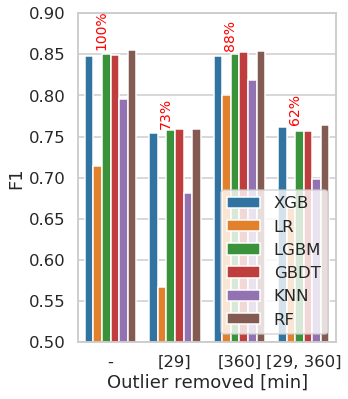

In [101]:
import seaborn as sns

sns.set_style("ticks")
sns.set_style("whitegrid")
sns.set_context("talk")

plt.figure(figsize=(5,5.8))
ax = sns.barplot(x="Outlier removed [min]", y='F1',hue='Model', data=RES)
plt.setp(ax.get_legend().get_texts(), fontsize='13')
plt.tight_layout()
plt.ylim(0.5,0.9)
# plt.yticks(np.linspace(0,1,11))
# ax.set_yticks(np.linspace(0,1,11), minor=False)
# ax.set_yticks(np.linspace(0,1,11), minor=True)
plt.grid(which='minor')

plt.legend(loc='lower right')
for i, v in enumerate(['-',[29],[360],[29,360]]): 
    PART = RES[RES['Outlier removed [min]']==str(v)]
    print(v)
    PART['Perc'] = PART['AfterOR']/PART['BeforeOR']
    
    p = int(np.round((PART['Perc'].min())*100,0))
#     ax.text(i-0.25 ,RES[RES['LDO Threshold [min]']==v]['F1'].max()+0.025, "{}%".format(int(np.round((1-RES[RES['LDO Threshold [min]']==v]['Perc'].max())*100,0))), color='red', size=14,va ='bottom', rotation=90)
    ax.text(i-0.25 ,PART['F1'].max(), "{}%".format(p), color='red', size=14,va ='bottom', rotation=90)

plt.savefig('Xor_SF3.pdf',format='pdf',bbox_inches='tight',pad_inches = 0)

In [81]:
X,Y = getBFS(part=[0,-1],dataset='sf')

In [86]:
for i in np.arange(0,46):
    print(i,sum(Y==340+i))

0 1
1 0
2 0
3 1
4 0
5 0
6 1
7 0
8 0
9 0
10 2
11 1
12 1
13 1
14 1
15 0
16 0
17 0
18 0
19 2
20 1013
21 0
22 1
23 2
24 2
25 0
26 0
27 1
28 1
29 0
30 1
31 0
32 2
33 1
34 2
35 0
36 1
37 1
38 0
39 0
40 1
41 1
42 0
43 0
44 0
45 0


In [154]:
RESULTS=[]

X,Y = getBFS(part=[0,-1],dataset='a',threshold=40)
TOTAL=len(Y)

for TH in np.arange(0,11,1):
    print(TH)
    for O in OPTIMIZER:
        X,Y = getBFS(part=[TH,-1],dataset='a',threshold=40)

        quantize(X)

        res = RandomSearchC(X,Y,model=O['instance'],params=O['param'],iters=250,jobs=56,TH=45,
                            transform='None',scenario=';lk',extra=False,OR='None')

        for M in RSOPTIONS['used_metrics']:
            upd = RSeval(res['best_metric_'+M][1])
            upd.update({'Metric':M})
            upd.update({'Model':O['name']})
            upd.update({'LDO Threshold [min]':TH})
            upd.update({'BeforeOR':TOTAL})
            upd.update({'AfterOR':len(Y)})
            RESULTS.append(upd)
RES=pd.DataFrame(RESULTS)

0
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 250
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=4.944944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.944944944944945
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=0.025025025025025023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025025025025025023
[LightGBM] [Warning] lambda_l1 is set=2.1621621621621623, reg_alpha=0.0 will be ignored. 

[LightGBM] [Warning] lambda_l2 is set=1.5165165165165164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5165165165165164
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.3123123123123124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3123123123123124
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424

[LightGBM] [Warning] lambda_l1 is set=4.574574574574575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.574574574574575
[LightGBM] [Warning] lambda_l2 is set=4.3043043043043046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3043043043043046
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] lambda_l1 is set=4.039039039039039, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.039039039039039
[LightGBM] [Warning] lambda_l1 is set=2.0970970970970972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0970970970970972
[LightGBM] [Warning] lambda_l1 is set=0.9359359359359359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9359359359359359
[LightGBM] [Warning] lambda_l1 is set=1.3113113113113113, reg_alpha=0.0 wi

[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=3.5185185185185186, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5185185185185186
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored

[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.8158158158158159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8158158158158159
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=3.6686686686686687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6686686686686687
[LightGBM] [Warning] lambda_l1 is set=0.15015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15015015015015015
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.6416416416416417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6416416416416417
[LightGBM] [Warning] lambda_l1 is set=0.050050050050050046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.050050050050050046
[Ligh

[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=2.007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.007007007007007
[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] lambda_l1 is set=3.6736736736736737, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6736736736736737
[LightGBM] [Warning] lambda_l2 is set=1.951951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.951951951951952
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=0.22522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22522522522522523
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] lambda_l2 is set=4.88988988988989, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.88988988988989
[LightGBM] [Warning] lambda_l2 is set=2.027027027027027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.027027027027027
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=2.7577577577577577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7577577577577577
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.8218218218218218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8218218218218218
[LightGBM] [Warning] lambda_l1 is set=3.2082082082082084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2082082082082084
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Wa

[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.35535535535535534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35535535535535534
[LightGBM] [Warning] lambda_l2 is set=2.4724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4724724724724725
[LightGBM] [Warning] lambda_l2 is set=0.8158158158158159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8158158158158159
[LightGBM] [Warning] lambda_l1 is set=1.8368368368368369, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8368368368368369
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=1.3463463463463463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3463463463463463
[LightGBM] [Warning] lambda_l1 is set=4.444444444444445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.444444444444445
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.83333333333

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=2.8828828828828827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8828828828828827
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] lambda_l2 is set=4.33933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.33933933933934
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.5725725725725725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5725725725725725
[LightGBM] [Warning] lambda_l1 is set=2.7627627627627627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7627627627627627
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434,

[LightGBM] [Warning] lambda_l1 is set=2.0970970970970972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0970970970970972
[LightGBM] [Warning] lambda_l2 is set=1.3463463463463463, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3463463463463463
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=4.444444444444445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.444444444444445
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=0.15015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15015015015015015
[LightGBM] [Warning] lambda_l1 is set=0.050050050050050046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.050050050050050046
[LightGBM] [Warning] lambda_l2 is set=3.4334334334334335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4334334334334335
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=4.454454454454455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.454454454454455
[LightGB

[LightGBM] [Warning] lambda_l1 is set=2.9279279279279278, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9279279279279278
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=1.951951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.951951951951952
[LightGBM] [Warning] lambda_l1 is set=2.8328328328328327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8328328328328327
[LightGBM] [Warning] lambda_l1 is set=4.1741741741741745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1741741741741745
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l1 is set=2.1871871871871873, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1871871871871873
[LightGBM] [Warning] lambda_l2 is set=0.9309309309309309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9309309309309309
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=1.6066066066066067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6066066066066067
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=1.5315315315315314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5315315315315314
[Ligh

[LightGBM] [Warning] lambda_l1 is set=2.7627627627627627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7627627627627627
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] lambda_l2 is set=2.6576576576576576, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6576576576576576
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] lambda_l2 is set=1.8218218218218218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8218218218218218
[LightGBM] [Warning] lambda

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=0.02002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.8768768768768769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[LightGBM] [Warning] lambda_l1 is set=0.985985985985986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.985985985985986
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=2.7727727727727727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7727727727727727
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=4.374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.374374

[LightGBM] [Warning] lambda_l1 is set=1.3613613613613613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3613613613613613
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.3993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3993993993994
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM]

[LightGBM] [Warning] lambda_l2 is set=2.027027027027027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.027027027027027
[LightGBM] [Warning] lambda_l2 is set=3.048048048048048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.048048048048048
[LightGBM] [Warning] lambda_l1 is set=2.1321321321321323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1321321321321323
[LightGBM] [Warning] lambda_l1 is set=2.7577577577577577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7577577577577577
[LightGBM] [Warning] lambda_l1 is set=3.063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.063063063063063
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, col

[LightGBM] [Warning] lambda_l1 is set=0.36036036036036034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36036036036036034
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.3713713713713713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3713713713713713
[LightGBM] [Warning] lambda_l1 is set=2.2672672672672673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2672672672672673
[LightGBM] [Warning] lambda_l1 is set=3.2832832832832834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2832832832832834
[LightGBM] [Warning] lambda_l1 is set=4.76976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.76976976976977
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] feature_fraction is set=0.565656565

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] lambda_l2 is set=2.7027027027027026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.702702

[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=4.374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.374374374374375
[LightGBM] [Warning] lambda_l1 is set=3.2232232232232234, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2232232232232234
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[L

[LightGBM] [Warning] lambda_l1 is set=0.9359359359359359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9359359359359359
[LightGBM] [Warning] lambda_l1 is set=1.4564564564564564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4564564564564564
[LightGBM] [Warning] lambda_l1 is set=0.22522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22522522522522523
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=2.7227227227227226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7227227227227226
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=3.4034034034034035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4034034034034035
[LightGBM] [Warning] lambda_l2 is set=4.84984984984985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.84984984984985

[LightGBM] [Warning] lambda_l1 is set=1.5915915915915915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5915915915915915
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=3.4834834834834836, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4834834834834836
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_f

[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=1.4564564564564564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4564564564564564
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=3.2832832832832834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2832832832832834
[LightGBM] [Warning] lambda_l1 is set=2.2672672672672673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2672672672672673
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.85

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.094094094094094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.094094094094094
[LightGBM] [Warning] lambda_l2 is set=1.3713713713713713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3713713713713713
[LightGBM] [Warning] lambda_l2 is set=2.3223223223223224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3223223223223224
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=1.0760760760760761, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0760760760760761
[LightGBM] [Warning] lambda_l1 is set=4.734734734734735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.734734734734735
[LightGBM] [Warning] feature_fraction is set=0

[LightGBM] [Warning] lambda_l2 is set=3.908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.908908908908909
[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=3.4034034034034035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4034034034034035
[LightGBM] [Warning] lambda_l1 is set=4.954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.954954954954955
[LightGBM] [Warning] fea

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l1 is set=2.6876876876876876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6876876876876876
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=0.38538538538538536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38538538538538536
[LightGBM] [Warning] lambda_l2 is set=3.088088088088088, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.088088088088088
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=2.037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.037037037037037
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=1.7767767767767768, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7767767767767768
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=2.997997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.997997997997998
[LightGBM] [Warning] lambda_l1 is set=3.7587587587587588, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7587587587587588
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fractio

[LightGBM] [Warning] lambda_l1 is set=2.4074074074074074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4074074074074074
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=0.6206206206206206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6206206206206206
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l1 is set=0.42042042042042044, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42042042042042044
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=3.4334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4334334334334335
[LightGBM] [Warning] lambda_l1 is set=1.0760760760760761, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0760760760760761
[LightGBM] [Warning] lambda_l2 is set=3.963963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.963963963963964
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.38538538538538536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38538538538538536
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=2.2972972972972974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2972972972972974
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] lambda_l2 is set=1.2462462462462462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2462462462462462
[Li

[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] lambda_l1 is set=3.2832832832832834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2832832832832834
[LightGBM] [Warning] lambda_l2 is set=3.048048048048048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.048048048048048
[LightGBM] [Warning] lambda_l1 is set=3.063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.063063063063063
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=0.035035035035035036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.035035035035035036
[LightGBM] [Warning] lambda_l1 is set=0.5555555555555556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l2 is set=2.3223223223223224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3223223223223224
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.42042042042042044, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42042042042042044
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=1.3613613613613613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3613613613613613
[LightGBM] [Warning] lambda_l1 is set=0.24524524524524524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24524524524524524
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=4.43943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.43943943943944
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=2.6626626626626626, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6626626626626626
[LightGBM] [Warning] lambda_l2 is set=1.0460460460460461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.36036036036036034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36036036036036034
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.2842842842842845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2842842842842845
[LightGBM] [Warning] lambda_l1 is set=1.2112112112112112, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2112112112112112
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=4.004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004004004004004
[

[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l1 is set=1.8918918918918919, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8918918918918919
[LightGBM] [Warning] lambda_l1 is set=1.3613613613613613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3613613613613613
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.904040404040404

[LightGBM] [Warning] lambda_l1 is set=1.5765765765765765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5765765765765765
[LightGBM] [Warning] lambda_l1 is set=0.19519519519519518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19519519519519518
[LightGBM] [Warning] lambda_l1 is set=0.6906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6906906906906907
[LightGBM] [Warning] lambda_l2 is set=4.48948948948949, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.48948948948949
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=0.8208208208208209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8208208208208209
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l1 is set=0.06506506506506507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06506506506506507
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction

[LightGBM] [Warning] lambda_l1 is set=3.7037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7037037037037037
[LightGBM] [Warning] lambda_l2 is set=2.022022022022022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.022022022022022
[LightGBM] [Warning] lambda_l2 is set=3.853853853853854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.853853853853854
[LightGBM] [Warning] lambda_l1 is set=4.96996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.96996996996997
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] la

[LightGBM] [Warning] lambda_l1 is set=3.888888888888889, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.888888888888889
[LightGBM] [Warning] lambda_l1 is set=2.6876876876876876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6876876876876876
[LightGBM] [Warning] lambda_l2 is set=1.3613613613613613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3613613613613613
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.1541541541541545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1541541541541545
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] lambda_l1 is set=2.8028028028028027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8028028028028027
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=2.6876876876876876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6876876876876876
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature

[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] lambda_l2 is set=4.97997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.97997997997998
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=4.344344344344345, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.344344344344345
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[Lig

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.3923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3923923923923924
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=3.4684684684684686, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4684684684684686
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightG

[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=0.02002002002002002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.02002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=3.7137137137137137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7137137137137137
[LightGBM] [Warning] lambda_l1 is set=4.32932932932933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.32932932932933
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=3.808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.808808808808809
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=1.5415415415415414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5415415415415414
[LightGBM] [Warning] lambda_l1 is set=3.4584584584584586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4584584584584586
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[Li

[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=3.953953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953953953953954
[LightGBM] [Warning] lambda_l1 is set=2.5125125125125125, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5125125125125125
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=2.972972972972973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.972972972972973
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] lambda_l2 is set=2.3873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3873873873873874
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGB

[LightGBM] [Warning] lambda_l2 is set=3.008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.008008008008008
[LightGBM] [Warning] lambda_l1 is set=3.4584584584584586, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4584584584584586
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=4.2542542542542545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2542542542542545
[LightGBM] [Warning] lambda_l1 is set=4.604604604604605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.604604604604605
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=1.916916916916917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.916916916916917
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=2.037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.037037037037037
[Li

[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=3.963963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.963963963963964
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=1.8868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8868868868868869
[LightGBM] [Warning] lambda_l1 is set=0.35535535535535534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35535535535535534
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.9279279279279278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9279279279279278
[LightGBM] [Warning] lambda_l1 is set=3.5735735735735736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5735735735735736
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=3.908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.908908908908909
[

[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=3.4434434434434436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4434434434434436
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=1.7117117117117118, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7117117117117118
[LightGBM] [Warning] lambda_l1 is set=4.604604604604605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.604604604604605
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l1 is set=0.35535535535535534, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.35535535535535534
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=3.5235235235235236, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.52352352352352

[LightGBM] [Warning] lambda_l2 is set=4.614614614614615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.614614614614615
[LightGBM] [Warning] lambda_l1 is set=4.524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.524524524524525
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=3.4434434434434436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4434434434434436
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.9279279279279278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9279279279279278
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=3.5735735735735736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5735735735735736
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=4.2542542542542545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2542542542542545
[Lig

[LightGBM] [Warning] lambda_l2 is set=3.5235235235235236, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5235235235235236
[LightGBM] [Warning] lambda_l1 is set=3.023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.023023023023023
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=3.4434434434434436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4434434434434436
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=4.66966966966967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.66966966966967
[LightGBM] [Warning] lambda_l1 is set=1.2162162162162162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2162162162162162
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=3.008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.008008008008008
[Li

[LightGBM] [Warning] lambda_l2 is set=4.744744744744745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.744744744744745
[LightGBM] [Warning] lambda_l1 is set=1.8568568568568569, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8568568568568569
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.9279279279279278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9279279279279278
[LightGBM] [Warning] lambda_l1 is set=3.5735735735735736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5735735735735736
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] lambda_l1 is set=2.0920920920920922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0920920920920922
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=3.4434434434434436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4434434434434436
[LightGBM] [Warning] lambda_l1 is set=3.2082082082082084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2082082082082084
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=2.7077077077077076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7077077077077076
[LightGBM] [Warning] lambda_l2 is set=3.6136136136136137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6136136136136137
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=4.66966966966967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.66966966966967
[LightGBM] [Warning] lambda_l1 is set=1.2162162162162162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2162162162162162
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=3.3533533533533535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3533533533533535
[LightGBM] [Warning] lambda_l1 is set=3.183183183183183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.183183183183183
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.

[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] lambda_l1 is set=0.5755755755755756, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5755755755755756
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=3.3533533533533535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3533533533533535
[LightGBM] [Warning] lambda_l1 is set=3.183183183183183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.183183183183183
[LightGBM] [Warning] feature_fraction is set

[LightGBM] [Warning] lambda_l1 is set=2.042042042042042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.042042042042042
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=3.6536536536536537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6536536536536537
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=3.3533533533533535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3533533533533535
[LightGBM] [Warning] lambda_l1 is set=3.183183183183183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.183183183183183
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=0.39539539539539537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39539539539539537
[LightGBM] [Warning] lambda_l1 is set=4.774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774774774774775
[LightGBM] [Warning] feature_fraction is set=0.848

[LightGBM] [Warning] lambda_l1 is set=4.774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774774774774775
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=0.7707707707707707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7707707707707707
[LightGBM] [Warning] lambda_l1 is set=1.6666666666666667, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576


RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 250
RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 250
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 250
1
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 250
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=4.384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.384384384384385
[LightGBM] [Warning] lambda_l2 is set=4.35935935935936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.35935935935936
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightG

[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=1.1611611611611612, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1611611611611612
[LightGBM] [Warning] lambda_l2 is set=4.114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.114114114114114
[LightGBM] [Warning] lambda_l2 is set=3.163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.163163163163163
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0660660660660661
[LightGBM] [Warning] lambda_l1 is set=3.863863863863864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863863863863864
[LightGBM] [Warning] lambda_l1 is set=1.0610610610610611, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0610610610610611
[LightGBM] [Warning] lambda_l1 is set=0.7157157157157157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7157157157157157
[LightGBM] [Warning] lambda_l1 is set=0.6506506506506506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6506506506506506
[LightGBM] [Warning] lambda_l1 is set=1.5465465465465464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5465465465465464
[LightGBM] [Warning] lambda_l1 is set=2.0920920920920922, reg_alpha=0.

[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_b

[LightGBM] [Warning] lambda_l2 is set=2.1071071071071072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1071071071071072
[LightGBM] [Warning] lambda_l2 is set=2.7477477477477477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7477477477477477
[LightGBM] [Warning] lambda_l1 is set=3.153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.153153153153153
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=0.7157157157157157, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7157157157157157
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] feature_fraction 

[LightGBM] [Warning] lambda_l1 is set=1.0610610610610611, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0610610610610611
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.7277277277277276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7277277277277276
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: 

[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=2.4074074074074074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4074074074074074
[LightGBM] [Warning] lambda_l1 is set=1.5465465465465464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5465465465465464
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.2612612612612613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2612612612612613
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=4.384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.384384384384385
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] lambda_l2 is set=0.8608608608608609, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8608608608608609
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=2.2772772772772774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=2.7177177177177176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7177177177177176
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=1.2762762762762763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2762762762762763
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=4.5995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.5995995995996
[LightGBM] [Warning] lambda_l2 is set=0.5455455455455456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5455455455455456
[LightGBM] [Warning] lambda_l1 is set=2.4674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4674674674674675
[LightGBM] [Warning] lambda_l1

[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=1.4164164164164164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4164164164164164
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] lambda_l1 is set=2.052052052052052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.052052052052052
[LightGBM] [Warning] lambda_l1 is set=3.878878878878879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.878878878878879
[LightGBM] [Warning] lambda_l1 is set=4.2592592592592595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2592592592592595
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, s

[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=0.9009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9009009009009009
[LightGBM] [Warning] lambda_l1 is set=3.5985985985985987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5985985985985987
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0660660660660661
[LightGBM] [Warning] lambda_l2 is set=4.78978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.78978978978979
[LightGBM] [Warning] bagging_fraction is s

[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] lambda_l2 is set=3.5435435435435436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5435435435435436
[LightGBM] [Warning] lambda_l2 is set=1.2262262262262262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2262262262262262
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[LightGBM] [Warning] lambda_l1 is set=4.2492492492492495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2492492492492495
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] feat

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=0.8608608608608609, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8608608608608609
[LightGBM] [Warning] lambda_l2 is set=1.4164164164164164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4164164164164164
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=3.878878878878879, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.878878878878879
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l1 is set=4.134134134134134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.134134134134134
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM

[LightGBM] [Warning] lambda_l2 is set=1.2612612612612613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2612612612612613
[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] lambda_l1 is set=0.3203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3203203203203203
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=1.4164164164164164, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4164164164164164
[LightGBM] [Warning] lambda_l1 is set=4.2592592592592595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2592592592592595
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.712

[LightGBM] [Warning] lambda_l2 is set=2.2122122122122123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2122122122122123
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0660660660660661
[LightGBM] [Warning] lambda_l1 is set=4.2992992992992995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2992992992992995
[LightGBM] [Warning] lambda_l1 is set=0.8758758758758759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8758758758758759
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagg

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=0.955955955955956, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.955955955955956
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=0.7157157157157157, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7157157157157157
[LightGBM] [Warning] lambda_l1 is set=0.23523523523523523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23523523523523523
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.97474747

[LightGBM] [Warning] lambda_l2 is set=0.15515515515515516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15515515515515516
[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning] lambda_l1 is set=2.052052052052052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.052052052052052
[LightGBM] [Warning] lambda_l1 is set=3.793793793793794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.793793793793794
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=0.4804804804804805, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4804804804804805
[LightGBM] [Warning] baggin

[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=4.67967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.67967967967968
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current valu

[LightGBM] [Warning] lambda_l2 is set=4.3093093093093096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3093093093093096
[LightGBM] [Warning] lambda_l1 is set=1.2762762762762763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2762762762762763
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] lambda_l1 is set=4.564564564564565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564564564564565
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=1.4964964964964964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4964964964964964
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=1.6366366366366367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6366366366366367
[LightGBM] [Warning] lambda_l2 is set=2.2522522522522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2522522522522523
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.550505050505050

[LightGBM] [Warning] lambda_l1 is set=3.2982982982982985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2982982982982985
[LightGBM] [Warning] lambda_l1 is set=3.793793793793794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.793793793793794
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=2.9129129129129128, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9129129129129128
[LightGBM] [Warning] lambda_l2 is set=3.3383383383383385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3383383383383385
[LightG

[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] lambda_l1 is set=1.6366366366366367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6366366366366367
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575

[LightGBM] [Warning] lambda_l2 is set=4.40940940940941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.40940940940941
[LightGBM] [Warning] lambda_l2 is set=1.4814814814814814, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4814814814814814
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] lambda_l1 is set=0.950950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.950950950950951
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=3.163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.163163163163163
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=4.54954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.54954954954955
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=2.7177177177177176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7177177177177176
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM]

[LightGBM] [Warning] lambda_l2 is set=3.023023023023023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.023023023023023
[LightGBM] [Warning] lambda_l1 is set=3.7337337337337337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7337337337337337
[LightGBM] [Warning] lambda_l2 is set=4.029029029029029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029029029029029
[LightGBM] [Warning] lambda_l1 is set=1.6366366366366367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6366366366366367
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=0.42542542542542544, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42542542542542544
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] lambda_l2 is set=0.8708708708708709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8708708708708709
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70

[LightGBM] [Warning] lambda_l1 is set=2.8528528528528527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8528528528528527
[LightGBM] [Warning] lambda_l2 is set=1.4764764764764764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4764764764764764
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=1.1211211211211212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1211211211211212
[LightGBM] [Warning] lambda_l1 is set=2.8178178178178177, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8178178178178177
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l1 is set=4.2642642642642645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2642642642642645
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l1 is set=0.5005005005005005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5005005005005005
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Wa

[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.7887887887887888, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7887887887887888
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warning] lambda_l2 is set=2.2172172172172173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2172172172172173
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182

[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=1.5765765765765765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5765765765765765
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=2.3523523523523524, reg_lambda=0.0 will be ignored. Current value: lambda

[LightGBM] [Warning] lambda_l1 is set=2.7527527527527527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7527527527527527
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] lambda_l1 is set=3.983983983983984, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.983983983983984
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=3.3483483483483485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3483483483483485
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=0.15515515515515516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15515515515515516
[LightGBM] [Warning] lambda_l1 is set=3.793793793793794, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.793793793793794
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=4.40940940940941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.40940940940941
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=3.943943943943944, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.943943943943944
[LightGBM] [Warning] lambda_l1 is set=4.60960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.60960960960961
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [

[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=3.2382382382382384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2382382382382384
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684684684685
[LightGBM] [Warning] feature

[LightGBM] [Warning] lambda_l2 is set=4.2642642642642645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2642642642642645
[LightGBM] [Warning] lambda_l1 is set=2.7277277277277276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7277277277277276
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.3523523523523524, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3523523523523524
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=4.564564564564565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564564564564565
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=3.3483483483483485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3483483483483485
[LightGBM] [Warning] lambda_l1 is set=3.033033033033033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.033033033033033
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.714714714714715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.714714714714715
[LightGBM] [Warning] lambda_l1 is set=0.22522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22522522522522523
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=3.3483483483483485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3483483483483485
[LightGBM] [Warning] lambda_l1 is set=4.394394394394395, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.394394394394395
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] lambda_l2 is set=3.098098098098098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.098098098098098
[LightGBM] [Warning] lambda_l2 is set=4.464464464464465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.464464464464465
[LightGBM] [Warning] lambda_l1 is set=1.0910910910910911, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0910910910910911
[LightGBM] [Warning] lambda_l2 is set=0.8708708708708709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8708708708708709
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fra

[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=4.124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124124124124124
[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] lambda_l1 is set=4.60960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.60960960960961
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l2 is set=2.6226226226226226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6226226226226226
[LightGBM] [Warning] lambda_l2 is set=3.7637637637637638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7637637637637638
[LightGBM] [Warning] lambda_l2 is set=4.60960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.60960960960961
[LightGBM] [Warning] lambda_l1 is set=1.2312312312312312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2312312312312312
[LightGBM] [Warning] lambda_l1 is set=0.34534534534534533, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34534534534534533
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=4.1591591591591595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1591591591591595
[LightGBM] [Warning] bagging_fraction is set=0.888888

[LightGBM] [Warning] lambda_l1 is set=3.033033033033033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.033033033033033
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] lambda_l1 is set=2.6476476476476476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6476476476476476
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=2.6176176176176176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6176176176176176
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=1.3763763763763763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3763763763763763
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGB

[LightGBM] [Warning] lambda_l1 is set=1.2312312312312312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2312312312312312
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.1871871871871873, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1871871871871873
[LightGBM] [Warning] lambda_l1 is set=3.7087087087087087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7087087087087087
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.61111111

[LightGBM] [Warning] lambda_l1 is set=4.764764764764765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.764764764764765
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=3.7637637637637638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7637637637637638
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=3.4034034034034035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4034034034034035
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=3.033033033033033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.033033033033033
[LightGBM] [Warning] lambda_l1 is set=1.2212212212212212, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2212212212212212
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=4.1591591591591595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1591591591591595
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l1 is set=2.3273273273273274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3273273273273274
[LightGBM] [Warning] lamb

[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[LightGBM] [Warning] lambda_l2 is set=4.70970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.70970970970971
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l1 is set=3.158158158158158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.158158158158158
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=2.4074074074074074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4074074074074074
[Ligh

[LightGBM] [Warning] lambda_l1 is set=3.883883883883884, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.883883883883884
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121

[LightGBM] [Warning] lambda_l2 is set=3.7637637637637638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7637637637637638
[LightGBM] [Warning] lambda_l1 is set=4.894894894894895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.894894894894895
[LightGBM] [Warning] lambda_l1 is set=1.7667667667667668, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7667667667667668
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=4.60960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.60960960960961
[LightGBM] [Warning] lambda_l1 is set=3.4034034034034035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4034034034034035
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] lambda_l1 is set=1.2012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2012012012012012
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=4.7997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7997997997998
[LightGBM] [Warning] lambda_l1 is set=0.34534534534534533, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34534534534534533
[LightGBM] [Warning] lambda_l2 is set=3.098098098098098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.098098098098098
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=2.7627627

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l1 is set=4.584584584584585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.584584584584585
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.9129129129129128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9129129129129128
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=3.5885885885885886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5885885885885886
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=4.614614614614615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.614614614614615
[LightGBM] [Warning] lambda_l2 is set=1.2362362362362362, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2362362362362362
[LightGBM] [Warning] lambda_l1 is set=2.8028028028028027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8028028028028027
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=2.4224224224224224, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4224224224224224
[LightGBM] [Warning] lambda_l1 is set=4.994994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.994994994994995
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=3.4384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4384384384384385
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=1.4314314314314314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4314314314314314
[LightGBM] [Warning] lambda_l2 is set=0.2902902902902903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2902902902902903
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] lambda_l2 is set=3.993993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.993993993993994
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l2 is set=3.183183183183183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.183183183183183
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=4.36936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.36936936936937
[LightGBM] [Warning] lambda_l1 is set=0.42042042042042044, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42042042042042044
[LightGBM] [Warning] lambda_l2 is set=2.9129129129129128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9129129129129128
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=3.863863863863864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.863863863863864
[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[Light

[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=3.7237237237237237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237237237237237
[LightGBM] [Warning] lambda_l1 is set=1.3713713713713713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.37137137

[LightGBM] [Warning] lambda_l2 is set=1.4314314314314314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4314314314314314
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=0.14514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14514514514514515
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.676767676767

[LightGBM] [Warning] lambda_l1 is set=0.6106106106106106, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6106106106106106
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=1.981981981981982, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.981981981981982
[LightGBM] [Warning] lambda_l2 is set=0.16016016016016016, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16016016016016016
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=3.148148148148148, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.148148148148148
[LightGBM] [Warning] bagging_fractio

[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=3.863863863863864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.863863863863864
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] lambda_l2 is set=2.6826826826826826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6826826826826826
[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] la

[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.062062062062062
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=4.1641641641641645, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1641641641641645

[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=0.2902902902902903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2902902902902903
[LightGBM] [Warning] lambda_l2 is set=0.6006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6006006006006006
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] lambda_l1 is set=4.354354354354355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.354354354354355
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=2.2522522522522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2522522522522523
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l1 is set=0.9209209209209209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9209209209209209
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=3.7237237237237237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7237237237237237
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=1.3713713713713713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3713713713713713
[LightGBM] [Warning] lambda_l2 is set=3.128128128128128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.128128128128128
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283

[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l2 is set=4.724724724724725, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.724724724724725
[LightGBM] [Warning] lambda_l1 is set=2.8328328328328327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8328328328328327
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] lambda_l1 is set=2.5225225225225225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5225225225225225
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] lambda_l1 is set=1.981981981981982, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.981981981981982
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=2.8878878878878878, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8878878878878878
[LightGBM] [Warning] lambda_l1 is set=2.3373373373373374, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3373373373373374
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] lambda_l1 is set=3.4384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4384384384384385
[LightGBM] [Warning] feature_fraction is set=0.7

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=4.51951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.51951951951952
[LightGBM] [Warning] lambda_l1 is set=4.384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.384384384384385
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[Ligh

[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] lambda_l1 is set=2.1371371371371373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1371371371371373
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=3.3783783783783785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3783783783783785
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=3.3783783783783785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3783783783783785
[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] lambda_l1 is set=2.5225225225225225, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5225225225225225
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=3.4534534534534536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4534534534534536
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] lamb

[LightGBM] [Warning] lambda_l1 is set=0.24524524524524524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24524524524524524
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=4.38938938938939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.38938938938939
[LightGBM] [Warning] lambda_l1 is set=0.8058058058058059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8058058058058059
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] lambda_l1 is set=2.5675675675675675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5675675675675675
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] lambda_l1 is set=1.3763763763763763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3763763763763763
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=1.2812812812812813, reg_lambda

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=0.8808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8808808808808809
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l1 is set=1.6416416416416417, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6416416416416417
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bag

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=0.6806806806806807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6806806806806807
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=2.0970970970970972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0970970970970972
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.76262626262626

[LightGBM] [Warning] lambda_l2 is set=3.3583583583583585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3583583583583585
[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warning] lambda_l2 is set=4.6996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6996996996997
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] lambda_l2 is set=3.978978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.978978978978979
[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warning] lambda_l2 is set=0.18518518518518517, reg_lambda=0.0 will

[LightGBM] [Warning] lambda_l1 is set=3.6686686686686687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6686686686686687
[LightGBM] [Warning] lambda_l1 is set=2.1421421421421423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1421421421421423
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=3.873873873873874, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.873873873873874
[LightGBM] [Warning] lambda_l1 is set=4.77977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.77977977977978
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] lambda_l1 is set=2.4124124124124124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4124124124124124
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[Li

[LightGBM] [Warning] lambda_l1 is set=1.2912912912912913, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2912912912912913
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=

[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=3.893893893893894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.893893893893894
[LightGBM] [Warning] lambda_l1 is set=4.86986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.86986986986987
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=0.985985985985986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.985985985985986
[LightGBM] [Warning] lambda_l2 is set=3.163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.163163163163163
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.70

[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] lambda_l1 is set=3.2582582582582584, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2582582582582584
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l1 is set=0.44544544544544545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44544544544544545
[LightGBM

[LightGBM] [Warning] lambda_l1 is set=3.893893893893894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.893893893893894
[LightGBM] [Warning] lambda_l1 is set=1.7467467467467468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7467467467467468
[LightGBM] [Warning] lambda_l1 is set=2.952952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.952952952952953
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[Li

[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=3.163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.163163163163163
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l1 is set=2.1421421421421423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1421421421421423
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08008008008008008
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=2.967967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.967967967967968
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674

[LightGBM] [Warning] lambda_l1 is set=3.873873873873874, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.873873873873874
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=4.43943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.43943943943944
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[Lig

[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=4.56956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.56956956956957
[LightGBM] [Warning] lambda_l1 is set=1.4514514514514514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4514514514514514
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] baggi

[LightGBM] [Warning] lambda_l1 is set=0.44544544544544545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44544544544544545
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=2.982982982982983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.982982982982983
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=3.3283283283283285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3283283283283285
[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08008008008008008
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM

[LightGBM] [Warning] lambda_l1 is set=0.6406406406406406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6406406406406406
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=0.8608608608608609, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8608608608608609
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] lambda_l2 is set=2.1071071071071072, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1071071071071072
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] lambda_l2 is set=0.5105105105105106, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5105105105105106
[LightGBM] [Warning] lambda_l1 is set=1.8018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8018018018018018
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=2.6726726726726726, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6726726726726726
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.8778778778778777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8778778778778777
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=0.960960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.960960960960961
[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627


[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] lambda_l1 is set=2.052052052052052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.052052052052052
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Wa

[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=3.073073073073073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.073073073073073
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=3.3583583583583585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3583583583583585
[LightGBM] [Warning] lambda_l1 is set=4.954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.954954954954955
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGB

[LightGBM] [Warning] lambda_l2 is set=3.163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.163163163163163
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=4.6996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6996996996997
[LightGBM] [Warning] lambda_l2 is set=0.985985985985986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.985985985985986
[LightGBM] [Warning] lambda_l1 is set=4.1441441441441444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1441441441441444
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] lambda_l2 is set=2.2822822822822824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2822822822822824
[LightGBM] [Warning] lambda_l2 is set=3.978978978978979, reg

[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=2.4374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4374374374374375
[LightGBM] [Warning] lambda_l2 is set=1.1161161161161162, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.11611611611611

[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l1 is set=4.074074074074074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.074074074074074
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=4.464464464464465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.464464464464465
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[Light

[LightGBM] [Warning] lambda_l1 is set=3.843843843843844, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.843843843843844
[LightGBM] [Warning] lambda_l2 is set=2.4974974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4974974974974975
[LightGBM] [Warning] lambda_l1 is set=1.0760760760760761, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0760760760760761
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=4.1441441441441444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1441441441441444
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=3.3433433433433435, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3433433433433435
[LightGBM] [Warning] lambda

[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.2822822822822824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2822822822822824
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=2.9179179179179178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9179179179179178
[LightGBM] [Warning] lambda_l1 is set=0.5205205205205206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5205205205205206
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] bagg

[LightGBM] [Warning] lambda_l1 is set=1.6066066066066067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6066066066066067
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=4.814814814814815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.814814814814815
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=1.8018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8018018018018018
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=1.1911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911911911911912
[LightGBM] [Warning] lambda_l1 is set=3.968968968968969, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.968968968968969
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=4.94994994994995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.94994994994995
[LightGBM] [Warning] lambda_l2 is set=1.7817817817817818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7817817817817818
[LightGBM] [Warning] lambda_l1 is set=4.574574574574575

[LightGBM] [Warning] lambda_l1 is set=3.878878878878879, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.878878878878879
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=1.0610610610610611, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0610610610610611
[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=2.9179179179179178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9179179179179178
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=2.6626626626626626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6626626626626626
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.67676767676767

[LightGBM] [Warning] lambda_l1 is set=1.6066066066066067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6066066066066067
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=0.37537537537537535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37537537537537535
[LightGBM] [Warning] lambda_l2 is set=4.2842842842842845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2842842842842845
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=2.8778778778778777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8778778778778777
[LightGBM] [Warning] lambda_l2 is set=2.4974974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4974974974974975
[LightGBM] [Warning] lambda_l2 is set=2.5575575575575575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5575575575575575
[LightGBM] [Warning] lambda_l1 is set=4.1441441441441444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1441441441441444
[LightGBM] [Warning] lambda_l1 is set=3.118118118118118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.118118118118118
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=4.404404404404405, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.404404404404405
[LightGBM] [Warning] feature_fraction is set=0.55

[LightGBM] [Warning] lambda_l2 is set=2.2822822822822824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2822822822822824
[LightGBM] [Warning] lambda_l2 is set=2.6626626626626626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6626626626626626
[LightGBM] [Warning] lambda_l1 is set=0.5205205205205206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5205205205205206
[LightGBM] [Warning] lambda_l2 is set=2.2472472472472473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2472472472472473
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=4.704704704704705, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.704704704704705
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] lambda_l2 is set=4.2392392392392395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2392392392392395
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=1.1911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911911911911912
[LightGBM] [Warning] lambda_l2 is set=2.992992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.992992992992993
[LightGBM] [Warning] lambda_l1 is set=3.968968968968969, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.968968968968969
[LightGBM] [Warning] lambda_l1 is set=3.5335335335335336, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5335335335335336
[LightGBM] [Warning] feature

[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=3.2882882882882885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2882882882882885
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.

[LightGBM] [Warning] lambda_l1 is set=3.3183183183183185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3183183183183185
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=0.37537537537537535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37537537537537535
[LightGBM] [Warning] lambda_l1 is set=2.6176176176176176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6176176176

[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=4.684684684684685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.684684684684685
[LightGBM] [Warning] lambda_l1 is set=3.088088088088088, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.088088088088088
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0

[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] lambda_l1 is set=0.37537537537537535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37537537537537535
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.540

[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=4.454454454454455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.454454454454455
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=4.1441441441441444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1441441441441444
[LightGBM] [Warning] lambda_l1 is set=2.9179179179179178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9179179179179178
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222

[LightGBM] [Warning] lambda_l1 is set=4.1441441441441444, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1441441441441444
[LightGBM] [Warning] lambda_l2 is set=3.938938938938939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.938938938938939
[LightGBM] [Warning] lambda_l1 is set=2.6526526526526526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6526526526526526
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[L

[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] lambda_l1 is set=2.5925925925925926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5925925925925926
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=2.6626626626626626, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6626626626626626
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=0.10510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10510510510510511
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[Light

[LightGBM] [Warning] lambda_l1 is set=1.2812812812812813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2812812812812813
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=2.8778778778778777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8778778778778777
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] lambda_l1 is set=1.6366366366366367, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6366366366366367
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=2.6476476476476476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6476476476476476
[LightGBM] [Warning] lambda_l2 is set=4.2892892892892895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2892892892892895
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.944944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.944944944944945
[LightGBM] [Warning] lambda_l2 is set=4.93993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.93993993993994
[LightGBM] [Warning] la

[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=2.942942942942943, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.942942942942943
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=0.12012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12012012012012012
[LightGBM] [Warning] lambda_l1 is set=2.9229229229229228, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9229229229229228
[LightGBM] [Warning] lambda

[LightGBM] [Warning] lambda_l2 is set=4.74974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.74974974974975
[LightGBM] [Warning] lambda_l1 is set=2.5925925925925926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5925925925925926
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=4.354354354354355, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.354354354354355
[LightGBM] [Warning] lambda_l2 is set=3.028028028028028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=4.95995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.95995995995996
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=0.9059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9059059059059059
[LightGBM] [Warning] lambda_l1 is set=3.6686686686686687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6686686686686687
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[Light

[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=2.4374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4374374374374375
[LightGBM] [Warning] lambda_l2 is set=2.4774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=1.7067067067067068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7067067067067068
[LightGBM] [Warning] lambda_l2 is set=0.9359359359359359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9359359359359359
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.5225225225225225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5225225225225225
[LightGBM] [Warning] lambda_l2 is set=3.6986986986986987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.69869869869

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=2.0770770770770772, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0770770770770772
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[LightGBM] [Warning] lambda_l1 is set=2.8278278278278277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.827827827827

[LightGBM] [Warning] lambda_l1 is set=3.6636636636636637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6636636636636637
[LightGBM] [Warning] lambda_l2 is set=1.7067067067067068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7067067067067068
[LightGBM] [Warning] lambda_l1 is set=2.2172172172172173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2172172172172173
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161

[LightGBM] [Warning] lambda_l1 is set=4.75975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.75975975975976
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=0.8008008008008007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8008008008008007
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l1 is set=3.6686686686686687, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6686686686686687
[LightGBM] [Warning] lambda_l2 is set=2.8028028028028027, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8028028028028027
[LightGBM] [Warning] lambda_l1 is set=2

[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=3.4234234234234235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4234234234234235
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=3.2632632632632634, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2632632632632634
[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l2 is set=3.953953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953953953953954
[LightGBM] [Warning] lambda_l1 is set=0.5505505505505506, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5505505505505506
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[LightGBM] [Warning] lambda_l1 is set=2.8278278278278277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8278278278278277
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.3923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3923923923923924
[LightGBM] [Warning] lambda_l2 is set=2.5625625625625625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5625625625625625
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] lambda_l1 is set=3.4084084084084085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084084084084085
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=3.138138138138138, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.138138138138138
[Li

[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.034034034034034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.034034034034034
[LightGBM] [Warning] lambda_l1 is set=2.042042042042042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.042042042042042
[LightGBM] [Warning] lambda_l1 is set=1.4114114114114114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4114114114114114
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.4314314314314314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4314314314314314
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.64646

[LightGBM] [Warning] lambda_l2 is set=2.4374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4374374374374375
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=0.6056056056056056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6056056056056056
[LightGBM] [Warning] lambda_l1 is set=4.604604604604605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.604604604604605
[LightGBM] [

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=2.062062062062062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.062062062062062
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lam

[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3813813813813813
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[Lig

[LightGBM] [Warning] lambda_l2 is set=4.034034034034034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.034034034034034
[LightGBM] [Warning] lambda_l1 is set=2.042042042042042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.042042042042042
[LightGBM] [Warning] lambda_l2 is set=3.7837837837837838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7837837837837838
[LightGBM] [Warning] lambda_l1 is set=2.932932932932933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.932932932932933
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=2.3923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3923923923923924
[LightGBM] [Warning] lambda_l1 is set

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.5225225225225225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5225225225225225
[LightGBM] [Warning] lambda_l1 is set=0.8008008008008007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8008008008008007
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] lambda_l1 is set=3.4234234234234235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4234234234234235
[LightGBM] [Warning] feature_fract

[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=2.7827827827827827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7827827827827827
[LightGBM] [Warning] lambda_l1 is set=4.75975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.75975975975976
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=1.6716716716716717, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6716716716716717
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.80980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80980980980981
[LightGBM] [Warning] lambda_l1 is set=1.6816816816816818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6816816816816818
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=1.4714714714714714, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4714714714714714
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l1 is set=0.10010010010010009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10010010010010009
[LightGBM] [Warning] lambda_l1 is set=4.604604604604605, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.604604604604605
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3813813813813813
[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=3.2132132132132134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2132132132132134
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=3.818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.818818818818819
[LightGBM] [Warning] lambda_l1 is set=4.98998998998999, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.98998998998999
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[Light

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] lambda_l2 is set=0.41041041041041043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.41041041041041043
[LightGBM] [Warning] lambda_l1 is set=1.8418418418418419, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8418418418418419
[LightGBM] [Warning] lambda_l1 is set=0.10010010010010009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10010010010010009
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=1.4314314314314314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4314314314314314
[LightGBM] [Warning] lambda_l1 is set=4.934934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.934934934934935
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=3.818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.818818818818819
[Li

[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] lambda_l1 is set=1.8418418418418419, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8418418418418419
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.8568568568568569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8568568568568569
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=0.7507507507507507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7507507507507507
[LightGBM] [Warning] l

[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=3.043043043043043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.043043043043043
[LightGBM] [Warning] lambda_l1 is set=0.2602602602602603, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2602602602602603
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.8458458458458459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8458458458458459
[LightGBM] [Warning] lambda_l1 is set=4.994994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.994994994994995
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=4.50950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.50950950950951
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[Light

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] lambda_l1 is set=0.990990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.990990990990991
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.8568568568568569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8568568568568569
[LightGBM] [Warning] lambda_l1 is set=0.7507507507507507, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7507507507507507
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=0.2602602602602603, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2602602602602603
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.8458458458458459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8458458458458459
[LightGBM] [Warning] lambda_l1 is set=4.994994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.994994994994995
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778


[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.8458458458458459, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8458458458458459
[LightGBM] [Warning] lambda_l1 is set=4.994994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.994994994994995
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=2.6026026026026026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6026026026026026
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=1.7767767767767768, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7767767767767768
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576


[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=1.941941941941942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.941941941941942
[LightGBM] [Warning] lambda_l1 is set=2.932932932932933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.932932932932933
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.2902902902902903, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2902902902902903
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=0.990990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.990990990990991
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.5815815815815815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=3.2482482482482484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2482482482482484
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=4.504504504504505, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.504504504504505
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=3.3183183183183185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3183183183183185
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=1.4364364364364364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.

[LightGBM] [Warning] lambda_l1 is set=3.5285285285285286, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5285285285285286
[LightGBM] [Warning] lambda_l2 is set=4.484484484484485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.484484484484485
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=4.2742742742742745, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2742742742742745
[LightGBM] [Warning] lambda_l1 is set=2.3523523523523524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3523523523523524
[LightGBM] [Warning] lambda_l1 is set=0.9259259259259259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9259259259259259
[LightGBM] [Warning] lambda_l1 is set=3.558558558

[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.

[LightGBM] [Warning] lambda_l2 is set=2.9229229229229228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9229229229229228
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=0.9259259259259259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9259259259259259
[LightGBM] [Warning] lambda_l2 is set=4.824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.824824824824825
[LightGBM] [Warning] lambda_l2 is set=2.3273273273273274, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3273273273273274
[LightGBM] [Warning] lambda_l2 is set=4.414414414414415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.414414414414415
[LightGBM] [Warning] lambda_l2 is set=2.4024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4024024024024024
[LightGBM] [Warning] lambda_l1 is set=1.21121121121121

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1571571571571573
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=4.94994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.94994994994995
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.934343434343

[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=3.2732732732732734, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2732732732732734
[LightGBM] [Warning] lambda_l2 is set=0.8558558558558559, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8558558558558559
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=4.624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.624624624624625
[LightGBM] [Warning] lambda_l1 is set=1.1261261261261262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1261261261261262
[LightGBM] [Warning] lambda_l2 is set=4.504504504504505, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.504504504504505
[LightGBM] [Warning] feature_fracti

[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.4484484484484486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4484484484484486
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=3.3183183183183185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3183183183183185
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.

[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=3.6786786786786787, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6786786786786787
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: baggin

[LightGBM] [Warning] lambda_l1 is set=4.914914914914915, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.914914914914915
[LightGBM] [Warning] lambda_l1 is set=2.042042042042042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.042042042042042
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.4924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4924924924924925
[LightGBM] [Warning] lambda_l1 is set=4.2492492492492495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2492492492492495
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.4674674674674675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4674674674674675
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1801801801801

[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.8778778778778777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8778778778778777
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=0.2652652652652653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2652652652652653
[LightGBM] [Warning] lambda_l1 is set=3.163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.163163163163163
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[

[LightGBM] [Warning] lambda_l1 is set=4.2492492492492495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2492492492492495
[LightGBM] [Warning] lambda_l1 is set=0.7857857857857857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7857857857857857
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=0.3153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3153153153153153
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[L

[LightGBM] [Warning] lambda_l1 is set=0.24524524524524524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24524524524524524
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=1.7017017017017018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7017017017017018
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=3.4484484484484486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4484484484484486
[LightGBM] [Warning] lambda_l1 is set=2.4024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4024024024024024
[LightGBM]

[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=4.5995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.5995995995996
[LightGBM] [Warning] lambda_l2 is set=2.6526526526526526, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6526526526526526
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.7437437437437437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7437437437437437
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=1.5015015015015014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5015015015015014
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] lambda_l2 is set=2.4924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4924924924924925
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=4.2492492492492495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2492492492492495
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=3.163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.163163163163163
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.067067067067067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.067067067067067
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_

[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=0.2652652652652653, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2652652652652653
[LightGBM] [Warning] lambda_l1 is set=3.5885885885885886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5885885885885886
[LightGBM] [Warning] lambda_l2 is set=3.3033033033033035, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3033033033033035
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313

[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=2.3173173173173174, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3173173173173174
[LightGBM] [Warning] lambda_l2 is set=4.504504504504505, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.504504504504505
[LightGBM] [Warning] lambda_l2 is set=2.4924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4924924924924925
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=3.5485485485485486, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5485485485485486
[LightGBM] [Warning] lambda_l1 is set=4.2492492492492495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2492492492492495
[LightGBM] [Warning] feature_fraction

[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1571571571571573
[LightGBM] [Warning] lambda_l2 is set=3.128128128128128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.128128128128128
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=4.91991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.91991991991992
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=2.9279279279279278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9279279279279278
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.554554554554555, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.554554554554555
[LightGBM] [Warning] lambda_l2 is set=0.3203203203203203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3203203203203203
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18018018018018017
[LightGBM] [Warning] lambda_l1 is set=3.5885885885885886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5885885885885886
[LightGBM] [Warning] lambda_l2 is set=1.966966966966967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.966966966966967
[LightGBM] [Warning] lambda_l1 is set=3.4134134134134135, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4134134134134135
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] featu

[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=0.990990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.990990990990991
[LightGBM] [Warning] lambda_l2 is set=0.20520520520520522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20520520520520522
[LightGBM] [Warning] lambda_l1 is set=1.6966966966966968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6966966966966968
[LightGBM] [Warning] lambda_l1 is set=3.6986986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6986986986986987
[LightGBM] [Warning] lambda_l1 is set=0.2552552552552553, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2552552552552553
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] lambda_l2 is set=3.7437437437437437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7437437437437437
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=0.24524524524524524, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24524524524524524
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.73737373

[LightGBM] [Warning] lambda_l2 is set=1.941941941941942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.941941941941942
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] lambda_l1 is set=1.5215215215215214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5215215215215214
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] lambda_l1 is set=0.8558558558558559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8558558558558559
[LightGBM] [Warning] lambda_l1 is set=1.5865865865865865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5865865865865865
[LightGBM] [Warning] lambda_l1 is set=2.2472472472472473, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2472472472472473
[LightGBM] [Warning] lambda_l1 is set=0.13013013013013014, reg_alpha=0

[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=1.4414414414414414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4414414414414414
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l1 is set=1.2262262262262262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2262262262262262
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.75975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.75975975975976
[

[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=1.5115115115115114, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5115115115115114
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.7667667667667668, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7667667667667668
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=2.6326326326326326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6326326326326326
[LightGBM] [Warning] lambda_l2 is set=0.050050050050050046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050050050050050046
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=3.928928928928929, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.928928928928929
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=1.5215215215215214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5215215215215214
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=0.39539539539539537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39539539539539537
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.65151515

[LightGBM] [Warning] lambda_l2 is set=2.8528528528528527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8528528528528527
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=1.1061061061061062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1061061061061062
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3813813813813813
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=3.2382382382382384, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2382382382382384
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=0.990990990990991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.990990990990991
[LightGBM] [Warning] lambda_l1 is set=3.5235235235235236, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5235235235235236
[LightGBM] [Warning] lambda_l2 is set=2.1271271271271273, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1271271271271273
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[Light

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=2.1471471471471473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1471471471471473
[LightGBM] [Warning] lambda_l2 is set=4.059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059059059059059
[LightGBM] [Warning] lambda_l1 is set=0.8908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8908908908908909
[LightGBM] [Warning] lambda_l1 is set=3.3633633633633635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3633633633633635
[LightGBM] [Warning] lambda_l2 is set=2.8278278278278277, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8278278278278277
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] lambda_l1 is set=4.87987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.87987987987988
[LightGBM] [Warning] lambda_l2 is set=0.20020020020020018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20020020020020018
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=1.941941941941942, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.941941941941942
[LightGBM] [Warning] lambda_l1 is set=1.1061061061061062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1061061061061062
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=1.966966966966967, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.966966966966967
[LightGBM] [Warning] lambda_l2 is set=4.75975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.75975975975976
[LightGBM] [Warning] lambda_l2 is set=3.5085085085085086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5085085085085086
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l1 is set=1.2262262262262262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2262262262262262
[LightGBM] [Warning] lambda_l1 is set

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=2.7877877877877877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7877877877877877
[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7777777777777777
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=1.3013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3013013013013013
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=0.9209209209209209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9209209209209209
[LightGBM] [Warning] lambda_l1 is set=1.7367367367367368, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7367367367367368
[LightGBM] [Warning] lambda_l1 is set=1.6966966966966968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6966966966966968
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l1 is set=1.1061061061061062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1061061061061062
[LightGBM] [Warning] feature_fra

[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=0.39539539539539537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39539539539539537
[LightGBM] [Warning] lambda_l1 is set=1.2362362362362362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2362362362362362
[LightGBM] [Warning] lambda_l1 is set=1.4314314314314314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4314314314314314
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.621212

[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.3103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3103103103103103
[LightGBM] [Warning] lambda_l2 is set=1.3363363363363363, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3363363363363363
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] lambda_l1 is set=3.928928928928929, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.928928928928929
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[Light

[LightGBM] [Warning] lambda_l2 is set=0.20020020020020018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20020020020020018
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.7507507507507507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7507507507507507
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning] lambda_l2 is set=1.4414414414414414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4414414414414414
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=4.059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059059059059059
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=0.995995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.995995995995996
[LightGBM] [Warning] lambda_l1 is set=3.978978978978979, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.978978978978979
[LightGBM] [Warning] lambda_l1 is set=0.6356356356356356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6356356356356356
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.8888888888

[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=2.3423423423423424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423423423423424
[LightGBM] [Warning] lambda_l1 is set=0.5605605605605606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5605605605605606
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=0.20020020020020018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20020020020020018
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=3.2382382382382384, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2382382382382384
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=2.8528528528528527, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8528528528528527
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=0.3103103103103103, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3103103103103103

[LightGBM] [Warning] lambda_l1 is set=3.933933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.933933933933934
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=0.9209209209209209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9209209209209209
[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l1 is set=4.109109109109109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109109109109109
[LightGBM] [Warni

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=2.3973973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3973973973973974
[LightGBM] [Warning] lambda_l1 is set=4.584584584584585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.584584584584585
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[

[LightGBM] [Warning] lambda_l1 is set=1.0410410410410411, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0410410410410411
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=2.2422422422422423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2422422422422423
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l1 is set=0.6356356356356356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6356356356356356
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=2.032032032032032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.032032032032032
[LightGBM] [Warning] lambda_l1 is set=3.0780

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=1.1711711711711712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1711711711711712
[LightGBM] [Warning] lambda_l1 is set=3.043043043043043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.043043043043043
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=4.464464464464465, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.464464464464465
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[Light

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=1.4314314314314314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4314314314314314
[LightGBM] [Warning] lambda_l1 is set=4.68968968968969, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.68968968968969
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.614614614614615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.614614614614615
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=4.684684684684685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.684684684684685
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.001001001001001, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.001001001001001
[LightGBM] [Warning] lambda_l1 is set=4.87987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.87987987987988
[LightGBM] [Warning] lambda_l1 is set=2.5525525525525525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5525525525525525
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] bagging

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=3.6636636636636637, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6636636636636637
[LightGBM] [Warning] lambda_l2 is set=1.7267267267267268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7267267267267268
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.60606060

[LightGBM] [Warning] lambda_l2 is set=2.962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962962962962963
[LightGBM] [Warning] lambda_l1 is set=2.5675675675675675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5675675675675675
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=0.5355355355355356, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.53553553553

[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=2.3973973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3973973973973974
[LightGBM] [Warning] lambda_l1 is set=0.5055055055055055, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5055055055055055
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[L

[LightGBM] [Warning] lambda_l2 is set=0.38038038038038036, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.38038038038038036
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=2.7777777777777777, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7777777777777777
[LightGBM] [Warning] lambda_l2 is set=1.2762762762762763, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2762762762762763
[LightGBM] [Warning] lambda_l1 is set=2.0820820820820822, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0820820820820822
[LightGBM] [Warning] lambda_l1 is set=2.7927927927927927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7927927927927927
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=5.0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=3.993993993993994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.993993993993994
[LightGBM] [Warning] lambda_l1 is set=4.2442442442442445, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2442442442442445
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=0.9359359359359359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.935935935935

[LightGBM] [Warning] lambda_l2 is set=1.1361361361361362, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1361361361361362
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=0.7157157157157157, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7157157157157157
[LightGBM] [Warning] lambda_l2 is set=1.4564564564564564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4564564564564564
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=3.7287287287287287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7287287287287287
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08008008008008008
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=4.85985985985986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.85985985985986
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=0.5755755755755756, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5755755755755756
[LightGBM] [Warning] lambda_l2 is set=3.803803803803804, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.803803803803804
[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] lambda_l1 is set=1.3713713713713713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3713713713713713
[LightGBM] [Warning] lambda_l1 is set=0.025025025025025023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025025025025025023
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] lambda_l1 is set=4.44944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.44944944944945
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.7667667667667668, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7667667667667668
[LightGBM] [Warning] lambda_l1 is set=3.963963963963964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.963963963963964
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798

[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=1.991991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.991991991991992
[LightGBM] [Warning] lambda_l1 is set=3.7037037037037037, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7037037037037037
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=1.7917917917917918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7917917917917918
[

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=0.7557557557557557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7557557557557557
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.06606606606606

[LightGBM] [Warning] lambda_l2 is set=3.5485485485485486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5485485485485486
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] lambda_l1 is set=0.025025025025025023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.025025025025025023
[LightGBM] [Warning] lambda_l1 is set=3.6286286286286287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6286286286286287
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l1 is set=0.41541541541541543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.41541541541541543
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=3.098098098098098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.098098098098098
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7

[LightGBM] [Warning] lambda_l2 is set=1.7967967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7967967967967968
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=3.6536536536536537, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6536536536536537
[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0660660660660661
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] 

[LightGBM] [Warning] lambda_l1 is set=0.08008008008008008, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08008008008008008
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=2.4074074074074074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4074074074074074
[LightGBM] [Warning] lambda_l1 is set=3.808808808808809, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.808808808808809
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.515151515151515

[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=4.84984984984985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.84984984984985
[LightGBM] [Warning] lambda_l1 is set=0.055055055055055056, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.055055055055055056
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=1.6266266266266267, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6266266266266267
[LightGBM] [Warning] lambda_l1 is set=4.95995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.95995995995996
[LightGBM] [Warning] fea

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=0.6206206206206206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6206206206206206
[LightGBM] [Warning] lambda_l1 is set=4.374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.374374374374375
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=0.2552552552552553, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2552552552552553

[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] lambda_l1 is set=2.052052052052052, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.052052052052052
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=0.6056056056056056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6056056056056056
[LightGBM] [Warning] lambda_l2 is set=2.3473473473473474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3473473473473474
[LightGBM] [Warning] la

[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=0.6956956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6956956956956957
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=1.0960960960960962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0960960960960962
[

[LightGBM] [Warning] lambda_l2 is set=4.444444444444445, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.444444444444445
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l1 is set=1.5215215215215214, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5215215215215214
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=0.7557557557557557, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7557557557557557
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[Light

[LightGBM] [Warning] lambda_l2 is set=3.5135135135135136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5135135135135136
[LightGBM] [Warning] lambda_l1 is set=1.3313313313313313, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3313313313313313
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] lambda_l1 is set=1.7467467467467468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7467467467467468
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.484484484484485, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.484484484484485
[LightGBM] [Warning] lambda_l1 is set=3.113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.113113113113113
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=2.4474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4474474474474475
[LightGBM] [Warning] lambda_l1 is set=2.5275275275275275, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5275275275275275
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=2.3673673673673674, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3673673673673674
[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] lambda_l2 is set=4.91991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.91991991991992
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=0.995995995995996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.995995995995996
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=2.7127127127127126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7127127127127126
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=4.63963963963964, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.63963963963964
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=3.4734734734734736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4734734734734736
[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[Lig

[LightGBM] [Warning] lambda_l2 is set=0.20020020020020018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20020020020020018
[LightGBM] [Warning] lambda_l1 is set=3.813813813813814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.813813813813814
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=2.7127127127127126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7127127127127126
[LightGBM] [Warning] lambda_l1 is set=3.098098098098098, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.098098098098098
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=4.2142142142142145, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2142142142142145
[LightGBM] [Warning] lambda_l1 is set=1.1761761761761762, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1761761761761762
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=4.91991991991992, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.91991991991992
[

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=1.2812812812812813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2812812812812813
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l2 is set=0.45045045045045046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45045045045045046
[LightGBM] [Warning] lambda_l2 is set=0.8908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8908908908908909
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l2 is set=2.057057057057057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.057057057057057
[LightGBM] [Warning] lambda_l2 is set=0.15015015015015015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15015015015015015
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] lambda_l2 is set=0.9259259259259259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9259259259259259
[LightGBM] [Warning] lambda_l2 is set=0.4854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4854854854854855
[LightGBM] [Warning] lambda_l2 is set=0.8908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8908908908908909
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=3.0130

[LightGBM] [Warning] lambda_l1 is set=4.634634634634635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.634634634634635
[LightGBM] [Warning] lambda_l1 is set=4.32932932932933, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.32932932932933
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] lambda_l1 is set=4.664664664664665, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.664664664664665
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=4.814814814814815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.814814814814815
[LightGBM] [Warning] lambda_l1 is set=0.42542542542542544, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42542542542542544
[LightGBM] [Warning] feature_fraction is set=0.73232323232

[LightGBM] [Warning] lambda_l2 is set=4.014014014014014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014014014014014
[LightGBM] [Warning] lambda_l2 is set=4.384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.384384384384385
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=0.8258258258258259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8258258258258259
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=3.4784784784784786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4784784784784786
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=4.2142142142142145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2142142142142145
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=1.7367367367367368, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7367367367367368
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=3.7787787787787788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7787787787787788


[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=0.4854854854854855, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4854854854854855
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=4.864864864864865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.864864864864865
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=4.014014014014014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014014014014014
[LightGBM] [Warning] lambda_l1 is set=3.4784784784784786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4784784784784786
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[L

[LightGBM] [Warning] lambda_l1 is set=3.3333333333333335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3333333333333335
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=3.4784784784784786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4784784784784786
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.979797979797979

[LightGBM] [Warning] lambda_l2 is set=1.7067067067067068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7067067067067068
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] [Warning] lambda_l1 is set=4.634634634634635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.634634634634635
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 i

[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=0.8258258258258259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8258258258258259
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=2.7577577577577577, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7577577577577577
[LightGBM] [Warning] lambda_l2 is set=1.6166166166166167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6166166166166167
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=4.46946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.46946946946947
[LightGBM] [Warning] lambda_l1 is set=3.3983983983983985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3983983983983985
[LightGBM] [Warning] lambda_l1 is set=2.057057057057057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.057057057057057
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] featur

[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=4.384384384384385, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.384384384384385
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=4.60960960960961, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.60960960960961
[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=1.4314314314314314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4314314314314314
[LightGBM] [Warning] lambda_l2 is set=4.784784784784785, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.784784784784785
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l1 is set=4.56956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.56956956956957
[Ligh

[LightGBM] [Warning] lambda_l1 is set=0.975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.975975975975976
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] lambda_l1 is set=0.8958958958958959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8958958958958959
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=3.5085085085085086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5085085085085086
[LightGBM] [Warning] lam

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.7787787787787788, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7787787787787788
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.1771771771771773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1771771771771773
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=4.56956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.56956956956957
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=3.053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.053053053053053
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=3.7187187187187187, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7187187187187187
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=3.5535535535535536, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5535535535535536
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=4.664664664664665, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.664664664664665
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=4.634634634634635, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.634634634634635
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=0.3353353353353353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3353353353353353
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.5315315315315314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315315315315314
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=0.8908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8908908908908909
[LightGBM] [Warning] lambda_l2 is set=0.3303303303303303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3303303303303303
[LightGBM]

[LightGBM] [Warning] lambda_l1 is set=2.057057057057057, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.057057057057057
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.6166166166166167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6166166166166167
[LightGBM] [Warning] lambda_l2 is set=2.972972972972973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.972972972972973
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l1 is set=3.4734734734734736, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4734734734734736
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=0.3253253253253253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3253253253253253
[LightGBM] [Warning] lambda_l2 is set=2.032032032032032, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.032032032032032
[LightGBM] [Warning] lambda_l1 is set=0.34034034034034033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34034034034034033
[LightGBM] [Warning] lambda_l1 is set=0.42542542542542544, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.42542542542542544
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=1.4314314314314314, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4314314314314314
[LightGBM] [Warning] lambda_l1 is set=3.3983983983983985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3983983983983985
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=1.0460460460460461, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0460460460460461
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=2.7677677677677677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7677677677677677
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=0.025025025025025023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025025025025025023
[LightGBM] [Warning] lambda_l1 is set=3.3983983983983985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3983983983983985
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909

[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l2 is set=0.14014014014014015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14014014014014015
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l1 is set=2.8728728728728727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8728728728728727
[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=0.6706706706706707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6706706706706707
[LightGBM] [Warning] lambda_l2 is set=0.3253253253253253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3253253253253253
[LightGBM] [Warning] lambda_l1 is set=0.34034034034034033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34034034034034033
[Ligh

[LightGBM] [Warning] lambda_l1 is set=3.3333333333333335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3333333333333335
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=3.053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.053053053053053
[LightGBM] [Warning] lambda_l2 is set=2.8578578578578577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8578578578578577
[Light

[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=2.4374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4374374374374375
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=3.5585585585585586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5585585585585586
[LightGBM] [Warning] lambda_l1 is set=1.1561561561561562, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1561561561561562
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[Lig

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=2.017017017017017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.017017017017017
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=4.81981981981982, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.81981981981982
[LightGBM] [Warning] lambda_l1 is set=3.7087087087087087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7087087087087087
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=3.028028028028028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.028028028028028
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=2.4374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4374374374374375
[LightGBM] [Warning] lambda_l2 is set=0.3253253253253253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3253253253253253
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] lambda_l1 is set=3.3933933933933935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3933933933933935
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l1 is set=3.903903903903904, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.903903903903904
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=4.024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.024024024024024
[LightGBM] [Warning] lambda_l2 is set=1.236236

[LightGBM] [Warning] lambda_l2 is set=3.4284284284284285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4284284284284285
[LightGBM] [Warning] lambda_l1 is set=2.7677677677677677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7677677677677677
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=3.078078078078078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.078078078078078
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[Light

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] lambda_l2 is set=0.3053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3053053053053053
[LightGBM] [Warning] lambda_l2 is set=2.2522522522522523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2522522522522523
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l1 is set=2.8278278278278277, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8278278278278277
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=0.3253253253253253, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3253253253253253
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=4.97997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.97997997997998
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=3.148148148148148, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.148148148148148
[LightGBM] [Warning] lambda_l1 is set=1.5365365365365364, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5365365365365364
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=0.6706706706706707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6706706706

[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=1.1011011011011012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1011011011011012
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] lambda_l2 is set=3.4284284284284285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4284284284284285
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[

[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=3.3283283283283285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3283283283283285
[LightGBM] [Warning] lambda_l2 is set=3.5585585585585586, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5585585585585586
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=4.794794794794795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.794794794794795
[LightGBM] [Warning] lambda_l2 is set=2.1771771771771773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1771771771771773
[LightGBM] [Warning] lamb

[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] lambda_l2 is set=3.158158158158158, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.158158158158158
[LightGBM] [Warning] lambda_l1 is set=3.908908908908909, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.908908908908909
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l1 is set=3.153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.153153153153153
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=1.2012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2012012012012012
[LightGBM] [Warning] lambda_l1 is set=3.09309309309309

[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=2.1221221221221223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1221221221221223
[LightGBM] [Warning] lambda_l2 is set=0.14014014014014015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14014014014014015
[LightGBM] [Warning] lambda_l1 is set=4.2692692692692695, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2692692692692695
[LightGBM] [Warning] lambda_l1 is set=2.1721721721721723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1721721721721723
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=2.8728728728728727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8728728728728727
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=3.908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.908908908908909
[LightGBM] [Warning] lambda_l2 is set=0.9209209209209209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9209209209209209
[LightGBM] [Warning] lambda_l2 is set=4.2242242242242245, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2242242242242245
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=1.6866866866866868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6866866866866868
[LightGBM] [Warning] lambda_l2 is set=3.7587587587587588, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7587587587587588
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] lambda_l1 is set=2.1771771771771773, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1771771771771773
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda

[LightGBM] [Warning] lambda_l1 is set=2.017017017017017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.017017017017017
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=1.7267267267267268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7267267267267268
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] lambda_l1 is set=2.1021021021021022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1021021021021022
[LightGBM] [Warning] lambda_l2 is set=3.128128128128128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.128128128128128
[LightGBM] [Warning] lambda_l2 is set=0.74

[LightGBM] [Warning] lambda_l1 is set=1.7667667667667668, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7667667667667668
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] lambda_l1 is set=2.4374374374374375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4374374374374375
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=2.2422422422422423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2422422422422423
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=1.4914914914914914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4914914914914914
[LightGBM] [Warning] lambda_l2 is set=3.2682682682682684, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2682682682682684
[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] lambda_l1 is set=1.5715715715715715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5715715715715715
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=4.97997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.97997997997998
[LightGBM] [Warning] lambda_l1 is set=2.1021021021021022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1021021021021022
[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.833833833833834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.833833833833834
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] lambda_l2 is set=2.9129129129129128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9129129129129128
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[Li

[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=0.7907907907907907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7907907907907907
[LightGBM] [Warning] lambda_l2 is set=3.958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.958958958958959
[LightGBM] [Warning] lambda_l1 is set=1.7217217217217218, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7217217217217218
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.70970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.70970970970971
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=2.8628628628628627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8628628628628627
[LightGBM] [Warning] lambda_l2 is set=4.084084084084084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.084084084084084
[LightGBM] [Warning] lambda_l2 is set=0.7457457457457457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7457457457457457
[LightGBM] [Warning] lamb

[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=3.5485485485485486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5485485485485486
[LightGBM] [Warning] lambda_l1 is set=1.1461461461461462, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1461461461461462
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=0.36036036036036034, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36036036036036034
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l2 is set=0.18518518518518517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18518518518518517
[LightGBM] [Warning] lambda_l1 is set=2.7177177177177176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7177177177177176
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=2.937937937937938, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.937937937937938
[LightGBM] [Warning] lambda_l2 is set=3.793793793793794, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.793793793793794
[LightGBM] [Warning] lambda_l2 is set=0.995995995995996, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.995995995995996
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=0.7457457457457457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7457457457457457
[LightGBM] [Warning] lambda_l2 is set=0.39539539539539537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.39539539539539537
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fract

[LightGBM] [Warning] lambda_l1 is set=2.5725725725725725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5725725725725725
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=4.024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.024024024024024
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=0.08008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.08008008008008008
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l1 is set=4.2042042042042045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2042042042042045
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=2.3823823823823824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3823823823823824
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=0.6956956956956957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.69

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=1.7367367367367368, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7367367367367368
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=0.3303303303303303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3303303303303303
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGB

[LightGBM] [Warning] lambda_l2 is set=1.2912912912912913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2912912912912913
[LightGBM] [Warning] lambda_l1 is set=2.9079079079079078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9079079079079078
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=3.4184184184184185, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4184184184184185
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=4.1991991991991995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1991991991991995
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] lambda_l2 is set=0.16516516516516516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16516516516516516
[LightGBM] [Warning] lambda_l2 is set=2.1921921921921923, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1921921921921923
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l1 is set=1.1761761761761762, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1761761761761762
[LightGBM] [Warning] lambda_l1 i

[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=4.834834834834835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.834834834834835
[LightGBM] [Warning] lambda_l2 is set=0.4904904904904905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4904904904904905
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=2.8078078078078077, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8078078078078077
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=2.3173173173173174, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3173173173173174
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l1 is set=3.958958958958959, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.958958958958959
[LightGBM] [Warning] lambda_l2 is set=1.0460460460460461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0460460460

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=0.9059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9059059059059059
[LightGBM] [Warning] lambda_l2 is set=4.804804804804805, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.804804804804805
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=0.2802802802802803, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2802802802802803
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[L

[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=4.814814814814815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.814814814814815
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=0.8358358358358359, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8358358358358359
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=1.5015015015015014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5015015015015014
[LightGBM] [Warning] lambda_l2 is set=3.913913913913914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.913913913913914
[LightGBM] [Warning] lambda_l2 is set=0.7057057057057057, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7057057057057057
[LightGBM] [Warning] lambda_l2 is set=2.4674674674674675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4674674674674675
[LightGBM] [Warning] lambda_l1 is set=1.4514514514514514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4514514514514514
[LightGBM] [Warning] feature_fraction is set=0.873737

[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.8918918918918919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8918918918918919
[LightGBM] [Warning] lambda_l2 is set=3.5335335335335336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5335335335335336
[LightGBM] [Warning] lambda_l1 is set=0.9059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9059059059059059
[LightGBM] [Warning] lambda_l1 is set=2.3923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3923923923923924
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.1521521521521523, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1521521521521523
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=0.45545545545545546, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45545545545545546
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fract

[LightGBM] [Warning] lambda_l2 is set=3.053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.053053053053053
[LightGBM] [Warning] lambda_l1 is set=0.3253253253253253, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3253253253253253
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.2692692692692695, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2692692692692695
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=3.038038038038038, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.038038038038038
[LightGBM] [Warning] l

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=0.7257257257257257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7257257257257257
[LightGBM] [Warning] lambda_l1 is set=1.0960960960960962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0960960960960962
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=0.9409409409409409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9409409409409409
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=3.5135135135135136, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5135135135135136
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=4.33933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.33933933933934
[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1571571571571573
[LightGBM] [Warning] f

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9

[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=1.0710710710710711, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0710710710710711
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l1 is set=1.976976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.976976976976977
[LightGBM] [Warning] lambda_l2 is set=1.8668668668668669, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8668668668668669
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758

[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=0.3303303303303303, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3303303303303303
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777

[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=3.123123123123123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.123123123123123
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=3.113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.113113113113113
[LightGBM] [Warning] lambda_l2 is set=2.1771771771771773, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1771771771771773
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[

[LightGBM] [Warning] lambda_l2 is set=3.143143143143143, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.143143143143143
[LightGBM] [Warning] lambda_l1 is set=0.38038038038038036, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.38038038038038036
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.834834834834835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.834834834834835
[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.5715715715715715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5715715715715715
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=3.5335335335335336, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.53353353353353

[LightGBM] [Warning] lambda_l2 is set=1.7217217217217218, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7217217217217218
[LightGBM] [Warning] lambda_l1 is set=0.8608608608608609, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8608608608608609
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.4984984984984986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4984984984984986
[LightGBM] [Warning] lambda_l1 is set=2.4724724724724725, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4724724724724725
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.8668668668668669, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8668668668668669
[LightGBM] [Warning] lambda_l2 is set=3.098098098098098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.098098098098098
[LightGBM] [Warning] lambda_l1 is set=4.764764764764765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.764764764764765
[LightGBM] [Warning] lambda_l1 is set=3.053053053053053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.053053053053053
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=4.1491491491491495, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1491491491491495
[LightGBM] [Warning] lambda_l2 is set=3.098098098098098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.098098098098098
[LightGBM] [Warning] lambda_l1 is set=1.5815815815815815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5815815815815815
[LightGBM] [Warning] lambda_l1 is set=3.053053053053053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.053053053053053
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.098098098098098, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.098098098098098
[LightGBM] [Warning] lambda_l1 is set=3.053053053053053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.053053053053053
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=1.8668668668668669, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8668668668668669
[

[LightGBM] [Warning] lambda_l2 is set=4.63963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.63963963963964
[LightGBM] [Warning] lambda_l1 is set=2.8728728728728727, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8728728728728727
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=2.1471471471471473, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1471471471471473
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] la

[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.7717717717717718, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7717717717717718
[LightGBM] [Warning] lambda_l1 is set=3.073073073073073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.073073073073073
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.039039039039039, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.039039039039039
[

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, 

[LightGBM] [Warning] lambda_l2 is set=0.15515515515515516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15515515515515516
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=1.8918918918918919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8918918918918919
[LightGBM] [Warning] lambda_l2 is set=4.734734734734735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.734734734734735
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] lambda_l1 is set=1.0510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0510510510510511
[LightGBM] [Warning] lambda_l2 is set=3.078078078078078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.078078078078078
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] lambda_l2 is set=2.012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.012012012012012
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=0.37537537537537535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37537537537537535
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] lambda_l2 i

[LightGBM] [Warning] lambda_l1 is set=0.7607607607607607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7607607607607607
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=0.11011011011011011, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.11011011011011011
[LightGBM] [Warning] lambda_l1 is set=3.843843843843844, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.843843843843844
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=4.2992992992992995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2992992992992995
[LightGBM] [Warning] lambda

[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=2.1121121121121122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1121121121121122
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l2 is set=1.7967967967967968, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7967967967967968
[LightGBM] [Warning] lambda_l1 is set=1.916916916916917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.916916916916917
[LightG

[LightGBM] [Warning] lambda_l1 is set=2.2872872872872874, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2872872872872874
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.734734734734735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.734734734734735
[LightGBM] [Warning] lambda_l1 is set=2.962962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.962962962962963
[

[LightGBM] [Warning] lambda_l1 is set=2.2222222222222223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2222222222222223
[LightGBM] [Warning] lambda_l1 is set=1.4614614614614614, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4614614614614614
[LightGBM] [Warning] lambda_l1 is set=1.1811811811811812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1811811811811812
[LightGBM] [Warning] lambda_l1 is set=1.1311311311311312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1311311311311312
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=1.021021021021021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.021021021021021
[LightGBM] [Warning] lambda_l1 is set=3.6836836836836837, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6836836836836837
[LightGBM] [Warning] lambda_l2 is set=0.6956956956956957,

[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.56956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.56956956956957
[LightGBM] [Warning] lambda_l1 is set=1.1911911911911912, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1911911911911912
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9898989

[LightGBM] [Warning] lambda_l2 is set=3.078078078078078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.078078078078078
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=1.6916916916916918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6916916916916918
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.1971971971971973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1971971971971973
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=0.5855855855855856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5855855855855856
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=4.2142142142142145, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2142142142142145
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] lambda_l1 is set=1.021021021021021, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.021021021021021
[LightGBM] [Warning] lambda_l2 is set=0.6956956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6956956956956957
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[Light

[LightGBM] [Warning] lambda_l1 is set=4.34934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.34934934934935
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=4.74974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.74974974974975
[LightGBM] [Warning] lambda_l1 is set=1.1911911911911912, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1911911911911912
[LightGBM] [Warning] lambda_l1 is set=3.4434434434434436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4434434434434436
[LightGBM] [Warning] feature_fraction is set=0.813131313131

[LightGBM] [Warning] lambda_l1 is set=2.3773773773773774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3773773773773774
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=0.23023023023023023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23023023023023023
[LightGBM] [Warning] lambda_l2 is set=0.950950950950951, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.950950950950951
[LightGBM] [Warning] lambda_l1 is set=2.4324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4324324324324325
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=2.6226226226226226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6226226226226226
[LightGBM] [Warning] lambda_l2 is set=3.3733733733733735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3733733733733735
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=4.93993993993994, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.93993993993994
[LightGBM] [Warning] lambda_l2 is set=0.5255255255255256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5255255255255256
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=2.1121121121121122, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1121121121121122
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=4.56956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.56956956956957
[LightGBM] [Warning] lambda_l1 is set=2.3773773773773774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3773773773773774
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[L

[LightGBM] [Warning] lambda_l1 is set=3.6836836836836837, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6836836836836837
[LightGBM] [Warning] lambda_l2 is set=0.8158158158158159, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8158158158158159
[LightGBM] [Warning] lambda_l1 is set=3.4434434434434436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4434434434434436
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] ba

[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] lambda_l1 is set=1.1311311311311312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1311311311311312
[LightGBM] [Warning] lambda_l2 is set=2.1971971971971973, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1971971971971973
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] lambda_l2 is set=3.4284284284284285, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4284284284284285
[LightGBM] [Warning] lambda_l1 is set=1.1811811811811812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1811811811811812
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg

[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l1 is set=0.2902902902902903, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2902902902902903
[LightGBM] [Warning] lambda_l2 is set=1.7317317317317318, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7317317317317318
[Lig

[LightGBM] [Warning] lambda_l1 is set=1.4564564564564564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4564564564564564
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=1.3313313313313313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3313313313313313
[LightGBM] [Warning] lambda_l2 is set=3.893893893893894, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.893893893893894
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l1 is set=3.6436436436436437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6436436436436437
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=0.37537537537537535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.37537537537537535
[LightGBM] [Warning] lambda_l2 is set=0.23023023023023023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23023023023023023
[LightGBM] [Warning] lambda_l1 is set=2.4324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4324324324324325
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=0.15515515515515516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15515515515515516
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=0.8558558558558559, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8558558558558559
[LightGBM] [Warning] lambda_l2 is set=1.6066066066066067, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6066066066066067
[LightGBM] [Warning] lambda_l1 is set=2.1671671671671673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1671671671671673
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=1.2412412412412412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2412412412412412
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=0.5205205205205206, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5205205205205206
[LightGBM] [Warning] lambda_l1 is set=0.6356356356356356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6356356356356356
[LightGBM] [Warning] lambda_l2 is set=1.1911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911911911911912
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=3.043043043043043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.043043043043043
[LightGBM] [Warning] lambda_l1 is set=1.5565565565565564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5565565565565564
[LightGBM] [Warning] lambda_l1 is set=1.011011011011011, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.011011011011011
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.868686868686

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] lambda_l1 is set=3.073073073073073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.073073073073073
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=1.1361361361361362, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1361361361361362
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929


[LightGBM] [Warning] lambda_l1 is set=1.1311311311311312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1311311311311312
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=4.74974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.74974974974975
[LightGBM] [Warning] lambda_l1 is set=3.4434434434434436, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4434434434434436
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l1 is set=4.2242242242242245, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2242242242242245
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l2 is set=4.044044044044044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.044044044044044
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=0.8058058058058059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8058058058058059
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l1 is set=3.068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.068068068068068
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=3.7637637637637638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7637637637637638
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636


[LightGBM] [Warning] lambda_l1 is set=1.5465465465465464, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5465465465465464
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=4.934934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.934934934934935
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=3.043043043043043, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.043043043043043
[LightGBM] [Warning] lambda_l1 is set=1.011011011011011, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.011011011011011
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=2.5775775775775776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5775775775775776
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=4.53953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.53953953953954
[LightGBM] [Warning] lambda_l2 is set=3.3983983983983985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3983983983983985
[LightGBM]

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=4.54954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.54954954954955
[LightGBM] [Warning] lambda_l1 is set=4.764764764764765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.764764764764765
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=2.8078078078078077, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8078078078078077
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=4.774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.774774774774775
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=2.5775775775775776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5775775775775776
[LightGBM] [Warning] lambda_l1 is set=4.53953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.53953953953954
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.87878787878787

[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=1.1711711711711712, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1711711711711712
[LightGBM] [Warning] lambda_l1 is set=3.068068068068068, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.068068068068068
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=3.893893893893894, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.893893893893894
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l2 is set=3.3983983983983985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3983983983983985
[LightGBM] [Warning] lambda_l1 is set=1.4664664664664664, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4664664664664664
[LightGBM] [Warning] lambda_l1 is set=2.3473473473473474, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3473473473473474
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l2 is set=0.18018018018018017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18018018018018017
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] lambda_l1 is set=2.1671671671671673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1671671671671673
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=1.6416416416416417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6416416416416417

[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.54954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.54954954954955
[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=

[LightGBM] [Warning] lambda_l2 is set=0.13013013013013014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13013013013013014
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=1.6216216216216217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6216216216216217
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[L

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=4.059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059059059059059
[LightGBM] [Warning] lambda_l2 is set=0.7607607607607607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7607607607607607
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] la

[LightGBM] [Warning] lambda_l1 is set=1.0660660660660661, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0660660660660661
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l1 is set=2.1671671671671673, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1671671671671673
[LightGBM] [Warning] lambda_l2 is set=4.734734734734735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.734734734734735
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829


[LightGBM] [Warning] lambda_l2 is set=4.014014014014014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014014014014014
[LightGBM] [Warning] lambda_l1 is set=0.46546546546546547, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.46546546546546547
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595

[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=1.1061061061061062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1061061061061062
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[Ligh

[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=3.7637637637637638, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7637637637637638
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[

[LightGBM] [Warning] lambda_l2 is set=1.7367367367367368, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7367367367367368
[LightGBM] [Warning] lambda_l1 is set=2.8028028028028027, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8028028028028027
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=2.3123123123123124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3123123123123124
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l1 is set=4.42942942942943, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.42942942942943
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=0.13013013013013014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.13013013013013014
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=1.021021021021021, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.021021021021021
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=1.5015015015015014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5015015015015014
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] lambda_l1 is set=1.3013013013013013, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3013013013013013
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=0.35035035035035034, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35035035035035034
[LightGBM] [Warning] lambda_l1 is set=3.7737737737737738, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7737737737737738
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=4.47947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.47947947947948
[LightGBM] [Warning] lambda_l2 is set=3.5085085085085086, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5085085085085086
[LightGBM] [Warning] lambda_l2 is set=0.970970970970971, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.970970970970971
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858

[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] lambda_l2 is set=2.3123123123123124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3123123123123124
[LightGBM] [Warning] lambda_l2 is set=0.24024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.24024024024024024
[LightGBM] [Warning] lambda_l1 is set=4.70970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.70970970970971
[LightGBM] [Warning] lambda_l1 is set=4.2792792792792795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2792792792792795
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] lambda_l1 is set=1.2962962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2962962962962963
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=4.77977977977978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.77977977977978
[

[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l1 is set=4.71971971971972, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.71971971971972
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=4.47947947947948, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.47947947947948
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=0.8358358358358359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8358358358358359
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_

[LightGBM] [Warning] lambda_l1 is set=3.933933933933934, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.933933933933934
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=3.5985985985985987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5985985985985987
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586


[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l1 is set=0.6756756756756757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6756756756756757
[LightGBM] [Warning] lambda_l2 is set=3.6536536536536537, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6536536536536537
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=4.024024024024024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.024024024024024
[LightGBM] [Warning] lambda_l1 is set=1.3463463463463463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3463463463463463
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=0.5055055055055055, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5055055055055055
[LightGBM] [Warning] lambda_l2 is set=4.734734734734735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.734734734734735
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=2.5775775775775776, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5775775775775776
[LightGBM] [Warning] lambda_l1 is set=3.078078078078078, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.078078078078078
[LightGBM] [Warning] lambda_l2 is set=0.3153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3153153153153153
[LightGBM] [Warning] lambda_l1 is s

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l2 is set=2.952952952952953, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.952952952952953
[LightGBM] [Warning] lambda_l2 is set=4.109109109109109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.109109109109109
[LightGBM] [Warning] lambda_l2 is set=2.7577577577577577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7577577577577577
[LightGBM] [Warning] lambda_l1 is set=3.6436436436436437, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6436436436436437
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] lambda_l2 is set=2.3623623623623624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3623623623623624
[LightGBM] [Warning] lambda_l1 is set=1.0810810810810811, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0810810810810811
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, col

[LightGBM] [Warning] lambda_l2 is set=0.6456456456456456, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6456456456456456
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=2.3123123123123124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3123123123123124
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=1.1461461461461462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1461461461461462
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=2.4124124124124124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4124124124124124
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.51010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=3.7487487487487487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7487487487487487
[LightGBM] [Warning] lambda_l1 is set=3.6986986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6986986986986987
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=0.8758758758758759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8758758758758759
[LightGBM] [Warning] lambda_l2 is set=3.6036036036036037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6036036036036037
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.003003003003003
[LightGBM] [Warning] lambda_l1 is set=1.1811811811811812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1811811811811812
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=2.017017017017017, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.017017017017017
[LightGBM] [Warning] lambda_l1 is set=2.4774774774774775, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=4.94994994994995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.94994994994995
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.75757575757575

[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=2.3623623623623624, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3623623623623624
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.54040404040404

[LightGBM] [Warning] lambda_l1 is set=0.7607607607607607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7607607607607607
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=3.003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.003003003003003
[LightGBM] [Warning] lambda_l2 is set=3.2932932932932935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2932932932932935

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=4.1741741741741745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1741741741741745
[LightGBM] [Warning] lambda_l1 is set=4.324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.324324324324325
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=1.4414414414414414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.441441441

[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l1 is set=1.1411411411411412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1411411411411412
[LightGBM] [Warning] lambda_l2 is set=3.5435435435435436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5435435435435436
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=1.2812812812812813, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2812812812812813
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] lambda_l1 is set=2.5375375375375375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5375375375375375
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=2.3423423423423424, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3423423423423424
[LightGBM] [Warning] lambda_l1 is set=1.8668668668668669, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8668668668668669
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.974747474747474

[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l1 is set=1.7267267267267268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7267267267267268
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.913913913913914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.913913913913914
[

[LightGBM] [Warning] lambda_l1 is set=0.36536536536536535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.36536536536536535
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=4.73973973973974, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.73973973973974
[LightGBM] [Warning] lambda_l1 is set=0.3153153153153153, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3153153153153153
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243


[LightGBM] [Warning] lambda_l2 is set=4.3093093093093096, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3093093093093096
[LightGBM] [Warning] lambda_l1 is set=4.134134134134134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.134134134134134
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.6366366366366367, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6366366366366367
[LightGBM] [Warning] lambda_l2 is set=3.2932932932932935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2932932932932935
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=2.3873873873873874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3873873873873874
[LightGBM] [Warning] lambda_l1 is set=4.494494494494495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.494494494494495
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=3.5435435435435436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5435435435435436
[Light

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=0.3153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3153153153153153
[LightGBM] [Warning] lambda_l1 is set=0.7607607607607607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7607607607607607
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.1461461461461462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.14614614614614

[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] lambda_l2 is set=1.8868868868868869, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8868868868868869
[LightGBM] [Warning] lambda_l2 is set=2.5075075075075075, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5075075075075075
[LightGBM] [Warning] lambda_l1 is set=3.018018018018018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.018018018018018
[LightGBM] [Warning] lambda_l1 is set=4.494494494494495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.494494494494495
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.5615615615615615, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5615615615615615
[LightGBM] [Warning] lambda_l1 is set=2.4124124124124124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4124124124124124
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] lambda_l1 is set=1.1311311311311312, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1311311311311312
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] lambda_l1 is set=4.7997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.7997997997998
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.913913913913914, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.913913913913914
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] lambda_l1 is set=4.904904904904905, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.904904904904905
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l2 is set=1.2612612612612613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2612612612612613
[LightGBM] [Warning] lambda_l1 is set=1.6016016016016015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6016016016016015
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1571571571571573
[LightGBM] [Warning] lambda_l1 is set=4.86986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.86986986986987
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.7857857857857857, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7857857857857857
[LightGBM] [Warning] lambda_l1 is set=3.818818818818819, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.818818818818819
[LightGBM] [Warning] featu

[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=1.2112112112112112, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2112112112112112
[LightGBM] [Warning] lambda_l1 is set=2.3423423423423424, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3423423423423424
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.15715715715715

[LightGBM] [Warning] lambda_l1 is set=3.098098098098098, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.098098098098098
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1571571571571573
[LightGBM] [Warning] lambda_l1 is set=4.86986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.86986986986987
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[Lig

[LightGBM] [Warning] lambda_l2 is set=3.4084084084084085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4084084084084085
[LightGBM] [Warning] lambda_l1 is set=3.098098098098098, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.098098098098098
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=4.894894894894895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.894894894894895
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=4.894894894894895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.894894894894895
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=4.924924924924925, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.924924924924925
[LightGBM] [Warning] lambda_l1 is set=4.894894894894895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.894894894894895
[LightGBM] [Warning] featu

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] lambda_l2 is set=4.1391391391391394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1391391391391394
[LightGBM] [Warning] lambda_l1 is set=1.896896896896897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.896896896896897
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=2.6526526526526526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6526526526526526
[LightGBM] [Warning] featur

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.03

[LightGBM] [Warning] lambda_l1 is set=2.2772772772772774, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2772772772772774
[LightGBM] [Warning] lambda_l1 is set=4.014014014014014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.014014014014014
[LightGBM] [Warning] lambda_l1 is set=0.08508508508508508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.08508508508508508
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=3.203203203203203, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.203203203203203
[LightGBM] [Warning] lambda_l1 is set=3.868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.868868868868869
[LightGBM] [Warning] lambda_l1 is set=2.1371371371371373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1371371371371373
[LightGBM] [Warning] lambda_l1 is set=0.830830830830

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_b

[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=1.896896896896897, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.896896896896897
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.712

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l1 is set=1.5865865865865865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5865865865865865
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=4.544544544544545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.544544544544545
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333

[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=3.168168168168168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.168168168168168
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=1.7367367367367368, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7367367367367368
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=4.1391391391391394, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1391391391391394
[LightGBM] [Warning] bagging

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] lambda_l2 is set=4.93993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.93993993993994
[LightGBM] [Warning] lambda_l1 is set=3.4784784784784786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4784784784784786
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l1 is set=1.6466466466466467, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6466466466466467
[LightGBM] [Warning] lambda_l2 is set=1.3113113113113113, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3113113113113113
[LightGBM] [Warning] feature_fraction is s

[LightGBM] [Warning] lambda_l1 is set=4.2092092092092095, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2092092092092095
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=2.6076076076076076, reg_alpha=0.0 will be ignored. Current value: lambda_

[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=3.5635635635635636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5635635635635636
[LightGBM] [Warning] lambda_l1 is set=4.2942942942942945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2942942942942945
[LightGBM] [Warning] lambda_l1 is set=1.1861861861861862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1861861861861862
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=2.2222222222222223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2222222222222223
[LightGBM] [Warning] lambda_l1 is set=2.6526526526526526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6526526526526526
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676

[LightGBM] [Warning] lambda_l2 is set=4.084084084084084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.084084084084084
[LightGBM] [Warning] lambda_l2 is set=2.012012012012012, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.012012012012012
[LightGBM] [Warning] lambda_l1 is set=4.1591591591591595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1591591591591595
[LightGBM] [Warning] lambda_l1 is set=2.7477477477477477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7477477477477477
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=4.81981981981982, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.81981981981982
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_frac

[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=1.7367367367367368, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7367367367367368
[LightGBM] [Warning] lambda_l2 is set=4.009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.009009009009009
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] lambda_l1 is set=1.0360360360360361, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0360360360360361
[LightGBM] [Warning] bagging_

[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=0.42542542542542544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42542542542542544
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] lambda_l1 is set=1.3213213213213213, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3213213213213213
[LightGBM] [Warning] lambda_l1 is set=2.2222222222222223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2222222222222223
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM]

[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.2192192192192195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2192192192192195
[LightGBM] [Warning] lambda_l2 is set=0.6406406406406406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6406406406406406
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l1 is set=4.44944944944945, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.44944944944945
[LightGBM] [Warning] lambda_l1 is set=2.6076076076076076, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6076076076076076
[LightGBM] [Warning] feature_

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l2 is set=0.7607607607607607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.76

[LightGBM] [Warning] lambda_l1 is set=3.813813813813814, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.813813813813814
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] lambda_l2 is set=0.42542542542542544, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42542542542542544
[LightGBM] [Warning] lambda_l1 is set=0.8308308308308309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8308308308308309
[LightGBM] [Warning] lambda_l1 is set=0.21021021021021022, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21021021021021022
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] featur

[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=2.6676676676676676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6676676676676676
[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] lambda_l2 is set=4.56956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.56956956956957
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] fe

[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] lambda_l1 is set=1.1861861861861862, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1861861861861862
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] lambda_l1 is set=2.3123123123123124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3123123123123124
[LightGBM] [Warning] lambda_l2 is set=3.4234234234234235, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4234234234234235
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=1.8668668668668669, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8668668668668669
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=0.7657657657657657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7657657657657657
[LightGBM] [Warning] lambda_l1 is set=3.4984984984984986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4984984984984986
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=1.1511511511511512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1511511511511512
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.7667667667667668, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7667667667667668
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fractio

[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=2.5975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5975975975975976
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: 

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=0.9309309309309309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9309309309309309
[LightGBM] [Warning] lambda_l1 is set=3.163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.163163163163163
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=1.4264264264264264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4264264264264264
[LightGBM] [Warning] lambda_l1 is set=2.3123123123123124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3123123123123124
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=1.906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.906906906906907
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=2.7477477477477477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7477477477477477
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[LightGBM] [Warning] lambda_l1 is set=3.833833833833834, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.833833833833834
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=3.938938938938939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.938938938938939
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=2.6476476476476476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6476476476476476
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=3.163163163163163, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.163163163163163
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=4.43943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.43943943943944
[LightGBM] [Warning] lambda_l1 is set=2.3123123123123124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3123123123123124
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=2.4124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4124124124124124
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=2.6476476476476476, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6476476476476476
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=2.5975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5975975975975976
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=4.464464464464465, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.464464464464465
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.63963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.63963963963964
[LightGBM] [Warning] lambda_l2 is set=4.714714714714715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.714714714714715
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=3.898898898898899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.898898898898899
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l1 is set=2.6426426426426426, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6426426426426426
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.4264264264264264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4264264264264264


[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.9409409409409409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9409409409409409
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=3.073073073073073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.073073073073073
[LightGBM] [Warning] lambda_l1 is set=0.44044044044044045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044044044044045
[LightGBM] [Warning] lambda_l1 is set=4.059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059059059059059
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] bagging_fraction 

[LightGBM] [Warning] lambda_l1 is set=4.614614614614615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.614614614614615
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l1 is set=3.4984984984984986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4984984984984986
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=2.8828828828828827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8828828828828827
[LightGBM] [Warning] lambda_l2 is set=2.4524524524524525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4524524524524525
[LightGBM] [Warning] lambda_l1 is set=3.073073073073073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.073073073073073
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, col

[LightGBM] [Warning] lambda_l2 is set=3.073073073073073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.073073073073073
[LightGBM] [Warning] lambda_l2 is set=0.9359359359359359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9359359359359359
[LightGBM] [Warning] lambda_l1 is set=4.059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059059059059059
[LightGBM] [Warning] lambda_l1 is set=0.005005005005005005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005005005005005005
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.63963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.63963963963964
[LightGBM] [Warning] bagging

[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=2.3123123123123124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3123123123123124
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=3.3983983983983985, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3983983983983985
[LightGBM] [Warning] lambda_l1 is set=4.614614614614615, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.614614614614615
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687


[LightGBM] [Warning] lambda_l2 is set=4.2592592592592595, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2592592592592595
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=2.7677677677677677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7677677677677677
[LightGBM] [Warning] lambda_l1 is set=3.093093093093093, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.093093093093093
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.737373737

[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=4.059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059059059059059
[LightGBM] [Warning] lambda_l1 is set=0.970970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970970970970971
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.80980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.80980980980981

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=1.4064064064064064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4064064064064064
[LightGBM] [Warning] lambda_l2 is set=2.4624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4624624624624625
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.4904904904904905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4904904904904905
[LightGBM] [Warning] lambda_l2 is set=4.039039039039039, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.039039039039039
[LightGBM] [Warning] 

[LightGBM] [Warning] lambda_l1 is set=0.8758758758758759, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8758758758758759
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=0.7907907907907907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7907907907907907
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l1 is set=2.1421421421421423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.14214214

[LightGBM] [Warning] lambda_l1 is set=4.059059059059059, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.059059059059059
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=2.3073073073073074, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3073073073073074
[LightGBM] [Warning] lambda_l2 is set=4.059059059059059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059059059059059
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=3.5885885885885886, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5885885885885886
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=0.9309309309309309, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9309309309309309
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[

[LightGBM] [Warning] lambda_l2 is set=1.976976976976977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.976976976976977
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=3.868868868868869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.868868868868869
[LightGBM] [Warning] lambda_l2 is set=2.7677677677677677, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7677677677677677
[LightGBM] [Warning] lambda_l1 is set=2.5175175175175175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5175175175175175
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=0.9409409409409409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9409409409409409
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=0.990990990990991, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9909909909

[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=1.3663663663663663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3663663663663663
[LightGBM] [Warning] lambda_l1 is set=3.4084084084084085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084084084084085
[LightGBM] [Warning] lambda_l2 is set=3.928928928928929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.928928928928929
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] featur

[LightGBM] [Warning] lambda_l2 is set=0.20020020020020018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20020020020020018
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=3.808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.808808808808809
[LightGBM] [Warning] lambda_l1 is set=3.2932932932932935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2932932932932935
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[Lig

[LightGBM] [Warning] lambda_l1 is set=0.005005005005005005, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005005005005005005
[LightGBM] [Warning] feature_fraction is set=0.9292929292929293, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=4.564564564564565, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.564564564564565
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.464464464464465, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.464464464464465
[LightGBM] [Warning] lambda_l1 is set=3.2732732732732734, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2732732732732734
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [W

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=4.6996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.6996996996997
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=0.4954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.49549549

[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=0.6806806806806807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6806806806806807
[LightGBM] [Warning] lambda_l1 is set=1.991991991991992, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.991991991991992
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[

[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=3.7337337337337337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7337337337337337
[LightGBM] [Warning] lambda_l2 is set=4.63963963963964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.63963963963964
[LightGBM] [Warning] lambda_l1 is set=3.3483483483483485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3483483483483485
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[Li

[LightGBM] [Warning] lambda_l2 is set=4.774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.774774774774775
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=4.31931931931932, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.31931931931932
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=1.7417417417417418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7417417417417418
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=0.5405405405405406, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5405405405405406
[LightGBM] [Warning] lambda_l1 is set=2.5375375375375375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5375375375375375
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=3.938938938938939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.938938938938939
[LightGBM] [Warning] lambda_l1 is set=4.974974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.974974974974975
[LightGBM] [Warning] f

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=4.054054054054054, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.054054054054054
[LightGBM] [Warning] lambda_l2 is set=1.2662662662662663, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2662662662662663
[LightGBM] [Warning] lambda_l1 is set=0.15015015015015015, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15015015015015015
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.78282828282828

[LightGBM] [Warning] lambda_l1 is set=1.8718718718718719, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8718718718718719
[LightGBM] [Warning] lambda_l2 is set=3.038038038038038, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.038038038038038
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=3.2982982982982985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2982982982982985
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=2.3773773773773774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3773773773773774
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=1.3063063063063063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3063063063063063
[LightGBM] [Warning] lambda_l1 is set=2.7877877877877877, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7877877877877877
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.6916916916916918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6916916916916918
[LightGBM] [Warning] lambda_l2 is set=4.62962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.62962962962963
[LightGBM] [Warning] lamb

[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004004004004004
[LightGBM] [Warning] lambda_l2 is set=4.894894894894895, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.894894894894895
[LightGBM] [Warning] lambda_l1 is set=0.7807807807807807, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7807807807807807
[LightGBM] [Warning] fea

[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l1 is set=3.853853853853854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.853853853853854
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.015015015015015015, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.015015015015015015
[LightGBM] [Warning] lambda_l1 is set=1.1411411411411412, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1411411411411412
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.580808

[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=1.6216216216216217, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6216216216216217
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l1 is set=3.943943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.943943943943944
[LightGBM] [Warning] lambda_l2 is set=0.6956956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6956956956956957
[LightGB

[LightGBM] [Warning] lambda_l2 is set=1.4464464464464464, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4464464464464464
[LightGBM] [Warning] lambda_l1 is set=1.5415415415415414, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5415415415415414
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=4.62962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.62962962962963
[LightGBM] [Warning] lambda_l1 is set=1.2562562562562563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2562562562562563
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=2.2822822822822824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2822822822822824
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] lambda_l1 is set=2.5375375375375375, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5375375375375375
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=4.2792792792792795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2792792792792795
[LightGBM] [Warning] lambda_l1 is set=2.7627627627627627, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7627627627627627
[LightGBM] [Warning] feature_fraction 

[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] lambda_l2 is set=4.934934934934935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.934934934934935
[LightGBM] [Warning] lambda_l1 is set=1.1611611611611612, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1611611611611612
[LightGBM] [Warning] lambda_l1 is set=3.903903903903904, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.903903903903904
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l1 is set=4.64964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.64964964964965
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=2.7377377377377377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7377377377377377
[LightGBM] [Warning] lambda_l1 is set=0.2602602602602603, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.260260260260

[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=1.6916916916916918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6916916916916918
[LightGBM] [Warning] lambda_l1 is set=0.16016016016016016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16016016016016016
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=2.4774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.47747747747747

[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] lambda_l1 is set=1.1611611611611612, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1611611611611612
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=1.4564564564564564, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4564564564564564
[LightGBM] [Warning] lambda_l2 is set=0.7657657657657657, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7657657657657657
[LightGBM] [Warning

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=0.7407407407407407, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7407407407407407
[LightGBM] [Warning] lambda_l1 is set=2.7227227227227226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7227227227227226
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=0.7957957957957957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7957957957957957
[LightGBM] [Warning] lambda_l1 is set=2.2972972972972974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2972972972972974
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=2.2622622622622623, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2622622622622623
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=4.414414414414415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.414414414414415
[LightGBM] [Warning] lambda_l1 is set=0.7957957957957957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7957957957957957
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627


[LightGBM] [Warning] lambda_l2 is set=0.7457457457457457, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7457457457457457
[LightGBM] [Warning] lambda_l1 is set=0.8208208208208209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8208208208208209
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.926926926926927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.926926926926927
[LightGBM] [Warning] lambda_l1 is set=1.0860860860860861, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0860860860860861
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=0.45045045045045046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.45045045045045046
[LightGBM] [Warning] lambda_l1 is set=3.143143143143143, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.143143143143143
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=4.414414414414415, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.414414414414415
[LightGBM] [Warning] lambda_l1 is set=0.7957957957957957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7957957957957957
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=1.6816816816816818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6816816816816818
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] lambda_l1 is set=2.982982982982983, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.982982982982983
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=0.8358358358358359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8358358358358359
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l1 is set=2.992992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.992992992992993
[LightGBM] [Warning] lambda_l2 is set=4.884884884884885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.884884884884885
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l1 is set=1.1611611611611612, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1611611611611612
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=4.434434434434435, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.434434434434435
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[L

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=4.35935935935936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.35935935935936
[LightGBM] [Warning] lambda_l1 is set=2.1221221221221223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1221221221221223
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=2.4774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=4.97997997997998, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.97997997997998
[LightGBM] [Warning] baggi

[LightGBM] [Warning] lambda_l1 is set=0.4804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4804804804804805
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=4.35935935935936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.35935935935936
[LightGBM] [Warning] lambda_l1 is set=2.1221221221221223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1221221221221223
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[L

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] lambda_l2 is set=2.4774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=4.62962962962963, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.62962962962963
[LightGBM] [Warning] feature_fraction is set=0.5454545454545454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=4.104104104104104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.104104104104104
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=0.44044044044044045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44044044044044045
[LightGBM] [Warning] lambda_l1 is set=4.38938938938939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.38938938938939
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=0.44044044044044045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44044044044044045
[LightGBM] [Warning] lambda_l1 is set=4.38938938938939, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.38938938938939
[LightGBM] [Warning] f

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=4.2742742742742745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2742742742742745
[LightGBM] [Warning] lambda_l1 is set=3.928928928928929, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.928928928928929
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=4.804804804804805, reg_lambda=0.0 will be 

[LightGBM] [Warning] lambda_l2 is set=2.6026026026026026, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6026026026026026
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] lambda_l2 is set=0.5005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5005005005005005
[LightGBM] [Warning] lambda_l1 is set=3.113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.113113113113113
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=4.78978978978979, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.78978978978979
[LightGBM] [Warning] lambda_l1 is set=1.6116116116116117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6116116116116117
[LightGBM] [Warning] lambda_l2 is set=4.76976976976977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.76976976976977
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] lambda_l1 is set=0.77577577577577

[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] lambda_l1 is set=0.3353353353353353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3353353353353353
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] lambda_l1 is set=2.7327327327327327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7327327327327327
[LightGBM] [Warning] lambda_l1 is set=1.5015015015015014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5015015015015014
[LightGBM] [Warning] lambda_l1 is set=0.9259259259259259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9259259259259259
[LightGBM] [Warning] lambda_l1 is set=2.5975975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5975975975975976
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsampl

[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] lambda_l2 is set=3.203203203203203, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.203203203203203
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=4.804804804804805, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.804804804804805
[LightGBM] [Warning] lambda_l2 is set=2.062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.062062062062062
[LightGBM] [Warning] lambda_l1 is

[LightGBM] [Warning] lambda_l1 is set=3.5235235235235236, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5235235235235236
[LightGBM] [Warning] lambda_l2 is set=4.624624624624625, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.624624624624625
[LightGBM] [Warning] lambda_l1 is set=2.042042042042042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.042042042042042
[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029029029028
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=1.1761761761761762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1761761761761762
[LightGBM] [Warning] lambda_l1 is set=2.3973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3973973973973974
[LightGBM] [Warning] lambda_l1 is set=4.509509509

[LightGBM] [Warning] lambda_l1 is set=1.6116116116116117, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6116116116116117
[LightGBM] [Warning] lambda_l2 is set=4.76976976976977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.76976976976977
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=0.9009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9009009009009009
[LightGBM] [Warning] lambda_l2 is set=1.936936936936937, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.936936936936937
[LightGBM] [Warning] lambda_l1 is set=2.2072072072072073, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2072072072072073
[LightGBM] [Warning] feature_fraction

[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=2.1371371371371373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1371371371371373
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l2 is set=2.8978978978978978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8978978978978978
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.93939393939393

[LightGBM] [Warning] lambda_l1 is set=2.8878878878878878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8878878878878878
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] lambda_l2 is set=4.804804804804805, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.804804804804805
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] lambda_l1 is set=2.3973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3973973973973974
[LightGBM] [Warning] lambda_l2 is set=0.8058058058058059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8058058058058059
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l1 is set=4.364364364364365

[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] lambda_l1 is set=3.113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.113113113113113
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=1.1761761761761762, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1761761761761762
[LightGBM] [Warning] lambda_l1 is set=4.75975975975976, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.75975975975976
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=1.961961961961962, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.961961961961962
[LightGBM] [Warning] lambda_l1 is set=0.5555555555555556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.031031031031031, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.031031031031031
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] lambda_l1 is set=0.9259259259259259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9259259259259259
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] lambda_l1 is set=1.911911911911912, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.911911911911912
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=1.6816816816816818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6816816816816818
[LightGBM] [Warning] lambda_l1 is set=3.113113113113113, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.113113113113113
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.878787878787

[LightGBM] [Warning] lambda_l1 is set=2.1221221221221223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1221221221221223
[LightGBM] [Warning] lambda_l2 is set=0.42042042042042044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.42042042042042044
[LightGBM] [Warning] lambda_l2 is set=0.19019019019019018, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19019019019019018
[LightGBM] [Warning] lambda_l2 is set=0.6806806806806807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6806806806806807
[LightGBM] [Warning] lambda_l2 is set=2.8978978978978978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8978978978978978
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=3.5985985985985987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5985985985985987
[LightGBM] [Warning] bagging_fraction is set=0.

[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.4784784784784786, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4784784784784786
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l1 is set=2.042042042042042, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.042042042042042
[L

[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=3.5185185185185186, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5185185185185186
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=2.3273273273273274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3273273273273274
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: featur

[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=0.06506506506506507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06506506506506507
[LightGBM] [Warning] lambda_l2 is set=0.9009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9009009009009009
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=2.9029029029029028, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9029029029029028
[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] lambda_l1 is set=3.913913913913914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.913913913913914
[LightGBM] [Warning] lambda_l1 is set=1.1261261261261262, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1261261261261262
[LightGBM] [Warning] lambda_l1 is set=2.7927927927927927, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7927927927927927
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=4.2742742742742745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2742742742742745
[LightGBM] [Warning] lambda_l1 is set=2.5175175175175175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5175175175175175
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.580

[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=3.5985985985985987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5985985985985987
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l1 is set=0.5555555555555556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=0.7357357357357357, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7357357357357357
[LightGBM] [Warning] lambda_l1 is set=4.1391391391391394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1391391391391394
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=2.1571571571571573, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1571571571571573
[LightGBM] [Warning] lambda_l2 is set=4.37937937937938, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.37937937937938
[LightGBM] [Warning] lambda_l1 is set=4.564564564564565, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.564564564564565
[LightGBM] [Warning] lambda_l1 is set=3.3933933933933935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3933933933933935
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l1 is set=1.2162162162162162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2162162162162162
[LightGBM] [Warning] lambda_l1 is set=2.1221221221221223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1221221221221223
[LightGBM] [Warning] feature_fraction is set=0.878787878787

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.454454454454455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.454454454454455
[LightGBM] [Warning] lambda_l2 is set=1.3513513513513513, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3513513513513513
[LightGBM] [Warning] lambda_l2 is set=3.008008008008008, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.008008008008008
[LightGBM] [Warning] lambda_l2 is set=2.6876876876876876, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6876876876876876
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l

[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=2.8978978978978978, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8978978978978978
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_frac

[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] lambda_l2 is set=0.4904904904904905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.4904904904904905
[LightGBM] [Warning] lambda_l1 is set=0.9259259259259259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9259259259259259
[LightGBM] [Warning] lambda_l1 is set=1.1011011011011012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1011011011011012
[LightGBM] [Warning] lambda_l1 is set=3.3233233233233235, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3233233233233235
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 i

[LightGBM] [Warning] lambda_l2 is set=4.084084084084084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.084084084084084
[LightGBM] [Warning] lambda_l1 is set=0.7757757757757757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7757757757757757
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=2.002002002002002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=3.913913913913914, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.913913913913914
[LightGBM] [Warning] lambda_l2 is set=0.09009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.09009009009009009
[LightGBM] [Warning] feature_fraction is s

[LightGBM] [Warning] lambda_l2 is set=5.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.0
[LightGBM] [Warning] lambda_l2 is set=0.36536536536536535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.36536536536536535
[LightGBM] [Warning] lambda_l2 is set=0.9359359359359359, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9359359359359359
[LightGBM] [Warning] lambda_l1 is set=2.7677677677677677, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7677677677677677
[LightGBM] [Warning] lambda_l1 is set=3.6286286286286287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6286286286286287
[LightGBM] [Warning] lambda_l1 is set=1.3763763763763763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3763763763763763
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsampl

[LightGBM] [Warning] lambda_l2 is set=1.4664664664664664, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4664664664664664
[LightGBM] [Warning] lambda_l1 is set=0.14514514514514515, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.14514514514514515
[LightGBM] [Warning] lambda_l1 is set=0.15515515515515516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15515515515515516
[LightGBM] [Warning] lambda_l1 is set=0.19019019019019018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19019019019019018
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=1.5215215215215214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5215215215215214
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=0.09009009009009009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09009009009009009
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: 

[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=3.933933933933934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.933933933933934
[LightGBM] [Warning] lambda_l1 is set=1.6716716716716717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6716716716716717
[LightGBM] [Warning] lambda_l1 is set=1.3763763763763763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3763763763763763
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717


[LightGBM] [Warning] lambda_l2 is set=3.088088088088088, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.088088088088088
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] lambda_l2 is set=4.56956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.56956956956957
[LightGBM] [Warning] lambda_l1 is set=2.3723723723723724, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3723723723723724
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] la

[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=4.454454454454455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.454454454454455
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=1.7267267267267268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7267267267267268
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[LightGBM] [Warning] lambda_l1 is set=3.6286286286286287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6286286286286287
[LightGBM] [Warning] lambda_l2 is set=4.014014014014014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014014014014014
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=4.744744744744745, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.744744744744745
[LightGBM] [

[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=1.7467467467467468, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7467467467467468
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: f

[LightGBM] [Warning] lambda_l2 is set=0.2752752752752753, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2752752752752753
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l1 is set=3.2682682682682684, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2682682682682684
[LightGBM] [Warning] lambda_l2 is set=3.798798798798799, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.798798798798799
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l1 is set=4.1391391391391394, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1391391391391394
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=0.35535535535535534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.35535535535535534
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=4.36936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.36936936936937
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[LightGBM] [Warning] lambda_l1 is set=4.714714714714715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.714714714714715
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=3.7487487487487487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7487487487487487
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.6576576576576576, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6576576576576576
[LightGBM] [Warning] lambda_l1 is set=2.8778778778778777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8778778778778777
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.91414141

[LightGBM] [Warning] lambda_l1 is set=4.36936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.36936936936937
[LightGBM] [Warning] feature_fraction is set=0.9747474747474748, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9747474747474748
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] lambda_l1 is set=1.7267267267267268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.726726726726

[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=3.6936936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6936936936936937
[LightGBM] [Warning] lambda_l2 is set=2.4824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4824824824824825
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l1 is set=0.5705705705705706, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5705705705705706
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[Ligh

[LightGBM] [Warning] lambda_l1 is set=0.06006006006006006, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.06006006006006006
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=2.6776776776776776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6776776776776776
[LightGBM] [Warning] lambda_l2 is set=0.34534534534534533, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34534534534534533
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=1.2162162162162162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2162162162162162
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=3.4834834834834836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4834834834834836
[LightGBM] [Warning] lambda_l1 is set=4.45945945945946, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.45945945945946
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l1 is set=3.2182182182182184, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2182182182182184
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=3.063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.063063063063063
[LightGBM] [Warning] lambda_l1 is set=2.0720720720720722, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0720720720720722
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=4.014014014014014, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.014014014014014
[LightGBM] [Warning] lambda_l1 is set=2.8978978978978978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8978978978978978
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=0.980980980980981, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.980980980980981
[LightGBM] [Warning] lambda_l1 is set=0.6606606606606606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6606606606606606
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=2.7477477477477477, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7477477477477477
[LightGBM] [Warning] lambda_l1 is set=0.8708708708708709, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8708708708708709
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=0.43043043043043044, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43043043043043044
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=2.5325325325325325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5325325325325325
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=2.002002002002002, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.002002002002002
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.671717171717171

[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning] lambda_l1 is set=3.2932932932932935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2932932932932935
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] lambda_l2 is set=0.7257257257257257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7257257257257257
[LightGBM] [Warning] lambda_l1 is set=1.2562562562562563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2562562562562563
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=2.062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.062062062062062
[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] lambda_l2 is set=0.44544544544544545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.44544544544544545
[LightGBM] [Warning] lambda_l1 is set=3.158158158158158, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.158158158158158
[LightGBM] [Warning] lambda_l1 is set=4.2042042042042045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2042042042042045
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fract

[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=3.993993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.993993993993994
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.646464646464

[LightGBM] [Warning] lambda_l1 is set=0.7407407407407407, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7407407407407407
[LightGBM] [Warning] lambda_l2 is set=3.7487487487487487, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7487487487487487
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] lambda_l2 is se

[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] lambda_l2 is set=1.1911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911911911911912
[LightGBM] [Warning] lambda_l1 is set=4.109109109109109, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.109109109109109
[LightGBM] [Warning] lambda_l2 is set=2.4824824824824825, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4824824824824825
[LightGBM] [Warning] lambda_l2 is set=2.5325325325325325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5325325325325325
[LightGBM] [Warning] lambda_l1 is set=3.183183183183183, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.183183183183183
[LightGBM] [Warning] bagging_fraction is set=0.57070707

[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] lambda_l2 is set=2.5675675675675675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5675675675675675
[LightGBM] [Warning] lambda_l1 is set=1.7967967967967968, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7967967967967968
[LightGBM] [Warning] lambda_l2 is set=4.089089089089089, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.089089089089089
[LightGBM] [Warning] lambda_l2 is set=3.953953953953954, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.953953953953954
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=4.3993993993994, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.3993993993994
[LightGBM] [Warning] lambda_l1 is set=1.06606606606606

[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l1 is set=2.057057057057057, reg_alpha=0.0 will be

[LightGBM] [Warning] lambda_l2 is set=0.8808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8808808808808809
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=2.2522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2522522522522523
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] lambda_l1 is set=1.901901901901902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.901901901901902
[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] feature_frac

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=2.5875875875875876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5875875875875876
[LightGBM] [Warning] lambda_l1 is set=3.848848848848849, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=0.7757757757757757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7757

[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=3.4734734734734736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4734734734734736
[LightGBM] [Warning] lambda_l1 is set=2.1071071071071072, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1071071071071072
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] b

[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=2.2172172172172173, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2172172172172173
[LightGBM] [Warning] lambda_l1 is set=1.6866866866866868, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6866866866866868
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=2.6526526526526526, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6526526526526526
[LightGBM] [Warning] lambda_l2 is set=2.4974974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4974974974974975
[LightGBM] [Warning] bagging_fraction is set=

[LightGBM] [Warning] lambda_l1 is set=0.6306306306306306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6306306306306306
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=2.1821821821821823, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1821821821821823
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] lambda_l1 is set=2.987987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.987987987987988
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=3.4734734734734736, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4734734734734736
[LightGBM] [Warning] lambda_l1 is set=3.083083083083083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083083083083083
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=4.77977977977978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.77977977977978
[LightGBM] [Warning] lambda_l1 is set=2.2572572572572573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2572572572572573
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.611111111111111

[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.7373737373737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=3.3533533533533535, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3533533533533535
[LightGBM] [Warning] lambda_l1 is set=3.863863863863864, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.863863863863864
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=0.8808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8808808808808809
[LightGBM] [Warning] lambda_l1 is set=0.990990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.990990990990991
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.65656565656565

[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=0.18518518518518517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18518518518518517
[LightGBM] [Warning] lambda_l1 is set=1.7117117117117118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7117117117117118
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.2232232232232234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2232232232232234
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=3.5485485485485486, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5485485485485486
[LightGBM] [Warning] lambda_l1 is set=1.1161161161161162, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1161161161161162
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fract

[LightGBM] [Warning] lambda_l2 is set=0.8408408408408409, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8408408408408409
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=0.13013013013013014, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13013013013013014
[LightGBM] [Warning] lambda_l2 is set=4.2792792792792795, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2792792792792795
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.734734734734735, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.734734734734735
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=3.923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.923923923923924
[LightGBM] [Warning] lambda_l1 is set=0.6156156156156156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6156156156156156
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.2232232232232234, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2232232232232234
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] lambda_l1 is set=3.083083083083083, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.083083083083083
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.21021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.210210210210210

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=4.6996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6996996996997
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=1.906906906906907, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.906906906906907
[LightGBM] [Warning] lambda_l1 is set=2.2572572572572573, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2572572572572573
[LightGBM] [Warning] feature_fraction is set=0.7777777777777778, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7777777777777778

[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=1.1561561561561562, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1561561561561562
[LightGBM] [Warning] lambda_l1 is set=4.544544544544545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.544544544544545
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=2.1721721721721723, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1721721721721723
[LightGBM] [Warning] lambda_l1 is set=4.834834834834835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.834834834834835
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[LightGBM] [Warning] lambda_l1 is set=3.6086086086086087, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6086086086086087
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=3.3633633633633635, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.36336336336336

[LightGBM] [Warning] lambda_l2 is set=0.18518518518518517, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18518518518518517
[LightGBM] [Warning] lambda_l1 is set=1.7117117117117118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7117117117117118
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=4.76976976976977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.76976976976977
[LightGBM] [Warning] lambda_l1 is set=0.24024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.24024024024024024
[LightGBM] [Warning] feature_fraction is set=0.7070707070707071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7070707070707071
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.21021021021021022, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.21021021021021022
[LightGBM] [Warning] lambda_l1 is set=1.7117117117117118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7117117117117118
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is set=0.5655655655655656, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5655655655655656
[L

[LightGBM] [Warning] lambda_l1 is set=2.3973973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3973973973973974
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=2.2022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2022022022022023
[LightGBM] [Warning] lambda_l1 is set=3.173173173173173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.173173173173173
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656


[LightGBM] [Warning] lambda_l1 is set=4.764764764764765, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.764764764764765
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=2.2022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2022022022022023
[LightGBM] [Warning] lambda_l1 is set=3.173173173173173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.173173173173173
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.767676767676

[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=1.8568568568568569, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8568568568568569
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] lambda_l1 is set=4.574574574574575, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.574574574574575
[LightGBM] [Warning] lambda_l1 is set=0.5155155155155156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5155155155155156
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [Warning] lambda_l1 is set=2.987987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.987987987987988
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.4774774774774775, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4774774774774775
[LightGBM] [Warning] lambda_l1 is set=3.3583583583583585, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3583583583583585
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=4.32932932932933, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.32932932932933
[LightGBM] [Warning] lambda_l1 is set=2.987987987987988, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.987987987987988
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=4.129129129129129, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.129129129129129
[LightGBM] [Warning] lambda_l1 is set=0.5155155155155156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5155155155155156
[LightGBM] [Warning] featu

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58958958958959
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.9848484848484849, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030

[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=3.6436436436436437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6436436436436437
[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] lambda_l2 is set=0.15515515515515516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15515515515515516
[LightGBM] [Warning] lambda_l2 is set=1.5915915915915915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5915915915915915
[LightGBM] [Warning] lambda_l2 is set=3.4834834834834836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4834834834834836
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is 

[LightGBM] [Warning] lambda_l2 is set=3.4634634634634636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4634634634634636
[LightGBM] [Warning] lambda_l1 is set=1.8118118118118118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8118118118118118
[LightGBM] [Warning] lambda_l1 is set=4.674674674674675, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.674674674674675
[LightGBM] [Warning] lambda_l1 is set=1.7467467467467468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7467467467467468
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] lambda_l1 is set=0.3103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3103103103103103
[LightGBM] [Warning] lambda_l1 is set=2.3923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3923923923923924
[LightGBM] [Warning] lambda_l1 is set=2.5175175175175175, reg_alpha=0.0 wi

[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.898989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_byt

[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2 is set=2.5275275275275275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5275275275275275
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] lambda_l2 is set=1.3063063063063063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.306306306

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=2.5175175175175175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5175175175175175
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l2 is set=3.6686686686686687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6

[LightGBM] [Warning] lambda_l2 is set=0.15515515515515516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.15515515515515516
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.7424242424242424, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7424242424242424
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: featur

[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5151515151515151, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=3.4834834834834836, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4834834834834836
[LightGBM] [Warning] lambda_l2 is set=3.853853853853854, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.853853853853854
[LightGBM] [Warning] lambda_l1 is set=2.032032032032032, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.032032032032032
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=4.119119119119119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.119119119119119
[LightGBM] [Warning] bagg

[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=4.114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.114114114114114
[LightGBM] [Warning] lambda_l2 is set=1.1411411411411412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1411411411411412
[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] lambda_l2 is set=4.354354354354355, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.354354354354355
[LightGBM] [Warning] lambda_l1 is set=2.4874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4874874874874875
[LightGBM] [Warning] lambda_l1 is set

[LightGBM] [Warning] lambda_l2 is set=3.868868868868869, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.868868868868869
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=4.784784784784785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.784784784784785
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] lambda_l1 is set=3.193193193193193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193193193193193
[LightGBM] [Warning] lambda_l2 is set=3.4634634634634636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4634634634634636
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l2 is set=2.8578578578578577, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8578578578578577
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.589589589

[LightGBM] [Warning] lambda_l2 is set=0.8108108108108109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8108108108108109
[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] lambda_l1 is set=0.15515515515515516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.15515515515515516
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=2.2822822822822824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2822822822822824
[LightGBM] [Warning] feature_fraction is set=0.5808080808080808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5808080808080808
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[Li

[LightGBM] [Warning] feature_fraction is set=0.5202020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5202020202020202
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=3.6686686686686687, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6686686686686687
[LightGBM] [Warning] lambda_l1 is set=4.784784784784785, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.784784784784785
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=2.4874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4874874874874875
[LightGBM] [Warning] lambda_l2 is set=4.584584584584585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.584584584584585
[LightGBM] [War

[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.8333333333333334, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=4.2292292292292295, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2292292292292295
[LightGBM] [Warning] lambda_l2 is set=0.8108108108108109, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8108108108108109
[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=1.0860860860860861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0860860860860861

[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=4.084084084084084, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.084084084084084
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=1.2562562562562563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2562562562562563
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.8878878878878878, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8878878878878878
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [

[LightGBM] [Warning] lambda_l1 is set=2.5175175175175175, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5175175175175175
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l1 is set=4.1841841841841845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1841841841841845
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=1.1811811811811812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1811811811811812
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.0860860860860861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0860860860860861
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58

[LightGBM] [Warning] lambda_l1 is set=2.0870870870870872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0870870870870872
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=1.3063063063063063, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3063063063063063
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=4.964964964964965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.964964964964965
[LightGBM] [Warning] lambda_l1 is set=0.8708708708708709, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8708708708708709
[LightGBM] [W

[LightGBM] [Warning] lambda_l1 is set=4.984984984984985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.984984984984985
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=4.584584584584585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.584584584584585
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[Light

[LightGBM] [Warning] lambda_l1 is set=0.37037037037037035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.37037037037037035
[LightGBM] [Warning] lambda_l1 is set=2.4874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4874874874874875
[LightGBM] [Warning] lambda_l1 is set=1.7467467467467468, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7467467467467468
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.94444444444444

[LightGBM] [Warning] lambda_l2 is set=0.7307307307307307, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7307307307307307
[LightGBM] [Warning] bagging_fraction is set=0.5808080808080808, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5808080808080808
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] lambda_l1 is set=0.12512512512512514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12512512512512514
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=0.20520520520520522, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.20520520520520522
[LightGBM] [Warning] feature

[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=3.043043043043043, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.043043043043043
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l1 is set=3.4934934934934936, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4934934934934936
[LightGBM] [Warning] lambda_l1 is set=3.193193193193193, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.193193193193193
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] lambda_l1 is set=1.1811811811811812, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1811811811811812
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=2.7977977977977977, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7977977977977977
[LightGBM] [Warning] lambda_l1 is set=0.19519519519519518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19519519519519518
[LightGBM] [Warning] lambda_l2 is set=4.964964964964965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.964964964964965
[LightGBM] [Warning] lambda_l2 is s

[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=4.004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004004004004004
[LightGBM] [Warning] lambda_l1 is set=2.3273273273273274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3273273273273274
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[

[LightGBM] [Warning] lambda_l1 is set=2.007007007007007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.007007007007007
[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] lambda_l1 is set=3.6486486486486487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6486486486486487
[LightGBM] [Warning] feature_fraction is set=0.9646464646464648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9646464646464648
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=2.7077077077077076, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7077077077077076
[LightGBM] [Wa

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124124124124124
[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGB

[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] lambda_l2 is set=1.3863863863863863, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3863863863863863
[LightGBM] [Warning] lambda_l1 is set=3.7537537537537538, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7537537537537538
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=3.808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.808808808808809
[LightGBM] [Warning] b

[LightGBM] [Warning] bagging_fraction is set=0.5353535353535354, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5353535353535354
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=4.47947947947948, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.47947947947948
[LightGBM] [Warning] lambda_l2 is set=3.4634634634634636, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4634634634634636
[LightGBM] [Warning] lambda_l1 is set=4.43943943943944, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.43943943943944
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=4.039039039039039, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.039039039039039
[LightGBM] [Warning] lambda_l1 is set=0.4954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4954954954954955
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.584584584584585, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.584584584584585
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=3.823823823823824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.823823823823824
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] lambda_l1 is set=3.123123123123123, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.123123123123123
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l2 is set=2.7327327327327327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7327327327327327
[LightGBM] [Warning] lambda_l1 is set=0.3053053053053053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3053053053053053
[LightGBM] [Warning] feature_fraction is

[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] lambda_l2 is set=3.798798798798799, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.798798798798799
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=4.054054054054054, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.054054054054054
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l1 is set=4.74974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.74974974974975
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=0.8908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8908908908908909
[LightGBM] [Warning] bagging_fraction is set=0.9646464646464648, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9646464646464648
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] lambda_l1 is set=0.3053053053053053, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3053053053053053
[LightGBM] [Warning] lam

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=1.4264264264264264, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4264264264264264
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=0.09009009009009009, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0

[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58958958958959
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=3.028028028028028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.028028028028028
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004004004004004
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l1 is set=2.6276276276276276, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6276276276276276
[LightGBM] [Warning] lambda_l2 is set=3.3683683683683685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3683683683683685
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=3.823823823823824, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.823823823823824
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171


[LightGBM] [Warning] lambda_l2 is set=4.474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.474474474474475
[LightGBM] [Warning] lambda_l1 is set=1.2562562562562563, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2562562562562563
[LightGBM] [Warning] lambda_l1 is set=0.07507507507507508, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.07507507507507508
[LightGBM] [Warning] lambda_l1 is set=3.803803803803804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.803803803803804
[LightGBM] [Warning] lambda_l1 is set=4.594594594594595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.594594594594595
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] feature_fraction

[LightGBM] [Warning] lambda_l2 is set=4.2292292292292295, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2292292292292295
[LightGBM] [Warning] lambda_l1 is set=0.19519519519519518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19519519519519518
[LightGBM] [Warning] lambda_l2 is set=0.3003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3003003003003003
[LightGBM] [Warning] lambda_l1 is set=3.003003003003003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.003003003003003
[LightGBM] [Warning] lambda_l2 is set=0.8958958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8958958958958959
[LightGBM] [Warning] feature_fraction is set=0.9595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] fea

[LightGBM] [Warning] lambda_l2 is set=3.093093093093093, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.093093093093093
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=3.808808808808809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.808808808808809
[LightGBM] [Warning] lambda_l1 is set=0.5805805805805806, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5805805805805806
[LightGBM] [Warning] lambda_l2 is set=2.7277277277277276, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7277277277277276
[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] feature_fraction is set=0.5959595959

[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l1 is set=1.3613613613613613, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3613613613613613
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] lambda_l2 is set=1.7067067067067068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7067067067067068
[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929

[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.833833833833834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.833833833833834
[LightGBM] [Warning] lambda_l2 is set=4.83983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.83983983983984
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=4.594594594594595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.594594594594595
[LightGBM] [Warning] lambda_l2 is set=3.2832832832832834, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2832832832832834
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=2.062062062062062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.062062062062062
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=4.019019019019019, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.019019019019019
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.712121

[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=2.5925925925925926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5925925925925926
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warning] lambda_l1 is set=2.6776776776776776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6776776776776776
[L

[LightGBM] [Warning] lambda_l1 is set=2.972972972972973, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.972972972972973
[LightGBM] [Warning] lambda_l2 is set=3.168168168168168, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.168168168168168
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=4.40940940940941, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.40940940940941
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.6868686868686869, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=4.964964964964965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.964964964964965
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=3.6236236236236237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6236236236236237
[LightGBM] [Warning] lambda_l2 is set=4.394394394394395, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.394394394394395
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGB

[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=4.96996996996997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.96996996996997
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58958958958959
[LightGBM] [Warning] lambda_l2 is set=2.6526526526526526, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6526526526526526
[LightGBM] [Warning] lambda_l2 is set=4.024024024024024, reg_l

[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=3.003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.003003003003003
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.1841841841841845, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.1841841841841845
[LightGBM] [Warning] lambda_l1 is set=0.4954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4954954954954955
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM]

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l1 is set=3.2332332332332334, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2332332332332334
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l2 is set=3.193193193193193, reg_lambda=0.0 will be ignored. Current value: lambda_

[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=0.8908908908908909, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8908908908908909
[LightGBM] [Warning] lambda_l2 is set=0.04504504504504504, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.04504504504504504
[LightGBM] [Warning] lambda_l1 is set=0.44544544544544545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44544544544544545
[LightGBM] [Warning] lamb

[LightGBM] [Warning] lambda_l2 is set=2.6526526526526526, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6526526526526526
[LightGBM] [Warning] lambda_l1 is set=4.66966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.66966966966967
[LightGBM] [Warning] lambda_l1 is set=2.5925925925925926, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5925925925925926
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=3.003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.003003003003003
[LightGBM] [Warning] 

[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.58958958958959, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.58958958958959
[LightGBM] [Warning] lambda_l2 is set=0.06506506506506507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06506506506506507
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=2.6776776776776776, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6776776776776776
[LightGBM] [Warning] lambda_l1 is set=1.7567567567567568, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7567567567567568
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=0.6256256256256256, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6256256256256256
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=3.6286286286286287, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6286286286286287
[LightGBM] [Warning] lambda_l1 is set=2.062062062062062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.062062062062062
[LightGBM] [Warning] bagging_fraction is set=0.6565656565656566, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambd

[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=3.3333333333333335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3333333333333335
[LightGBM] [Warning] lambda_l2 is set=2.3723723723723724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3723723723723724
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=2.7127127127127126, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7127127127127126
[LightGBM] [Wa

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] lambda_l1 is set=0.7607607607607607, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7607607607607607
[LightGBM] [Warning] lambda_l1 is set=3.118118118118118, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.118118118118118
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=3.4434434434434436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4434434434434436
[LightGBM] [Warning] lambda_l1 is set=3.6786786786786787, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6786786786786787
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=1.926926926926927, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.926926926926927
[LightGBM] [Warning] feature_fraction is set=0.7424242424242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7424242424242424
[LightGBM] [Warning] lambda_l1 is set=1.0710710710710711, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0710710710710711
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] feature_fraction is set=0.7626262626262627, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l1 is set=3.6136136136136137, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6136136136136137
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131

[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.8484848484848485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.2062062062062062, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2062062062062062
[LightGBM] [Warning] lambda_l1 is set=0.970970970970971, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.970970970970971
[LightGBM] [Warning] lambda_l2 is set=3.048048048048048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.048048048048048
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] featu

[LightGBM] [Warning] lambda_l1 is set=4.864864864864865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.864864864864865
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=4.714714714714715, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.714714714714715
[LightGBM] [Warning] lambda_l1 is set=2.6726726726726726, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6726726726726726
[LightGBM] [Warning] lambda_l1 is set=0.34034034034034033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34034034034034033
[LightGBM] [Warning] bagging_fraction is set=0.7727272727272727, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=0.985985985985986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.985985985985986
[LightGBM] [Warning] lambda_l1 is set=1.3413413413413413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3413413413413413
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799


[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l2 is set=1.0660660660660661, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0660660660660661
[LightGBM] [Warning] lambda_l1 is set=0.7957957957957957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7957957957957957
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.7227227227227226, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7227227227227226

[LightGBM] [Warning] lambda_l2 is set=3.048048048048048, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.048048048048048
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=1.6166166166166167, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6166166166166167
[LightGBM] [Warning] lambda_l1 is set=0.6356356356356356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6356356356356356
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warn

[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] bagging_fraction is set=0.8131313131313131, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=2.4374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4374374374374375
[LightGBM] [Warning] lambda_l2 is set=1.8768768768768769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8768768768768769
[LightGBM] [Warning] lambda_l2 is set=2.007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.007007007007007
[LightGBM] [Warning] lambda_l1 is set=3.2082082082082084, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2082082082082084
[LightGBM] [Warning] lambd

[LightGBM] [Warning] lambda_l1 is set=4.864864864864865, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.864864864864865
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] lambda_l1 is set=0.34034034034034033, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.34034034034034033
[LightGBM] [Warning] feature_fraction is set=0.8787878787878789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787878787878789
[LightGBM] [Warning] bagging_fraction is set=0.9494949494949496, subsample=1.0 will be ignored. Current value: bagging_fraction=0.949494949494949

[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=1.3413413413413413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3413413413413413
[LightGBM] [Warning] lambda_l1 is set=0.23023023023023023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.23023023023023023
[LightGBM] [Warning] lambda_l2 is set=0.06506506506506507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06506506506506507
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l1 is set=2.1271271271271273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1271271271271273
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGB

[LightGBM] [Warning] lambda_l1 is set=0.3103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3103103103103103
[LightGBM] [Warning] lambda_l1 is set=2.2272272272272273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2272272272272273
[LightGBM] [Warning] lambda_l1 is set=0.18018018018018017, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18018018018018017
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404

[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.3833833833833835, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3833833833833835
[LightGBM] [Warning] lambda_l1 is set=2.6376376376376376, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6376376376376376
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.9797979797979799, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9797979797979799
[LightGBM] [Warning] lambda_l2 is set=0.06506506506506507, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.06506506506506507
[LightGBM] [Warning] lambda_l1 is set=2.1271271271271273, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1271271271271273
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=2.987987987987988, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.987987987987988
[LightGBM] [Warning] lambda_l2 is set=1.956956956956957, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.956956956956957
[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] lambda_l1 is set=1.6716716716716717, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6716716716716717
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] bagging_fraction is set=

[LightGBM] [Warning] lambda_l2 is set=0.985985985985986, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.985985985985986
[LightGBM] [Warning] lambda_l1 is set=1.3413413413413413, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3413413413413413
[LightGBM] [Warning] feature_fraction is set=0.9797979797979799, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797979797979799
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=0.7757757757757757, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7757757757757757
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.9343434343434344, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9343434343434344
[Light

[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=1.8768768768768769, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8768768768768769
[LightGBM] [Warning] lambda_l1 is set=0.3103103103103103, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3103103103103103
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.7323232323232324, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9

[LightGBM] [Warning] lambda_l1 is set=2.7977977977977977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7977977977977977
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l1 is set=2.6726726726726726, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6726726726726726
[LightGBM] [Warning] lambda_

[LightGBM] [Warning] bagging_fraction is set=0.5909090909090909, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5909090909090909
[LightGBM] [Warning] lambda_l2 is set=0.11511511511511512, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.11511511511511512
[LightGBM] [Warning] lambda_l1 is set=0.3003003003003003, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3003003003003003
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=2.2372372372372373, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2372372372372373
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[L

[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=2.8328328328328327, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8328328328328327
[LightGBM] [Warning] lambda_l1 is set=2.6726726726726726, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6726726726726726
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] lambda_l2 is set=3.7687687687687688, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7687687687687688
[LightGBM] [Warning] lambda_l1 is set=4.54954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.54954954954955
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=0.2852852852852853, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2852852852852853
[LightGBM] [Warning] lambda_l1 is set=2.5475475475475475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5475475475475475
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=0.22022022022022023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.22022022022022023
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l2 is set=1.2562562562562563, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2562562562562563
[LightGBM] [Warning] lambda_l1 is set=4.73973973973974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.73973973973974
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=4.54954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.54954954954955
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=4.2042042042042045, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2042042042042045
[LightGBM] [Warning] lambda_l1 is set=1.6216216216216217, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6216216216216217
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 i

[LightGBM] [Warning] lambda_l2 is set=4.374374374374375, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.374374374374375
[LightGBM] [Warning] lambda_l1 is set=3.858858858858859, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.858858858858859
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=1.5515515515515514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5515515515515514
[LightGBM] [Warning] lambda_l1 is set=0.22522522522522523, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22522522522522523
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.

[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=2.6676676676676676, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6676676676676676
[LightGBM] [Warning] lambda_l1 is set=3.4384384384384385, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4384384384384385
[LightGBM] [Warning] feature_fraction is set=0.6212121212121212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6212121212121212
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=1.6816816816816818, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6816816816816818
[LightGBM] [Warning] lambda_l1 is set=0.10010010010010009, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10010010010010009
[LightGBM] [Warn

RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 250
RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 250
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 250
9
RandomSearch: <class 'xgboost.sklearn.XGBClassifier'> 250
RandomSearch: <class 'sklearn.linear_model.logistic.LogisticRegression'> 250


/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.50505050505

[LightGBM] [Warning] lambda_l2 is set=0.7707707707707707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7707707707707707
[LightGBM] [Warning] lambda_l1 is set=0.5205205205205206, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5205205205205206
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l2 is set=0.10510510510510511, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10510510510510511
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.898898898898899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.898898898898899
[LightGBM]

[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l1 is set=2.2972972972972974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2972972972972974
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[LightGBM] [Warning] lambda_l1 is set=0.5355355355355356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5355355355355356
[LightGBM] [Warning] lambda_l1 is set=0.6706706706706707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6706706706706707
[LightGBM] [Warning] lambda_l1 is set=1.7517517517517518, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7517517517517518
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warning] lambda_l1 is set=0.16516516516516516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16516516516516516
[LightGBM] [Warning] lambda_l1 is set=0.19019019019019018, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.19019019019019018
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838838838838839
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=1.2612612612612613, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2612612612612613
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=3.7837837837837838, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.783783783

[LightGBM] [Warning] lambda_l1 is set=4.734734734734735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.734734734734735
[LightGBM] [Warning] lambda_l2 is set=2.9279279279279278, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9279279279279278
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=0.8708708708708709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8708708708708709
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=1.961961961961962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.961961961961962
[LightGBM] [Warni

[LightGBM] [Warning] lambda_l2 is set=1.0910910910910911, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0910910910910911
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838838838838839
[LightGBM] [Warning] lambda_l2 is set=1.3313313313313313, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3313313313313313
[LightGBM] [Warning] lambda_l1 is set=4.1641641641641645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1641641641641645
[LightGBM] [Warning] feature_fraction is set=0.702020202020202, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.702020202020202
[LightGBM] [Warning] lambda_l1 is set=2.2972972972972974, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2972972972972974
[LightGBM] [Warning] bagging_fr

[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[LightGBM] [Warning] lambda_l1 is set=3.923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.923923923923924
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightG

[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=0.6606606606606606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6606606606606606
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l2 is set=2.7177177177177176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7177177177177176
[LightGBM] [Warning] lambda_l1 is set=4.734734734734735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.734734734734735
[

[LightGBM] [Warning] lambda_l1 is set=0.16516516516516516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16516516516516516
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=1.3813813813813813, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3813813813813813
[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=2.2422422422422423, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2422422422422423
[LightGBM] [Warning] lambda_l2 is set=3.6236236236236237, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6236236236236237
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=0.2602602602602603, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2602602602602603
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[Lig

[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Warning] lambda_l2 is set=0.16516516516516516, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16516516516516516
[LightGBM] [Warning] lambda_l2 is set=2.6826826826826826, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6826826826826826
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=1.2762762762762763, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2762762762762763
[LightGBM] [Warning] lambda_l1 is set=0.8258258258258259, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8258258258258259
[LightGBM] [Warning] lambda_l2 is set

[LightGBM] [Warning] lambda_l2 is set=3.798798798798799, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.798798798798799
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[

[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=1.916916916916917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.916916916916917
[LightGBM] [Warning] lambda_l2 is set=3.898898898898899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.898898898898899
[LightGBM] [Warning] bagging_fraction is set=0.6868686868686869, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6868686868686869
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] lambda_l2 is set=2.5275275275275275, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5275275275275275
[LightGBM] [Warning] feature_f

[LightGBM] [Warning] lambda_l1 is set=4.2792792792792795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2792792792792795
[LightGBM] [Warning] lambda_l2 is set=2.1221221221221223, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1221221221221223
[LightGBM] [Warning] lambda_l1 is set=0.16516516516516516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16516516516516516
[LightGBM] [Warning] lambda_l2 is set=1.1911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1911911911911912
[LightGBM] [Warning] lambda_l1 is set=4.734734734734735, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.734734734734735
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5656565656565656
[LightGBM] [Warning] bagg

[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.9242424242424243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9242424242424243
[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[LightGBM] [Warning] lambda_l2 is set=0.8708708708708709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8708708708708709
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lambda_l1 is set=1.961961961961962, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.961961961961962
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=3.953953953953954, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.953953953953954
[LightGBM] [Warning] feature_fraction is set=0.5606060606060606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5606060606060606
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: ba

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=0.07007007007007007, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07007007007007007
[LightGBM] [Warning] lambda_l1 is set=3.923923923923924, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.923923923923924
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=1.921921921921922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.921921921921

[LightGBM] [Warning] lambda_l2 is set=3.6886886886886887, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6886886886886887
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] lambda_l1 is set=0.22022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.22022022022022023
[LightGBM] [Warning] lambda_l2 is set=0.6556556556556556, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6556556556556556
[LightGBM] [Warning] lambda_l2 is set=3.898898898898899, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.898898898898899
[LightGBM] [Warning] lambda_l1 is set=0.21521521521521522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21521521521521522
[LightGBM] [Warning] lambda_l2 is set=0.8708708708708709, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8708708708708709
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677

[LightGBM] [Warning] lambda_l2 is set=2.5175175175175175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5175175175175175
[LightGBM] [Warning] lambda_l1 is set=0.40540540540540543, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.40540540540540543
[LightGBM] [Warning] bagging_fraction is set=0.9040404040404041, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9040404040404041
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=2.0770770770770772, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0770770770770772
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=0.16016016016016016, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16016016016016016
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l1 is set=0.5355355355355356, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5355355355355356
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l2 is set=2.8628628628628627, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8628628628628627
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6

[LightGBM] [Warning] lambda_l1 is set=1.5565565565565564, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5565565565565564
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l1 is set=3.4184184184184185, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4184184184184185
[LightGBM] [Warning] lambda_l2 is set=4.069069069069069, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.069069069069069
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829
[LightG

[LightGBM] [Warning] lambda_l1 is set=3.2782782782782784, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2782782782782784
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=4.46946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.46946946946947
[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385

[LightGBM] [Warning] lambda_l2 is set=4.094094094094094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.094094094094094
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l1 is set=4.844844844844845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.844844844844845
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] bagging_fraction is set=0.5454545454545454, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5454545454545454
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.96969

[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l1 is set=2.047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.047047047047047
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l1 is set=1.916916916916917, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.916916916916917
[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.737

[LightGBM] [Warning] lambda_l1 is set=4.2592592592592595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2592592592592595
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7929292929292929
[LightGBM] [Warning] bagging_fraction is set=0.5707070707070707, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5707070707070707
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=1.2412412412412412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2412412412412412
[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.838383838383

[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=0.6156156156156156, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6156156156156156
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=2.5975975975975976, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5975975975975976
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fractio

[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.7257257257257257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7257257257257257
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=3.853853853853854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.853853853853854
[LightGBM] [Warning] lambda_l2 is set=4.119119119119119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.119119119119119
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGB

[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l1 is set=4.079079079079079, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.079079079079079
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] lambda_l2 is set=3.033033033033033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.033033033033033
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] lambda_l1 is set=2.8328328328328327, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.832832832832

[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.5050505050505051, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=0.2502502502502503, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2502502502502503
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[

[LightGBM] [Warning] lambda_l2 is set=2.2822822822822824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2822822822822824
[LightGBM] [Warning] lambda_l2 is set=3.6436436436436437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6436436436436437
[LightGBM] [Warning] lambda_l1 is set=2.2022022022022023, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2022022022022023
[LightGBM] [Warning] lambda_l2 is set=2.1671671671671673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.1671671671671673
[LightGBM] [Warning] lambda_l1 is set=3.6936936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6936936936936937
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fr

[LightGBM] [Warning] lambda_l2 is set=3.123123123123123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.123123123123123
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] lambda_l1 is set=3.853853853853854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.853853853853854
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=2.9129129129129128, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9129129129129128
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=3.6236236236236237, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6236236236236237
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=0.46046046046046046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.46046046046046046
[LightGBM] [Warning] lambda_l1 is set=1.901901901901902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.901901901901902
[LightGBM] [Warning] lambda_l1 is set=2.6326326326326326, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.6326326326326326
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.6767676767676768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.14514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.14514514514514515
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=3.7437437437437437, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7437437437437437
[LightGBM] [Warning] lambda_l2 is set=2.8228228228228227, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8228228228228227
[LightGBM] [Warning] lambda_l1 is set=1.7267267267267268, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7267267267267268
[LightGBM] [Warning] lambda_l2 is set=2.2722722722722724, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2722722722722724
[LightGBM] [Warning] lambda_l1 is set=3.7287287287287287, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7287287287287287
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 

[LightGBM] [Warning] lambda_l2 is set=4.119119119119119, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.119119119119119
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=3.6986986986986987, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6986986986986987
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] lambda_l1 is set=1.951951951951952, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.951951951951952
[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] feature_fr

[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=4.46946946946947, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.46946946946947
[LightGBM] [Warning] lambda_l2 is set=0.7257257257257257, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7257257257257257
[LightGBM] [Warning] lambda_l1 is set=1.5165165165165164, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5165165165165164
[LightGBM] [Warning] lambda_l1 is set=3.853853853853854, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.853853853853854
[LightGBM] [Warning] feature_fraction is set=0.5858585858585859, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5858585858585859
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l2 is set=3.7037037037037037, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7037037037037037
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=4.2842842842842845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2842842842842845
[LightGBM] [Warning] lambda_l2 is set=4.019019019019019, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.019019019019019
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=1.901901901901902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.901901901901902
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.7373737373737375, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7373737373737375
[LightGBM] [Warning] lambda_l2 is set=0.9259259259259259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9259259259259259
[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=1.3263263263263263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3263263263263263
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l2 is set=3.033033033033033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.033033033033033
[LightGBM] [Warning] lamb

[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] lambda_l2 is set=0.7107107107107107, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.7107107107107107
[LightGBM] [Warning] lambda_l1 is set=2.8478478478478477, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8478478478478477
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=0.03003003003003003, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.03003003003003003
[LightGBM] [Warning] bagging_fraction is set=0.601010101010101, subsample=1.0 will be ignored. Current value: bagging_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[Lig

[LightGBM] [Warning] lambda_l2 is set=1.2412412412412412, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2412412412412412
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l1 is set=4.50950950950951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.50950950950951
[LightGBM] [Warning] lambda_l2 is set=2.8228228228228227, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8228228228228227
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l1 is set=2.1371371371371373, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1371371371371373
[LightGBM] [Warning] lambda_l1 is set=1.3713713713713713, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3713713713713713
[LightGBM] [Warning] feature_fractio

[LightGBM] [Warning] lambda_l1 is set=0.6306306306306306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6306306306306306
[LightGBM] [Warning] lambda_l1 is set=4.964964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.964964964964965
[LightGBM] [Warning] lambda_l2 is set=3.938938938938939, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.938938938938939
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l1 is set=4.2842842842842845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2842842842842845
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warn

[LightGBM] [Warning] lambda_l1 is set=4.754754754754755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.754754754754755
[LightGBM] [Warning] lambda_l2 is set=1.2262262262262262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2262262262262262
[LightGBM] [Warning] lambda_l1 is set=2.7777777777777777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7777777777777777
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] feature_fraction is set=0.9343434343434344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9343434343434344
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] feature_fraction is set=0.6515151515151515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6515151515151515
[LightGBM] [Wa

[LightGBM] [Warning] lambda_l2 is set=3.3333333333333335, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3333333333333335
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=4.40940940940941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.40940940940941
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=1.901901901901902, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.901901901901902
[LightGBM] [Warning] lambda_l2 is set=2.3923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3923923923923924
[LightGBM] [Warning] bagging_fraction is set=0.9292929292929293, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9292929292929293
[LightGBM] [Warning] lamb

[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5050505050505051
[LightGBM] [Warning] lambda_l2 is set=2.9229229229229228, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9229229229229228
[LightGBM] [Warning] lambda_l1 is set=1.6566566566566567, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6566566566566567
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.6060606060606061, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=1.3163163163163163, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3163163163163163
[LightGBM] [Warning] lambda_l1 is set=0.7957957957957957, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7957957957957957
[LightGBM] [Warnin

[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=1.2262262262262262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2262262262262262
[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=3.5935935935935936, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5935935

[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=4.454454454454455, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.454454454454455
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] lambda_l2 is set=4.40940940940941, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.40940940940941

[LightGBM] [Warning] lambda_l1 is set=0.9309309309309309, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9309309309309309
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=2.7777777777777777, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7777777777777777
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=1.5915915915915915, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5915915915915915
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.878787878787878

[LightGBM] [Warning] lambda_l2 is set=3.4884884884884886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4884884884884886
[LightGBM] [Warning] feature_fraction is set=0.9696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l1 is set=1.3463463463463463, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3463463463463463
[LightGBM] [Warning] lambda_l1 is set=2.3573573573573574, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3573573573573574
[LightGBM] [Warning] feature_fraction is set=1.0, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1.0
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=2.962962962962963, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.962962962962963
[LightGBM] [Warning] lambda_l1 is set=3.218

[LightGBM] [Warning] lambda_l2 is set=2.3923923923923924, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3923923923923924
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l1 is set=1.7417417417417418, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7417417417417418
[LightGBM] [Warning] lambda_l2 is set=4.974974974974975, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.974974974974975
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l2 is set=1.8418418418418419, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8418418418418419
[LightGBM] [Warning] lambda_l1 is set=2.007007007007007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.007007007007007
[LightGBM] [Warning] feature_fracti

[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l2 is set=1.3413413413413413, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3413413413413413
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=1.5965965965965965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5965965965965965
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=0.5305305305305306, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5305305305305306
[Ligh

[LightGBM] [Warning] lambda_l2 is set=4.764764764764765, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.764764764764765
[LightGBM] [Warning] lambda_l2 is set=3.848848848848849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.848848848848849
[LightGBM] [Warning] lambda_l1 is set=3.948948948948949, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.948948948948949
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] lambda_l2 is set=1.8918918918918919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8918918918918919
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warn

[LightGBM] [Warning] feature_fraction is set=0.9545454545454546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.7121212121212122, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=1.1211211211211212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1211211211211212
[LightGBM] [Warning] lambda_l1 is set=3.828828828828829, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.828828828828829
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6616161616161617, subsample=1.0 will be ignored. Current value: bagging_fractio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=4.68968968968969, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.68968968968969
[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] lambda_l1 is set=2.7227227227227226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7227227227227226
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8434343434343434
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555

[LightGBM] [Warning] lambda_l2 is set=0.16016016016016016, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.16016016016016016
[LightGBM] [Warning] lambda_l1 is set=3.2432432432432434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2432432432432434
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=4.324324324324325, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.324324324324325
[LightGBM] [Warning] lambda_l1 is set=1.2912912912912913, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2912912912912913
[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] 

[LightGBM] [Warning] lambda_l2 is set=0.07507507507507508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07507507507507508
[LightGBM] [Warning] lambda_l1 is set=3.098098098098098, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.098098098098098
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l2 is set=4.954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.954954954954955
[LightGBM] [Warning] lambda_l1 is set=2.5875875875875876, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.5875875875875876
[LightGBM] [Warning] lambda_l2 is set=4.124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124124124124124
[LightGBM] [Warning] lambda_l1 is s

[LightGBM] [Warning] lambda_l2 is set=4.68968968968969, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.68968968968969
[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=2.7227227227227226, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.7227227227227226
[LightGBM] [Warning] lambda_l2 is set=2.5125125125125125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5125125125125125
[LightGBM] [Warning] lambda_l2 is set=4.514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.514514514514515
[LightGBM] [Warning] feature_fraction is set=0.5555555555555556, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5555555555555556
[LightGBM] [Warning] lambda_l1 is set=4.2242242242242245, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2242242242242245
[LightGBM] [Warning] bagging_f

[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l2 is set=1.911911911911912, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.911911911911912
[LightGBM] [Warning] bagging_fraction is set=0.7525252525252526, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l2 is set=4.524524524524525, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.524524524524525
[LightGBM] [Warning] lambda_l2 is set=3.5385385385385386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5385385385385386
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[Lig

[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.3833833833833835, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3833833833833835
[LightGBM] [Warning] lambda_l2 is set=4.2342342342342345, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2342342342342345
[LightGBM] [Warning] feature_fraction is set=0.7929292929292929, colsample_bytree=1.0 will be ignored. Current value: feature_fract

[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.5858585858585859, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5858585858585859
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] lambda_l2 is set=4.124124124124124, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.124124124124124
[LightGBM] [Warning] lambda_l2 is set=2.3023023023023024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3023023023023024
[LightGBM] [Warning] lambda_l1 is set=0.13513513513513514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13513513513513514
[LightGBM] [Warning] lambda_l1 is set=4.069069069069069, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.069069069069069
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=0.8208208208208209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8208208208208209
[LightGBM] [Warning] lambda_l1 is set=1.966966966966967, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.966966966966967
[LightGBM] [Warning] feature_fraction is set=0.9393939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9393939393939394
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=4.954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.954954954954955
[

[LightGBM] [Warning] lambda_l2 is set=3.903903903903904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.903903903903904
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] lambda_l1 is set=0.16516516516516516, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.16516516516516516
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [W

[LightGBM] [Warning] bagging_fraction is set=0.6212121212121212, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6212121212121212
[LightGBM] [Warning] lambda_l2 is set=0.005005005005005005, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005005005005005005
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=3.4334334334334335, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4334334334334335
[LightGBM] [Warning] bagging_fraction is set=0.6818181818181819, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6818181818181819
[LightGBM] [Warning] feature_fraction is set=0.8535353535353536, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.1861861861861862, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.1861861861861862
[L

[LightGBM] [Warning] feature_fraction is set=0.7222222222222222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7222222222222222
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.9747474747474748, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9747474747474748
[LightGBM] [Warning] lambda_l2 is set=4.514514514514515, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.514514514514515
[LightGBM] [Warning] lambda_l2 is set=0.6706706706706707, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6706706706706707
[LightGBM] [Warning] lambda_l1 is set=2.4974974974974975, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4974974974974975
[LightGBM] [Warning] lambda_l1 is set=1.5715715715715715, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5715715715715715
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l2 is set=3.903903903903904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.903903903903904
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=2.5125125125125125, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5125125125125125
[LightGBM] [Warning] lambda_l2 is set=0.8208208208208209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8208208208208209
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l2 is set=3.5385385385385386, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5385385385385386
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=0.5055055055055055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5055055055055055
[LightGBM] [Warning] lambda_l1 is set=0.5405405405405406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5405405405405406
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=5.0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.0
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] bagging_fraction is set=0.9242424242424243, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9242424242424243
[LightGBM] [Warning] bagging_fraction is set=0.6919191919191919, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=2.3023023023023024, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3023023023023024
[LightGBM] [Warning] lambda_l1 is set=0.13513513513513514, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13513513513513514
[LightGBM] [Warning] lambda_l2 is set=1.0460460460460461, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0460460460460461
[LightGBM] [Warning] feature_fraction is set=0.6

[LightGBM] [Warning] lambda_l2 is set=4.954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.954954954954955
[LightGBM] [Warning] lambda_l1 is set=2.9179179179179178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9179179179179178
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] bagging_fraction is set=0.8585858585858586, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=1.0360360360360361, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0360360360360361
[LightGBM] [Warning] lambda_l1 is set=4.029029029029029, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.029029029029029
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [War

[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] lambda_l2 is set=3.903903903903904, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.903903903903904
[LightGBM] [Warning] lambda_l2 is set=4.2092092092092095, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2092092092092095
[LightGBM] [Warning] lambda_l1 is set=2.3623623623623624, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3623623623623624
[LightGBM] [Warning] lambda_l1 is set=2.8828828828828827, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8828828828828827
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning]

[LightGBM] [Warning] feature_fraction is set=0.7272727272727273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272727272727273
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.4674674674674675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4674674674674675
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222222
[LightGBM] [Warning] lambda_l1 is set=1.7917917917917918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7917917917917918
[LightGBM] [Warning] lambda_l2 is set=4.954954954954955, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.954954954954955
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082

[LightGBM] [Warning] lambda_l2 is set=1.7867867867867868, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.7867867867867868
[LightGBM] [Warning] lambda_l1 is set=1.5815815815815815, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.5815815815815815
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=0.40540540540540543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40540540540540543
[LightGBM] [Warning] lambda_l2 is set=0.5055055055055055, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5055055055055055
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l2 is set=1.4864864864864864, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4864864864864864
[LightGBM] [Warning] lambda_l1 is set=4.099099099099099, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.099099099099099
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] lambda_l2 is set=0.40540540540540543, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.40540540540540543
[LightGBM] [Warning] lambda_l1 is set=2.067067067067067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.067067067067067
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l1 is set=2.9029029029029028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9029029029029028
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] bagging_fraction is set=0.7272727272727273, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7272727272727273
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425425425
[LightGBM] [Warning] lambda_l1 is set=0.47047047047047047, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.47047047047047047
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] bagging_fraction is set=0.7222222222222222, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7222222222222

[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.4674674674674675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.4674674674674675
[LightGBM] [Warning] lambda_l1 is set=1.7917917917917918, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7917917917917918
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=2.7827827827827827, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7827827827827827
[LightGBM] [Warning] lambda_l1 is set=2.9029029029029028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9029029029029028
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l1 is set=2.4024024024024024, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4024024024024024
[LightGBM] [Warning] feature_fraction is set=0.5909090909090909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5909090909090909
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=1.921921921921922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.921921921921922
[LightGBM] [Warning] lambda_l1 is set=3.7487487487487487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7487487487487487
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l2

[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=1.921921921921922, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.921921921921922
[LightGBM] [Warning] lambda_l1 is set=3.7487487487487487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7487487487487487
[LightGBM] [Warning] lambda_l2 is set=3.013013013013013, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.013013013013013
[LightGBM] [Warning] feature_fraction is set=0.8383838383838385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l1 is set=4.52952952952953, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.52952952952953
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed

RandomSearch: <class 'lightgbm.sklearn.LGBMClassifier'> 250
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] lambda_l2 is set=3.068068068068068, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.068068068068068
[LightGBM] [Warning] lambda_l1 is set=1.8468468468468469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8468468468468469
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.7878787878787878, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7878787878787878
[LightGBM] [Warning] bagging_fraction is set=0.7575757575757576, subsample=1.0 w

[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l1 is set=3.988988988988989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.988988988988989
[LightGBM] [Warning] lambda_l1 is set=4.654654654654655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.654654654654655
[LightGBM] [Warning] lambda_l1 is set=4.324324324324325, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.324324324324325
[LightGBM] [Warning] lambda_l1 is set=0.8508508508508509, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8508508508508509
[LightGBM] [Warning] lambda_l1 is set=4.96996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.96996996996997
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] lambda_l2 is set=0.3303303303303303, reg_lambda

[LightGBM] [Warning] lambda_l2 is set=1.6666666666666667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838838838838839
[LightGBM] [Warning] lambda_l2 is set=2.3823823823823824, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3823823823823824
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] lambda_l2 is set=4.114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.114114114114114
[LightGBM] [Warning] lambda_l2 is set=

[LightGBM] [Warning] lambda_l1 is set=2.0920920920920922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0920920920920922
[LightGBM] [Warning] lambda_l1 is set=0.3353353353353353, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3353353353353353
[LightGBM] [Warning] lambda_l1 is set=4.954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.954954954954955
[LightGBM] [Warning] lambda_l1 is set=0.7757757757757757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7757757757757757
[LightGBM] [Warning] lambda_l1 is set=3.898898898898899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.898898898898899
[LightGBM] [Warning] lambda_l1 is set=3.6936936936936937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6936936936936937
[LightGBM] [Warning] lambda_l1 is set=0.8408408408408409, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8408408408408409
[LightGBM] [Warning] lambda_l1 is set=2.4174174174174174, reg_alpha=0.0 w

[LightGBM] [Warning] lambda_l2 is set=1.3213213213213213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3213213213213213
[LightGBM] [Warning] lambda_l1 is set=4.92992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.92992992992993
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6313131313131313
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=4.029029029029029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029029029029029
[LightGBM] [Warning] lambda_l1 is set=3.988988988988989, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.988988988988989
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l2 is set=1.6916916916916918, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6916916916916918
[LightGBM] [Warning] lambda_l1 is set=3.4084084084084085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084084084084085
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l2 is set=4.454454454454455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.454454454454455
[LightGBM] [Warning] lambda_l2 is set=2.8378378378378377, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8378378378378377
[LightGBM] [Warning] lambda_l1 is set=2.3273273273273274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3273273273273274
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] lambda_l1 is set=0.7757757757757757, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7757757757757757
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=4.964964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.964964964964965
[LightGBM] [Warning] bagging_fraction is set=0.5252525252525253, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5252525252525253
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] feature_fraction is set=0.8434343434343434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.843434

[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=1.3213213213213213, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3213213213213213
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] feature_fraction is set=0.6919191919191919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6919191919191919
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.92992992992993, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.92992992992993
[LightGBM] [Warning] feature_fraction is set=0.6313131313131313, colsample_bytree=1.0 will be ignored. Current value: featu

[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.574574574574575, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.574574574574575
[LightGBM] [Warning] lambda_l2 is set=3.078078078078078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.078078078078078
[LightGBM] [Warning] lambda_l1 is set=1.906906906906907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.906906906906907
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l1 is set=4.2992992992992995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2992992992992995
[LightGBM] [Warning

[LightGBM] [Warning] lambda_l1 is set=3.898898898898899, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.898898898898899
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.7676767676767677, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l2 is set=4.454454454454455, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.454454454454455
[LightGBM] [Warning] lambda_l2 is set=4.44944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.44944944944945
[LightGBM] [Warning] lambda_l1 is set=2.3273273273273274, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.3273273273273274
[LightGBM] [Warning] lambd

[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=2.2122122122122123, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2122122122122123
[LightGBM] [Warning] bagging_fraction is set=0.9545454545454546, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9545454545454546
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.5656565656565656, colsample_bytree=1.0 will be ignored. Current value: feature_

[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.078078078078078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.078078078078078
[LightGBM] [Warning] lambda_l2 is set=2.7877877877877877, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.7877877877877877
[LightGBM] [Warning] lambda_l1 is set=2.4474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4474474474474475
[LightGBM] [Warning] lambda_l2 is set=1.6666666666666667, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=4.2992992992992995, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2992992992992995
[LightGBM] [Warning] feature_fraction is set=0.595959595959596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.595959595959596
[LightGBM] [Warning] bagging_fraction

[LightGBM] [Warning] lambda_l1 is set=3.4084084084084085, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4084084084084085
[LightGBM] [Warning] lambda_l1 is set=0.980980980980981, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.980980980980981
[LightGBM] [Warning] lambda_l2 is set=1.0860860860860861, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0860860860860861
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] lambda_l1 is set=2.0920920920920922, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.0920920920920922
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l2 is set=3.7337337337337337, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7337337337337337
[LightGBM] [Warning] feature_fraction is set=0.

[LightGBM] [Warning] lambda_l1 is set=0.9209209209209209, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9209209209209209
[LightGBM] [Warning] bagging_fraction is set=0.5757575757575758, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5757575757575758
[LightGBM] [Warning] lambda_l2 is set=3.5285285285285286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5285285285285286
[LightGBM] [Warning] lambda_l2 is set=3.2782782782782784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2782782782782784
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6262626262626263
[LightGBM] [Warning] lambda_l2 is set=4.029029029029029, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.029029029029029
[LightGBM] [Warning] lambda_l2 is set=2.9079079079079078, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.9079079079079078
[LightGBM] [Warning] lambda_l1 i

[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=4.364364364364365, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.364364364364365
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l2 is set=3.983983983983984, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.983983983983984
[LightGBM] [Warning] lambda_l1 is set=3.2632632632632634, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2632632632632634
[LightGBM] [Warning] feature_fraction is set=0.5050505050505051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.505050505050

[LightGBM] [Warning] bagging_fraction is set=0.9393939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9393939393939394
[LightGBM] [Warning] lambda_l2 is set=0.5605605605605606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5605605605605606
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=2.9029029029029028, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.9029029029029028
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGB

[LightGBM] [Warning] lambda_l2 is set=3.2282282282282284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2282282282282284
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=3.5285285285285286, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5285285285285286
[LightGBM] [Warning] lambda_l1 is set=4.57957957957958, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.57957957957958
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l1 is set=3.3533533533533535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3533533533533535
[LightGBM] [Warning] bagging_fraction is set=0.797979797979798, subsample=1.0 will be ignored. Current value: bagging_fraction=0.797979797979798
[LightGBM] [Warning] lam

[LightGBM] [Warning] lambda_l1 is set=0.44044044044044045, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.44044044044044045
[LightGBM] [Warning] feature_fraction is set=0.8333333333333334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333333333333334
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] lambda_l1 is set=4.654654654654655, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.654654654654655
[LightGBM] [Warning] bagging_fraction is set=0.8737373737373737, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8737373737373737
[LightGBM] [Warning] feature_fraction is set=0.6262626262626263, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.626262626262626

[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l2 is set=1.8918918918918919, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8918918918918919
[LightGBM] [Warning] bagging_fraction is set=0.696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=4.954954954954955, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.954954954954955
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.5505050505050505, subsample=1.0 will be ignored. Current value: bagging_fraction=0.55050

[LightGBM] [Warning] lambda_l1 is set=4.64964964964965, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.64964964964965
[LightGBM] [Warning] feature_fraction is set=0.893939393939394, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=0.050050050050050046, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050050050050050046
[LightGBM] [Warning] lambda_l1 is set=1.2862862862862863, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2862862862862863
[LightGBM] [Warning] bagging_fraction is set=0.8484848484848485, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8484848484848485
[LightGBM] [Warning] fe

[LightGBM] [Warning] feature_fraction is set=0.7878787878787878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7878787878787878
[LightGBM] [Warning] lambda_l1 is set=2.1171171171171173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1171171171171173
[LightGBM] [Warning] lambda_l1 is set=4.134134134134134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.134134134134134
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=1.4964964964964964, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4964964964964964
[LightGBM] [Warning] feature_fraction is set=0.6060606060606061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6060606060606061
[LightG

[LightGBM] [Warning] lambda_l1 is set=4.96996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.96996996996997
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=0.955955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.955955955955956
[LightGBM] [Warning] bagging_fraction is set=0.6161616161616161, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l2 is set=0.965965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.965965965965966
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] lambda_l1 is set=0.2502502502502503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2502502502502503
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGBM] [Warning] lambda_l2 is set=0.6606606606606606, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6606606606606606
[LightGBM] [Warning] feature_fraction is set=0.98989898989899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=3.838838838838839, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.838

[LightGBM] [Warning] lambda_l2 is set=4.904904904904905, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.904904904904905
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.893939393939394
[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l1 is set=2.4124124124124124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4124124124124124
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bag

[LightGBM] [Warning] lambda_l1 is set=1.6166166166166167, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6166166166166167
[LightGBM] [Warning] feature_fraction is set=0.8232323232323233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8232323232323233
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] [Warning] bagging_fraction is set=0.898989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.898989898989899
[LightGBM] [Warning] lambda_l2 is set=3.4434434434434436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4434434434434436
[LightGBM] [Warning] lambda_l2 is set=3.2782782782782784, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2782782782782784
[LightGBM] [Warning] lambda_l1 is set=1.3263263263263263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3263263263263263
[LightGBM] [W

[LightGBM] [Warning] lambda_l2 is set=3.928928928928929, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.928928928928929
[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] lambda_l1 is set=4.1541541541541545, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1541541541541545
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] feature_fraction is set=0.7828282828282829, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7828282828282829
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.853535353535353

[LightGBM] [Warning] lambda_l1 is set=3.5385385385385386, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5385385385385386
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.7474747474747475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7474747474747475
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fr

[LightGBM] [Warning] lambda_l1 is set=0.20520520520520522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20520520520520522
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=2.5025025025025025, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5025025025025025
[LightGBM] [Warning] lambda_l1 is set=4.804804804804805, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.804804804804805
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[L

[LightGBM] [Warning] lambda_l2 is set=3.4434434434434436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4434434434434436
[LightGBM] [Warning] lambda_l1 is set=4.134134134134134, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.134134134134134
[LightGBM] [Warning] lambda_l2 is set=0.6006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6006006006006006
[LightGBM] [Warning] lambda_l2 is set=3.2382382382382384, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2382382382382384
[LightGBM] [Warning] bagging_fraction is set=0.6717171717171717, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l1 is set=3.6486486486486487, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6486486486486487
[LightGBM] [Warning] feature_fraction is set=0.6717171717171717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6717171717171717
[LightGBM] [Warning] lambda_l2 is

[LightGBM] [Warning] lambda_l2 is set=3.193193193193193, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.193193193193193
[LightGBM] [Warning] lambda_l2 is set=1.3263263263263263, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3263263263263263
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l1 is set=2.1171171171171173, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1171171171171173
[LightGBM] [Warning] lambda_l1 is set=1.7817817817817818, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7817817817817818
[LightGBM] [Warning] lambda_l2 is set=1.8268268268268268, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8268268268268268
[LightGBM] [Warning] feature_fraction is set=0.7171717171717171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171717171717171
[LightGBM] [Warning] feature_frac

[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] lambda_l1 is set=0.8008008008008007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8008008008008007
[LightGBM] [Warning] bagging_fraction is set=0.702020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.702020202020202
[LightGBM] [Warning] bagging_fraction is set=0.98989898989899, subsample=1.0 will be ignored. Current value: bagging_fraction=0.98989898989899
[LightGBM] [Warning] lambda_l1 is set=2.4624624624624625, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4624624624624625
[Ligh

[LightGBM] [Warning] lambda_l2 is set=0.6306306306306306, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6306306306306306
[LightGBM] [Warning] bagging_fraction is set=0.6111111111111112, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6111111111111112
[LightGBM] [Warning] lambda_l2 is set=0.055055055055055056, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.055055055055055056
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l1 is set=2.067067067067067, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.067067067067067
[LightGBM] [Warning] lambda_l2 is set=2.6476476476476476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.6476476476476476
[LightGBM] [Warning] l

[LightGBM] [Warning] lambda_l1 is set=0.20520520520520522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.20520520520520522
[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.8737373737373737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737373737373737
[LightGBM] [Warning] lambda_l2 is set=0.23023023023023023, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.23023023023023023
[LightGBM] [Warning] lambda_l2 is set=2.5425425425425425, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5425425425

[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=4.65965965965966, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.65965965965966
[LightGBM] [Warning] lambda_l2 is set=4.7997997997998, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.7997997997998
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8080808080808082
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] bagging_fraction is set=0.893939393939394, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8939

[LightGBM] [Warning] lambda_l2 is set=1.5415415415415414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5415415415415414
[LightGBM] [Warning] lambda_l1 is set=2.8978978978978978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8978978978978978
[LightGBM] [Warning] lambda_l1 is set=3.6736736736736737, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6736736736736737
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] bagging_fraction is set=0.8383838383838385, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8383838383838385
[LightGBM] [Warning] lambda_l2 is set=0.6006006006006006, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6006006006006006
[LightGBM] [Warning] feature_fraction is set=0.6464646464646464, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6464646464646464
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.5656565656565656, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5656565656565656
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l1 is set=1.3063063063063063, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3063063063063063
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=3.2532532532532534, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2532532532532534
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0.994949494949495
[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.863

[LightGBM] [Warning] feature_fraction is set=0.9191919191919192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9191919191919192
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] lambda_l1 is set=0.21521521521521522, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.21521521521521522
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fr

[LightGBM] [Warning] lambda_l2 is set=0.955955955955956, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.955955955955956
[LightGBM] [Warning] lambda_l1 is set=0.2502502502502503, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2502502502502503
[LightGBM] [Warning] lambda_l1 is set=4.884884884884885, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.884884884884885
[LightGBM] [Warning] feature_fraction is set=0.9494949494949496, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494949494949496
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] lambda_l2 is set=1.2462462462462462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2462462462462462
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] b

[LightGBM] [Warning] lambda_l2 is set=1.4514514514514514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4514514514514514
[LightGBM] [Warning] lambda_l2 is set=0.07507507507507508, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.07507507507507508
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] bagging_fraction is set=0.8787878787878789, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8787878787878789
[LightGBM] [Warning] lambda_l2 is set=1.5415415415415414, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5415415415415414
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] lambda_l1 is set=3.6736736736736737, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6736736736736737
[LightGBM] [Warning] feature_

[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444444444
[LightGBM] [Warning] lambda_l1 is set=1.946946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.946946946946947
[LightGBM] [Warning] bagging_fraction is set=0.6666666666666667, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6666666666666667
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warning] lambda_l2 is set=2.2872872872872874, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2872872872872874
[LightGBM

[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=1.0610610610610611, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0610610610610611
[LightGBM] [Warning] lambda_l2 is set=2.8428428428428427, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.8428428428428427
[LightGBM] [Warning] lambda_l1 is set=2.4524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4524524524524525
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] lambda_l1 is set=0.12012012012012012, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.12012012012012012
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[Li

[LightGBM] [Warning] lambda_l1 is set=0.45045045045045046, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.45045045045045046
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] bagging_fraction is set=0.8838383838383839, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] lambda_l2 is set=4.92992992992993, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.92992992992993
[LightGBM] [Warning] lambda_l1 is set=3.138138138138138, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.138138138138138
[LightGBM] 

[LightGBM] [Warning] feature_fraction is set=0.8636363636363636, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8636363636363636
[LightGBM] [Warning] bagging_fraction is set=0.8080808080808082, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8080808080808082
[LightGBM] [Warning] lambda_l2 is set=2.2672672672672673, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.2672672672672673
[LightGBM] [Warning] lambda_l1 is set=3.7337337337337337, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.7337337337337337
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warning] bagging_fraction is set=0.5555555555555556, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5555555555555556
[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8

[LightGBM] [Warning] lambda_l2 is set=1.6416416416416417, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6416416416416417
[LightGBM] [Warning] feature_fraction is set=0.6414141414141414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l1 is set=4.1491491491491495, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1491491491491495
[LightGBM] [Warning] feature_fraction is set=0.6161616161616161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6161616161616161
[LightGBM] [Warning] lambda_l1 is set=0.7907907907907907, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7907907907907907
[LightGBM] [Warning] lambda_l2 is set=1.031031031031031, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.031031031031031
[LightGBM] [Warning] feature_fraction is set=0.994949494949495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.994949494949495
[LightGB

[LightGBM] [Warning] feature_fraction is set=0.8838383838383839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8838383838383839
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.9696969696969697, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9696969696969697
[LightGBM] [Warning] lambda_l2 is set=4.944944944944945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.944944944944945
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l2 is set=1.2462462462462462, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2462462462462462
[LightGBM] [Warning] bagging_fraction is set=1.0, subsample=1.0 will be ignored. Current value: bagging_fraction=1.0
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=3.153153153153153, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.153153153153153
[LightGBM] [Warning] feature_fraction is set=0.6616161616161617, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6616161616161617
[LightGBM] [Warning] lambda_l2 is set=4.104104104104104, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.104104104104104
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[LightGBM] [Warning] lambda_l2 is set=0.43543543543543545, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.43543543543543545
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l1 is set=1.946946946946947, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.946946946946947
[LightGBM] [Warning] feature_fraction is set=0.7121212121212122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7121212121212122
[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] bagging_fraction is set=0.8535353535353536, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8535353535353536
[LightGBM] [Warning] lambda_l1 is set=0.8608608608608609, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8608608608608609
[LightGBM] [Warning] lambda_l2 is set=1.2262262262262262, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2262262262262262
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.803030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] bagging_fraction is set=0.5404040404040404, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=2.4524524524524525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.4524524524524525
[LightGBM] [Warning] lambda_l1 is set=4.1791791791791795, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1791791791791795
[LightGBM] [Warning] lambda_l2 is set=1.2712712712712713, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2712712712712713
[LightG

[LightGBM] [Warning] lambda_l1 is set=1.1111111111111112, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1111111111111112
[LightGBM] [Warning] bagging_fraction is set=0.9595959595959596, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9595959595959596
[LightGBM] [Warning] feature_fraction is set=0.5353535353535354, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5353535353535354
[LightGBM] [Warning] lambda_l2 is set=3.5235235235235236, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5235235235235236
[LightGBM] [Warning] lambda_l1 is set=4.874874874874875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.874874874874875
[LightGBM] [Warning] feature_fraction is set=0.5151515151515151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5151515151515151
[LightGBM] [Warning] lambda_l1 is set=0.04504504504504504, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04504504504504504
[LightGBM] [

[LightGBM] [Warning] bagging_fraction is set=0.9444444444444444, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9444444444444444
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l2 is set=1.0910910910910911, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0910910910910911
[LightGBM] [Warning] lambda_l2 is set=1.8818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8818818818818819
[LightGBM] [Warning] lambda_l1 is set=4.484484484484485, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.484484484484485
[LightGBM] [Warning] lambda_l1 is set=4.90990990990991, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.90990990990991
[LightGBM] [Warning] bagging_fraction is set=0.5303030303030303, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 

[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.8181818181818182, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8181818181818182
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] lambda_l2 is set=4.2992992992992995, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.2992992992992995
[LightGBM] [Warning] lambda_l1 is set=0.8608608608608609, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.8608608608608609
[LightGBM] [Warning] feature_fraction is set=0.5252525252525253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5252525252525253
[LightGBM] [Warning] lambda_l2 is set=1.5965965965965965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.596596596

[LightGBM] [Warning] bagging_fraction is set=0.7929292929292929, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7929292929292929
[LightGBM] [Warning] feature_fraction is set=0.8181818181818182, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8181818181818182
[LightGBM] [Warning] bagging_fraction is set=0.6464646464646464, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6464646464646464
[LightGBM] [Warning] lambda_l2 is set=0.5855855855855856, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5855855855855856
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] bagging_fraction is set=0.8636363636363636, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8636363636363636
[LightGBM] [Warning] lambda_l1 is set=1.031031031031031, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.031031031031031
[Light

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[LightGBM] [Warning] bagging_fraction is set=0.8282828282828283, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8282828282828283
[LightGBM] [Warning] lambda_l1 is set=2.2422422422422423, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.2422422422422423
[LightGBM] [Warning] lambda_l2 is set=1.951951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.951951951951952
[LightGBM] [Warning] feature_fraction is set=0.5707070707070707, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5707070707070707
[LightGBM] [Warning] lambda_l1 is set=3.5785785785785786, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5785785785785786
[LightGBM] [Warning] feature_fraction is set=0.8282828282828283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8282828282828283
[LightGBM] [Warning] feature_fraction is set=0.9444444444444444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444444444

[LightGBM] [Warning] feature_fraction is set=0.7525252525252526, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7525252525252526
[LightGBM] [Warning] lambda_l1 is set=4.34934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.34934934934935
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=0.8058058058058059, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8058058058058059
[LightGBM] [Warning] lambda_l1 is set=4.2142142142142145, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2142142142142145
[LightGBM] [Warning] lambda_l2 is set=1.2312312312312312, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2312312312312312
[LightGBM] [Warning] feature_fraction is set=0.6111111111111112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6111111111111112
[LightGBM] [War

[LightGBM] [Warning] lambda_l1 is set=3.3033033033033035, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3033033033033035
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] bagging_fraction is set=0.7626262626262627, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7626262626262627
[LightGBM] [Warning] lambda_l2 is set=0.8658658658658659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8658658658658659
[LightGBM] [Warning] lambda_l1 is set=1.2062062062062062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2062062062062062
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] feature_fraction is set=0.8080808080808082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.808080808080

[LightGBM] [Warning] lambda_l2 is set=0.6806806806806807, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6806806806806807
[LightGBM] [Warning] lambda_l1 is set=4.2642642642642645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2642642642642645
[LightGBM] [Warning] lambda_l2 is set=0.9259259259259259, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9259259259259259
[LightGBM] [Warning] lambda_l1 is set=4.6996996996997, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.6996996996997
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] lambda_l2 is set=2.3773773773773774, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.3773773773773774
[LightGBM] [Warning] lambda_l1 is set=4.2842842842842845, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2842842842842845
[LightGBM] [Warning] lambda_l1 is set=3.57857857857

[LightGBM] [Warning] lambda_l1 is set=1.4264264264264264, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4264264264264264
[LightGBM] [Warning] feature_fraction is set=0.7676767676767677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7676767676767677
[LightGBM] [Warning] feature_fraction is set=0.51010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.51010101010101
[LightGBM] [Warning] lambda_l1 is set=4.34934934934935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.34934934934935
[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] feature_fraction is set=0.8686868686868687, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686868686868687
[LightGBM] [Warning] bagging_fraction is set=0.994949494949495, subsample=1.0 will be ignored. Current value: bagging_fraction=0

[LightGBM] [Warning] lambda_l1 is set=4.474474474474475, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.474474474474475
[LightGBM] [Warning] lambda_l2 is set=3.053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.053053053053053
[LightGBM] [Warning] lambda_l1 is set=4.064064064064064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.064064064064064
[LightGBM] [Warning] lambda_l1 is set=0.7457457457457457, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7457457457457457
[LightGBM] [Warning] feature_fraction is set=0.7727272727272727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727272727272727
[LightGBM] [Warning] bagging_fraction is set=0.7474747474747475, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7474747474747475
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6565656565656566
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=0.3303303303303303, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3303303303303303
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] lambda_l1 is set=0.4754754754754755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4754754754754755
[LightGBM] [Warning] bagging_fraction is set=0.9141414141414141, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=2.002002002002002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.002002002002002
[LightGBM] [Warning] lambda_l1 is set=4.78978978978979, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.78978978978979
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warnin

[LightGBM] [Warning] lambda_l2 is set=3.2932932932932935, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.2932932932932935
[LightGBM] [Warning] lambda_l2 is set=1.8818818818818819, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.8818818818818819
[LightGBM] [Warning] feature_fraction is set=0.7575757575757576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575757575757576
[LightGBM] [Warning] lambda_l1 is set=4.76976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.76976976976977
[LightGBM] [Warning] lambda_l1 is set=1.8468468468468469, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.8468468468468469
[LightGBM] [Warning] feature_fraction is set=0.696969696969697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.696969696969697
[LightGBM] [Warning] feature_fraction is set=0.6818181818181819, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6818181818181819
[LightGBM]

[LightGBM] [Warning] bagging_fraction is set=0.9191919191919192, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9191919191919192
[LightGBM] [Warning] feature_fraction is set=0.8585858585858586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8585858585858586
[LightGBM] [Warning] lambda_l2 is set=0.8208208208208209, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8208208208208209
[LightGBM] [Warning] lambda_l1 is set=3.6736736736736737, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6736736736736737
[LightGBM] [Warning] feature_fraction is set=0.9040404040404041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9040404040404041
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=1.5215215215215214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.52152152152152

[LightGBM] [Warning] lambda_l2 is set=0.8658658658658659, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8658658658658659
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] lambda_l1 is set=1.2062062062062062, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2062062062062062
[LightGBM] [Warning] lambda_l2 is set=4.474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.474474474474475
[LightGBM] [Warning] feature_fraction is set=0.803030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803030303030303
[LightGBM] [Warning] lambda_l1 is set=0.5555555555555556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5555555555555556
[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [War

[LightGBM] [Warning] lambda_l2 is set=0.34034034034034033, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.34034034034034033
[LightGBM] [Warning] feature_fraction is set=0.8131313131313131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131313131313131
[LightGBM] [Warning] lambda_l1 is set=3.4984984984984986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.4984984984984986
[LightGBM] [Warning] feature_fraction is set=0.6666666666666667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6666666666666667
[LightGBM] [Warning] bagging_fraction is set=0.6414141414141414, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6414141414141414
[LightGBM] [Warning] lambda_l2 is set=1.5215215215215214, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5215215215215214
[LightGBM] [Warning] lambda_l1 is set=0.4754754754754755, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.4754754754754755
[LightGBM

[LightGBM] [Warning] bagging_fraction is set=0.7777777777777778, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7777777777777778
[LightGBM] [Warning] lambda_l1 is set=4.76976976976977, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.76976976976977
[LightGBM] [Warning] lambda_l2 is set=3.7537537537537538, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7537537537537538
[LightGBM] [Warning] bagging_fraction is set=0.8888888888888888, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8888888888888888
[LightGBM] [Warning] feature_fraction is set=0.9141414141414141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9141414141414141
[LightGBM] [Warning] lambda_l1 is set=1.2912912912912913, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2912912912912913
[LightGBM] [Warning] lambda_l2 is set=1.2912912912912913, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2912912912912913
[LightGBM] [Warning] f

[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] bagging_fraction is set=0.8434343434343434, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8434343434343434
[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[LightGBM] [Warning] lambda_l2 is set=1.0760760760760761, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0760760760760761
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] lambda_l1 is set=2.8978978978978978, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.8978978978978978
[LightGBM] [Warning] feature_fraction is set=0.8888888888888888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8888888888888888
[LightGBM] 

[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] bagging_fraction is set=0.6767676767676768, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6767676767676768
[LightGBM] [Warning] bagging_fraction is set=0.6515151515151515, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6515151515151515
[LightGBM] [Warning] lambda_l2 is set=4.474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.474474474474475
[LightGBM] [Warning] lambda_l2 is set=4.51951951951952, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.51951951951952
[LightGBM] [Warning] lambda_l2 is set=4.114114114114114, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.114114114114114
[LightGBM] [Warning] lambda_l1 is set=0.5555555555555556, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5555555555555556
[LightGBM] [Warning] lambda_l1 i

[LightGBM] [Warning] lambda_l1 is set=0.2852852852852853, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2852852852852853
[LightGBM] [Warning] feature_fraction is set=0.6363636363636364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6363636363636364
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6262626262626263, subsample=1.0 will be ignored. Current value: bagging_fraction=0.626262626262626

[LightGBM] [Warning] feature_fraction is set=0.5404040404040404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5404040404040404
[LightGBM] [Warning] lambda_l1 is set=0.10510510510510511, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10510510510510511
[LightGBM] [Warning] feature_fraction is set=0.9848484848484849, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9848484848484849
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=4.004004004004004, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.004004004004004
[LightGBM] [Warning] lambda_l1 is set=3.2982982982982985, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.2982982982982985
[LightGBM] [Warning] feature_fraction is set=0.6565656565656566, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.65656565

[LightGBM] [Warning] feature_fraction is set=0.601010101010101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.601010101010101
[LightGBM] [Warning] bagging_fraction is set=0.8232323232323233, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8232323232323233
[LightGBM] [Warning] lambda_l2 is set=2.0970970970970972, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0970970970970972
[LightGBM] [Warning] lambda_l1 is set=1.4064064064064064, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.4064064064064064
[LightGBM] [Warning] bagging_fraction is set=0.7171717171717171, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7171717171717171
[LightGBM] [Warning] feature_fraction is set=0.797979797979798, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797979797979798
[LightGBM] [Warning] lambda_l2 is set=4.474474474474475, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.474474474474475
[Li

[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=0.3053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3053053053053053
[LightGBM] [Warning] lambda_l1 is set=4.2292292292292295, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2292292292292295
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.6363636363636364, subsample=1.0 will be ignored. Current value: bagging_fraction=0.636363636363636

[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=0.3053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3053053053053053
[LightGBM] [Warning] lambda_l1 is set=4.2292292292292295, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2292292292292295
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.5202020202020202, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5202020202020202
[LightGBM] [Warning] lambda_l2 is set=3.5885885885885886, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.5885885885885886
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[Lig

[LightGBM] [Warning] lambda_l1 is set=4.534534534534535, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.534534534534535
[LightGBM] [Warning] feature_fraction is set=0.7323232323232324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7323232323232324
[LightGBM] [Warning] bagging_fraction is set=0.7070707070707071, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7070707070707071
[LightGBM] [Warning] lambda_l2 is set=1.6466466466466467, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.6466466466466467
[LightGBM] [Warning] lambda_l1 is set=4.1891891891891895, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.1891891891891895
[LightGBM] [Warning] feature_fraction is set=0.5303030303030303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5303030303030303
[LightGBM] [Warning] bagging_fraction is set=0.9090909090909092, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9090909090909092


[LightGBM] [Warning] bagging_fraction is set=0.6313131313131313, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6313131313131313
[LightGBM] [Warning] lambda_l2 is set=0.3053053053053053, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.3053053053053053
[LightGBM] [Warning] lambda_l1 is set=4.2292292292292295, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.2292292292292295
[LightGBM] [Warning] feature_fraction is set=0.5505050505050505, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5505050505050505
[LightGBM] [Warning] bagging_fraction is set=0.8686868686868687, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8686868686868687
[LightGBM] [Warning] lambda_l2 is set=1.2212212212212212, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2212212212212212
[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning]

[LightGBM] [Warning] lambda_l1 is set=0.960960960960961, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.960960960960961
[LightGBM] [Warning] feature_fraction is set=0.9090909090909092, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090909090909092
[LightGBM] [Warning] bagging_fraction is set=0.5606060606060606, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5606060606060606
[LightGBM] [Warning] lambda_l2 is set=3.4084084084084085, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.4084084084084085
[LightGBM] [Warning] lambda_l1 is set=0.6706706706706707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.6706706706706707
[LightGBM] [Warning] feature_fraction is set=0.5757575757575758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5757575757575758
[LightGBM] [Warning] bagging_fraction is set=0.7828282828282829, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7828282828282829


RandomSearch: <class 'sklearn.ensemble.gradient_boosting.GradientBoostingClassifier'> 250
RandomSearch: <class 'sklearn.neighbors.classification.KNeighborsClassifier'> 250
RandomSearch: <class 'sklearn.ensemble.forest.RandomForestClassifier'> 250


In [157]:
RES.to_csv('SFor.csv',index=False)

In [51]:
RES = pd.read_csv('Aor.csv')

/home/agrigore/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


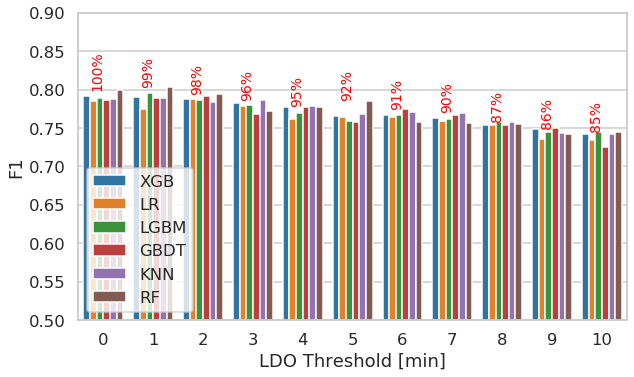

In [52]:
import seaborn as sns

sns.set_style("ticks")
sns.set_style("whitegrid")
sns.set_context("talk")

plt.figure(figsize=(9,5.5))
ax = sns.barplot(x="LDO Threshold [min]", y='F1',hue='Model', data=RES)
plt.setp(ax.get_legend().get_texts(), fontsize='13')
plt.tight_layout()
plt.ylim(0.5,0.90)
# plt.yticks(np.linspace(0,1,11))
# ax.set_yticks(np.linspace(0,1,11), minor=False)
# ax.set_yticks(np.linspace(0,1,11), minor=True)
plt.grid(which='minor')

plt.legend(loc='lower left')
for i, v in enumerate(np.arange(0,11,1)): 
    PART = RES[RES['LDO Threshold [min]']==v]
    PART['Perc'] = PART['AfterOR']/PART['BeforeOR']
#     ax.text(i-0.25 ,RES[RES['LDO Threshold [min]']==v]['F1'].max()+0.025, "{}%".format(int(np.round((1-RES[RES['LDO Threshold [min]']==v]['Perc'].max())*100,0))), color='red', size=14,va ='bottom', rotation=90)
    ax.text(i-0.25 ,PART['F1'].max(), "{}%".format(int(np.round((PART['Perc'].max())*100,0))), color='red', size=14,va ='bottom', rotation=90)

plt.savefig('Xor_A.pdf',format='pdf',bbox_inches='tight',pad_inches = 0)

In [140]:
RES

,F1,Metric,Model,LDO Threshold [min],BeforeOR,AfterOR
0,0.792231,F1,XGB,0,574,574
1,0.784916,F1,LR,0,574,574
2,0.788842,F1,LGBM,0,574,574
3,0.786612,F1,GBDT,0,574,574
4,0.787719,F1,KNN,0,574,574
...,...,...,...,...,...,...
61,0.734435,F1,LR,10,574,487
62,0.745405,F1,LGBM,10,574,487
63,0.725373,F1,GBDT,10,574,487
64,0.742658,F1,KNN,10,574,487


In [7]:
METRIC = []
METRIC.append({'name':'F1','instance':f1_score})

In [8]:
OPTIMIZER=[]
OPTIMIZER.append({'name':'XGB','instance':XGBClassifier,'param':{
            'learning_rate' : np.linspace(0.0001,0.9999,10000), 
            'n_estimators' : range(20,200,1),'objective':['reg:squarederror','reg:gamma', 'reg:tweedie'],
            'max_depth':range(2,15,1), ##MAR: start at 3 
            'subsample':np.linspace(0.3, 0.9 ,10000),'colsample_bytree': np.linspace(0.1,0.9,10000),
            'min_child_weight':np.arange(2,15),
#             'gamma':np.arange(0.01,5),
#             'reg_alpha':np.arange(0,5),'reg_lambda':np.arange(0,5)
        }})

In [ ]:
def EVAL2(REG,MET,setup='AlltoAll',TH=40,dataset='a'):
    from sklearn.model_selection import KFold
    X,Y = getBFS(part=[0,-1],threshold=TH,dataset=dataset)
    import multiprocessing
    search = RandomizedSearchCV(estimator = REG['instance'](),
                       param_distributions=REG['param'],
                       n_iter=250,
                       scoring=make_scorer(MET['instance'], greater_is_better=True),
                       n_jobs=multiprocessing.cpu_count(), ## MAR: used to be 1
                       cv = 10,
                       verbose = 1
                           )
    SCOREF1=[]
    
    kf = KFold(n_splits=5,shuffle=True)
    for train_index, test_index in tqdm.tqdm(kf.split(X)):
        Xtr, Xte = X.iloc[train_index], X.iloc[test_index]
        Ytr, Yte = Y[train_index], Y[test_index]

#                 Ytr=np.log1p(Ytr) ###
        reg = REG['instance'](**search.best_params_)
        reg.fit(Xtr, Ytr)
        pred = reg.predict(Xte)
        PRED = np.array(pred).ravel()
        SCOREF1.append(f1_score(Yte, PRED))
    
    
RESULTS = []
import tqdm
for O in tqdm.tqdm(OPTIMIZER):
    print(O['name'])
    for M in METRIC:
        print(M['name'])
        print('lpo')
        EVAL2(O,M,setup=experiment,dataset='a',TH=45)

In [3]:
Xtr = X[X.MonthOfYear>=10]
Xte = X[X.MonthOfYear<10]
Ytr = Y[X.MonthOfYear>=10]
Yte = Y[X.MonthOfYear<10]

In [13]:
import tqdm
import multiprocessing

REG = {'name':'XGB','instance':XGBRegressor,'param':{
            'learning_rate' : np.log(np.linspace(1.0001,2,50000)),#np.linspace(0.00001,0.9999,10000), 
            'n_estimators' : range(20,200,1),'objective':['reg:squarederror'],
            'max_depth':range(2,15,1), ##MAR: start at 3 
            'subsample':np.linspace(0.25, 1.0 ,10000),'colsample_bytree': np.linspace(0.01,0.9999,10000),
            'min_child_weight':np.arange(2,15),'n_jobs':[1],
#             'gamma':np.linspace(0,50,1000),
#             'reg_alpha':np.arange(0,15),'reg_lambda':np.arange(0,15)
}}

search = RandomizedSearchCV(estimator = REG['instance'](),
                   param_distributions=REG['param'],
                   n_iter=400,
                   scoring=make_scorer(mape, greater_is_better=False),
                   n_jobs=multiprocessing.cpu_count(), ## MAR: used to be 1
                   cv = 10,
                   verbose = 1
                       )
search.fit(Xtr, Ytr)
print(search.best_params_)

Fitting 10 folds for each of 400 candidates, totalling 4000 fits


[Parallel(n_jobs=56)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=56)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=56)]: Done 1468 tasks      | elapsed:    1.8s


{'subsample': 0.7966546654665467, 'objective': 'reg:squarederror', 'n_jobs': 1, 'n_estimators': 94, 'min_child_weight': 2, 'max_depth': 4, 'learning_rate': 0.5036243322876138, 'colsample_bytree': 0.20522780278027802}


[Parallel(n_jobs=56)]: Done 4000 out of 4000 | elapsed:    3.4s finished
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_search.py:814: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


In [14]:
reg = REG['instance'](**search.best_params_)
    
reg.fit(Xtr, Ytr)
pred = np.array(reg.predict(Xte)).ravel()
pred=pred

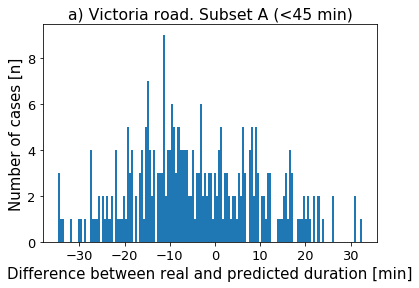

In [15]:
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 13})
import matplotlib 
plt.rc('axes', labelsize=15)
# matplotlib.rc('xtick', labelsize=13) 
# matplotlib.rc('ytick', labelsize=13) 
 

plt.hist(Yte-pred,bins=150)
plt.ylabel('Number of cases [n]')
plt.xlabel('Difference between real and predicted duration [min]')
plt.title('a) Victoria road. Subset A (<45 min)')
plt.savefig('aresid.pdf',format='pdf')

285

# San-Francisco

In [16]:
X,Y = getBFS(part=[2,40],dataset='sf')
# Y=np.log1p(Y)

In [17]:
cnd = X.monthidx >= (X.monthidx.max()-10)

Xtr = X[cnd]
Xte = X[~cnd]
Ytr = Y[cnd]
Yte = Y[~cnd]

In [21]:
import tqdm
import multiprocessing

REG = {'name':'XGB','instance':XGBRegressor,'param':{
            'learning_rate' : np.log(np.linspace(1.0001,2,50000)),#np.linspace(0.00001,0.9999,10000), 
            'n_estimators' : range(20,200,1),'objective':['reg:squarederror'],
            'max_depth':range(2,15,1), ##MAR: start at 3 
            'subsample':np.linspace(0.25, 1.0 ,10000),'colsample_bytree': np.linspace(0.01,0.9999,10000),
            'min_child_weight':np.arange(2,15),'n_jobs':[1],
#             'gamma':np.linspace(0,50,1000),
#             'reg_alpha':np.arange(0,15),'reg_lambda':np.arange(0,15)
}}

search = RandomizedSearchCV(estimator = REG['instance'](),
                   param_distributions=REG['param'],
                   n_iter=350,
                   scoring=make_scorer(mape, greater_is_better=False),
                   n_jobs=multiprocessing.cpu_count(), ## MAR: used to be 1
                   cv = 10,
                   verbose = 1
                       )
search.fit(Xtr, Ytr)
print(search.best_params_)

Fitting 10 folds for each of 350 candidates, totalling 3500 fits


[Parallel(n_jobs=56)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=56)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=56)]: Done 1016 tasks      | elapsed:    1.8s
[Parallel(n_jobs=56)]: Done 2416 tasks      | elapsed:    3.8s


{'subsample': 0.9564956495649566, 'objective': 'reg:squarederror', 'n_jobs': 1, 'n_estimators': 84, 'min_child_weight': 14, 'max_depth': 12, 'learning_rate': 0.07873119041286854, 'colsample_bytree': 0.7649732373237323}


[Parallel(n_jobs=56)]: Done 3500 out of 3500 | elapsed:    6.0s finished
/home/agrigore/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_search.py:814: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


In [22]:
reg = REG['instance'](**search.best_params_)
    
reg.fit(Xtr, Ytr)
pred = np.array(reg.predict(Xte)).ravel()
# pred=np.expm1(pred)

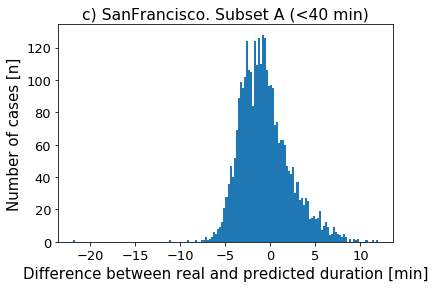

In [23]:
plt.rcParams.update({'font.size': 13})
import matplotlib 
plt.rc('axes', labelsize=15)

plt.hist(Yte-pred,bins=150)
plt.ylabel('Number of cases [n]')
plt.xlabel('Difference between real and predicted duration [min]')
plt.title('c) SanFrancisco. Subset A (<40 min)') #subsetA
plt.savefig('sfresid.pdf',format='pdf')

In [44]:
X,Y = getBFS(part=[2,55],dataset='m')
Y=np.log1p(Y)

In [45]:
cnd = X.Month >= (X.Month.max()-10)

Xtr = X[cnd]
Xte = X[~cnd]
Ytr = Y[cnd]
Yte = Y[~cnd]

In [46]:
import tqdm
import multiprocessing

REG = {'name':'XGB','instance':XGBRegressor,'param':{
            'learning_rate' : np.log(np.linspace(1.00001,1.3,100000)), 
            'n_estimators' : range(50,400,1),
            'max_depth':range(2,15,1), ##MAR: start at 3 
            'subsample':np.linspace(0.3, 1.0 ,10000),'colsample_bytree': np.linspace(0.0001,0.9999,10000),
            'min_child_weight':np.arange(2,31)
        }}

search = RandomizedSearchCV(estimator = REG['instance'](),
                   param_distributions=REG['param'],
                   n_iter=300,
                   scoring=make_scorer(mape, greater_is_better=False),
                   n_jobs=multiprocessing.cpu_count(), ## MAR: used to be 1
                   cv = 10,
                   verbose = 1
                       )
search.fit(Xtr, Ytr)
print(search.best_params_)

Fitting 10 folds for each of 300 candidates, totalling 3000 fits


[Parallel(n_jobs=56)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=56)]: Done  88 tasks      | elapsed:    1.4s
[Parallel(n_jobs=56)]: Done 564 tasks      | elapsed:    5.5s
[Parallel(n_jobs=56)]: Done 951 tasks      | elapsed:    8.4s
[Parallel(n_jobs=56)]: Done 1401 tasks      | elapsed:   12.2s
[Parallel(n_jobs=56)]: Done 1951 tasks      | elapsed:   18.5s
[Parallel(n_jobs=56)]: Done 2601 tasks      | elapsed:   25.8s
[Parallel(n_jobs=56)]: Done 3000 out of 3000 | elapsed:   30.4s finished


{'subsample': 0.7855685568556856, 'n_estimators': 338, 'min_child_weight': 14, 'max_depth': 4, 'learning_rate': 0.011116719058287382, 'colsample_bytree': 0.9804019501950195}


In [47]:
reg = REG['instance'](**search.best_params_)
    
reg.fit(Xtr, Ytr)
pred = np.array(reg.predict(Xte)).ravel()
pred=np.expm1(pred)

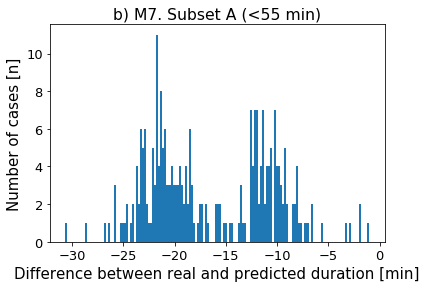

In [48]:
plt.rcParams.update({'font.size': 13})
import matplotlib 
plt.rc('axes', labelsize=15)

plt.hist(Yte-pred,bins=150)
plt.ylabel('Number of cases [n]')
plt.xlabel('Difference between real and predicted duration [min]')
plt.title('b) M7. Subset A (<55 min)') #, test set is the last 2 months of the year
plt.savefig('mresid.pdf',format='pdf')

In [27]:
print(len(Xtr), len(Xte))

4909 300


In [49]:
!tar -cf resid.tar *resid.pdf